In [0]:
 from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


In [0]:
import torch.nn as nn
import torch.nn.functional as F
import torch
import numpy as np
import pandas as pd
from torch.autograd import Variable
from torchvision.models import resnet152
from google.colab.patches import cv2_imshow
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
import os
from PIL import Image
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from math import sqrt


import sys

import itertools

from torch.utils.data import DataLoader
from torch.autograd import Variable
import argparse
import time
import datetime
from torch.utils.data import TensorDataset, DataLoader


In [0]:

##############################
#         MergeLayer
##############################

class MergeLayer(nn.Module):    
    def __init__(self, inputsize):
        super(Metadata, self).__init__()
        self.fc1 = nn.Linear(inputsize, 1024)
        self.out = nn.Linear(1024, 1)
        self.relu = nn.ReLU()
        self.drop = nn.Dropout(0.6)
       

     
    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.drop(x)
        x = self.out(x)
       
            
        
        return x



##############################
#         Encoder
##############################


class Encoder(nn.Module):
    def __init__(self, latent_dim):
        super(Encoder, self).__init__()
        resnet = resnet152(pretrained=True)
        
        self.final = nn.Sequential(
            nn.Linear(resnet.fc.in_features, latent_dim), nn.BatchNorm1d(latent_dim, momentum=0.01)
        )

    def forward(self, x):
        
        return self.final(x)   # To be trained layer on the pretrain model


##############################
#           LSTM
##############################


class LSTM(nn.Module):
    def __init__(self, latent_dim, num_layers, hidden_dim, bidirectional):
        super(LSTM, self).__init__()
        self.lstm = nn.LSTM(latent_dim, hidden_dim, num_layers, batch_first=True, bidirectional=bidirectional)
        self.hidden_state = None

    def reset_hidden_state(self):
        self.hidden_state = None

    def forward(self, x):
        x, self.hidden_state = self.lstm(x, self.hidden_state)
        return x




##############################
#         ConvLSTM
##############################


class ConvLSTM(nn.Module):
    def __init__(
        self,metasize, num_classes, latent_dim=512, lstm_layers=1, hidden_dim=1024, bidirectional=True):
        super(ConvLSTM, self).__init__()
        self.encoder = Encoder(latent_dim)
        self.lstm = LSTM(latent_dim, lstm_layers, hidden_dim, bidirectional)
        self.output_layers = nn.Sequential(
            nn.Linear(2 * hidden_dim if bidirectional else hidden_dim, hidden_dim),
            nn.BatchNorm1d(hidden_dim, momentum=0.01),
            nn.ReLU(),
            nn.Dropout(0.8),
            nn.Linear(hidden_dim, num_classes),
            
        )
        self.dropout = nn.Dropout(0.2)
        self.mergelayer = MergeLayer(512 + num_classes)
        
     
        self.fc1 = nn.Linear(metasize, 512)
        
        self.batchnorm = nn.BatchNorm1d(512 + num_classes, momentum=0.01)
        self.batchnorm1 = nn.BatchNorm1d(num_classes, momentum=0.01)
        
       
        self.relu = nn.ReLU()

    def forward(self, x,metadata):
        batch_size, seq_length, e = x.shape
        x = x.view(batch_size * seq_length, e)
        x = self.encoder(x)
        x = x.view(batch_size, seq_length, -1)
        x = self.lstm(x)

        x = x[:, -1]
        x = self.relu(self.batchnorm1(self.output_layers(x)))

        # Output of LSTM
        
        metadata = self.relu(self.fc1(metadata))
        metadata = self.dropout(metadata)

        # Output of Metadata
        

        flattened_layer = torch.cat((x, metadata), 1) # Merging two outputs
        

        # Merge Layer
        mix =  self.mergelayer(self.relu(flattened_layer))        

            
        return mix

In [0]:
metadata = pd.read_csv('gdrive/My Drive/Project - Box Office Prediction/Dataset/Metadata/final_data.csv', sep=',') # Loading Data

In [0]:
metadata.head()

,budget,original_language,popularity,runtime,collection_name,has_collection,num_genres,all_genres,genre_Drama,genre_Comedy,genre_Thriller,genre_Action,genre_Crime,genre_Romance,genre_Adventure,genre_Horror,genre_Science Fiction,genre_Mystery,genre_Family,genre_Fantasy,genre_History,genre_War,genre_Animation,num_companies,production_company_Warner Bros.,production_company_Universal Pictures,production_company_Twentieth Century Fox Film Corporation,production_company_Paramount Pictures,production_company_Columbia Pictures,production_company_New Line Cinema,production_company_Metro-Goldwyn-Mayer (MGM),production_company_Columbia Pictures Corporation,production_company_Relativity Media,production_company_Touchstone Pictures,production_company_Village Roadshow Pictures,production_company_Miramax Films,production_company_United Artists,production_company_Walt Disney Pictures,production_company_TriStar Pictures,production_company_Canal+,...,departments_Actors,log_budget,has_homepage,release_date_year,release_date_weekday,release_date_month,release_date_weekofyear,release_date_day,release_date_quarter,len_title,words_title,len_tagline,words_tagline,len_overview,words_overview,len_original_title,words_original_title,title_oof,tagline_oof,overview_oof,original_title_oof,budget_to_popularity,budget_to_runtime,_budget_year_ratio,_releaseYear_popularity_ratio,_releaseYear_popularity_ratio2,runtime_to_mean_year,popularity_to_mean_year,budget_to_mean_year,budget_to_year,budget_to_mean_year_to_year,popularity_to_mean_year_to_log_budget,year_to_log_budget,budget_to_runtime_to_year,genders_1_cast_to_log_budget,all_genres_to_popularity_to_mean_year,genders_2_crew_to_budget_to_mean_year,overview_oof_to_genders_2_crew,videoname,revenue
0,14000000,9,6.575393,93.0,245,1,1,434,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,...,0,16.454568,0,2015,4,2,8,20,1,22,38,52,86,155,243,22,38,16.750935,16.923428,16.882853,17.036189,2.129150e+06,150537.634409,3.448085,306.445562,0.003263,0.822766,0.681495,0.628829,6947.890819,0.000312,0.041417,122.458396,74.708503,0.486187,636.835555,20.673352,1.298681,0,12314651
1,40000000,9,8.248895,113.0,572,1,4,465,1,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,...,0,17.504390,0,2004,4,8,32,6,3,40,59,60,100,393,601,40,59,16.864185,16.293762,16.769947,16.894523,4.849134e+06,353982.300885,9.960120,242.941630,0.004116,1.075981,0.947672,1.227688,19960.079840,0.000613,0.054139,114.485566,176.637875,0.571285,490.676160,3.258157,4.192487,1,95149435
2,3300000,9,64.299990,105.0,1,0,1,590,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,15.009433,1,2014,4,10,41,10,4,8,12,47,78,130,194,8,12,16.645945,16.607314,16.584059,16.615304,5.132194e+04,31428.571429,0.813570,31.321933,0.031927,0.973533,6.283763,0.139919,1638.530288,0.000069,0.418654,134.182281,15.605050,0.466373,93.892778,78.617108,1.507642,2,13092000
3,1200000,15,3.174936,122.0,1,0,2,670,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,13.997833,1,2012,4,3,10,9,1,7,11,0,4,581,900,7,11,16.656919,16.449349,16.673331,16.644843,3.779604e+05,9836.065574,0.296432,633.713561,0.001578,1.147571,0.377972,0.055772,596.421471,0.000028,0.027002,143.736535,4.888701,0.071440,1772.619541,0.000000,0.000000,3,16000000
4,8000000,9,0.743274,83.0,1,0,3,289,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,15.894952,0,1987,3,8,32,6,3,38,60,0,4,150,235,38,60,16.681575,16.464867,16.685295,16.670305,1.076319e+07,96385.542169,2.026256,2673.307555,0.000374,0.759378,0.094232,0.473373,4026.170106,0.000238,0.005928,125.008240,48.508074,0.000000,3066.909725,8.450000,4.171324,5,3261638


In [0]:

videonames = metadata['videoname'].values 

metadata = metadata.drop('videoname',axis=1)
# metadata = metadata.dropna()

metadata.head()
xSize, ySize = 224, 224
channels = 3

Y = metadata['revenue']
metadata = metadata.drop(columns=['revenue'])

In [0]:
# Identifying the all numeric columns excluding one hot encoding onces

datacolumns = metadata.columns
numericColumn = []
for i in range(0,len(datacolumns)):
  if(np.max(metadata[datacolumns[i]]) > 1):
    numericColumn.append(i)


In [0]:
MX_train, MX_test, train_Y, test_Y = train_test_split(metadata.reset_index(drop=True), Y, test_size=0.2) # Split train and test

In [0]:
# Loading the Embeding from the folder
tensorArray = []
for i in videonames:
   
    video = torch.load("gdrive/My Drive/Project - Box Office Prediction/EmbedingLSTM/"+ str(i) +"-Embedings.pt")
    tensorArray.append(video.cpu().numpy())
    

In [0]:
tensor = torch.FloatTensor(tensorArray)

In [0]:
tensor.shape # size of tensor

torch.Size([1489, 100, 2048])

In [0]:
trainindex = MX_train.index.tolist()
testindex = MX_test.index.tolist()


In [0]:

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 



train_X = tensor[MX_train.index.tolist(),:,:] # Spliting the tensor with the respect to train split

test_X = tensor[MX_test.index.tolist(),:,:] # Spliting the tensor with the respect to test split

testindex = np.array(MX_test.index.tolist())
trainindex = np.array(MX_train.index.tolist())

MX_train = MX_train.values
MX_test = MX_test.values
train_Y = train_Y.values
test_Y = test_Y.values

scaler_X = MinMaxScaler()  # Scaling the numeric values excluding one hot encoding columns
MX_train[:,numericColumn] = scaler_X.fit_transform(MX_train[:,numericColumn])
MX_test[:,numericColumn] = scaler_X.transform(MX_test[:,numericColumn])

 
scaler_Y = MinMaxScaler()
train_Y = scaler_Y.fit_transform(train_Y.reshape(-1,1))
test_Y = scaler_Y.transform(test_Y.reshape(-1,1))


# Creating data loader
train_data = TensorDataset(train_X,torch.FloatTensor(MX_train), torch.FloatTensor(train_Y),torch.IntTensor(trainindex))
test_data = TensorDataset(test_X,torch.FloatTensor(MX_test), torch.FloatTensor(test_Y),torch.IntTensor(testindex))
batch_size = 30

train_loader = DataLoader(train_data, shuffle=True, batch_size=batch_size,drop_last=False)
test_loader = DataLoader(test_data, shuffle=True, batch_size=batch_size,drop_last=False)


In [0]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) 


--- Epoch 0 ---
[Epoch 0/3000] [Batch 39/40] [Loss: 0.096798 (0.121486)]  [r2: (-0.866893)] [rmse: (0.343581)], ETA: 1:17:44.182653
Testing -- [Batch 9/10] [Loss: 0.075860 (0.112533)] [r2: (-0.825239)] [rmse: (0.332244)]
--- Epoch 1 ---
[Epoch 1/3000] [Batch 39/40] [Loss: 0.151415 (0.120336)]  [r2: (-0.842924)] [rmse: (0.343159)], ETA: 1:09:22.764071
Testing -- [Batch 9/10] [Loss: 0.172752 (0.112919)] [r2: (-0.817762)] [rmse: (0.332443)]
--- Epoch 2 ---
[Epoch 2/3000] [Batch 39/40] [Loss: 0.089050 (0.118081)]  [r2: (-0.845454)] [rmse: (0.339995)], ETA: 1:10:01.675988
Testing -- [Batch 9/10] [Loss: 0.048921 (0.112112)] [r2: (-0.847861)] [rmse: (0.328246)]
--- Epoch 3 ---
[Epoch 3/3000] [Batch 39/40] [Loss: 0.070511 (0.119804)]  [r2: (-0.849232)] [rmse: (0.343011)], ETA: 1:11:15.733539
Testing -- [Batch 9/10] [Loss: 0.154808 (0.112300)] [r2: (-0.821672)] [rmse: (0.331829)]
--- Epoch 4 ---
[Epoch 4/3000] [Batch 39/40] [Loss: 0.124559 (0.117015)]  [r2: (-0.806336)] [rmse: (0.338295)], ETA:

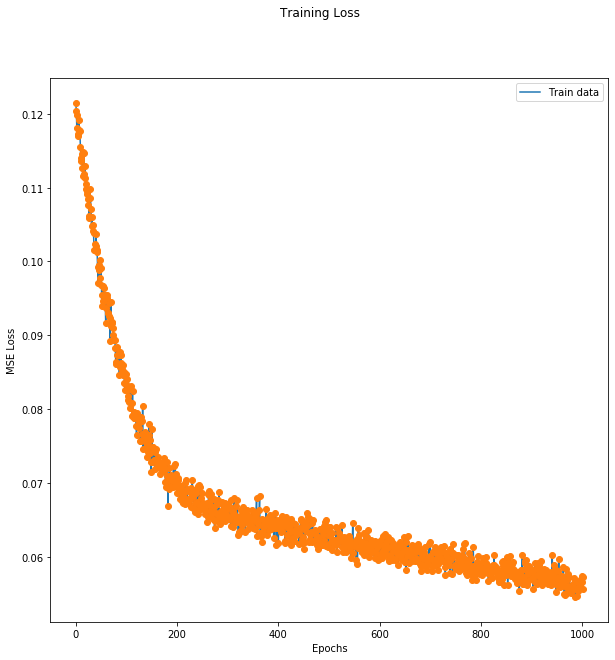

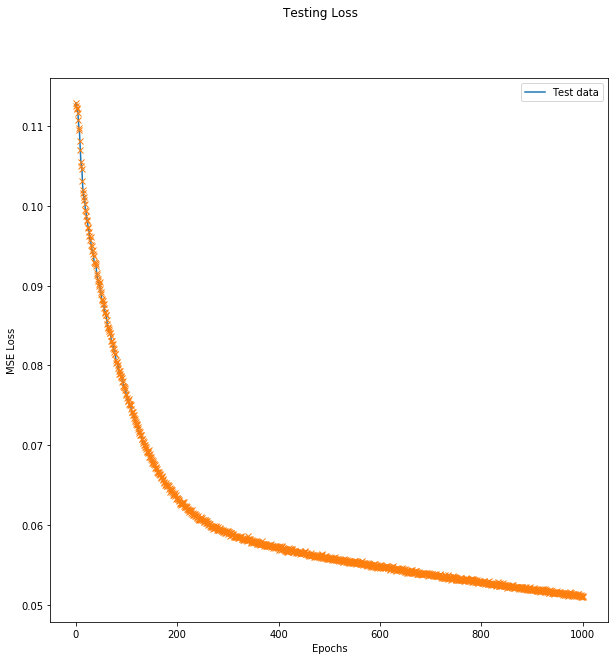

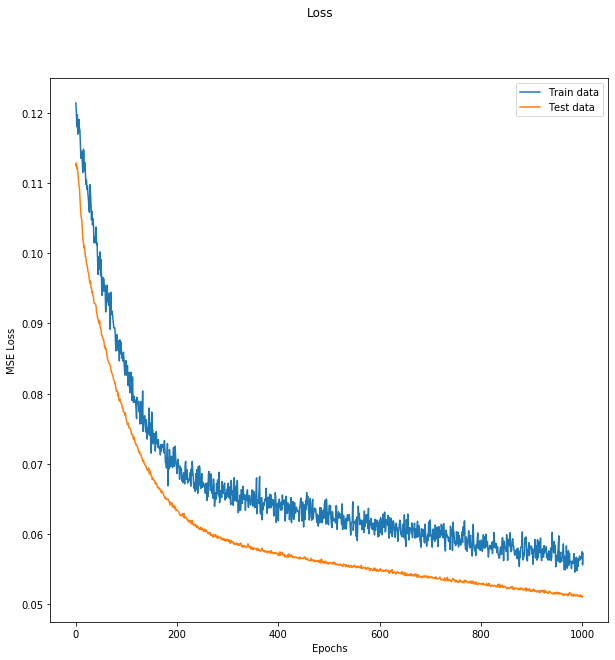

MAPE :  39.6590239524069


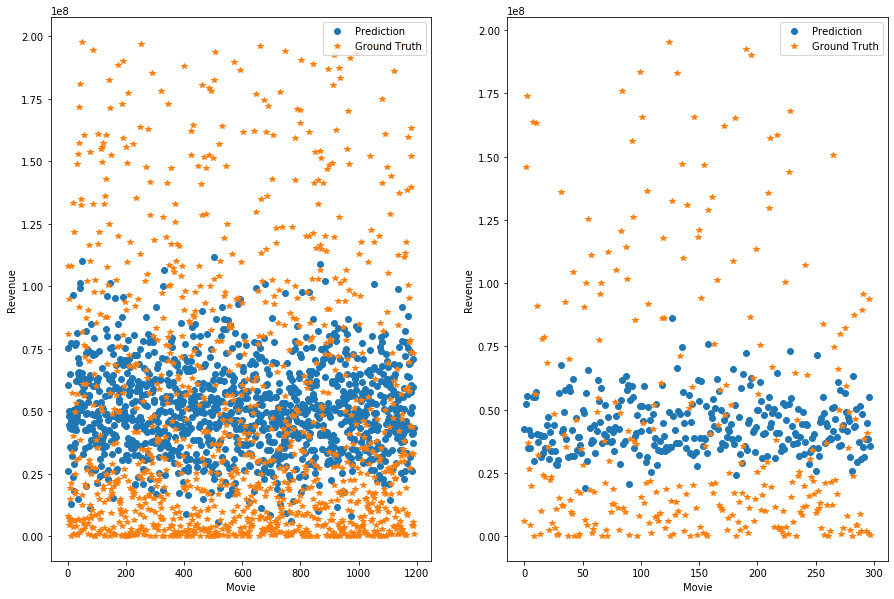

--- Epoch 1003 ---
[Epoch 1003/3000] [Batch 39/40] [Loss: 0.037720 (0.055963)]  [r2: (0.123369)] [rmse: (0.234212)], ETA: 0:48:05.679377
Testing -- [Batch 9/10] [Loss: 0.043598 (0.050963)] [r2: (0.143564)] [rmse: (0.223579)]
--- Epoch 1004 ---
[Epoch 1004/3000] [Batch 39/40] [Loss: 0.049145 (0.056723)]  [r2: (0.090028)] [rmse: (0.236177)], ETA: 0:46:17.079001
Testing -- [Batch 9/10] [Loss: 0.038648 (0.050914)] [r2: (0.154336)] [rmse: (0.223665)]
--- Epoch 1005 ---
[Epoch 1005/3000] [Batch 39/40] [Loss: 0.069522 (0.057016)]  [r2: (0.119033)] [rmse: (0.236826)], ETA: 0:48:02.445654
Testing -- [Batch 9/10] [Loss: 0.062724 (0.051086)] [r2: (0.172165)] [rmse: (0.224129)]
--- Epoch 1006 ---
[Epoch 1006/3000] [Batch 39/40] [Loss: 0.065312 (0.057625)]  [r2: (0.098823)] [rmse: (0.237942)], ETA: 0:46:12.185223
Testing -- [Batch 9/10] [Loss: 0.070828 (0.051118)] [r2: (0.178041)] [rmse: (0.223389)]
--- Epoch 1007 ---
[Epoch 1007/3000] [Batch 39/40] [Loss: 0.048476 (0.055710)]  [r2: (0.127130)] [rm

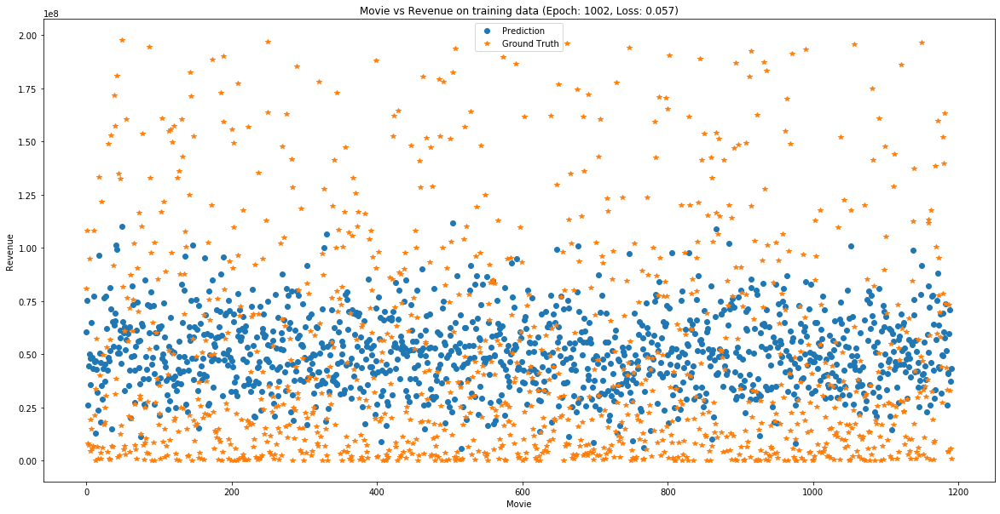

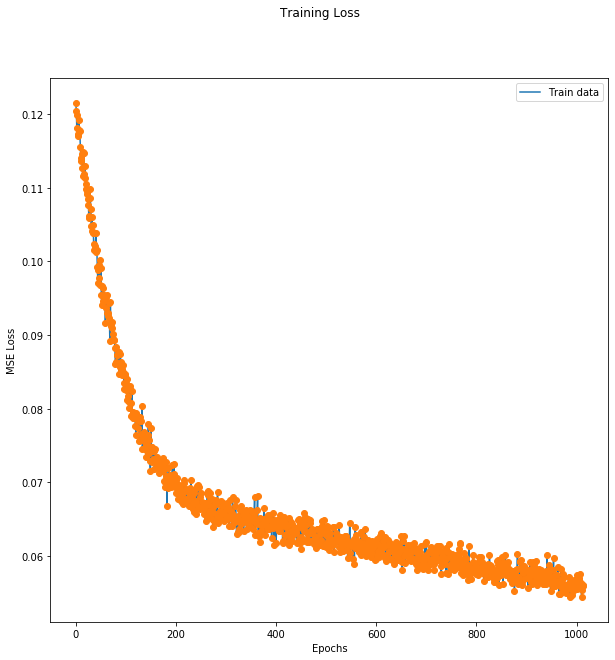

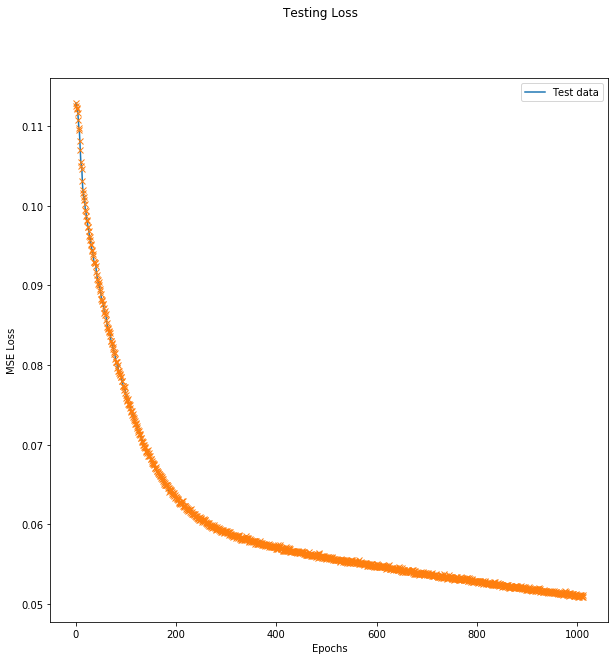

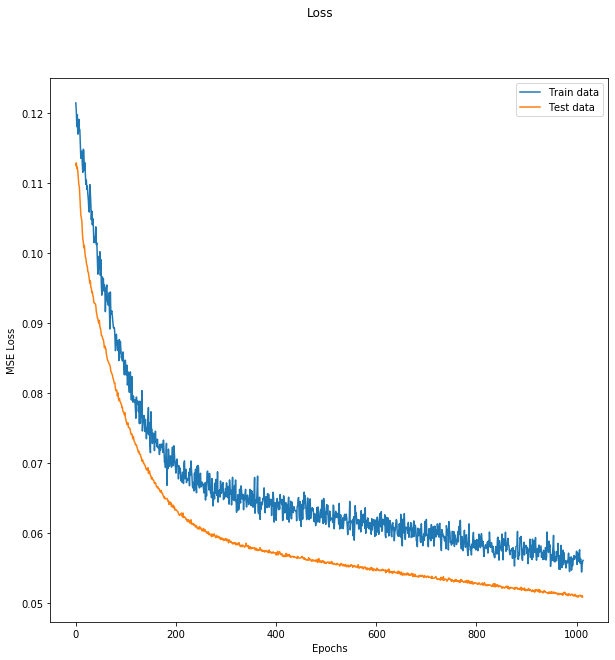

MAPE :  39.74071641104433


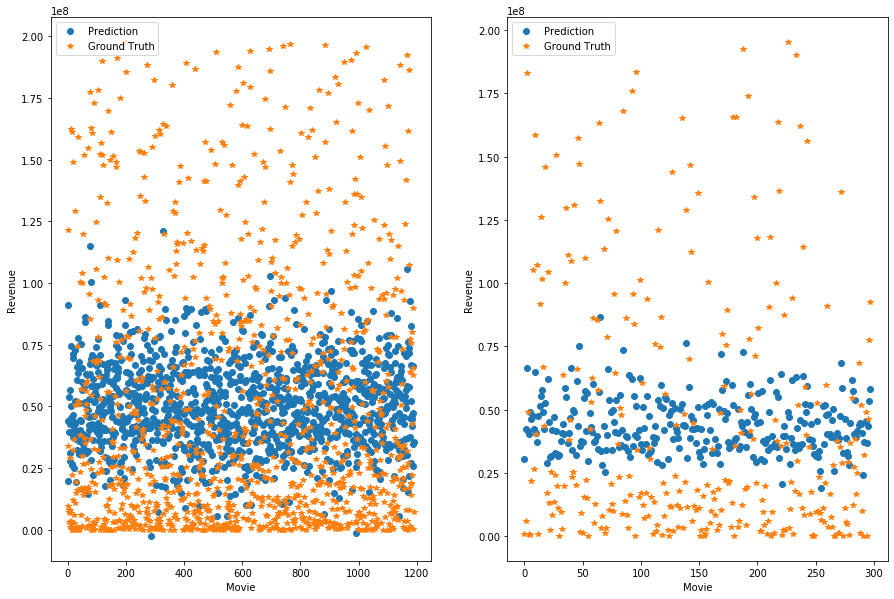

--- Epoch 1014 ---
[Epoch 1014/3000] [Batch 39/40] [Loss: 0.069104 (0.056685)]  [r2: (0.102923)] [rmse: (0.235574)], ETA: 0:47:16.117796
Testing -- [Batch 9/10] [Loss: 0.032965 (0.050843)] [r2: (0.125749)] [rmse: (0.222494)]
--- Epoch 1015 ---
[Epoch 1015/3000] [Batch 39/40] [Loss: 0.078878 (0.055534)]  [r2: (0.148610)] [rmse: (0.233792)], ETA: 0:49:54.988911
Testing -- [Batch 9/10] [Loss: 0.055506 (0.050981)] [r2: (0.155155)] [rmse: (0.224329)]
--- Epoch 1016 ---
[Epoch 1016/3000] [Batch 39/40] [Loss: 0.045681 (0.055847)]  [r2: (0.128770)] [rmse: (0.233811)], ETA: 0:48:41.237046
Testing -- [Batch 9/10] [Loss: 0.055806 (0.050952)] [r2: (0.150967)] [rmse: (0.221637)]
--- Epoch 1017 ---
[Epoch 1017/3000] [Batch 39/40] [Loss: 0.105003 (0.056383)]  [r2: (0.147218)] [rmse: (0.235293)], ETA: 0:47:17.710068
Testing -- [Batch 9/10] [Loss: 0.050220 (0.050893)] [r2: (0.168489)] [rmse: (0.222490)]
--- Epoch 1018 ---
[Epoch 1018/3000] [Batch 39/40] [Loss: 0.051468 (0.055669)]  [r2: (0.124762)] [rm

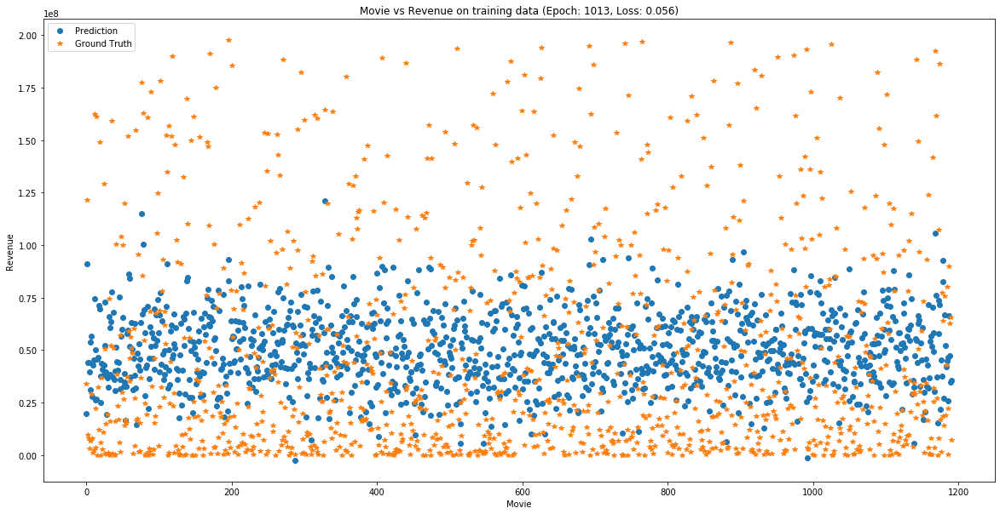

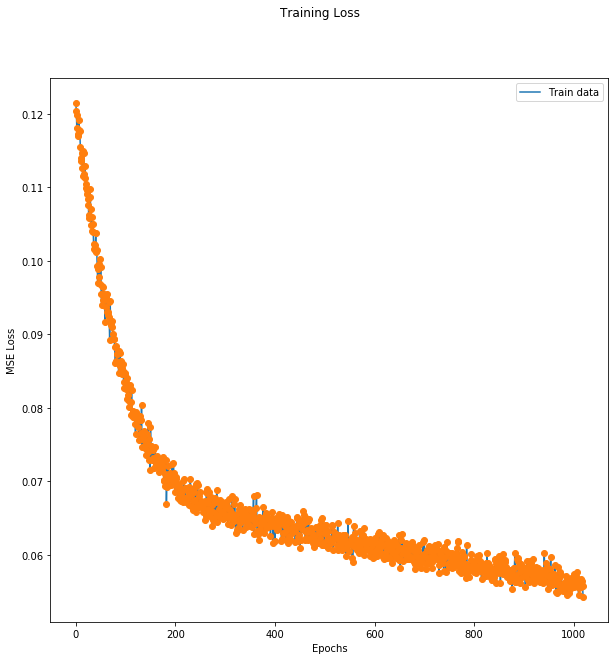

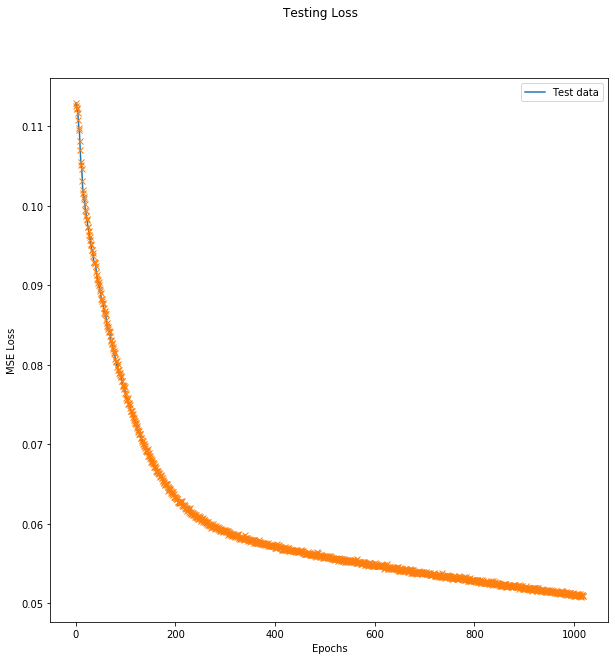

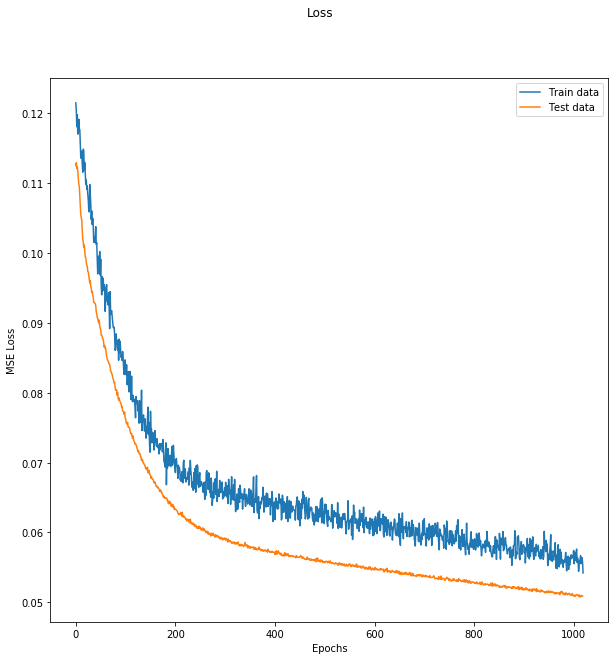

MAPE :  39.53924752910106


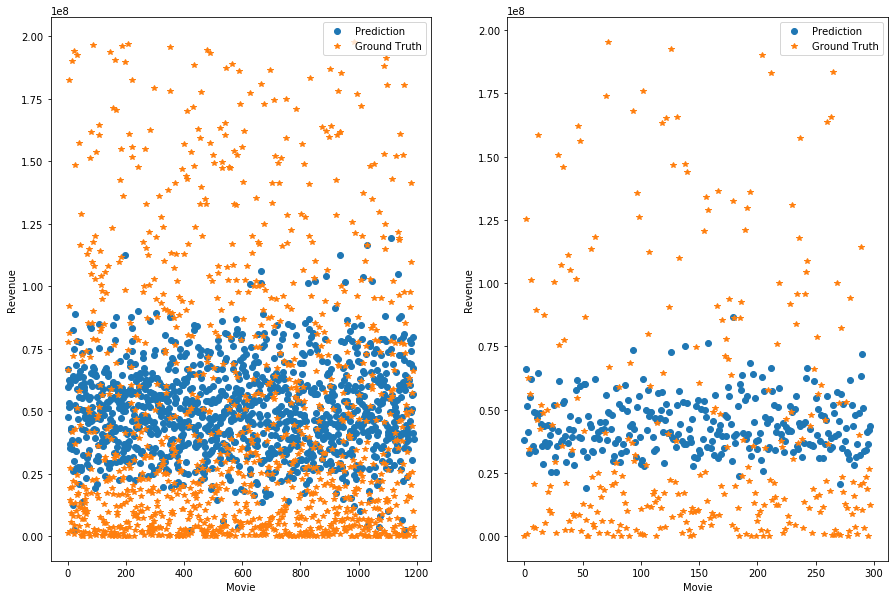

--- Epoch 1020 ---
[Epoch 1020/3000] [Batch 39/40] [Loss: 0.115835 (0.055587)]  [r2: (0.141954)] [rmse: (0.232799)], ETA: 0:46:30.968503
Testing -- [Batch 9/10] [Loss: 0.062355 (0.050941)] [r2: (0.178767)] [rmse: (0.224054)]
--- Epoch 1021 ---
[Epoch 1021/3000] [Batch 39/40] [Loss: 0.072900 (0.056832)]  [r2: (0.119094)] [rmse: (0.236230)], ETA: 0:45:54.112930
Testing -- [Batch 9/10] [Loss: 0.064787 (0.050948)] [r2: (0.180933)] [rmse: (0.225195)]
--- Epoch 1022 ---
[Epoch 1022/3000] [Batch 39/40] [Loss: 0.032148 (0.056435)]  [r2: (0.054736)] [rmse: (0.234880)], ETA: 0:45:53.097663
Testing -- [Batch 9/10] [Loss: 0.032615 (0.050748)] [r2: (0.167835)] [rmse: (0.222572)]
--- Epoch 1023 ---
[Epoch 1023/3000] [Batch 39/40] [Loss: 0.084731 (0.055246)]  [r2: (0.152182)] [rmse: (0.233031)], ETA: 0:46:22.855642
Testing -- [Batch 9/10] [Loss: 0.035949 (0.050769)] [r2: (0.178701)] [rmse: (0.222687)]
--- Epoch 1024 ---
[Epoch 1024/3000] [Batch 39/40] [Loss: 0.050547 (0.056780)]  [r2: (0.118229)] [rm

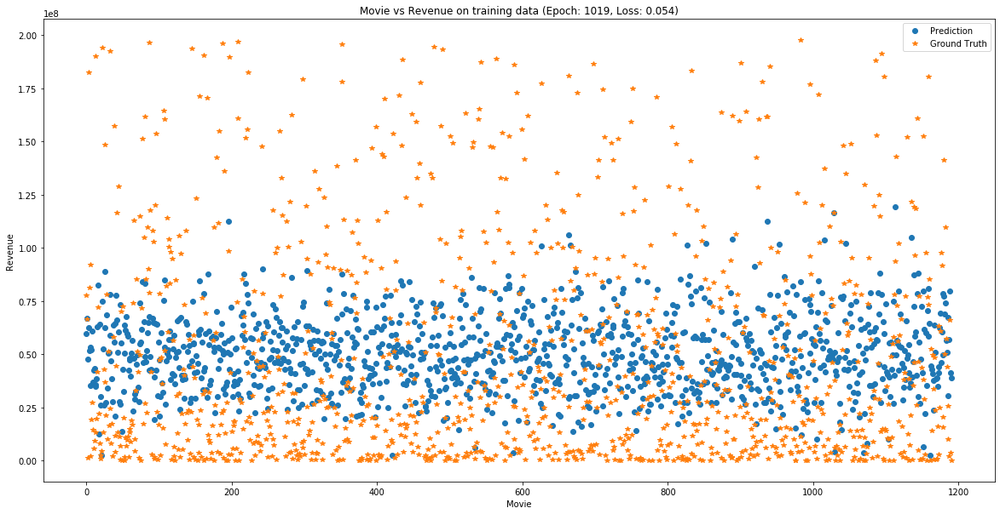

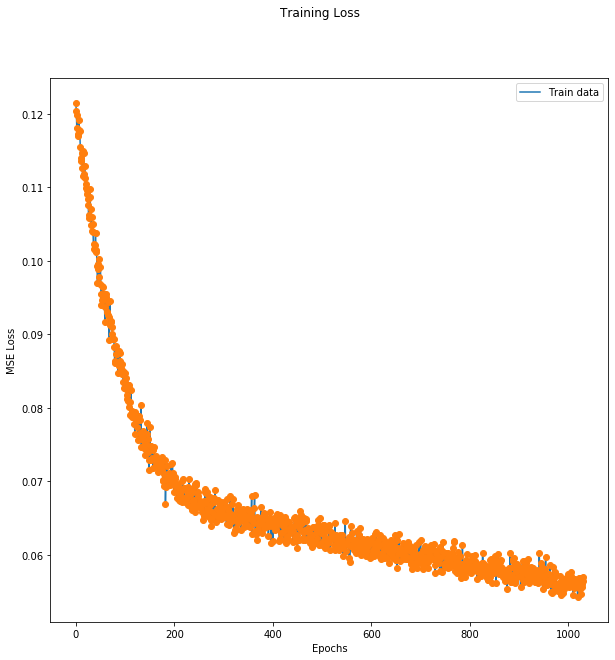

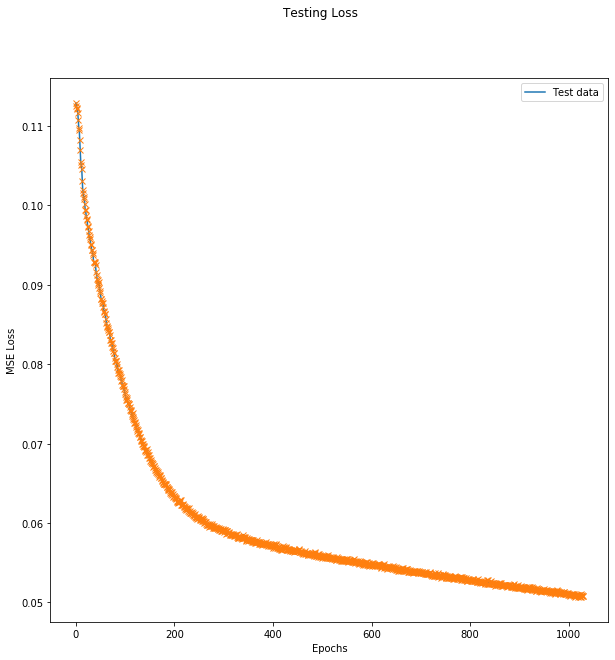

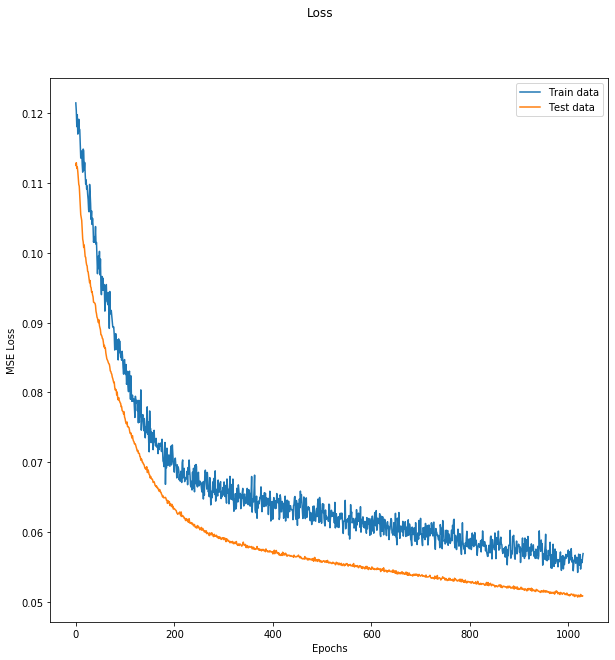

MAPE :  39.55370272173315


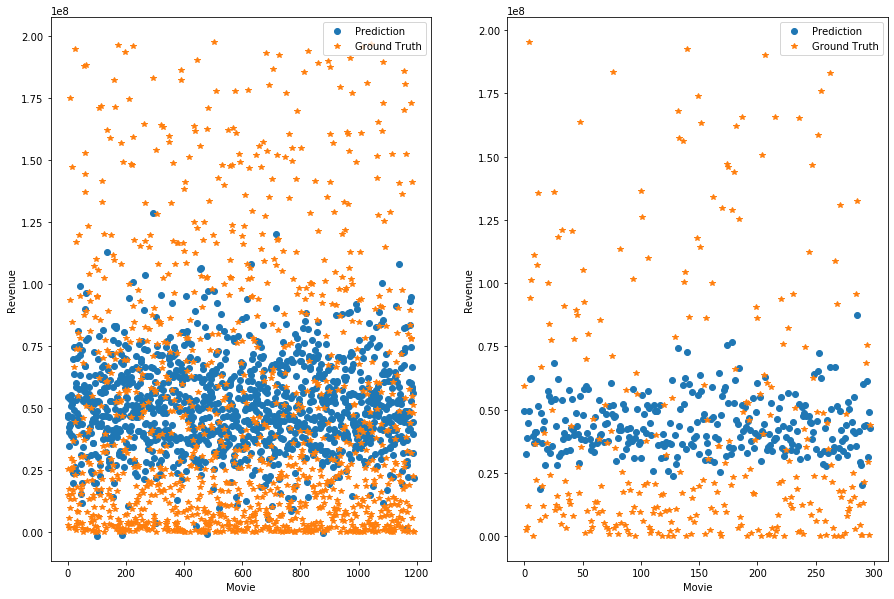

--- Epoch 1031 ---
[Epoch 1031/3000] [Batch 39/40] [Loss: 0.042896 (0.056412)]  [r2: (0.106682)] [rmse: (0.234840)], ETA: 0:48:20.622937
Testing -- [Batch 9/10] [Loss: 0.059814 (0.050858)] [r2: (0.174760)] [rmse: (0.224408)]
--- Epoch 1032 ---
[Epoch 1032/3000] [Batch 39/40] [Loss: 0.040197 (0.055707)]  [r2: (0.121668)] [rmse: (0.233745)], ETA: 0:46:04.271764
Testing -- [Batch 9/10] [Loss: 0.046489 (0.050764)] [r2: (0.166409)] [rmse: (0.223185)]
--- Epoch 1033 ---
[Epoch 1033/3000] [Batch 39/40] [Loss: 0.050842 (0.055224)]  [r2: (0.151297)] [rmse: (0.233146)], ETA: 0:46:17.434801
Testing -- [Batch 9/10] [Loss: 0.041858 (0.050732)] [r2: (0.174350)] [rmse: (0.223182)]
--- Epoch 1034 ---
[Epoch 1034/3000] [Batch 39/40] [Loss: 0.050608 (0.055650)]  [r2: (0.114947)] [rmse: (0.233781)], ETA: 0:48:42.006207
Testing -- [Batch 9/10] [Loss: 0.035683 (0.050682)] [r2: (0.181972)] [rmse: (0.223449)]
--- Epoch 1035 ---
[Epoch 1035/3000] [Batch 39/40] [Loss: 0.045399 (0.055067)]  [r2: (0.122647)] [rm

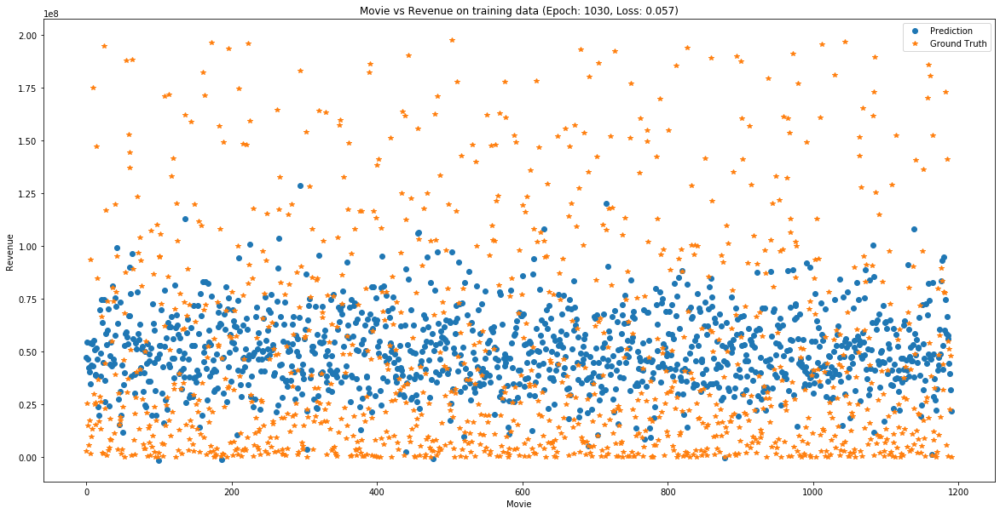

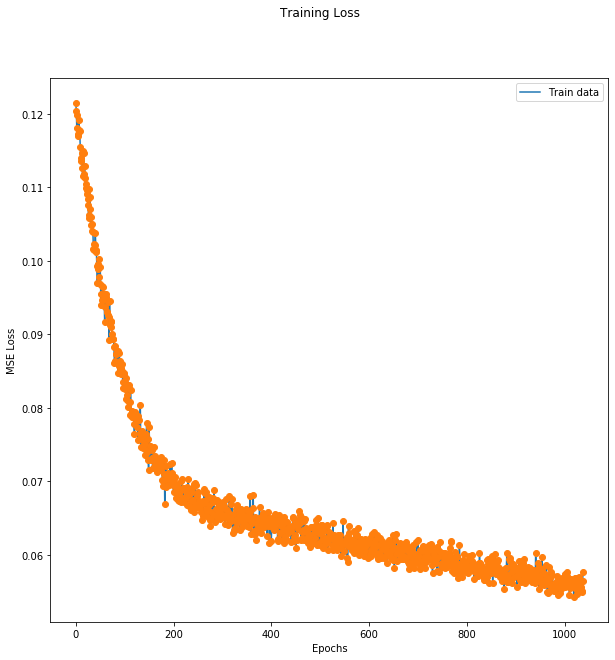

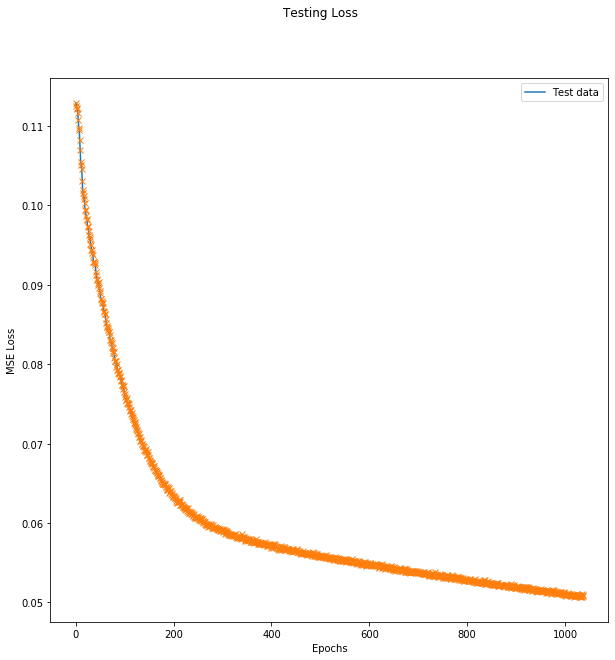

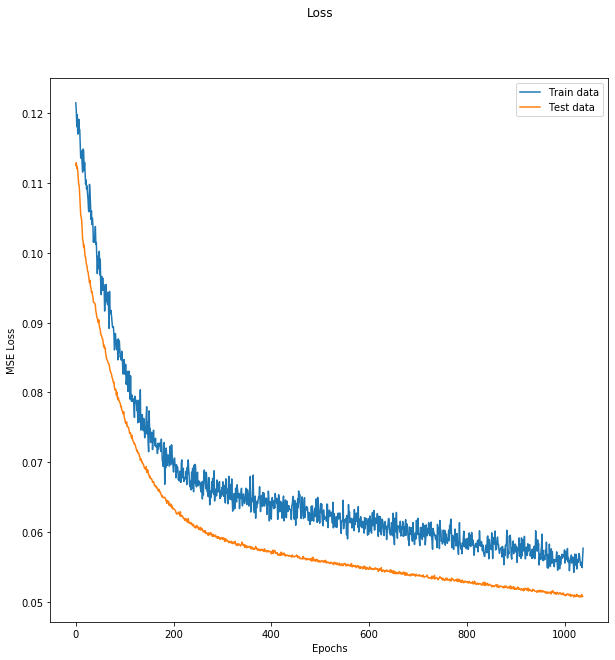

MAPE :  39.50466517813767


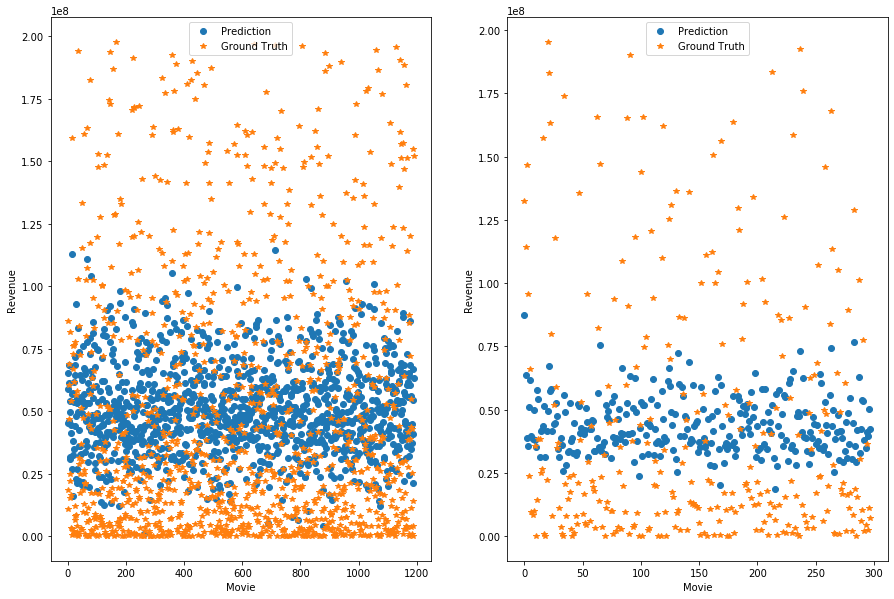

--- Epoch 1039 ---
[Epoch 1039/3000] [Batch 39/40] [Loss: 0.071080 (0.056512)]  [r2: (0.128906)] [rmse: (0.236167)], ETA: 0:46:11.519344
Testing -- [Batch 9/10] [Loss: 0.037248 (0.050643)] [r2: (0.188454)] [rmse: (0.223133)]
--- Epoch 1040 ---
[Epoch 1040/3000] [Batch 39/40] [Loss: 0.021737 (0.055072)]  [r2: (0.158708)] [rmse: (0.232384)], ETA: 0:45:14.879206
Testing -- [Batch 9/10] [Loss: 0.058772 (0.050771)] [r2: (0.197962)] [rmse: (0.224470)]
--- Epoch 1041 ---
[Epoch 1041/3000] [Batch 39/40] [Loss: 0.038335 (0.055038)]  [r2: (0.146576)] [rmse: (0.232558)], ETA: 0:47:50.908295
Testing -- [Batch 9/10] [Loss: 0.061326 (0.050785)] [r2: (0.183602)] [rmse: (0.223050)]
--- Epoch 1042 ---
[Epoch 1042/3000] [Batch 39/40] [Loss: 0.026824 (0.056173)]  [r2: (0.101197)] [rmse: (0.234742)], ETA: 0:45:16.437508
Testing -- [Batch 9/10] [Loss: 0.054700 (0.050732)] [r2: (0.176532)] [rmse: (0.221184)]
--- Epoch 1043 ---
[Epoch 1043/3000] [Batch 39/40] [Loss: 0.046711 (0.054831)]  [r2: (0.137100)] [rm

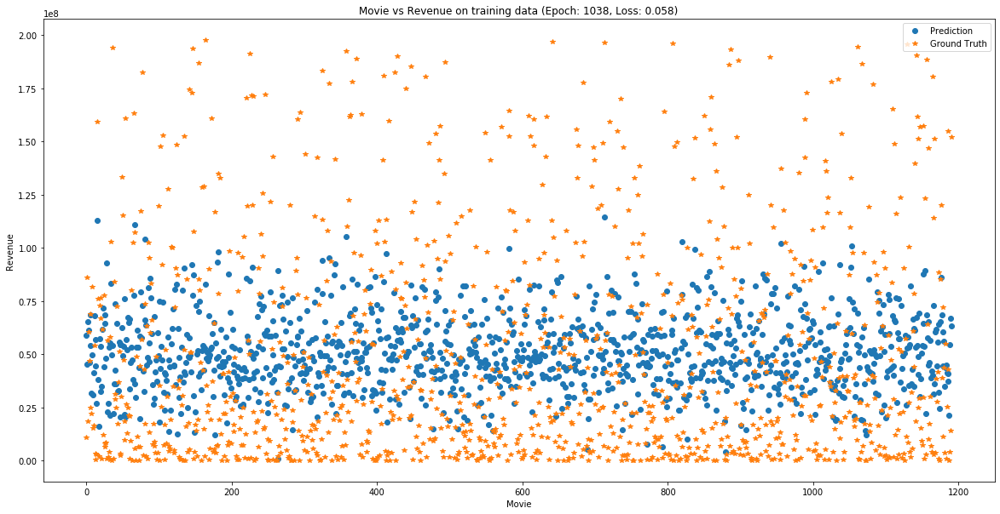

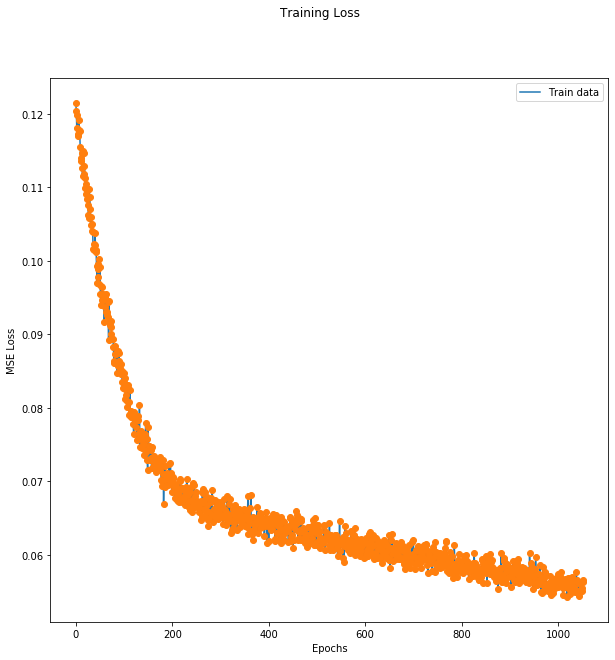

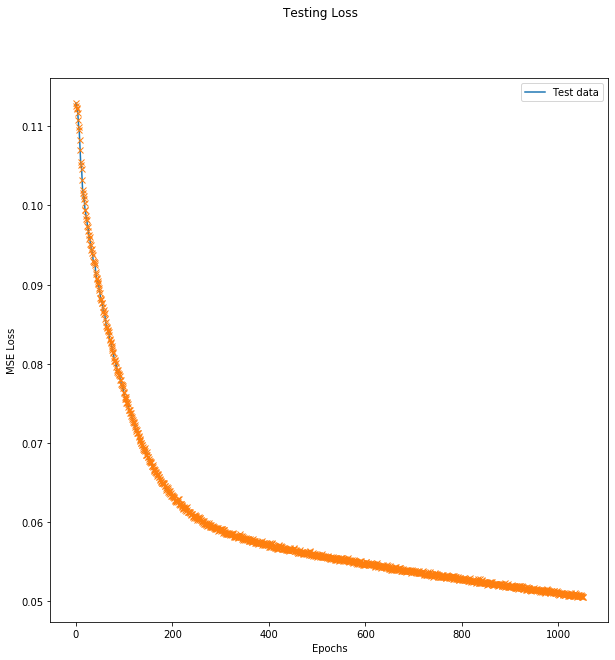

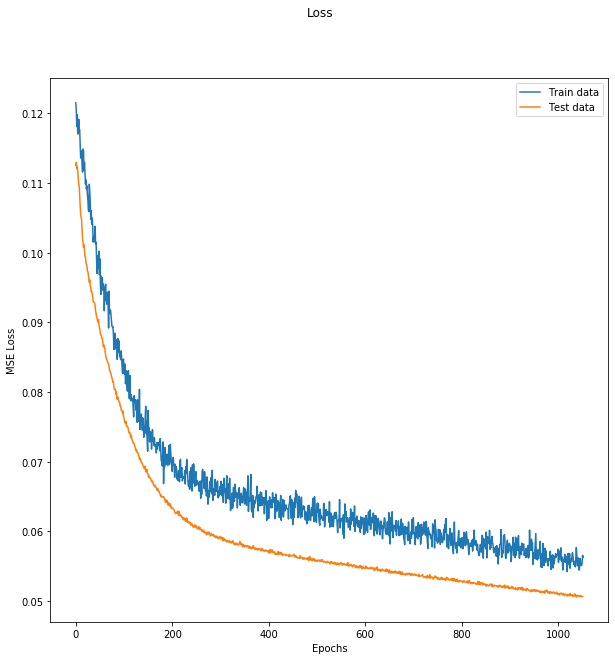

MAPE :  39.2818484204504


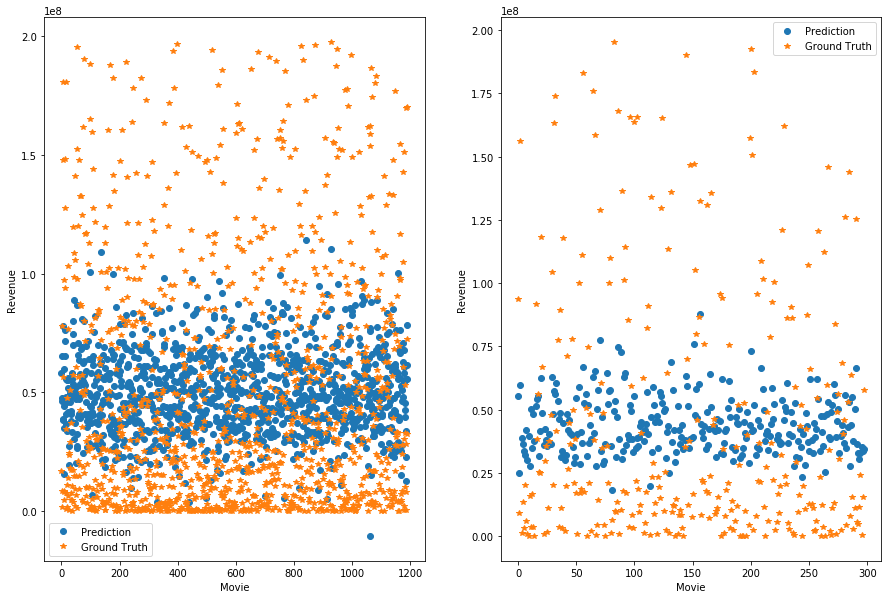

--- Epoch 1053 ---
[Epoch 1053/3000] [Batch 39/40] [Loss: 0.094999 (0.055270)]  [r2: (0.130351)] [rmse: (0.232571)], ETA: 0:45:25.963498
Testing -- [Batch 9/10] [Loss: 0.034028 (0.050505)] [r2: (0.138459)] [rmse: (0.222407)]
Train R2 =  0.18511534091677617
Test R2 =  0.2043403080349646


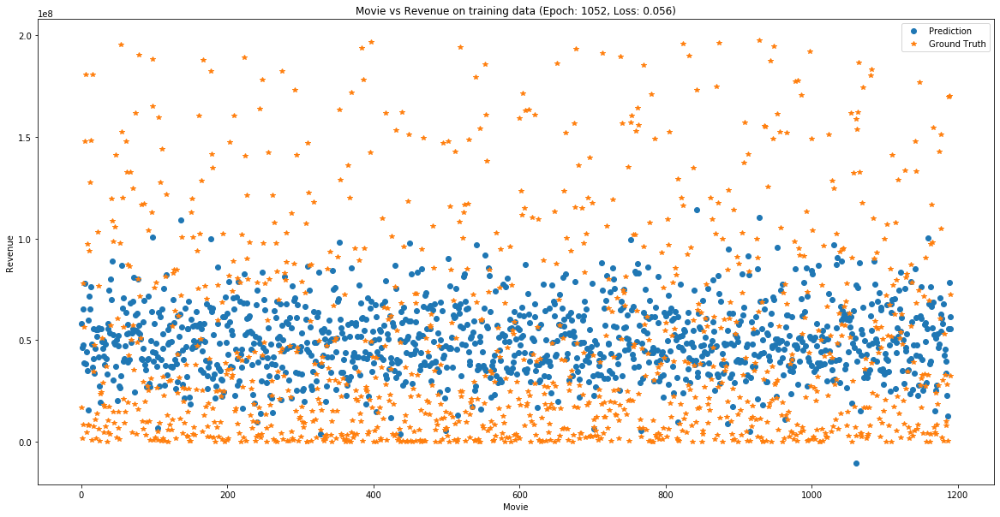

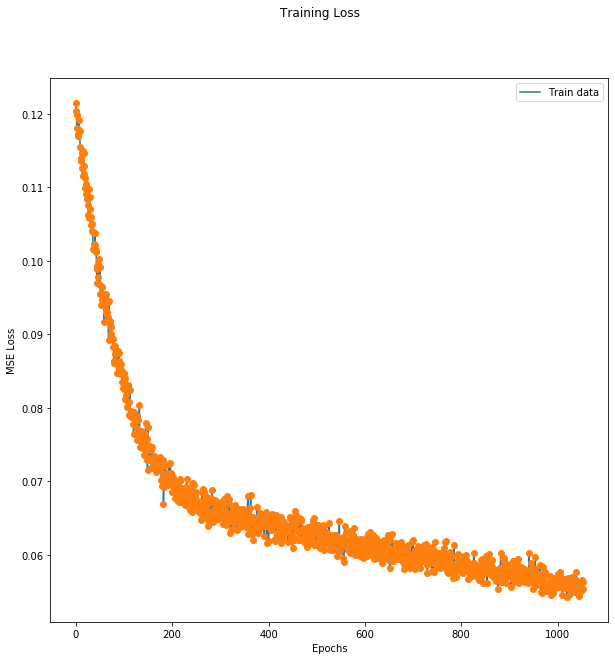

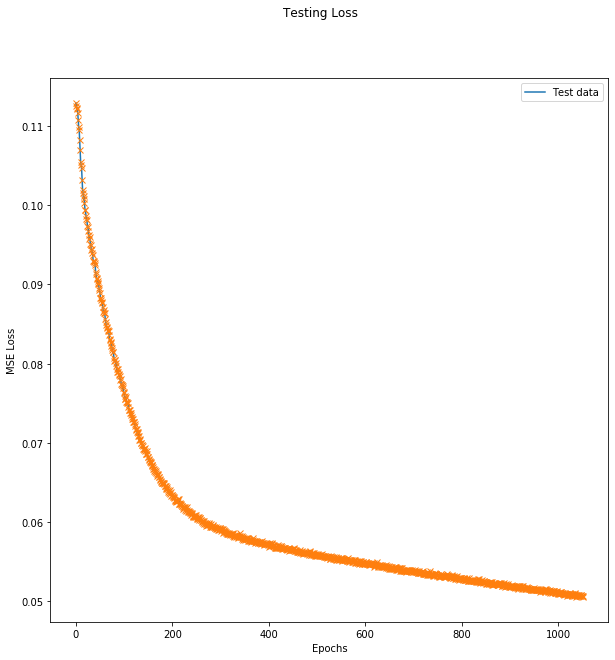

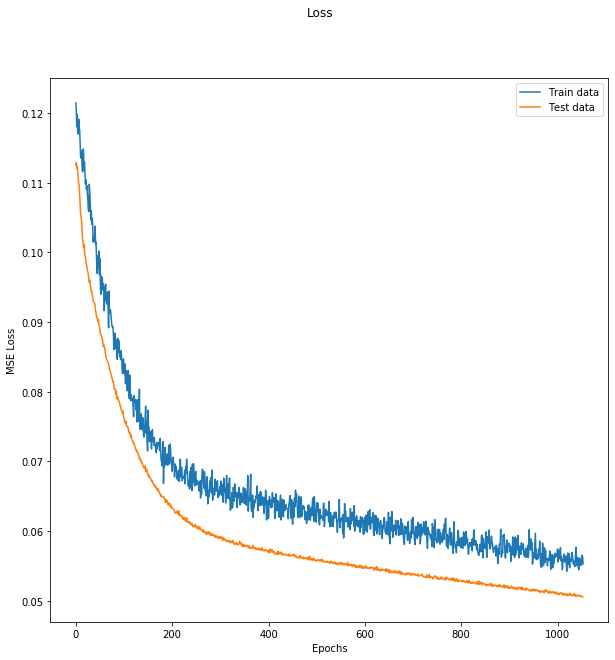

MAPE :  39.405793958694034


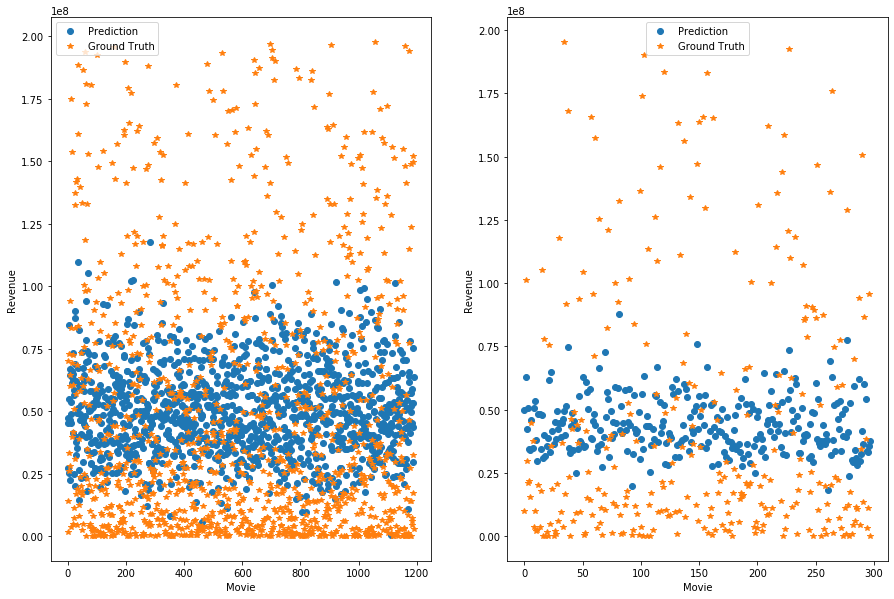

--- Epoch 1054 ---
[Epoch 1054/3000] [Batch 39/40] [Loss: 0.057879 (0.056472)]  [r2: (0.120737)] [rmse: (0.235984)], ETA: 0:45:12.654124
Testing -- [Batch 9/10] [Loss: 0.039068 (0.050534)] [r2: (0.186907)] [rmse: (0.223971)]
--- Epoch 1055 ---
[Epoch 1055/3000] [Batch 39/40] [Loss: 0.031991 (0.054521)]  [r2: (0.139729)] [rmse: (0.231180)], ETA: 0:45:25.386687
Testing -- [Batch 9/10] [Loss: 0.083396 (0.050844)] [r2: (0.177337)] [rmse: (0.223452)]
--- Epoch 1056 ---
[Epoch 1056/3000] [Batch 39/40] [Loss: 0.035612 (0.054646)]  [r2: (0.142877)] [rmse: (0.231740)], ETA: 0:45:05.973470
Testing -- [Batch 9/10] [Loss: 0.039906 (0.050549)] [r2: (0.162547)] [rmse: (0.221631)]
--- Epoch 1057 ---
[Epoch 1057/3000] [Batch 39/40] [Loss: 0.067588 (0.055465)]  [r2: (0.142740)] [rmse: (0.233725)], ETA: 0:46:59.871506
Testing -- [Batch 9/10] [Loss: 0.071147 (0.050752)] [r2: (0.174958)] [rmse: (0.223109)]
--- Epoch 1058 ---
[Epoch 1058/3000] [Batch 39/40] [Loss: 0.068097 (0.053769)]  [r2: (0.170602)] [rm

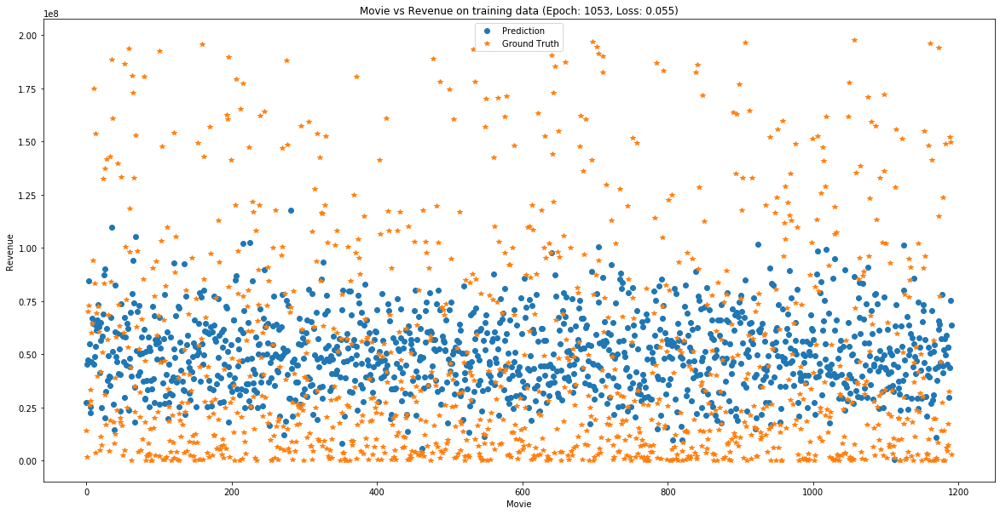

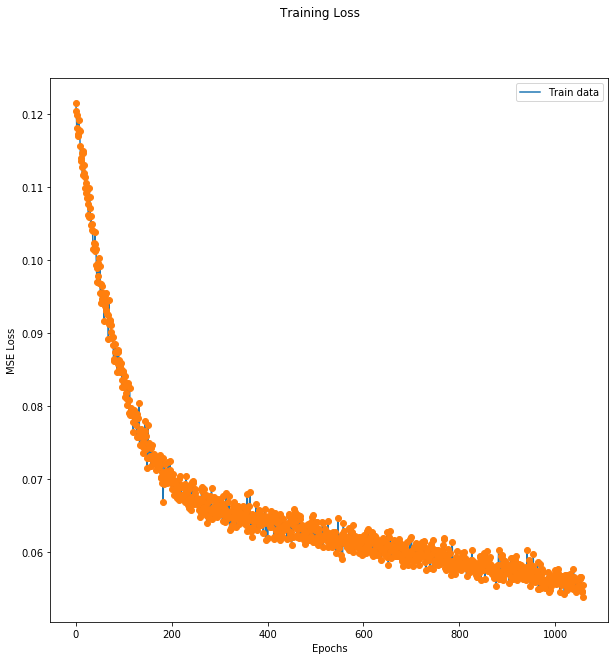

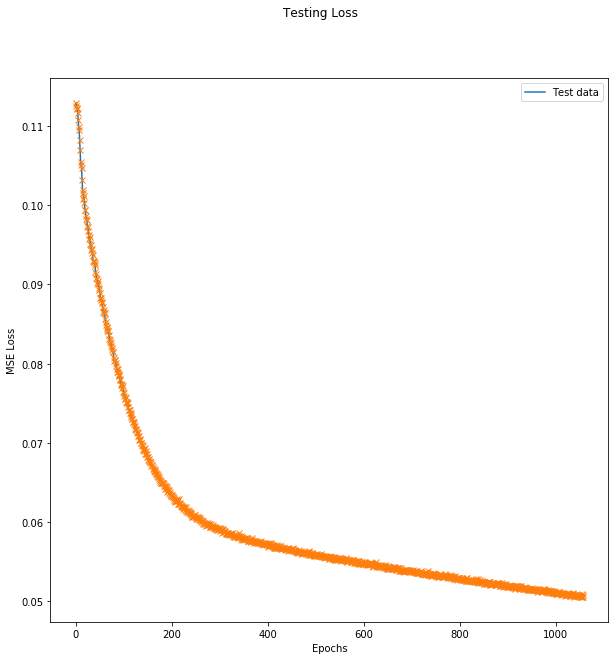

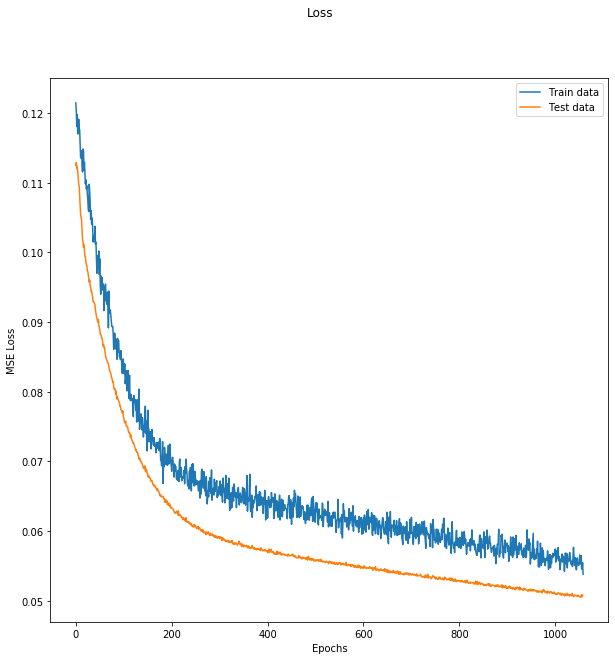

MAPE :  39.373417220167056


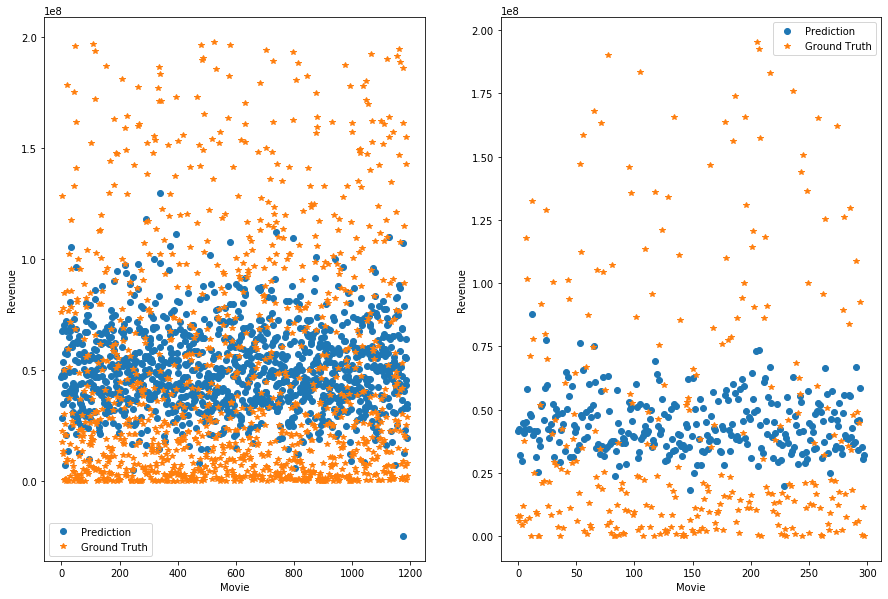

--- Epoch 1059 ---
[Epoch 1059/3000] [Batch 39/40] [Loss: 0.073823 (0.056071)]  [r2: (0.101201)] [rmse: (0.234045)], ETA: 0:45:33.710612
Testing -- [Batch 9/10] [Loss: 0.071092 (0.050702)] [r2: (0.190201)] [rmse: (0.223926)]
--- Epoch 1060 ---
[Epoch 1060/3000] [Batch 39/40] [Loss: 0.043895 (0.055816)]  [r2: (0.125401)] [rmse: (0.234522)], ETA: 0:46:43.107306
Testing -- [Batch 9/10] [Loss: 0.063006 (0.050653)] [r2: (-0.000014)] [rmse: (0.221117)]
--- Epoch 1061 ---
[Epoch 1061/3000] [Batch 39/40] [Loss: 0.026342 (0.053090)]  [r2: (0.180041)] [rmse: (0.227829)], ETA: 0:44:51.617191
Testing -- [Batch 9/10] [Loss: 0.061728 (0.050635)] [r2: (0.186581)] [rmse: (0.223121)]
--- Epoch 1062 ---
[Epoch 1062/3000] [Batch 39/40] [Loss: 0.037464 (0.053907)]  [r2: (0.169284)] [rmse: (0.230165)], ETA: 0:45:09.551009
Testing -- [Batch 9/10] [Loss: 0.044946 (0.050519)] [r2: (0.181594)] [rmse: (0.222178)]
--- Epoch 1063 ---
[Epoch 1063/3000] [Batch 39/40] [Loss: 0.056215 (0.055014)]  [r2: (0.143159)] [r

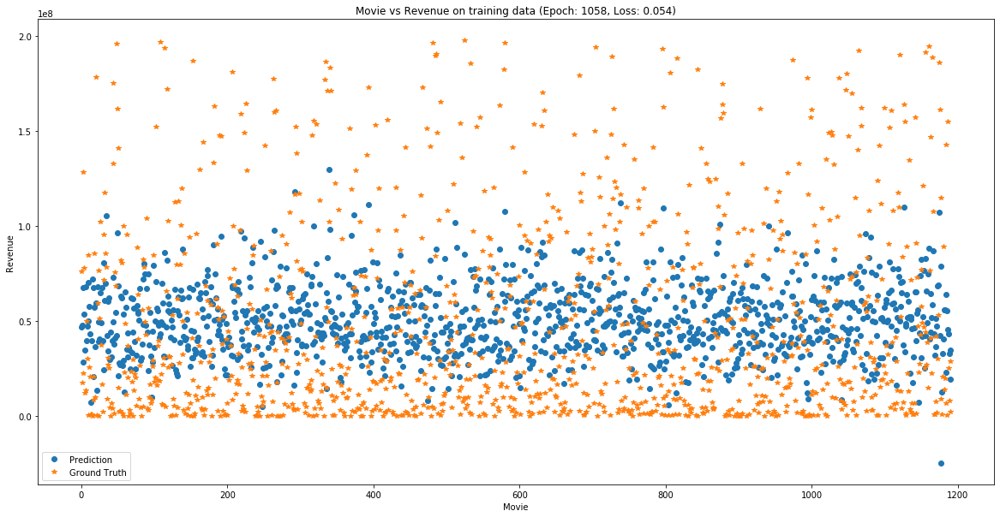

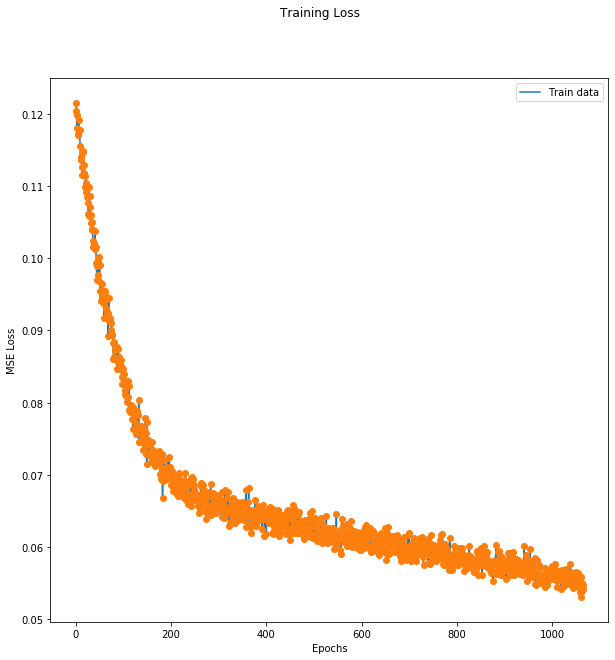

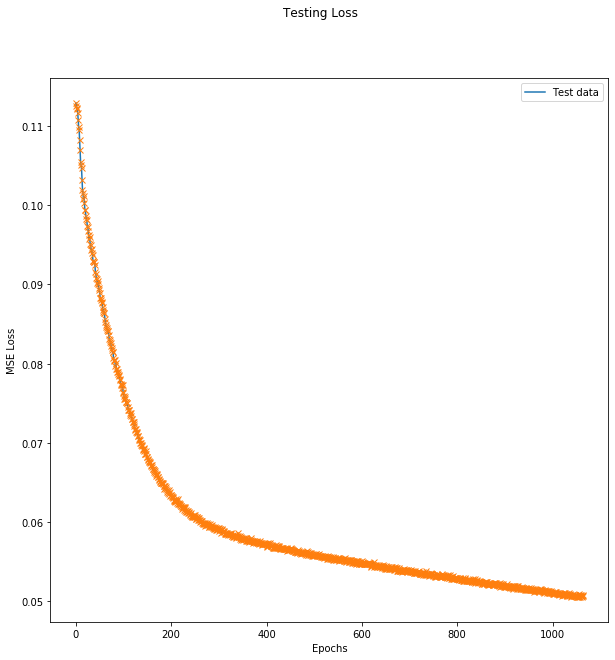

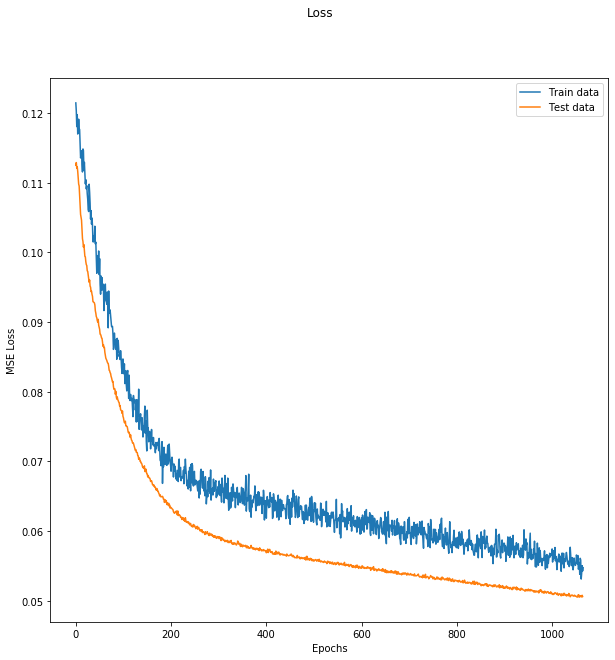

MAPE :  39.268655644731204


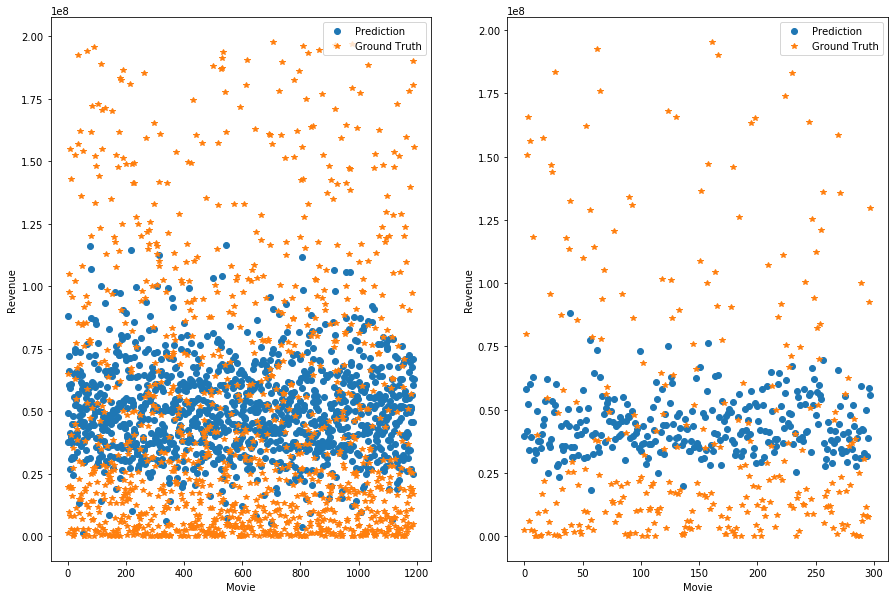

--- Epoch 1066 ---
[Epoch 1066/3000] [Batch 39/40] [Loss: 0.057311 (0.055833)]  [r2: (0.131972)] [rmse: (0.234080)], ETA: 0:44:38.681666
Testing -- [Batch 9/10] [Loss: 0.036250 (0.050437)] [r2: (0.200550)] [rmse: (0.221041)]
--- Epoch 1067 ---
[Epoch 1067/3000] [Batch 39/40] [Loss: 0.117678 (0.056126)]  [r2: (0.136677)] [rmse: (0.233989)], ETA: 0:47:21.980592
Testing -- [Batch 9/10] [Loss: 0.055689 (0.050557)] [r2: (0.170092)] [rmse: (0.223836)]
--- Epoch 1068 ---
[Epoch 1068/3000] [Batch 39/40] [Loss: 0.032672 (0.055800)]  [r2: (0.059948)] [rmse: (0.233578)], ETA: 0:45:02.042037
Testing -- [Batch 9/10] [Loss: 0.037630 (0.050408)] [r2: (0.156392)] [rmse: (0.219580)]
--- Epoch 1069 ---
[Epoch 1069/3000] [Batch 39/40] [Loss: 0.081649 (0.055637)]  [r2: (0.142444)] [rmse: (0.234128)], ETA: 0:46:04.825013
Testing -- [Batch 9/10] [Loss: 0.058765 (0.050559)] [r2: (0.203818)] [rmse: (0.221960)]
--- Epoch 1070 ---
[Epoch 1070/3000] [Batch 39/40] [Loss: 0.041477 (0.056888)]  [r2: (0.102157)] [rm

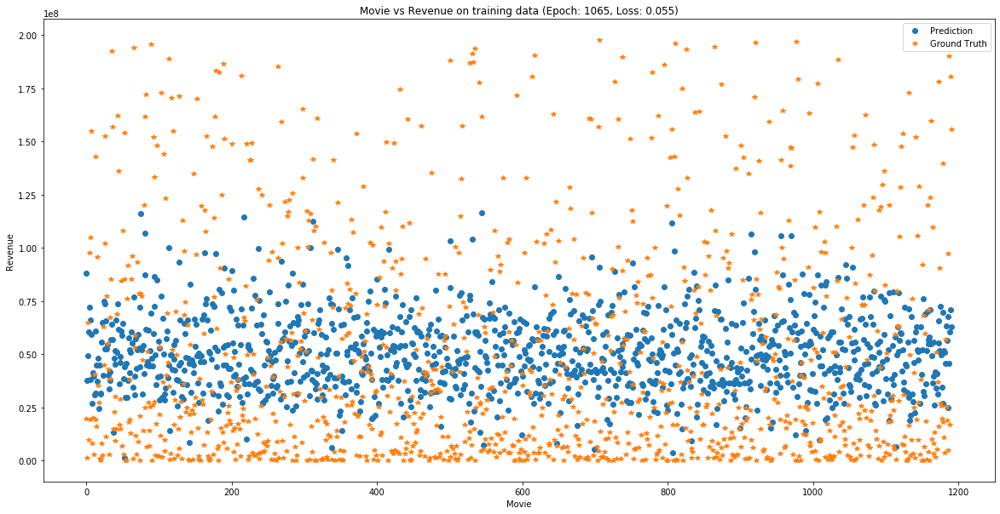

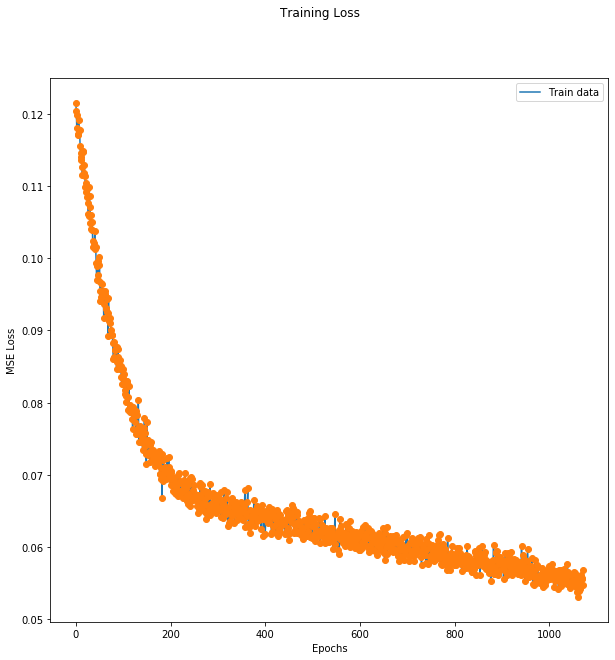

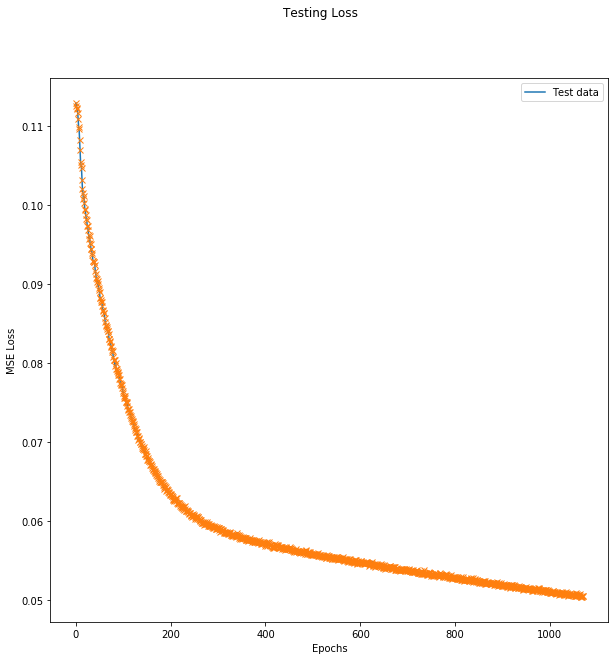

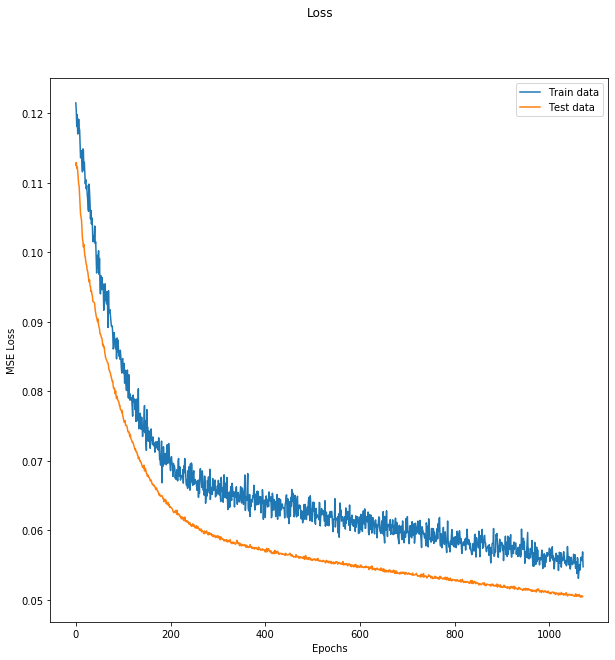

MAPE :  39.2301810896807


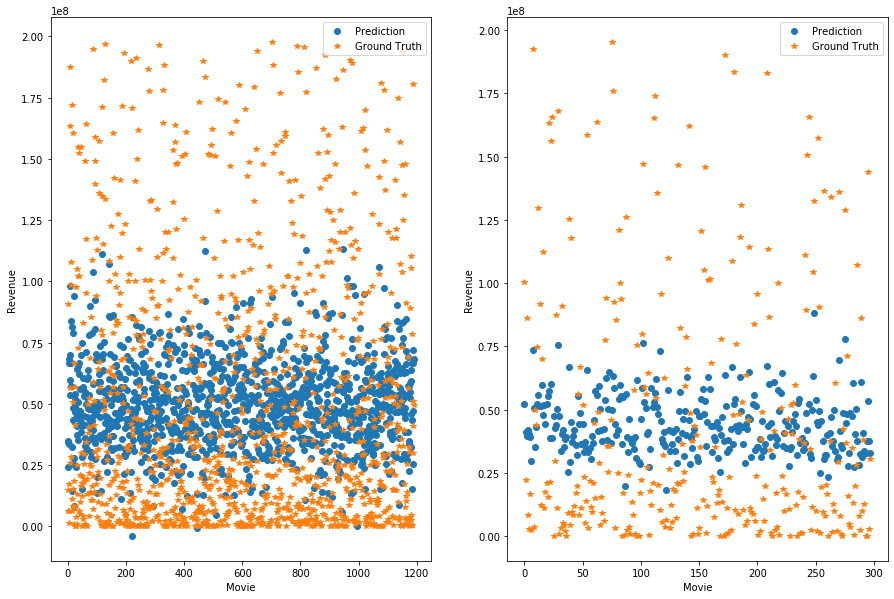

--- Epoch 1072 ---
[Epoch 1072/3000] [Batch 39/40] [Loss: 0.076323 (0.056064)]  [r2: (0.119841)] [rmse: (0.234427)], ETA: 0:46:53.620134
Testing -- [Batch 9/10] [Loss: 0.044994 (0.050462)] [r2: (0.196296)] [rmse: (0.223222)]
--- Epoch 1073 ---
[Epoch 1073/3000] [Batch 39/40] [Loss: 0.072409 (0.056154)]  [r2: (0.125846)] [rmse: (0.233682)], ETA: 0:47:23.881595
Testing -- [Batch 9/10] [Loss: 0.029363 (0.050355)] [r2: (0.182007)] [rmse: (0.219983)]
Train R2 =  0.16938642201640342
Test R2 =  0.2062197196705411


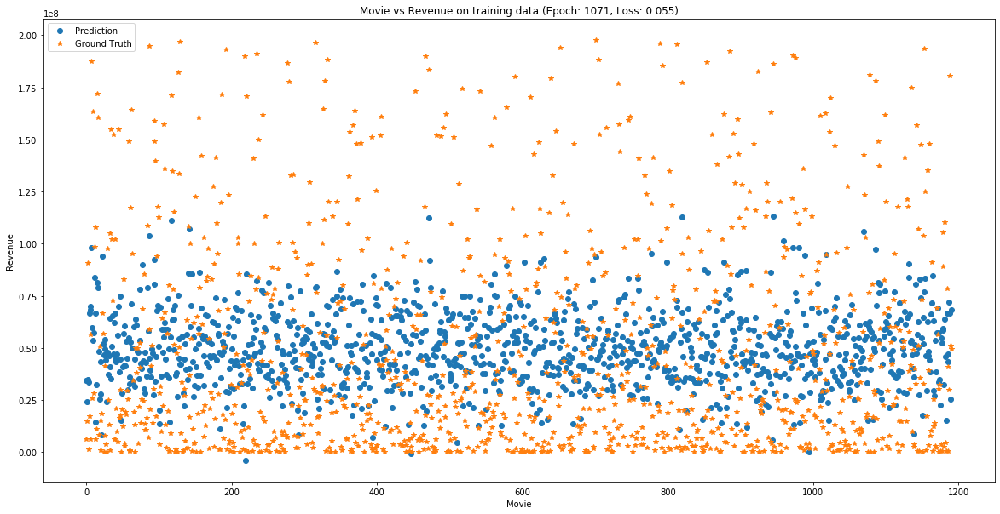

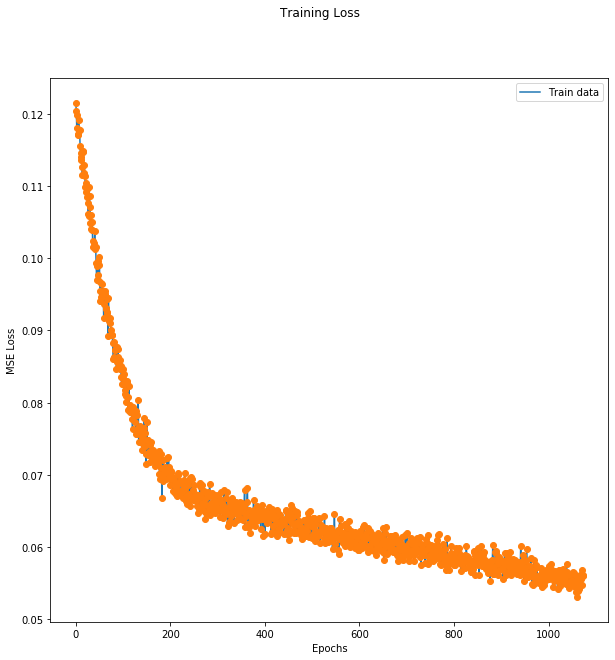

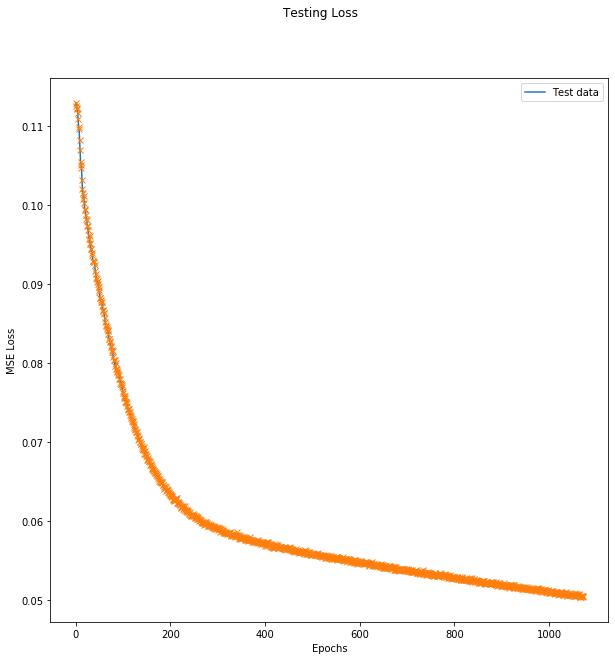

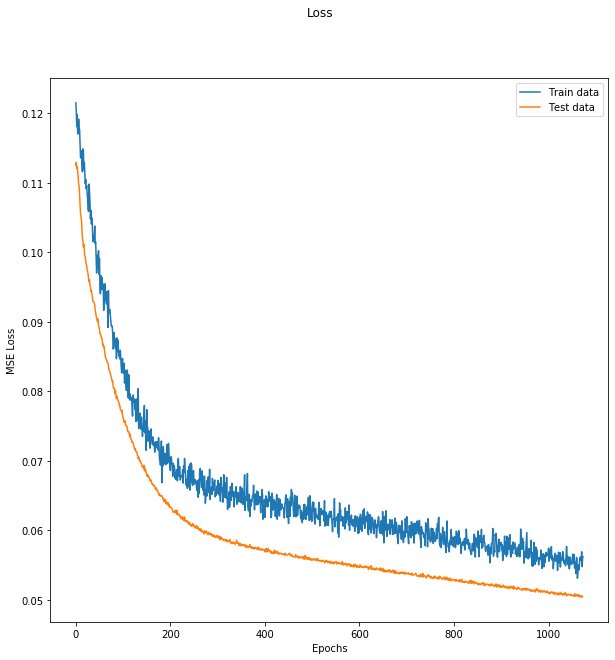

MAPE :  39.22414390008378


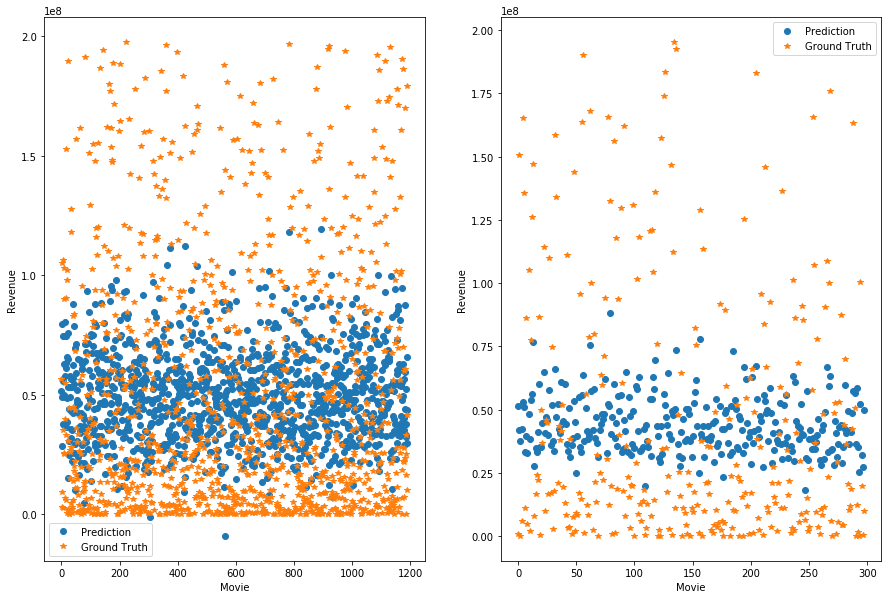

--- Epoch 1074 ---
[Epoch 1074/3000] [Batch 39/40] [Loss: 0.079692 (0.053934)]  [r2: (0.157516)] [rmse: (0.229870)], ETA: 0:44:59.374208
Testing -- [Batch 9/10] [Loss: 0.064334 (0.050571)] [r2: (0.190383)] [rmse: (0.220175)]
--- Epoch 1075 ---
[Epoch 1075/3000] [Batch 39/40] [Loss: 0.061408 (0.054858)]  [r2: (0.152696)] [rmse: (0.232765)], ETA: 0:45:09.641875
Testing -- [Batch 9/10] [Loss: 0.049171 (0.050445)] [r2: (0.191529)] [rmse: (0.223137)]
--- Epoch 1076 ---
[Epoch 1076/3000] [Batch 39/40] [Loss: 0.099065 (0.056288)]  [r2: (0.127964)] [rmse: (0.235032)], ETA: 0:46:11.247718
Testing -- [Batch 9/10] [Loss: 0.055191 (0.050490)] [r2: (0.188980)] [rmse: (0.222026)]
--- Epoch 1077 ---
[Epoch 1077/3000] [Batch 39/40] [Loss: 0.033428 (0.055068)]  [r2: (0.160637)] [rmse: (0.232095)], ETA: 0:44:57.458678
Testing -- [Batch 9/10] [Loss: 0.042957 (0.050393)] [r2: (0.185222)] [rmse: (0.220145)]
--- Epoch 1078 ---
[Epoch 1078/3000] [Batch 39/40] [Loss: 0.052239 (0.054485)]  [r2: (0.143936)] [rm

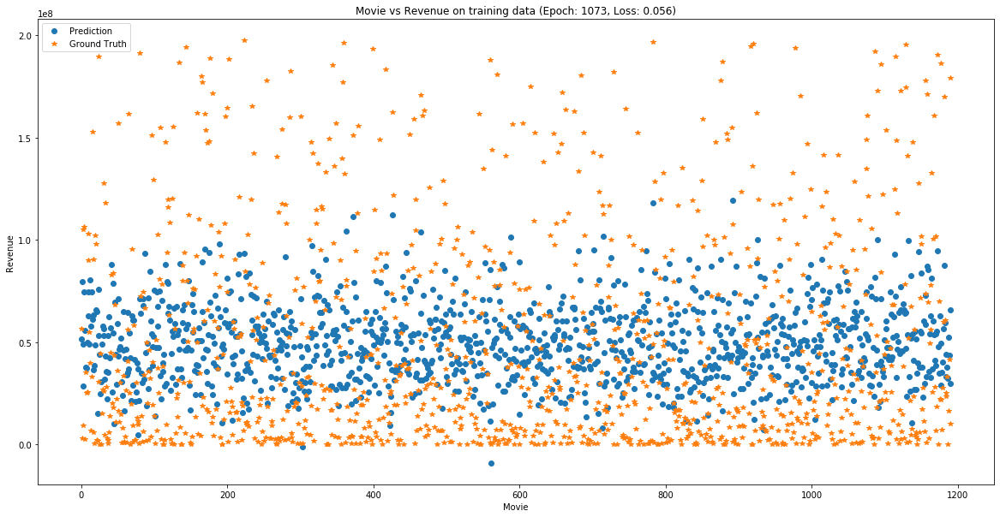

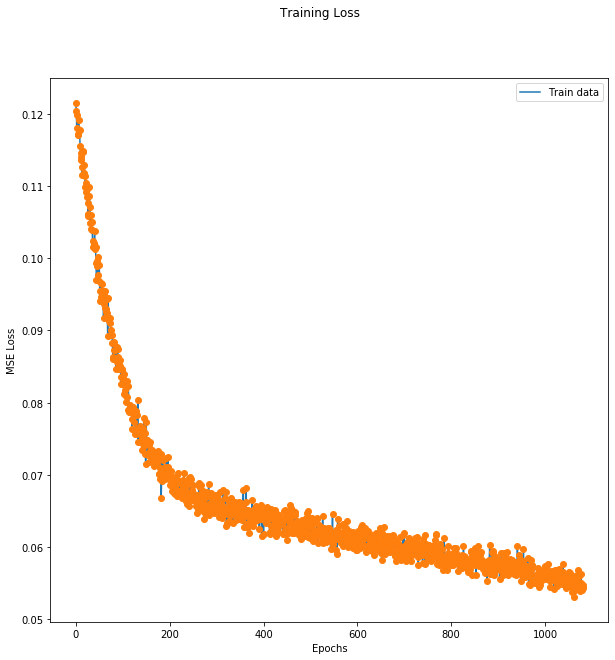

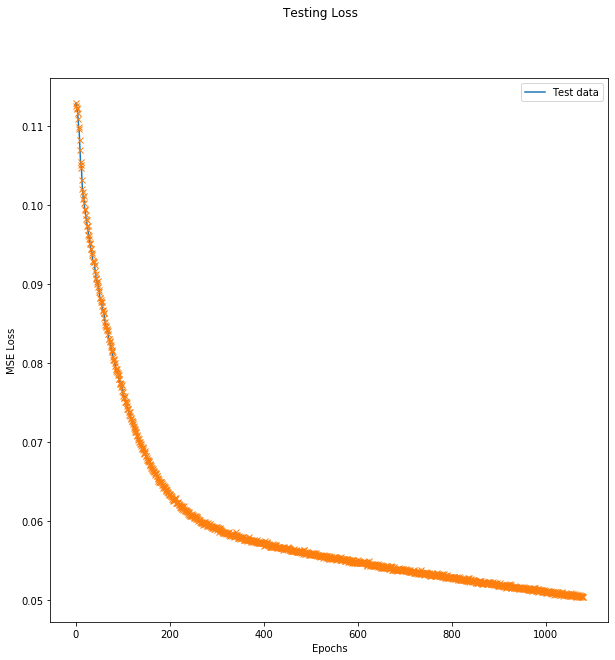

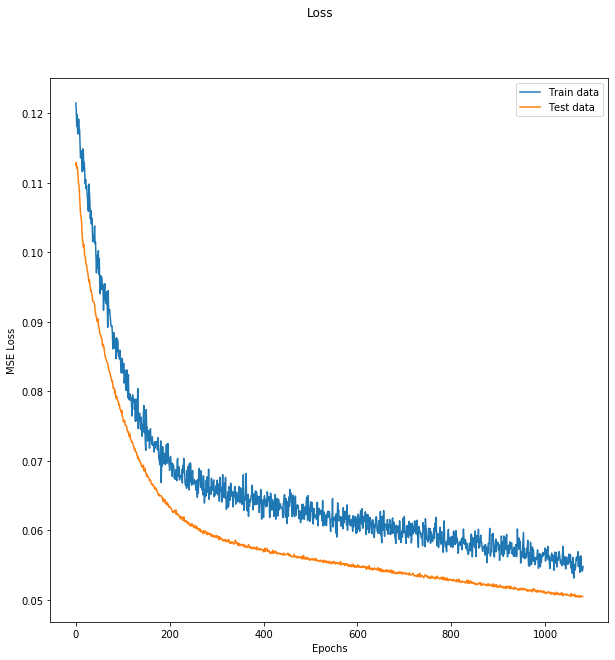

MAPE :  39.00362142564465


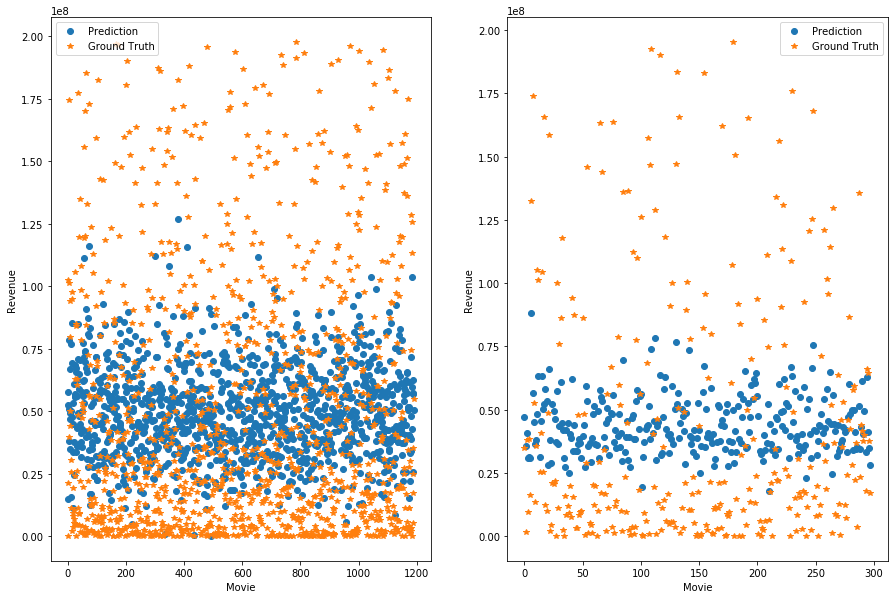

--- Epoch 1082 ---
[Epoch 1082/3000] [Batch 39/40] [Loss: 0.040731 (0.055032)]  [r2: (0.135483)] [rmse: (0.232844)], ETA: 0:46:09.621547
Testing -- [Batch 9/10] [Loss: 0.044618 (0.050335)] [r2: (0.171037)] [rmse: (0.222753)]
--- Epoch 1083 ---
[Epoch 1083/3000] [Batch 39/40] [Loss: 0.081527 (0.054188)]  [r2: (0.134945)] [rmse: (0.230174)], ETA: 0:44:43.318665
Testing -- [Batch 9/10] [Loss: 0.037156 (0.050269)] [r2: (0.188536)] [rmse: (0.222187)]
--- Epoch 1084 ---
[Epoch 1084/3000] [Batch 39/40] [Loss: 0.064003 (0.054208)]  [r2: (0.146298)] [rmse: (0.231077)], ETA: 0:44:37.480270
Testing -- [Batch 9/10] [Loss: 0.027863 (0.050213)] [r2: (0.182750)] [rmse: (0.221569)]
--- Epoch 1085 ---
[Epoch 1085/3000] [Batch 39/40] [Loss: 0.052522 (0.053890)]  [r2: (0.155765)] [rmse: (0.230419)], ETA: 0:47:20.163420
Testing -- [Batch 9/10] [Loss: 0.068243 (0.050461)] [r2: (0.195461)] [rmse: (0.222972)]
--- Epoch 1086 ---
[Epoch 1086/3000] [Batch 39/40] [Loss: 0.068317 (0.055069)]  [r2: (0.130539)] [rm

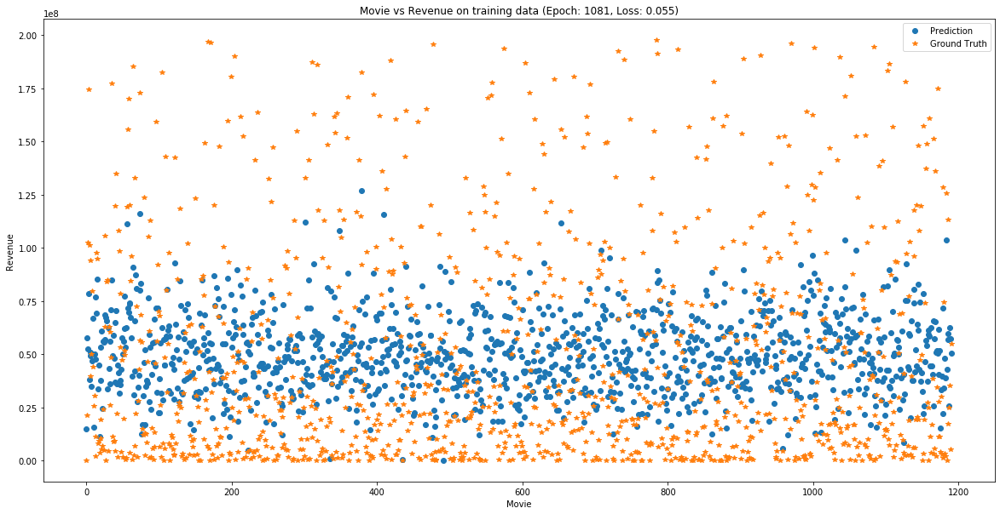

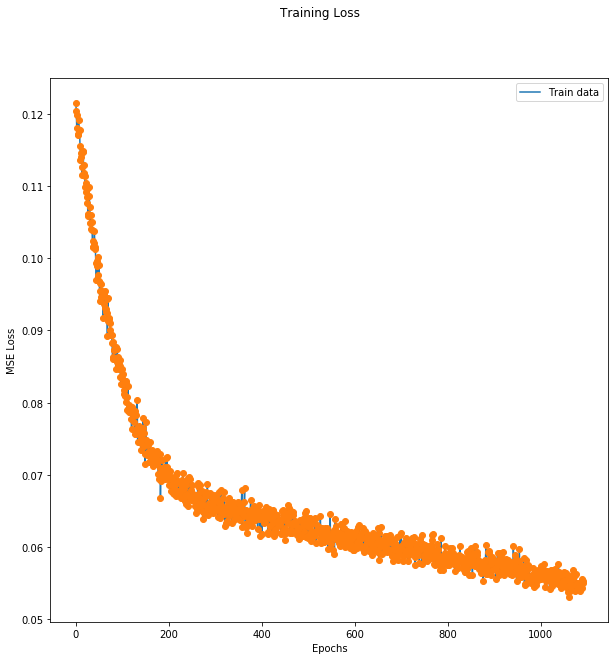

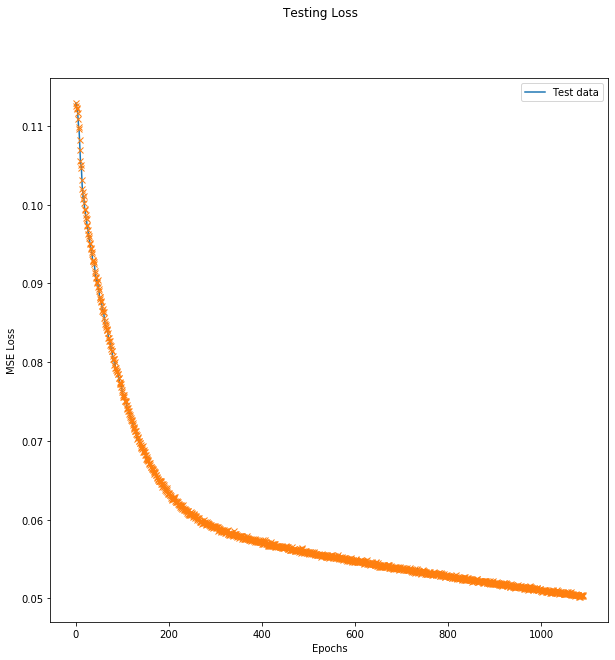

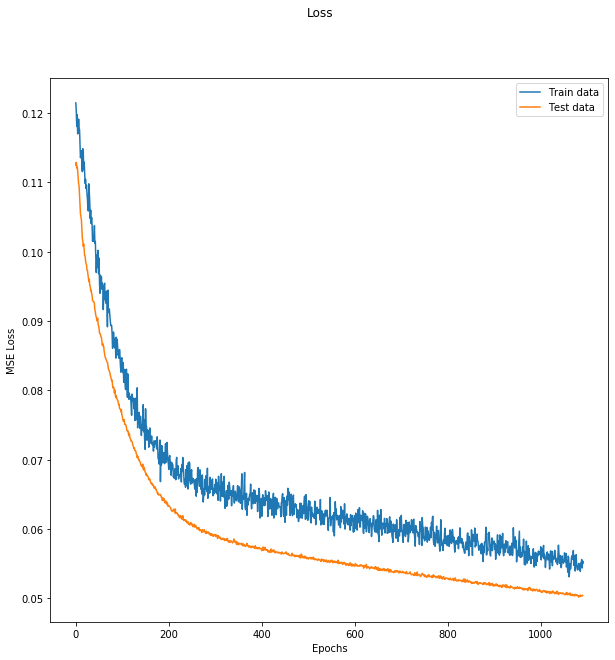

MAPE :  39.075673367085095


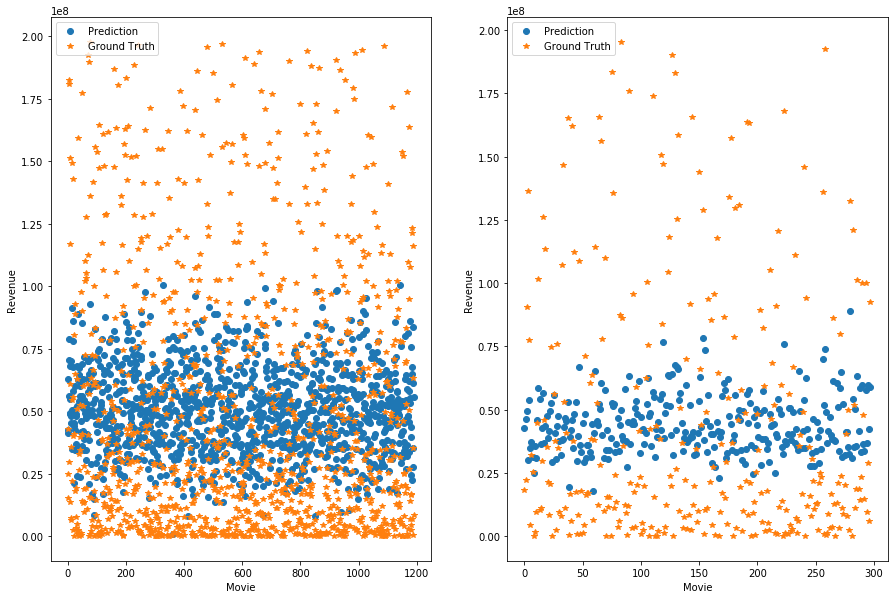

--- Epoch 1092 ---
[Epoch 1092/3000] [Batch 39/40] [Loss: 0.034428 (0.053049)]  [r2: (0.155617)] [rmse: (0.227750)], ETA: 0:44:33.515282
Testing -- [Batch 9/10] [Loss: 0.049341 (0.050297)] [r2: (0.201093)] [rmse: (0.223780)]
--- Epoch 1093 ---
[Epoch 1093/3000] [Batch 39/40] [Loss: 0.047908 (0.053252)]  [r2: (0.183889)] [rmse: (0.229514)], ETA: 0:44:56.016464
Testing -- [Batch 9/10] [Loss: 0.065086 (0.050372)] [r2: (0.189551)] [rmse: (0.220357)]
--- Epoch 1094 ---
[Epoch 1094/3000] [Batch 39/40] [Loss: 0.095271 (0.054975)]  [r2: (0.158343)] [rmse: (0.232264)], ETA: 0:44:25.733464
Testing -- [Batch 9/10] [Loss: 0.115324 (0.050709)] [r2: (0.191157)] [rmse: (0.220696)]
--- Epoch 1095 ---
[Epoch 1095/3000] [Batch 39/40] [Loss: 0.027160 (0.055164)]  [r2: (0.139767)] [rmse: (0.232574)], ETA: 0:44:25.151266
Testing -- [Batch 9/10] [Loss: 0.058570 (0.050316)] [r2: (0.187734)] [rmse: (0.221703)]
--- Epoch 1096 ---
[Epoch 1096/3000] [Batch 39/40] [Loss: 0.089318 (0.054727)]  [r2: (0.137677)] [rm

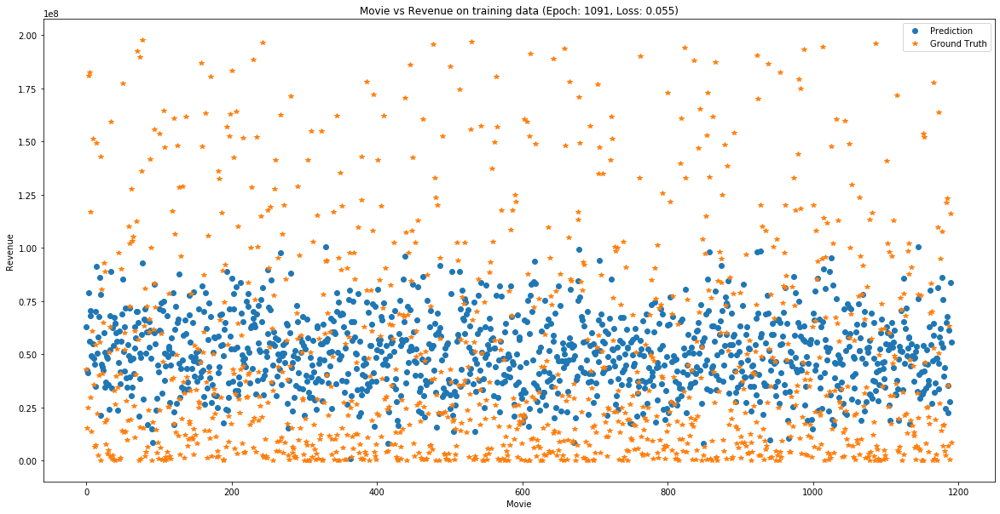

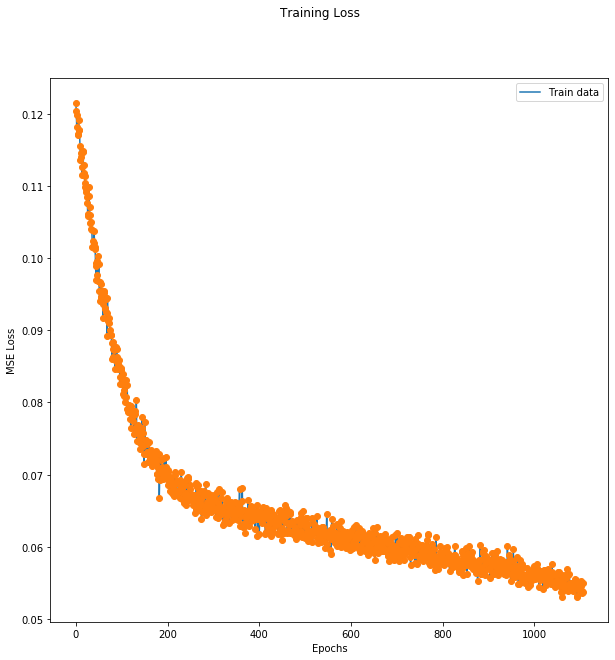

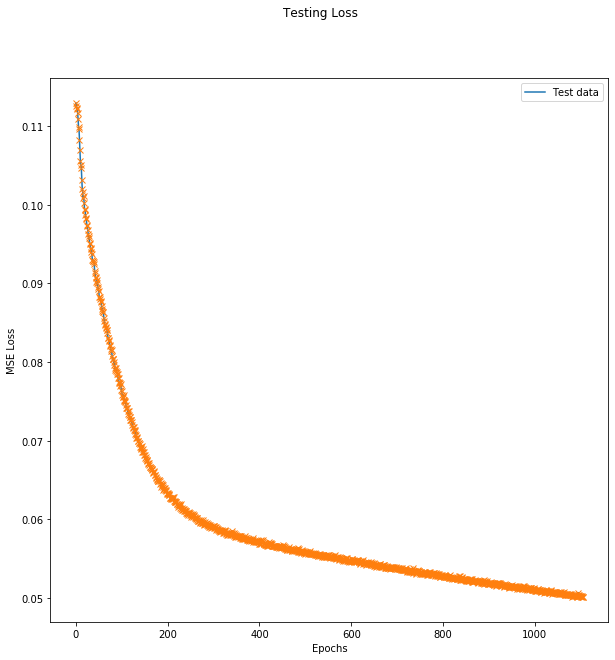

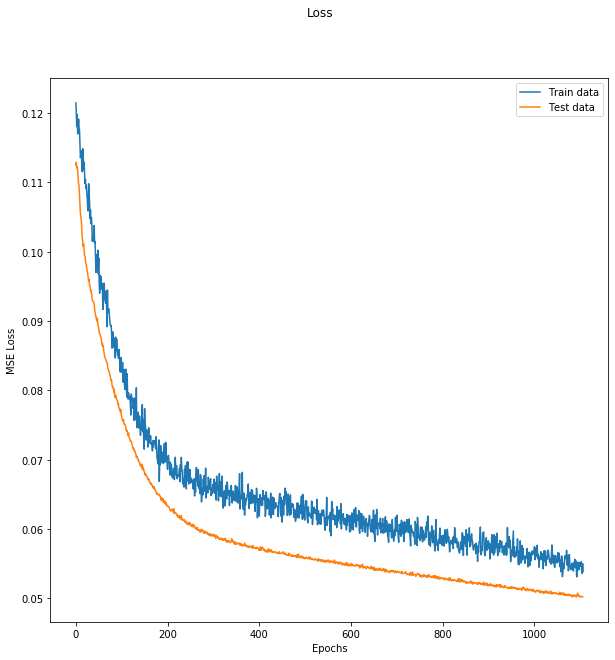

MAPE :  38.79688379461196


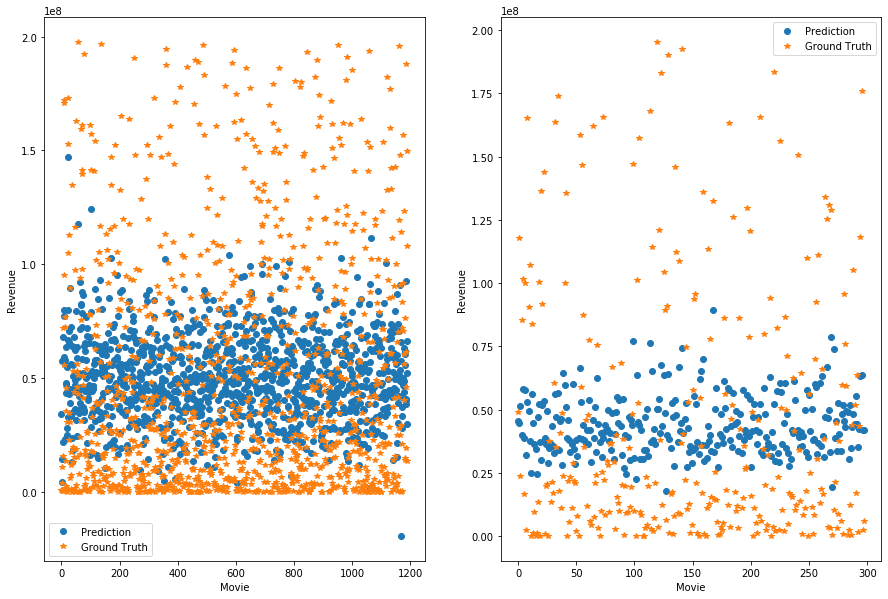

--- Epoch 1107 ---
[Epoch 1107/3000] [Batch 39/40] [Loss: 0.038833 (0.053267)]  [r2: (0.152587)] [rmse: (0.227796)], ETA: 0:44:18.837737
Testing -- [Batch 9/10] [Loss: 0.031424 (0.050042)] [r2: (0.142812)] [rmse: (0.220404)]
Train R2 =  0.2087439651489783
Test R2 =  0.21139523433053375


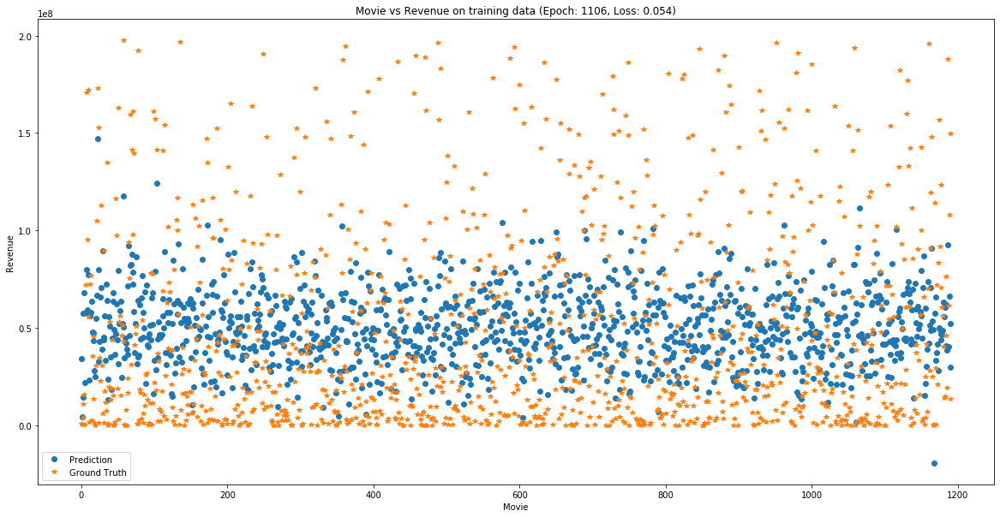

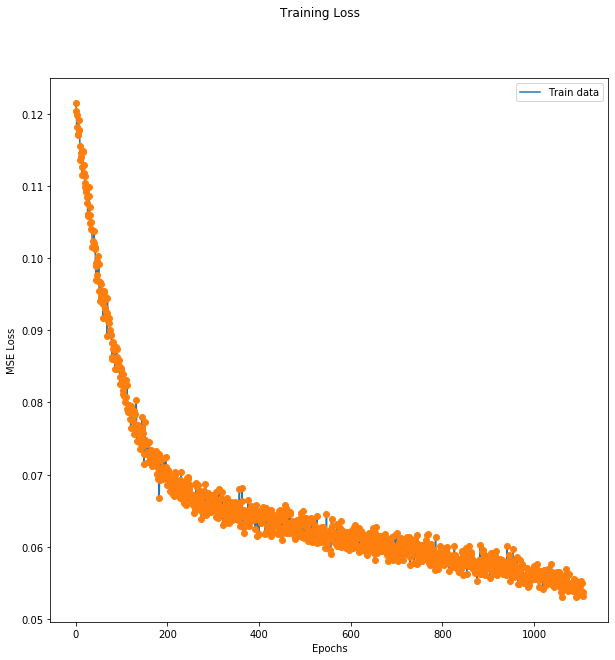

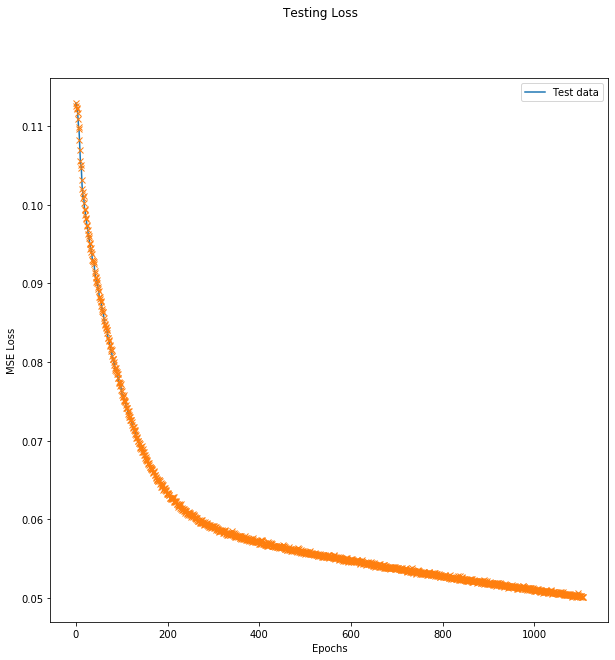

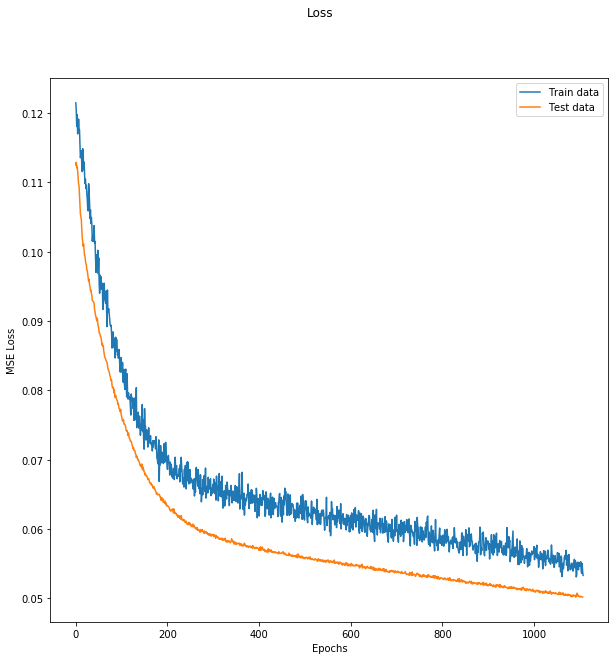

MAPE :  38.897750377803604


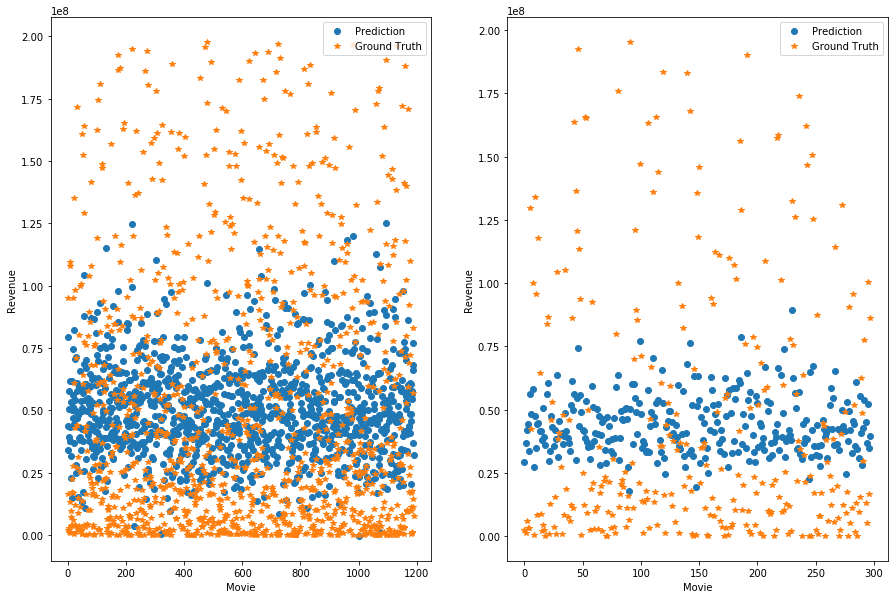

--- Epoch 1108 ---
[Epoch 1108/3000] [Batch 39/40] [Loss: 0.049247 (0.053118)]  [r2: (0.178881)] [rmse: (0.228354)], ETA: 0:44:18.766982
Testing -- [Batch 9/10] [Loss: 0.050159 (0.050149)] [r2: (0.176601)] [rmse: (0.222540)]
--- Epoch 1109 ---
[Epoch 1109/3000] [Batch 39/40] [Loss: 0.078326 (0.055384)]  [r2: (0.134669)] [rmse: (0.233748)], ETA: 0:46:02.426867
Testing -- [Batch 9/10] [Loss: 0.068583 (0.050275)] [r2: (0.201574)] [rmse: (0.220454)]
--- Epoch 1110 ---
[Epoch 1110/3000] [Batch 39/40] [Loss: 0.038194 (0.054765)]  [r2: (0.149044)] [rmse: (0.231572)], ETA: 0:46:52.380512
Testing -- [Batch 9/10] [Loss: 0.080311 (0.050362)] [r2: (0.189893)] [rmse: (0.222691)]
--- Epoch 1111 ---
[Epoch 1111/3000] [Batch 39/40] [Loss: 0.036608 (0.054899)]  [r2: (0.133637)] [rmse: (0.231515)], ETA: 0:47:01.731089
Testing -- [Batch 9/10] [Loss: 0.055511 (0.050189)] [r2: (0.178802)] [rmse: (0.221476)]
--- Epoch 1112 ---
[Epoch 1112/3000] [Batch 39/40] [Loss: 0.030905 (0.055346)]  [r2: (0.149628)] [rm

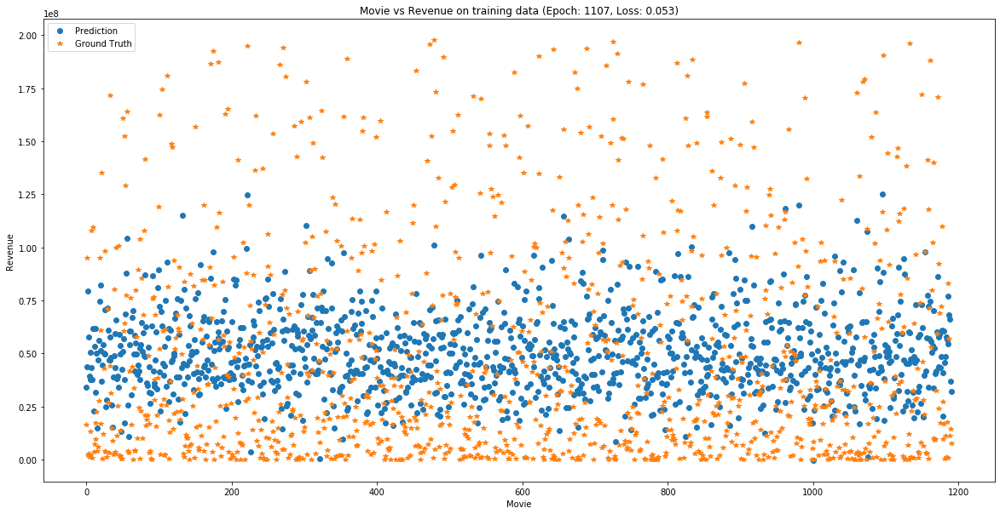

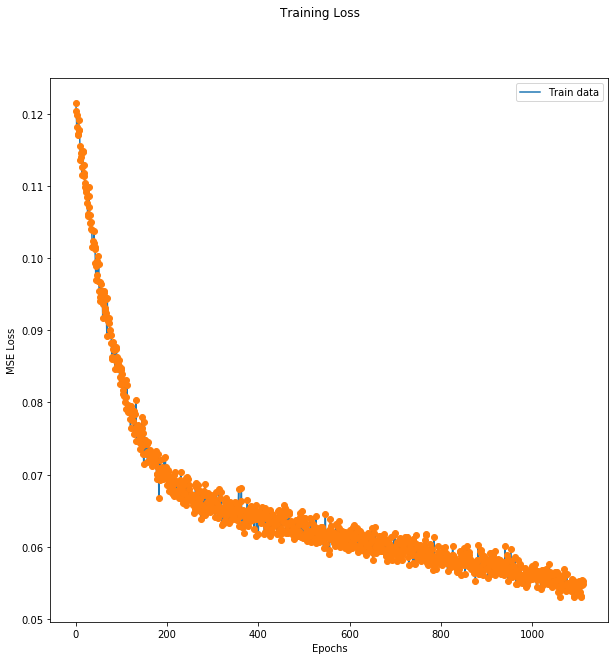

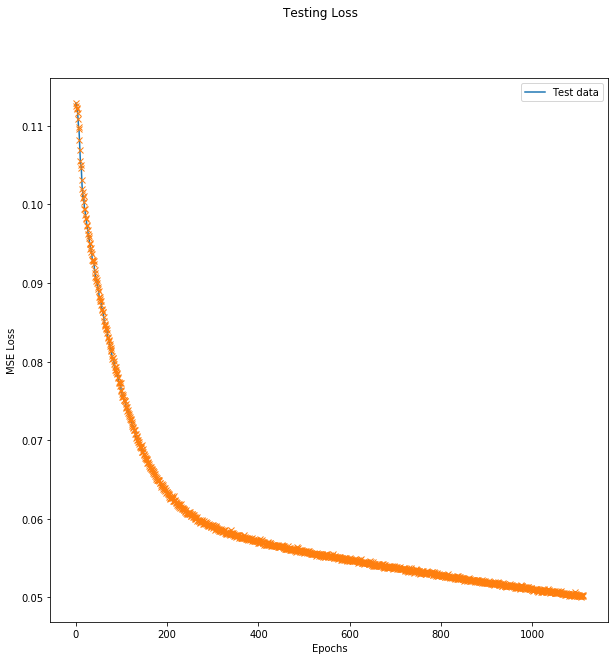

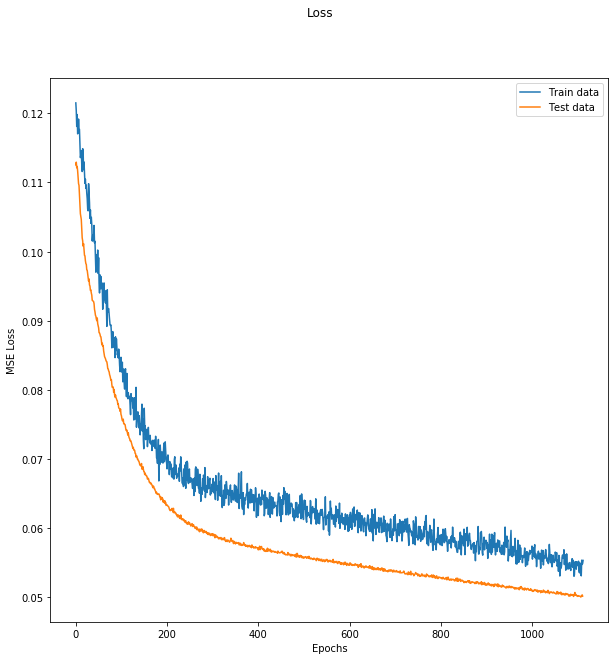

MAPE :  38.88498243951821


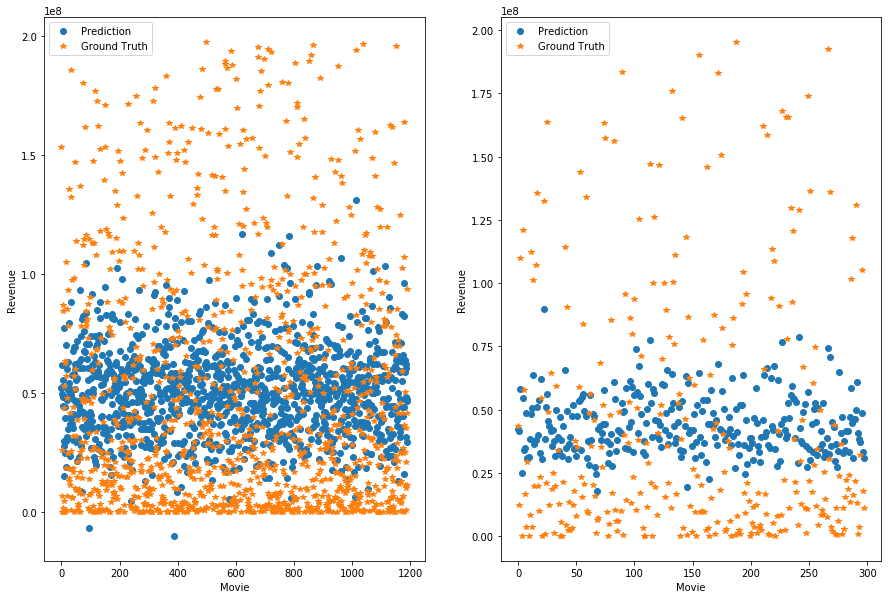

--- Epoch 1113 ---
[Epoch 1113/3000] [Batch 39/40] [Loss: 0.045839 (0.055720)]  [r2: (0.138638)] [rmse: (0.234319)], ETA: 0:44:14.237148
Testing -- [Batch 9/10] [Loss: 0.030172 (0.049999)] [r2: (0.190497)] [rmse: (0.219792)]
Train R2 =  0.17289396001183022
Test R2 =  0.21194415860190652


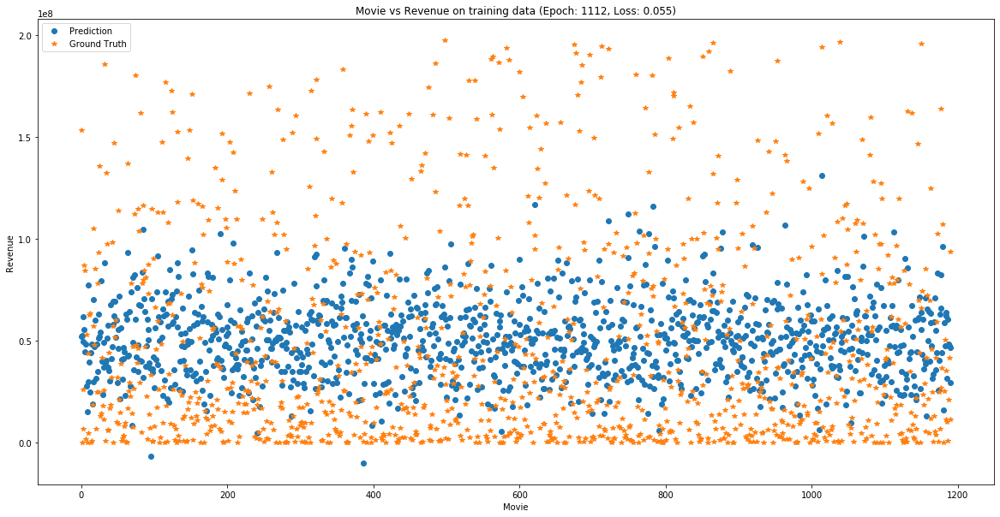

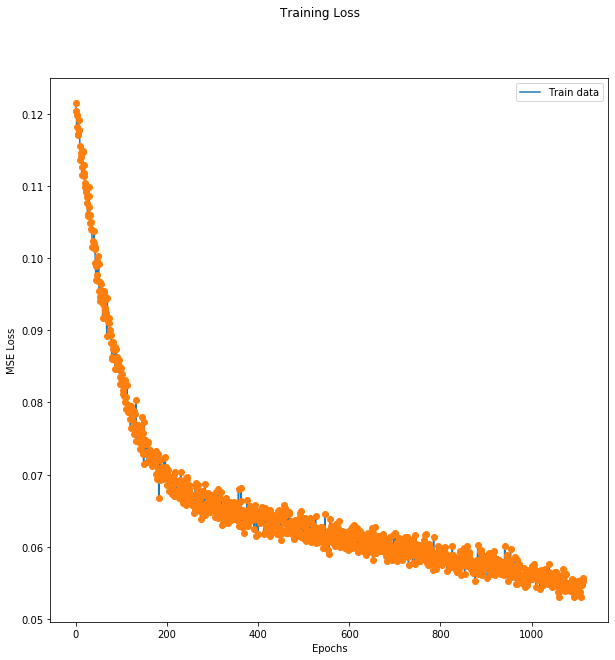

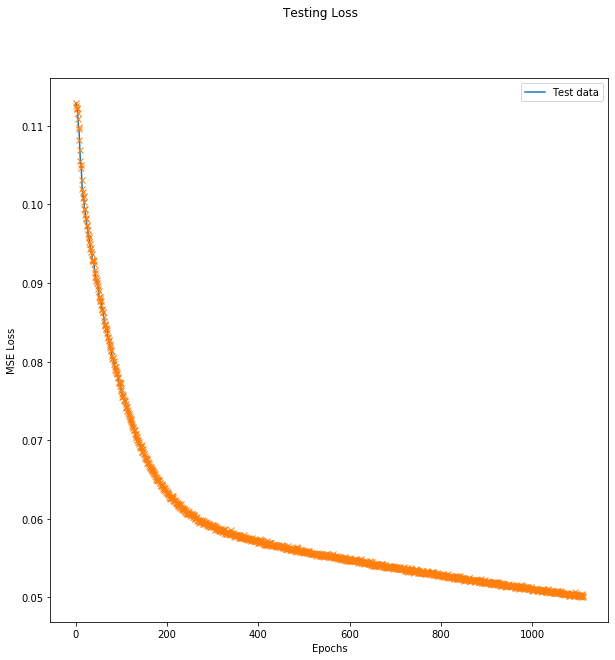

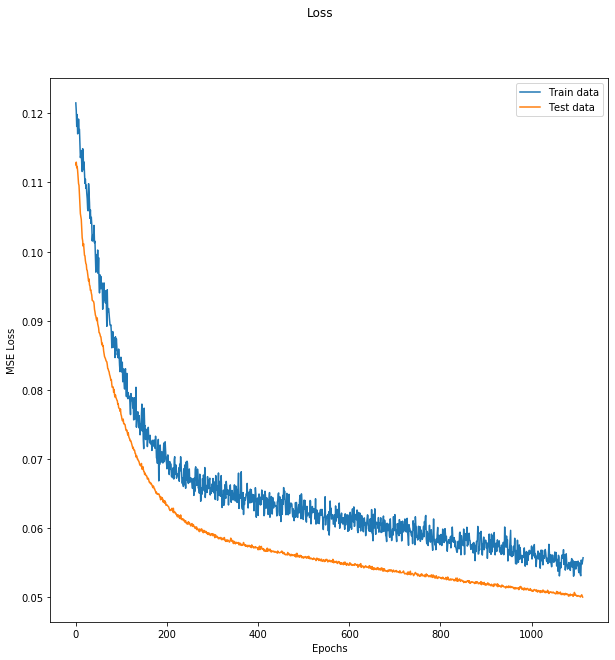

MAPE :  38.92389780597538


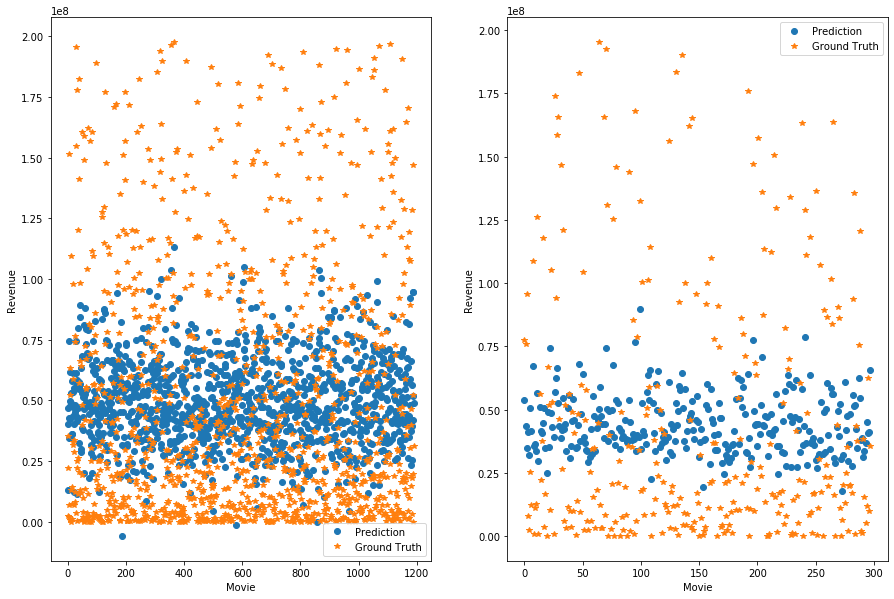

--- Epoch 1114 ---
[Epoch 1114/3000] [Batch 39/40] [Loss: 0.045037 (0.054464)]  [r2: (0.151164)] [rmse: (0.231467)], ETA: 0:44:53.727504
Testing -- [Batch 9/10] [Loss: 0.030755 (0.050002)] [r2: (0.211375)] [rmse: (0.221515)]
--- Epoch 1115 ---
[Epoch 1115/3000] [Batch 39/40] [Loss: 0.053765 (0.055276)]  [r2: (0.140617)] [rmse: (0.233659)], ETA: 0:46:32.503028
Testing -- [Batch 9/10] [Loss: 0.033673 (0.050007)] [r2: (0.160564)] [rmse: (0.220523)]
--- Epoch 1116 ---
[Epoch 1116/3000] [Batch 39/40] [Loss: 0.060692 (0.057148)]  [r2: (0.111276)] [rmse: (0.236366)], ETA: 0:46:12.793533
Testing -- [Batch 9/10] [Loss: 0.067615 (0.050223)] [r2: (0.190320)] [rmse: (0.222650)]
--- Epoch 1117 ---
[Epoch 1117/3000] [Batch 39/40] [Loss: 0.034260 (0.052520)]  [r2: (0.199509)] [rmse: (0.226862)], ETA: 0:44:44.163635
Testing -- [Batch 9/10] [Loss: 0.059306 (0.050157)] [r2: (0.181281)] [rmse: (0.221881)]
--- Epoch 1118 ---
[Epoch 1118/3000] [Batch 39/40] [Loss: 0.057045 (0.055610)]  [r2: (0.150274)] [rm

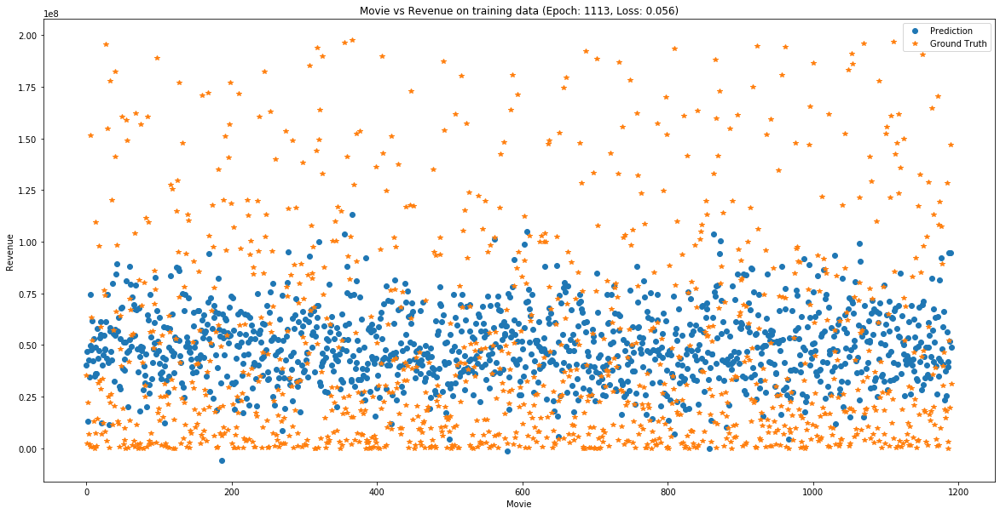

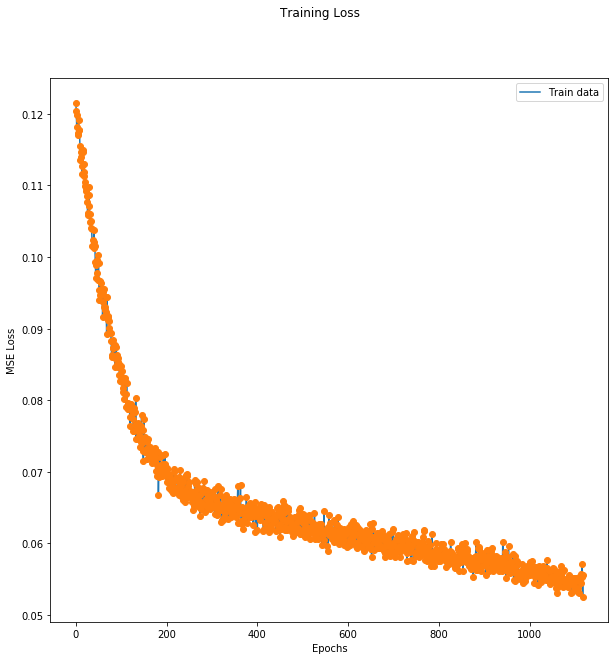

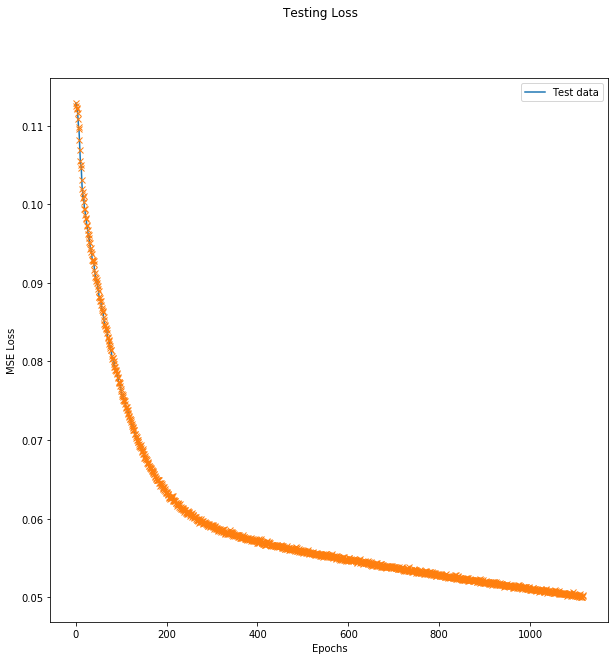

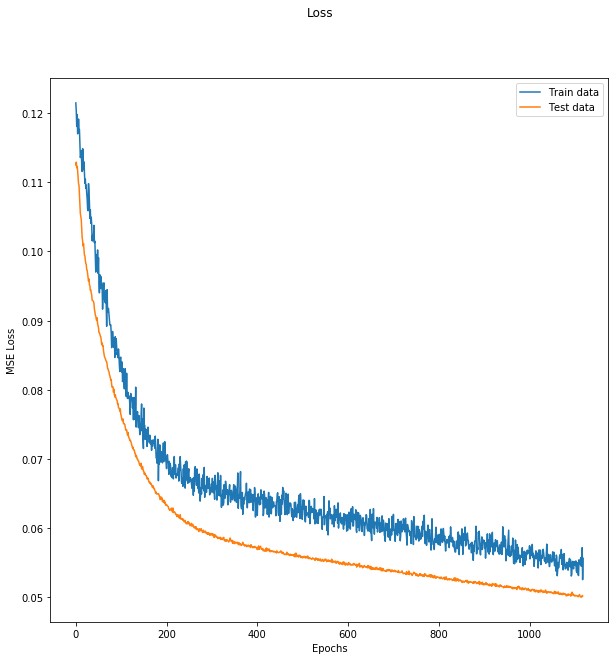

MAPE :  38.871892160706956


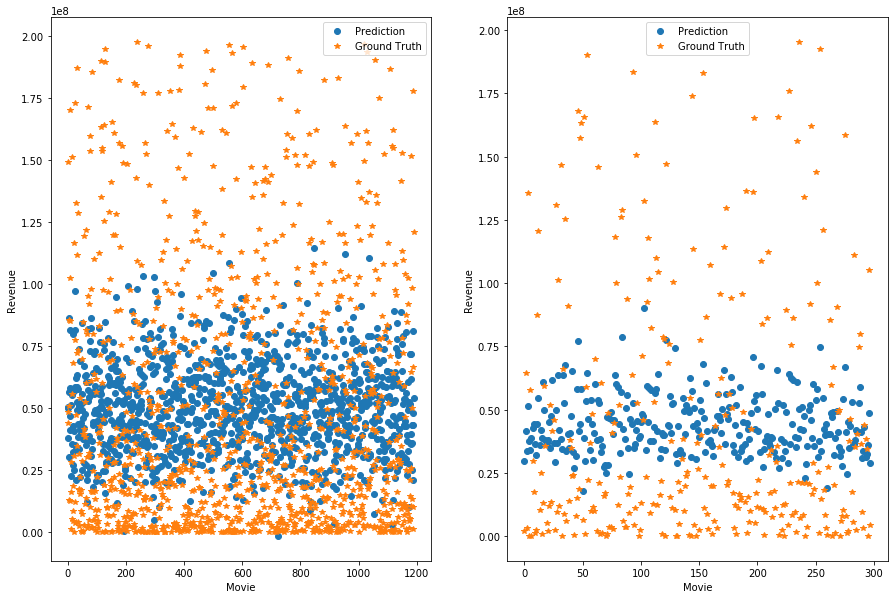

--- Epoch 1119 ---
[Epoch 1119/3000] [Batch 39/40] [Loss: 0.051248 (0.055851)]  [r2: (0.135630)] [rmse: (0.234172)], ETA: 0:44:00.557879
Testing -- [Batch 9/10] [Loss: 0.070442 (0.050220)] [r2: (0.188971)] [rmse: (0.222141)]
--- Epoch 1120 ---
[Epoch 1120/3000] [Batch 39/40] [Loss: 0.059275 (0.054107)]  [r2: (0.154909)] [rmse: (0.229984)], ETA: 0:44:22.932893
Testing -- [Batch 9/10] [Loss: 0.067310 (0.050199)] [r2: (0.179663)] [rmse: (0.221268)]
--- Epoch 1121 ---
[Epoch 1121/3000] [Batch 39/40] [Loss: 0.085271 (0.055851)]  [r2: (0.135546)] [rmse: (0.233673)], ETA: 0:46:11.412949
Testing -- [Batch 9/10] [Loss: 0.036501 (0.049977)] [r2: (0.197496)] [rmse: (0.222028)]
--- Epoch 1122 ---
[Epoch 1122/3000] [Batch 39/40] [Loss: 0.049898 (0.054221)]  [r2: (0.136710)] [rmse: (0.230225)], ETA: 0:44:22.533011
Testing -- [Batch 9/10] [Loss: 0.033725 (0.049970)] [r2: (0.211797)] [rmse: (0.222072)]
--- Epoch 1123 ---
[Epoch 1123/3000] [Batch 39/40] [Loss: 0.101263 (0.054301)]  [r2: (0.161044)] [rm

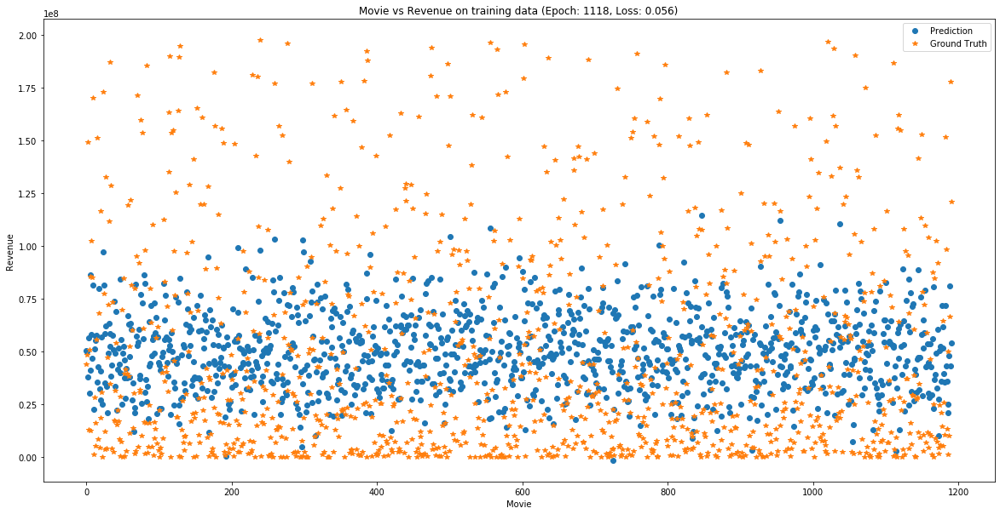

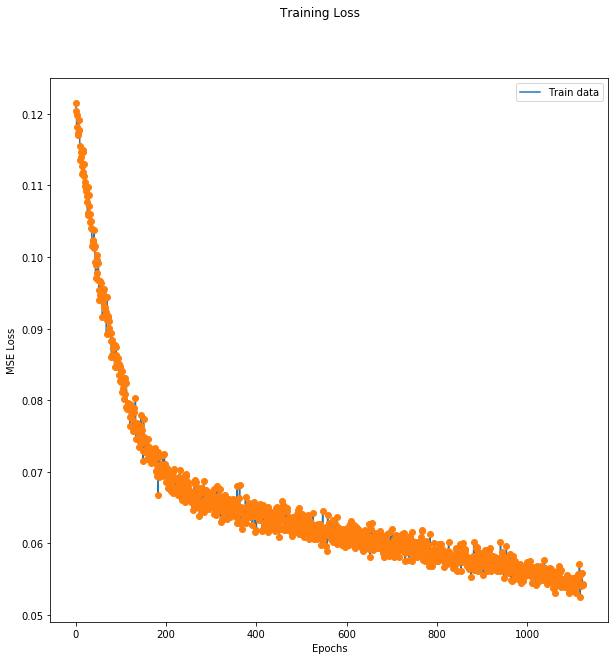

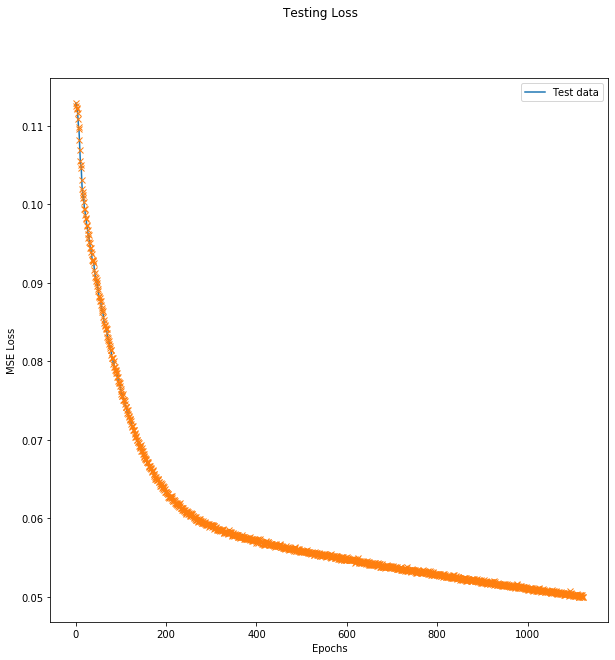

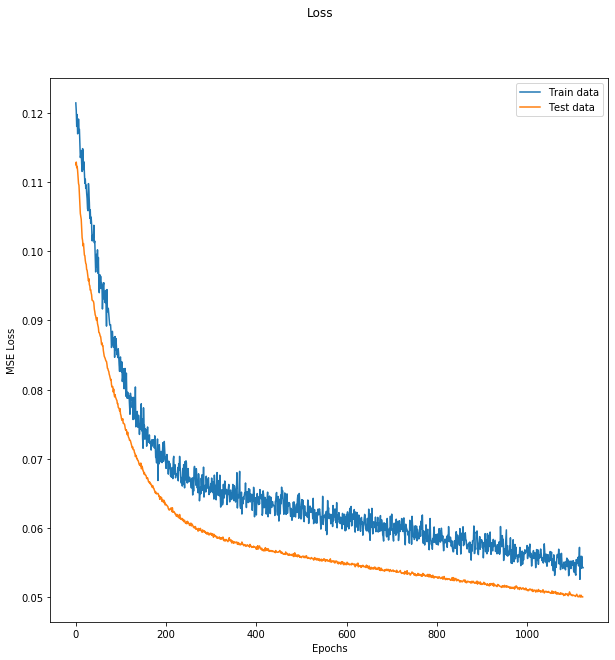

MAPE :  38.68886336266365


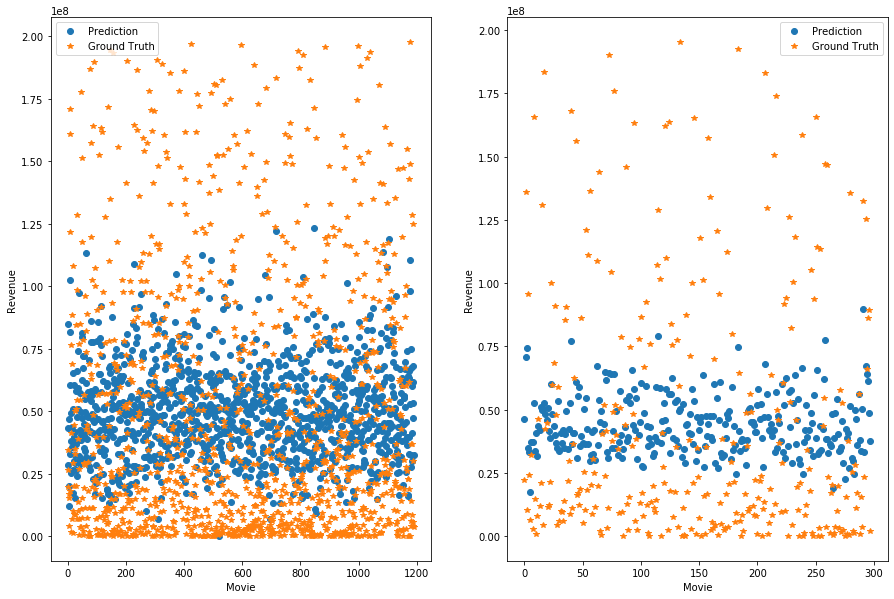

--- Epoch 1125 ---
[Epoch 1125/3000] [Batch 39/40] [Loss: 0.038373 (0.054355)]  [r2: (0.137330)] [rmse: (0.230740)], ETA: 0:44:09.180658
Testing -- [Batch 9/10] [Loss: 0.074715 (0.050200)] [r2: (0.200446)] [rmse: (0.221183)]
--- Epoch 1126 ---
[Epoch 1126/3000] [Batch 39/40] [Loss: 0.047561 (0.055442)]  [r2: (0.139906)] [rmse: (0.233649)], ETA: 0:44:05.855733
Testing -- [Batch 9/10] [Loss: 0.042704 (0.049994)] [r2: (0.186267)] [rmse: (0.221338)]
--- Epoch 1127 ---
[Epoch 1127/3000] [Batch 39/40] [Loss: 0.056907 (0.054757)]  [r2: (0.139329)] [rmse: (0.232684)], ETA: 0:44:37.328387
Testing -- [Batch 9/10] [Loss: 0.078656 (0.050206)] [r2: (0.158836)] [rmse: (0.222660)]
--- Epoch 1128 ---
[Epoch 1128/3000] [Batch 39/40] [Loss: 0.049045 (0.055174)]  [r2: (0.135005)] [rmse: (0.231986)], ETA: 0:44:51.582633
Testing -- [Batch 9/10] [Loss: 0.044422 (0.049967)] [r2: (0.157118)] [rmse: (0.220034)]
--- Epoch 1129 ---
[Epoch 1129/3000] [Batch 39/40] [Loss: 0.044123 (0.056100)]  [r2: (0.136974)] [rm

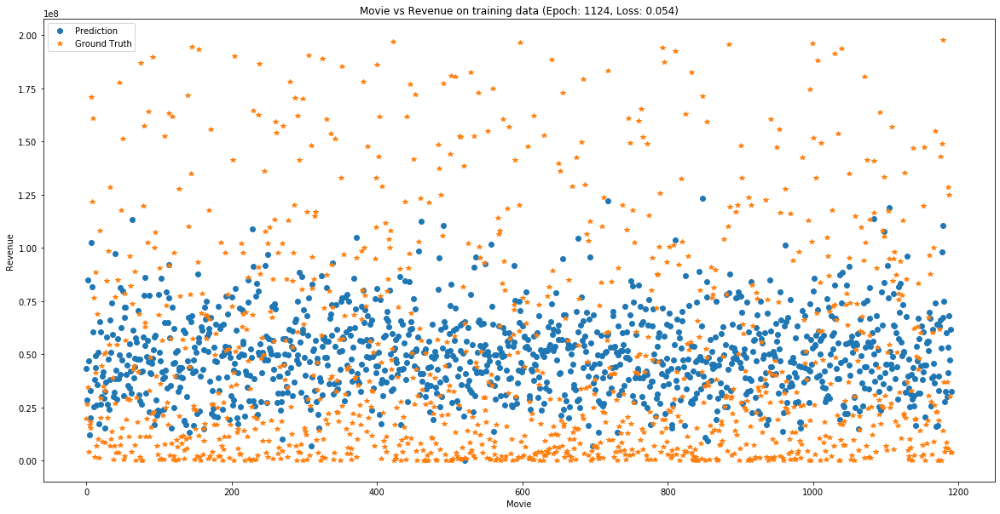

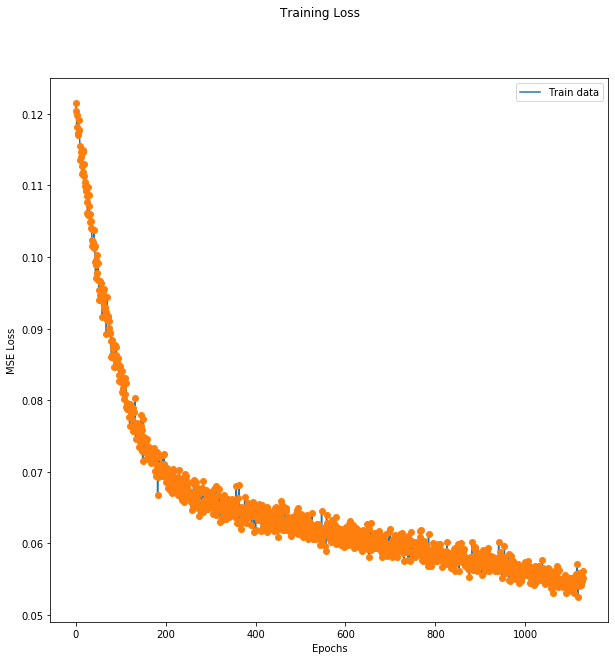

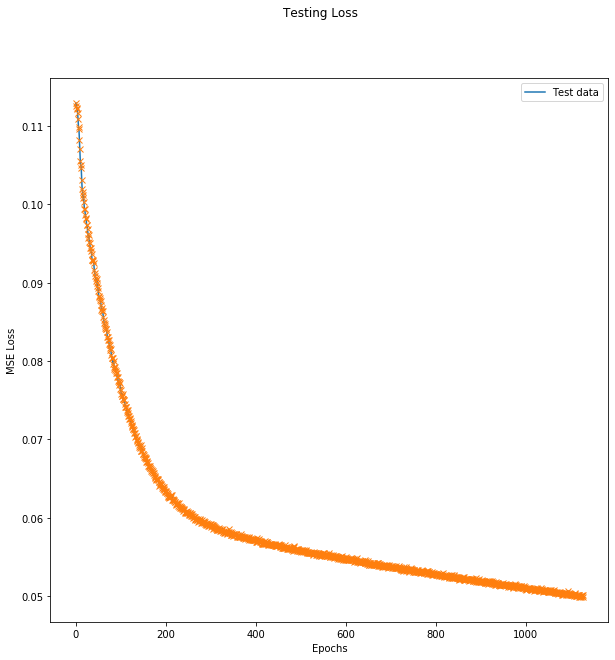

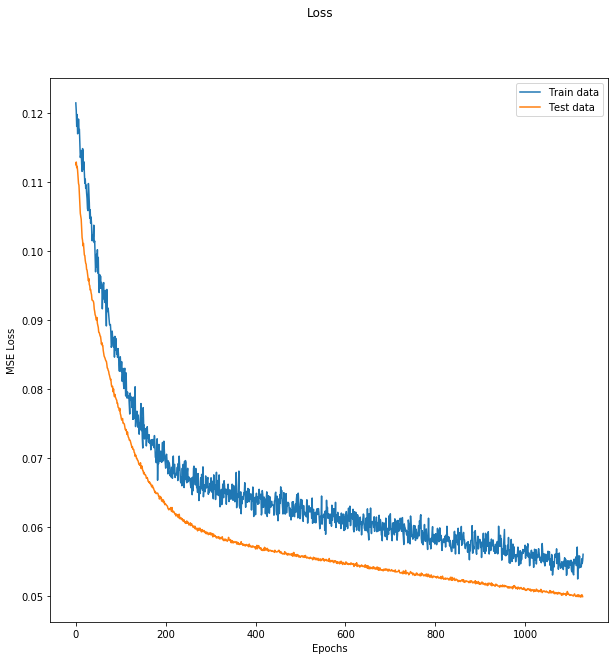

MAPE :  38.78521135797521


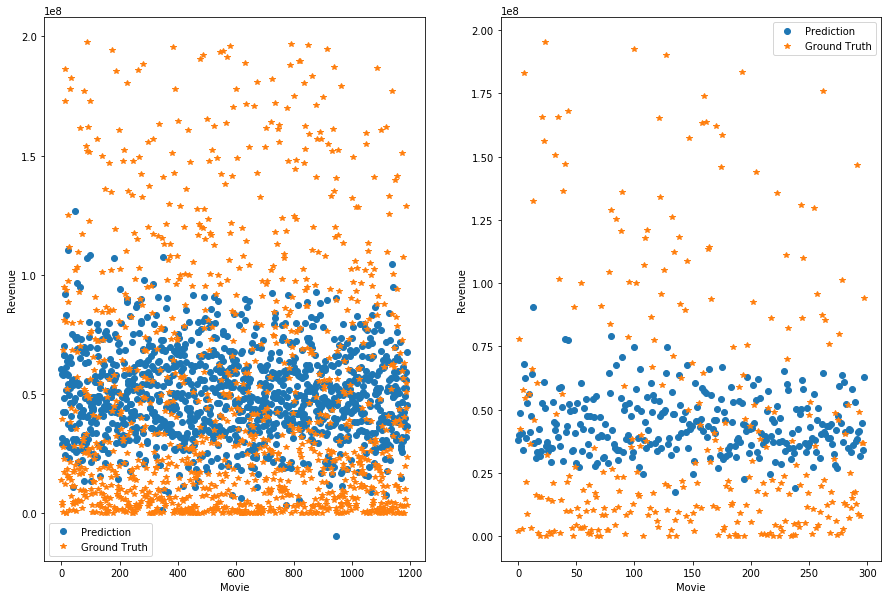

--- Epoch 1130 ---
[Epoch 1130/3000] [Batch 39/40] [Loss: 0.049396 (0.054858)]  [r2: (0.123292)] [rmse: (0.231908)], ETA: 0:44:52.359516
Testing -- [Batch 9/10] [Loss: 0.029174 (0.049889)] [r2: (0.197366)] [rmse: (0.220244)]
--- Epoch 1131 ---
[Epoch 1131/3000] [Batch 39/40] [Loss: 0.063230 (0.056717)]  [r2: (0.105177)] [rmse: (0.235381)], ETA: 0:46:13.063388
Testing -- [Batch 9/10] [Loss: 0.064535 (0.050097)] [r2: (0.191678)] [rmse: (0.220750)]
--- Epoch 1132 ---
[Epoch 1132/3000] [Batch 39/40] [Loss: 0.046936 (0.054879)]  [r2: (0.149783)] [rmse: (0.232600)], ETA: 0:44:11.659948
Testing -- [Batch 9/10] [Loss: 0.035757 (0.049910)] [r2: (0.170684)] [rmse: (0.219550)]
--- Epoch 1133 ---
[Epoch 1133/3000] [Batch 39/40] [Loss: 0.047439 (0.054927)]  [r2: (0.148860)] [rmse: (0.232179)], ETA: 0:46:06.873369
Testing -- [Batch 9/10] [Loss: 0.055915 (0.050032)] [r2: (0.183979)] [rmse: (0.221165)]
--- Epoch 1134 ---
[Epoch 1134/3000] [Batch 39/40] [Loss: 0.062191 (0.055906)]  [r2: (0.138321)] [rm

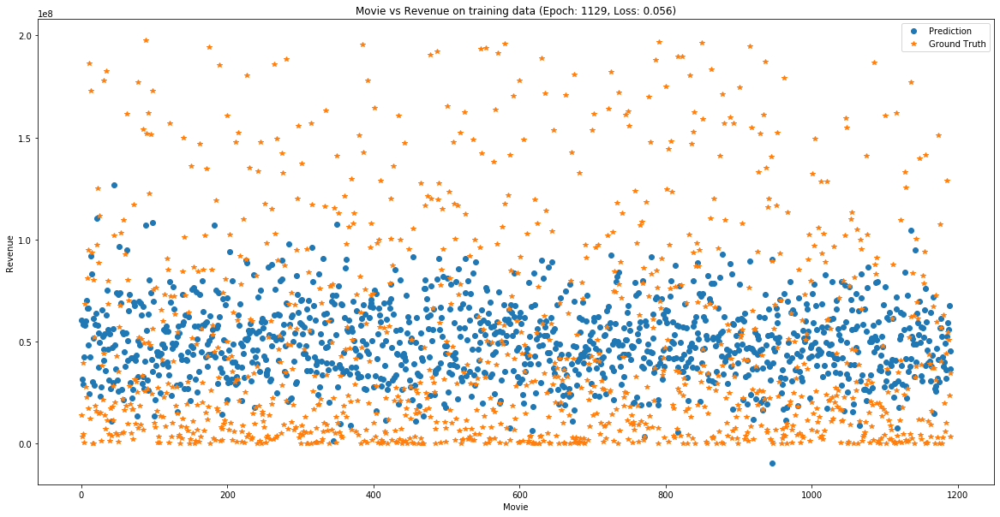

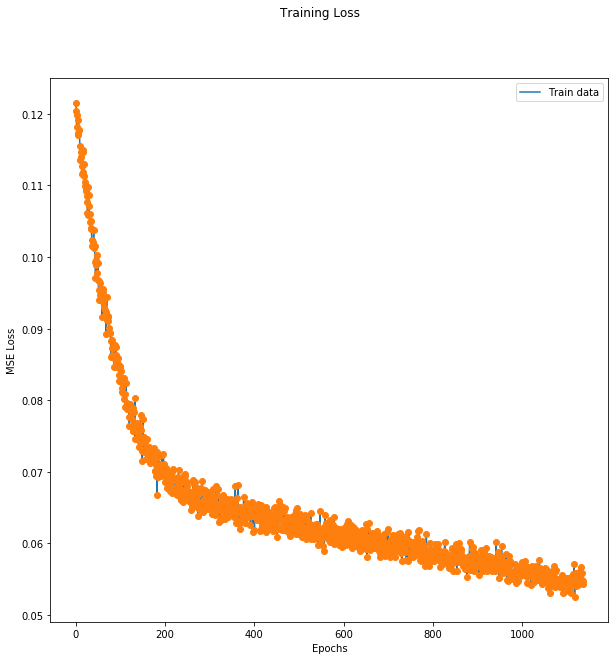

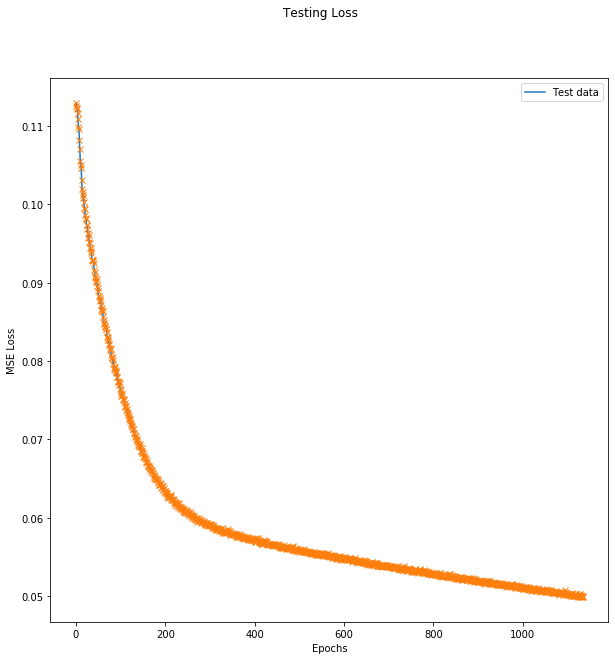

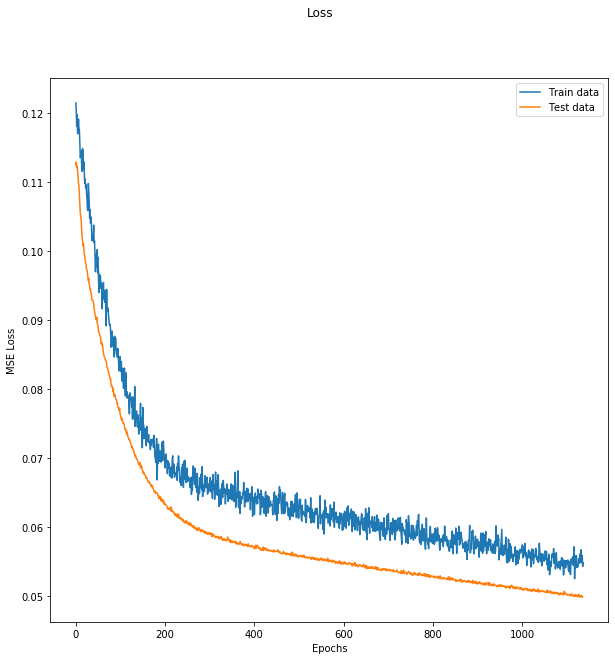

MAPE :  38.60373360405475


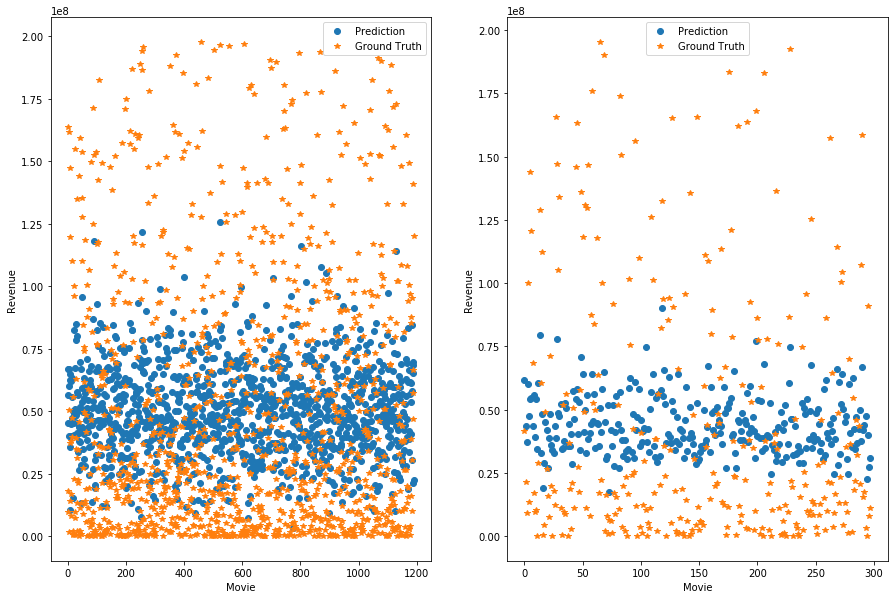

--- Epoch 1137 ---
[Epoch 1137/3000] [Batch 39/40] [Loss: 0.098935 (0.054793)]  [r2: (0.160409)] [rmse: (0.231224)], ETA: 0:45:11.167611
Testing -- [Batch 9/10] [Loss: 0.052526 (0.049972)] [r2: (0.202955)] [rmse: (0.220876)]
--- Epoch 1138 ---
[Epoch 1138/3000] [Batch 39/40] [Loss: 0.047232 (0.053386)]  [r2: (0.190636)] [rmse: (0.229493)], ETA: 0:44:38.439396
Testing -- [Batch 9/10] [Loss: 0.050529 (0.049947)] [r2: (0.207805)] [rmse: (0.221389)]
--- Epoch 1139 ---
[Epoch 1139/3000] [Batch 39/40] [Loss: 0.102194 (0.055148)]  [r2: (0.146442)] [rmse: (0.231840)], ETA: 0:43:19.376139
Testing -- [Batch 9/10] [Loss: 0.054145 (0.049954)] [r2: (0.194830)] [rmse: (0.221006)]
--- Epoch 1140 ---
[Epoch 1140/3000] [Batch 39/40] [Loss: 0.035189 (0.053422)]  [r2: (0.179215)] [rmse: (0.228742)], ETA: 0:43:48.933555
Testing -- [Batch 9/10] [Loss: 0.058615 (0.049968)] [r2: (0.180740)] [rmse: (0.218062)]
--- Epoch 1141 ---
[Epoch 1141/3000] [Batch 39/40] [Loss: 0.044467 (0.054758)]  [r2: (0.161319)] [rm

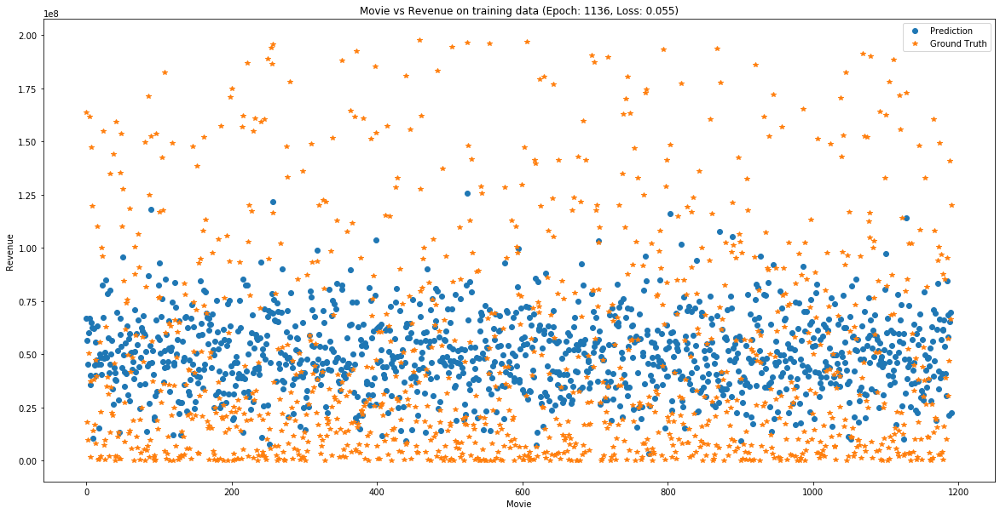

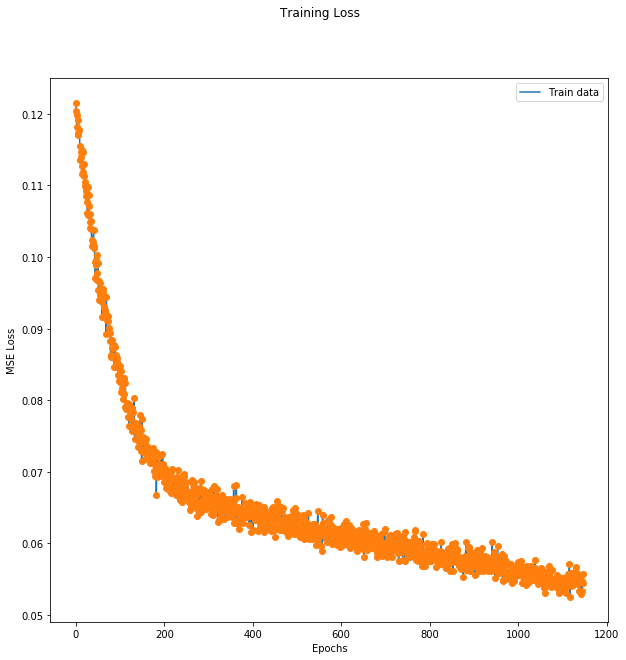

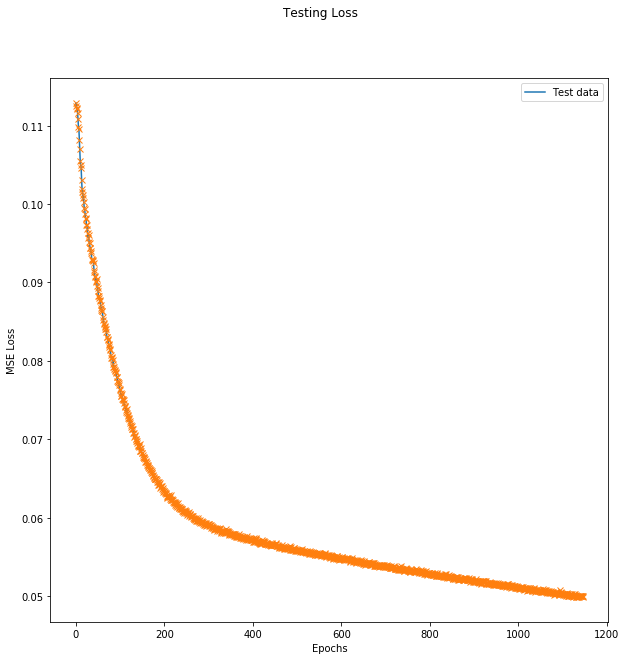

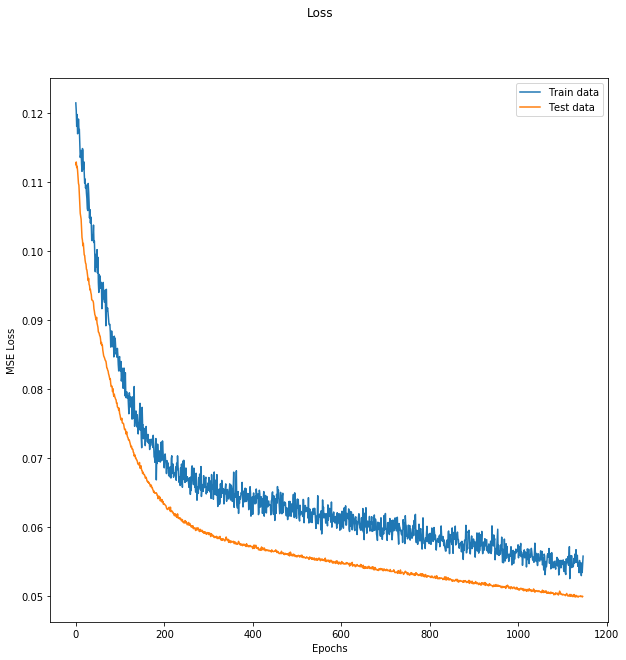

MAPE :  38.74267482395838


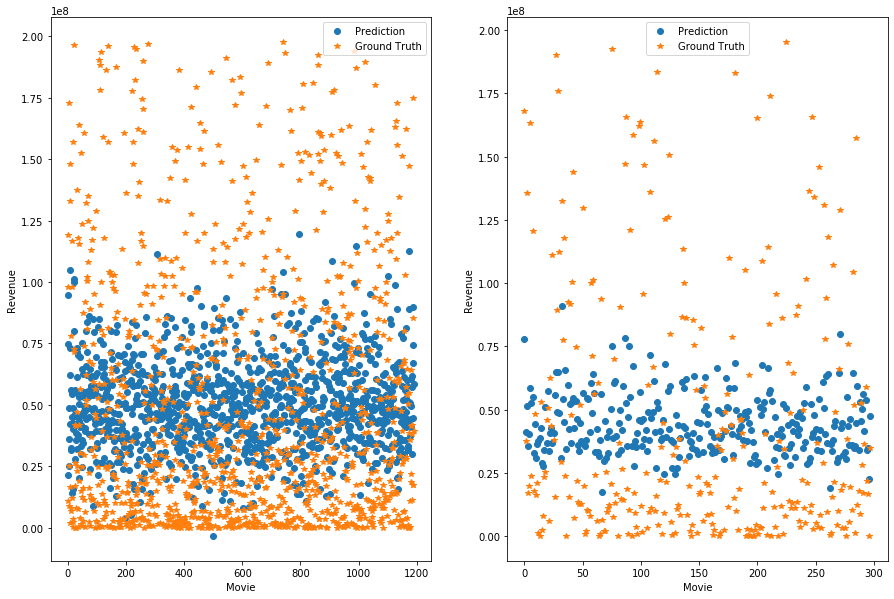

--- Epoch 1148 ---
[Epoch 1148/3000] [Batch 39/40] [Loss: 0.045711 (0.055564)]  [r2: (0.095759)] [rmse: (0.233158)], ETA: 0:43:24.239599
Testing -- [Batch 9/10] [Loss: 0.040886 (0.049779)] [r2: (0.196624)] [rmse: (0.220968)]
--- Epoch 1149 ---
[Epoch 1149/3000] [Batch 39/40] [Loss: 0.053975 (0.055999)]  [r2: (0.103888)] [rmse: (0.234680)], ETA: 0:46:21.576075
Testing -- [Batch 9/10] [Loss: 0.058812 (0.049904)] [r2: (0.163280)] [rmse: (0.221376)]
--- Epoch 1150 ---
[Epoch 1150/3000] [Batch 39/40] [Loss: 0.048959 (0.054093)]  [r2: (0.180884)] [rmse: (0.230697)], ETA: 0:44:37.180038
Testing -- [Batch 9/10] [Loss: 0.047345 (0.049805)] [r2: (0.202485)] [rmse: (0.220778)]
--- Epoch 1151 ---
[Epoch 1151/3000] [Batch 39/40] [Loss: 0.044031 (0.056207)]  [r2: (0.135119)] [rmse: (0.232157)], ETA: 0:44:26.761463
Testing -- [Batch 9/10] [Loss: 0.045188 (0.049788)] [r2: (0.172111)] [rmse: (0.218695)]
--- Epoch 1152 ---
[Epoch 1152/3000] [Batch 39/40] [Loss: 0.066903 (0.054132)]  [r2: (0.155584)] [rm

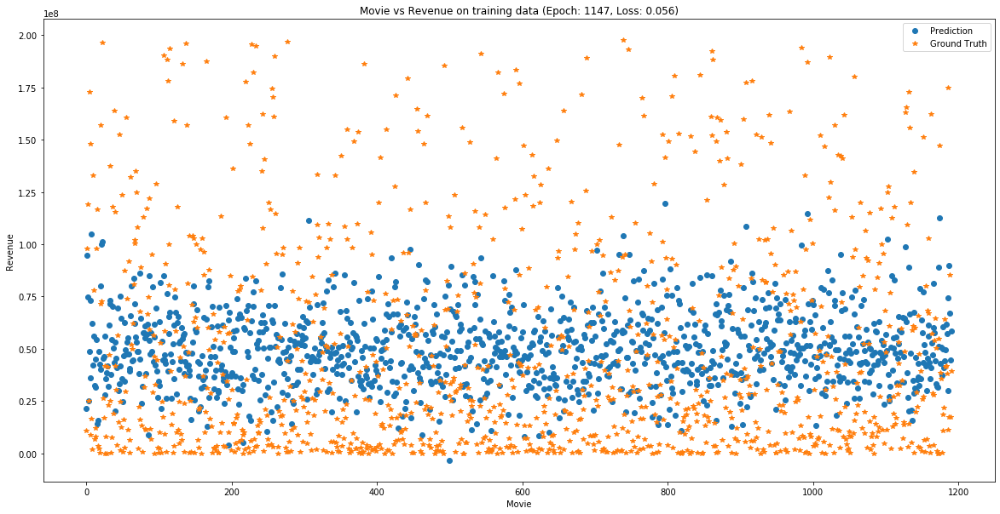

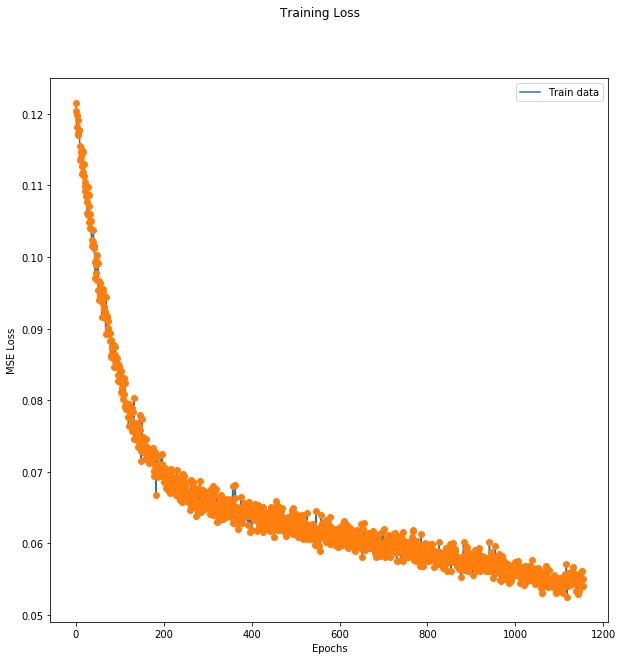

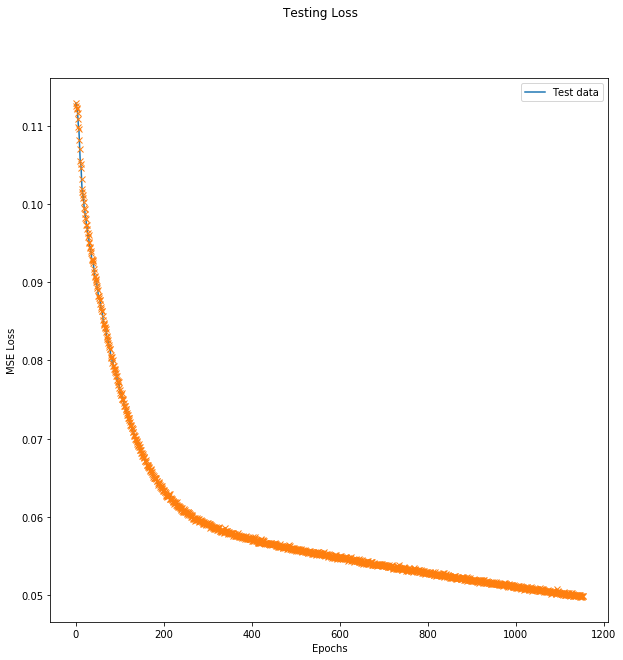

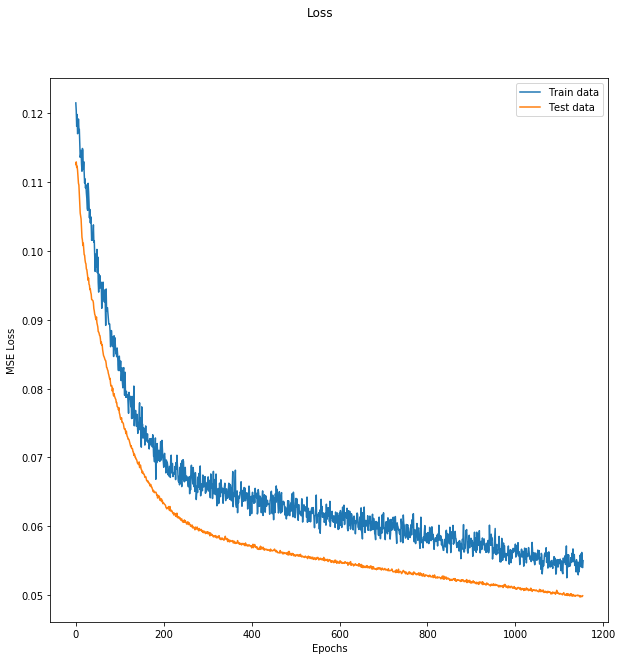

MAPE :  38.59454765540016


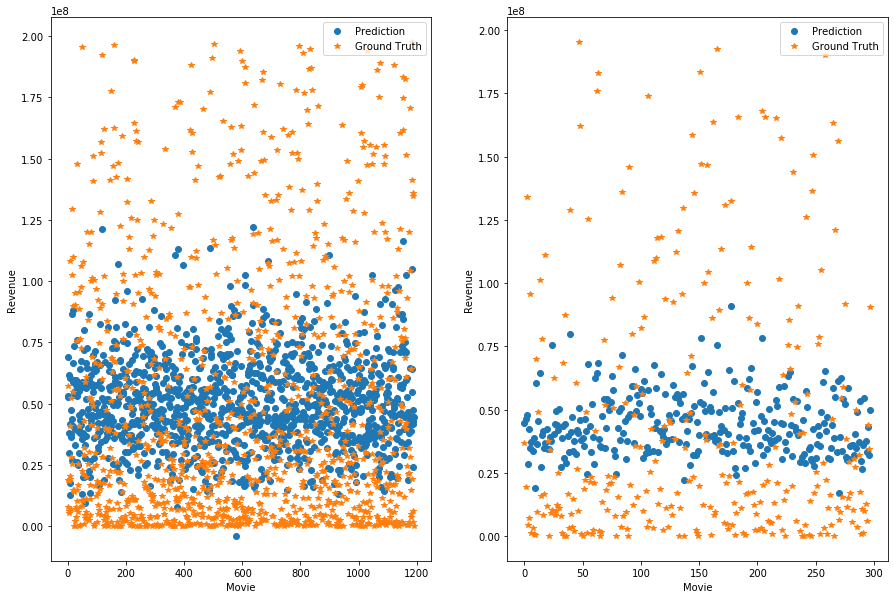

--- Epoch 1155 ---
[Epoch 1155/3000] [Batch 39/40] [Loss: 0.063116 (0.054433)]  [r2: (0.156712)] [rmse: (0.230850)], ETA: 0:44:15.766291
Testing -- [Batch 9/10] [Loss: 0.031789 (0.049703)] [r2: (0.176098)] [rmse: (0.220790)]
--- Epoch 1156 ---
[Epoch 1156/3000] [Batch 39/40] [Loss: 0.053237 (0.054353)]  [r2: (0.158461)] [rmse: (0.230484)], ETA: 0:44:01.846806
Testing -- [Batch 9/10] [Loss: 0.041204 (0.049748)] [r2: (0.164017)] [rmse: (0.218142)]
--- Epoch 1157 ---
[Epoch 1157/3000] [Batch 39/40] [Loss: 0.060580 (0.054044)]  [r2: (0.147057)] [rmse: (0.230206)], ETA: 0:46:48.669330
Testing -- [Batch 9/10] [Loss: 0.055477 (0.049827)] [r2: (0.170154)] [rmse: (0.221437)]
--- Epoch 1158 ---
[Epoch 1158/3000] [Batch 39/40] [Loss: 0.050629 (0.054641)]  [r2: (0.142396)] [rmse: (0.231328)], ETA: 0:43:33.047693
Testing -- [Batch 9/10] [Loss: 0.040071 (0.049717)] [r2: (0.211512)] [rmse: (0.221109)]
--- Epoch 1159 ---
[Epoch 1159/3000] [Batch 39/40] [Loss: 0.045194 (0.054311)]  [r2: (0.129036)] [rm

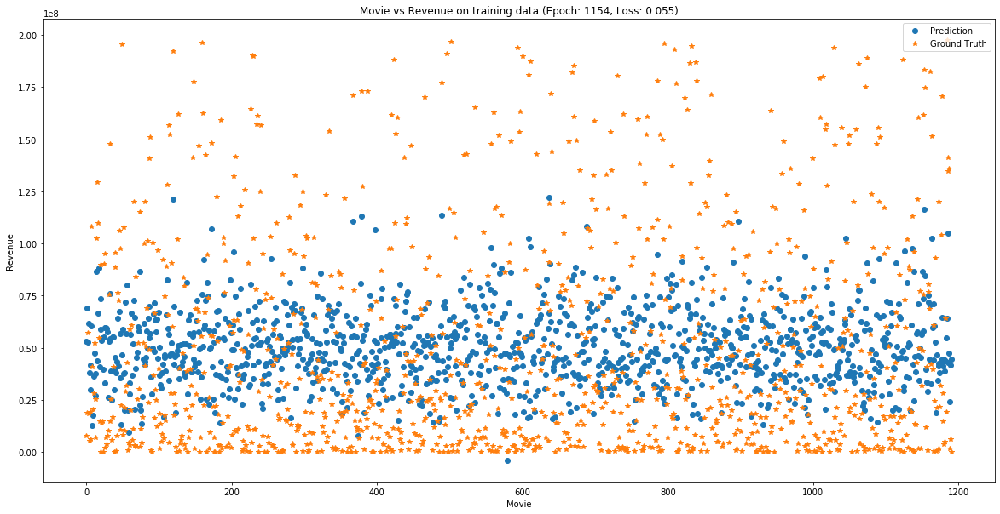

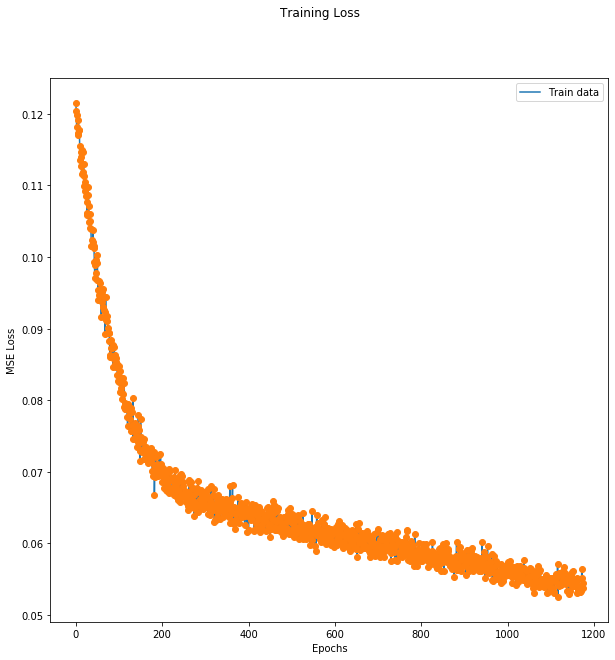

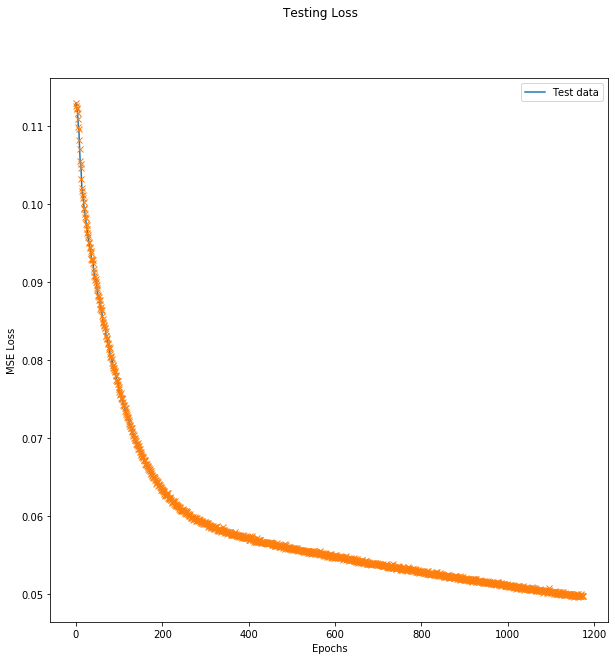

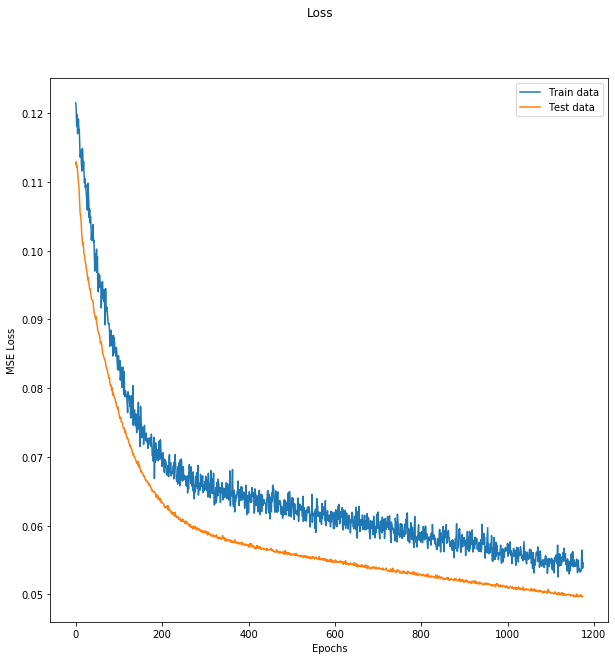

MAPE :  38.247073679722774


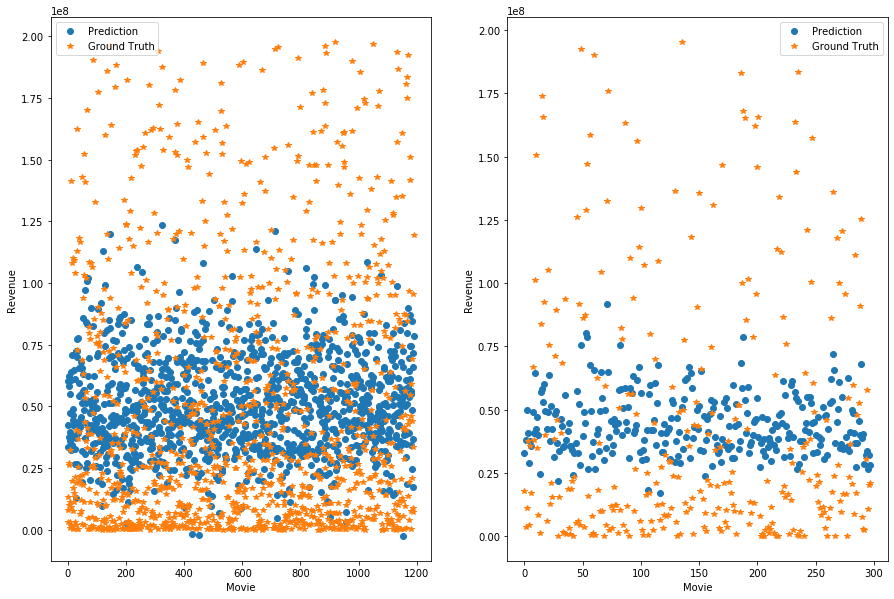

--- Epoch 1176 ---
[Epoch 1176/3000] [Batch 39/40] [Loss: 0.036312 (0.054710)]  [r2: (0.159800)] [rmse: (0.230442)], ETA: 0:43:43.835659
Testing -- [Batch 9/10] [Loss: 0.059004 (0.049671)] [r2: (0.201863)] [rmse: (0.220346)]
--- Epoch 1177 ---
[Epoch 1177/3000] [Batch 39/40] [Loss: 0.041142 (0.053369)]  [r2: (0.154677)] [rmse: (0.228834)], ETA: 0:44:34.125284
Testing -- [Batch 9/10] [Loss: 0.039033 (0.049536)] [r2: (0.196065)] [rmse: (0.220689)]
--- Epoch 1178 ---
[Epoch 1178/3000] [Batch 39/40] [Loss: 0.070862 (0.053450)]  [r2: (0.179812)] [rmse: (0.229471)], ETA: 0:43:33.888882
Testing -- [Batch 9/10] [Loss: 0.037726 (0.049536)] [r2: (0.202904)] [rmse: (0.218479)]
--- Epoch 1179 ---
[Epoch 1179/3000] [Batch 39/40] [Loss: 0.034957 (0.055081)]  [r2: (0.128576)] [rmse: (0.232030)], ETA: 0:44:29.072383
Testing -- [Batch 9/10] [Loss: 0.035654 (0.049518)] [r2: (0.185893)] [rmse: (0.220330)]
--- Epoch 1180 ---
[Epoch 1180/3000] [Batch 39/40] [Loss: 0.053773 (0.054388)]  [r2: (0.155501)] [rm

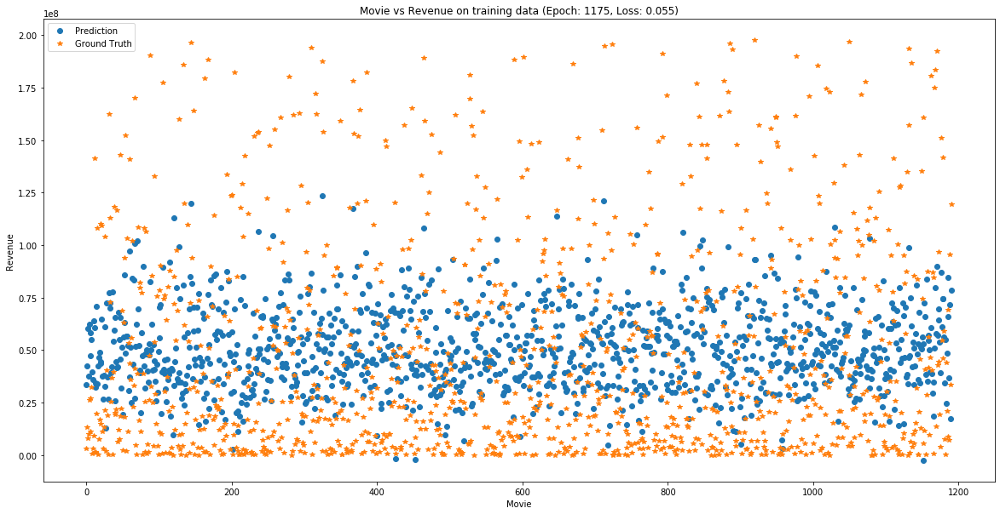

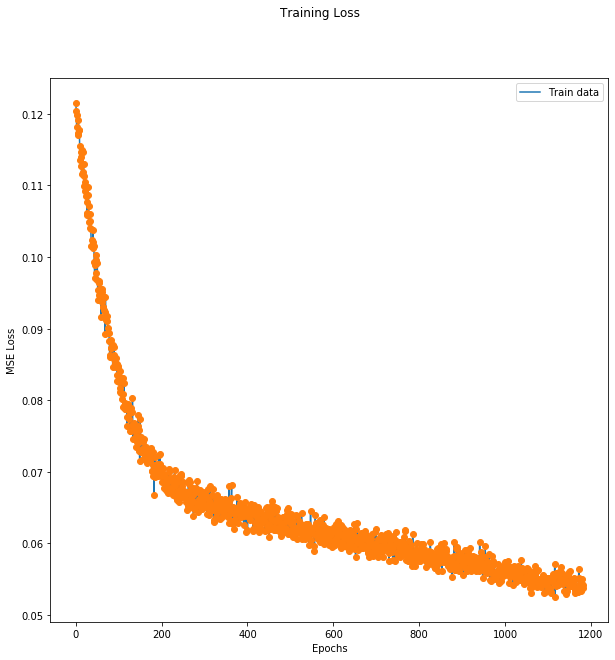

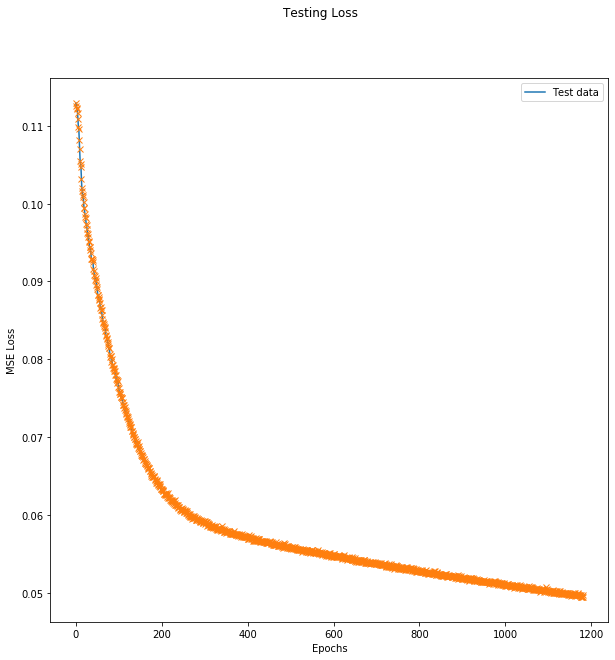

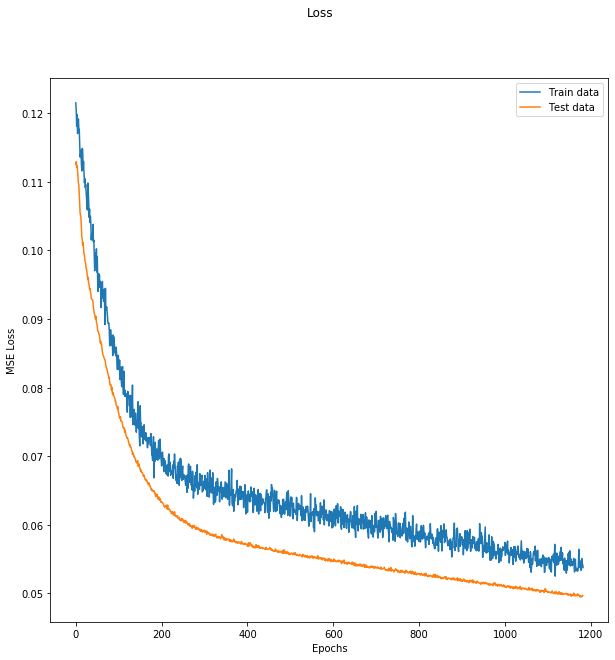

MAPE :  38.341832723123865


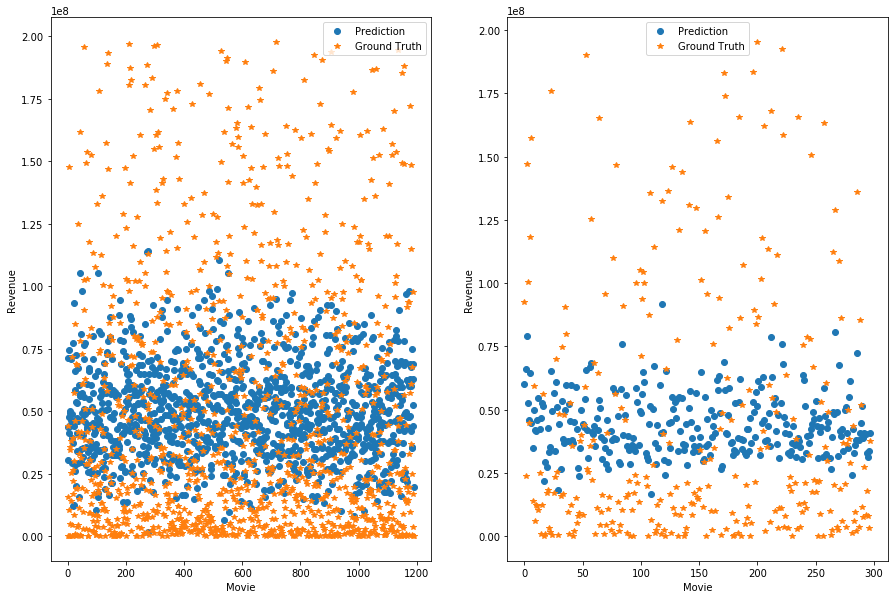

--- Epoch 1183 ---
[Epoch 1183/3000] [Batch 39/40] [Loss: 0.046620 (0.054765)]  [r2: (0.150247)] [rmse: (0.232031)], ETA: 0:42:19.445054
Testing -- [Batch 9/10] [Loss: 0.064611 (0.049678)] [r2: (0.178808)] [rmse: (0.219580)]
--- Epoch 1184 ---
[Epoch 1184/3000] [Batch 39/40] [Loss: 0.026364 (0.054235)]  [r2: (0.140948)] [rmse: (0.230035)], ETA: 0:45:11.781422
Testing -- [Batch 9/10] [Loss: 0.058927 (0.049635)] [r2: (0.210746)] [rmse: (0.221546)]
--- Epoch 1185 ---
[Epoch 1185/3000] [Batch 39/40] [Loss: 0.032714 (0.053024)]  [r2: (0.178382)] [rmse: (0.227839)], ETA: 0:43:28.702391
Testing -- [Batch 9/10] [Loss: 0.062204 (0.049661)] [r2: (0.202310)] [rmse: (0.217054)]
--- Epoch 1186 ---
[Epoch 1186/3000] [Batch 39/40] [Loss: 0.063358 (0.054539)]  [r2: (0.141228)] [rmse: (0.231267)], ETA: 0:42:50.176508
Testing -- [Batch 9/10] [Loss: 0.057007 (0.049609)] [r2: (0.215520)] [rmse: (0.220352)]
--- Epoch 1187 ---
[Epoch 1187/3000] [Batch 39/40] [Loss: 0.042929 (0.053861)]  [r2: (0.164680)] [rm

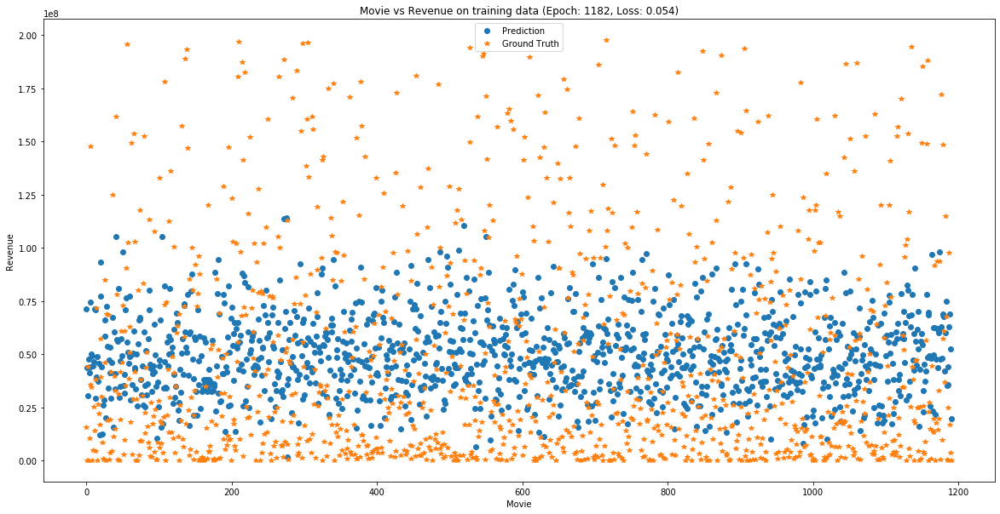

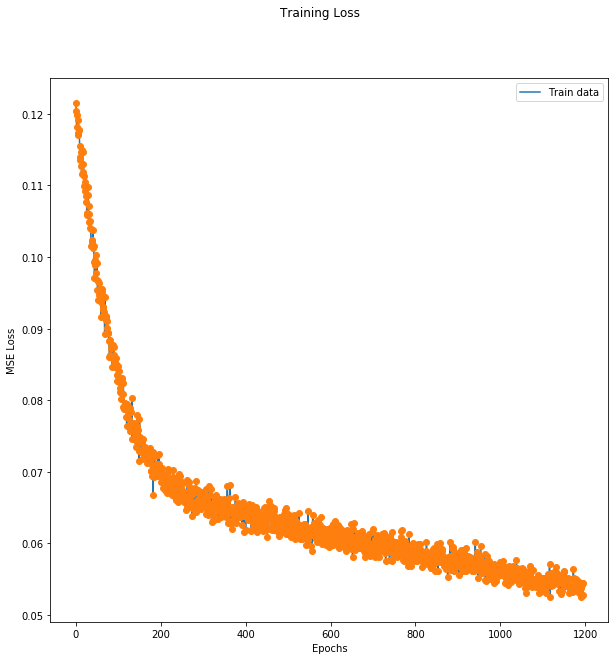

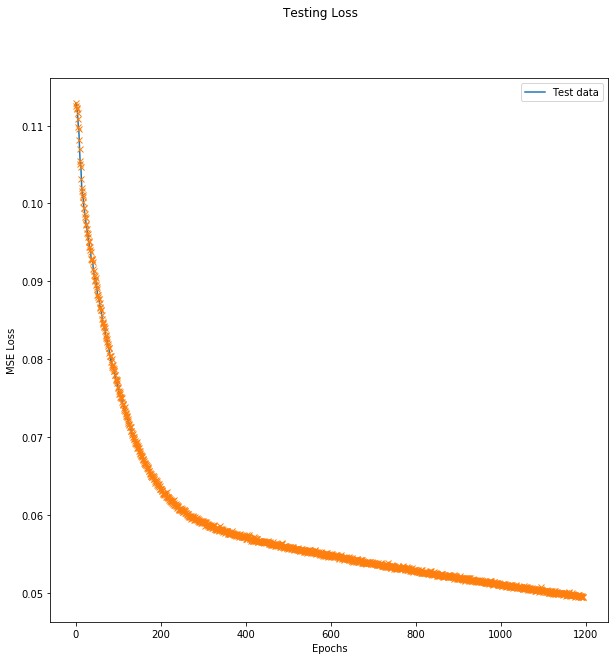

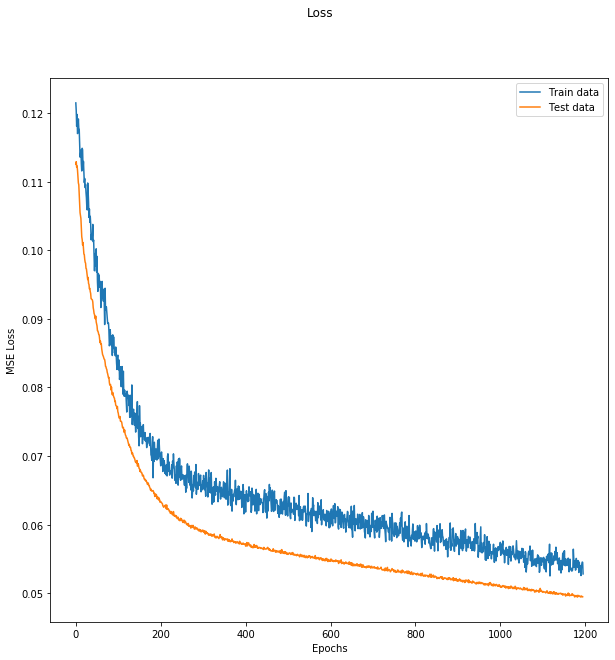

MAPE :  37.96855579005319


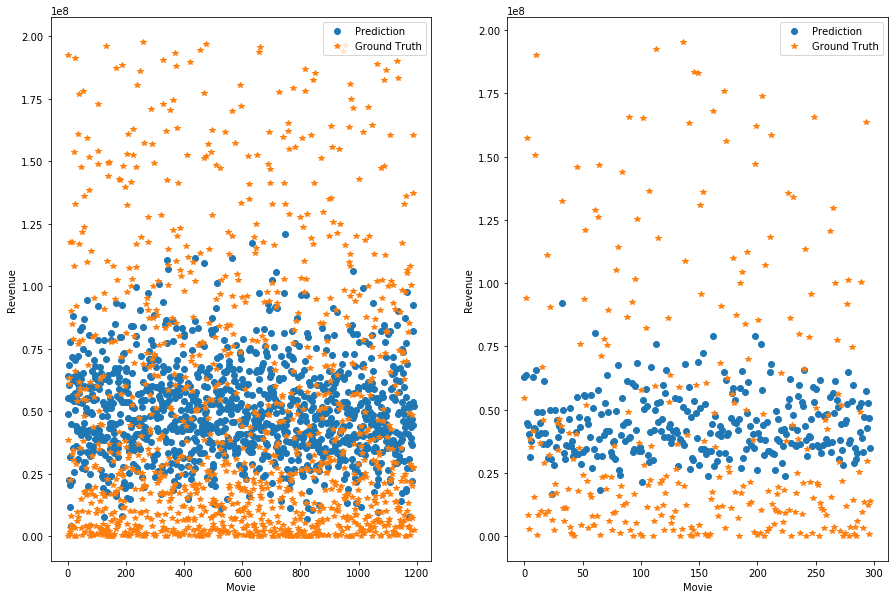

--- Epoch 1196 ---
[Epoch 1196/3000] [Batch 39/40] [Loss: 0.064002 (0.054584)]  [r2: (0.125278)] [rmse: (0.231566)], ETA: 0:42:27.471617
Testing -- [Batch 9/10] [Loss: 0.041885 (0.049431)] [r2: (0.212304)] [rmse: (0.220864)]
--- Epoch 1197 ---
[Epoch 1197/3000] [Batch 39/40] [Loss: 0.044207 (0.055276)]  [r2: (0.147707)] [rmse: (0.233590)], ETA: 0:43:41.846562
Testing -- [Batch 9/10] [Loss: 0.070026 (0.049585)] [r2: (0.211270)] [rmse: (0.220474)]
--- Epoch 1198 ---
[Epoch 1198/3000] [Batch 39/40] [Loss: 0.025507 (0.052509)]  [r2: (0.177176)] [rmse: (0.226462)], ETA: 0:43:55.592300
Testing -- [Batch 9/10] [Loss: 0.046496 (0.049436)] [r2: (0.210695)] [rmse: (0.219358)]
--- Epoch 1199 ---
[Epoch 1199/3000] [Batch 39/40] [Loss: 0.082878 (0.054262)]  [r2: (0.145919)] [rmse: (0.230827)], ETA: 0:44:05.733386
Testing -- [Batch 9/10] [Loss: 0.065633 (0.049564)] [r2: (0.183235)] [rmse: (0.219200)]
--- Epoch 1200 ---
[Epoch 1200/3000] [Batch 39/40] [Loss: 0.043922 (0.053275)]  [r2: (0.158915)] [rm

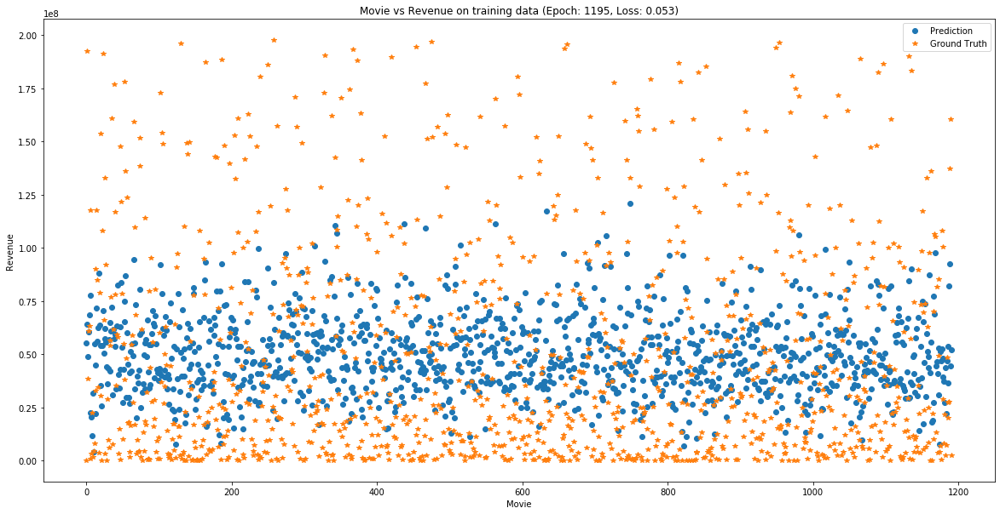

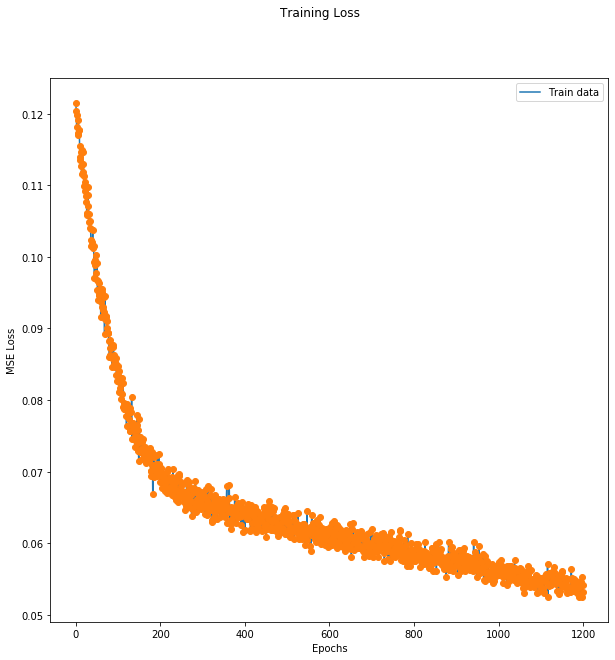

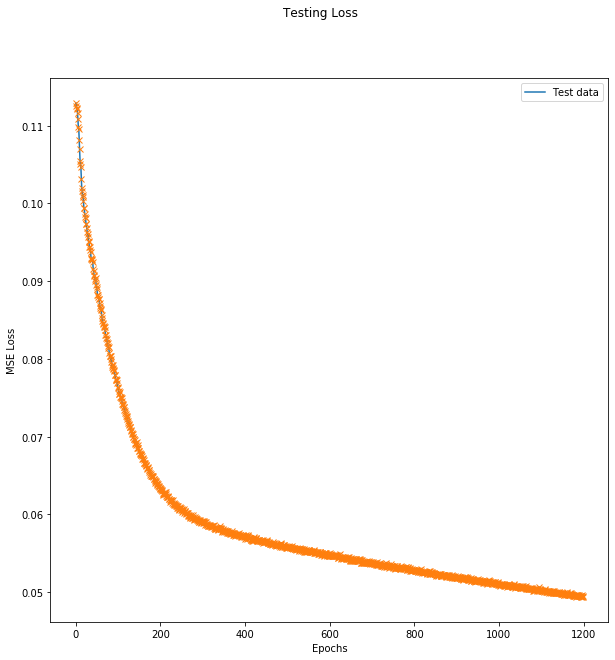

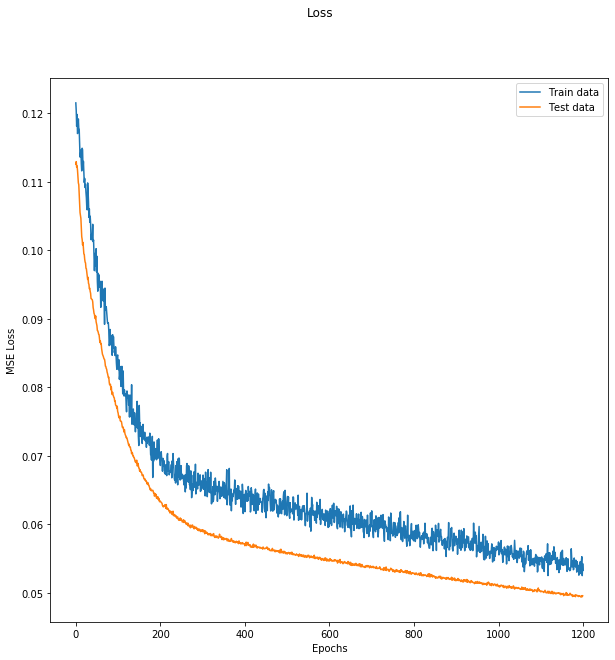

MAPE :  38.140408481947766


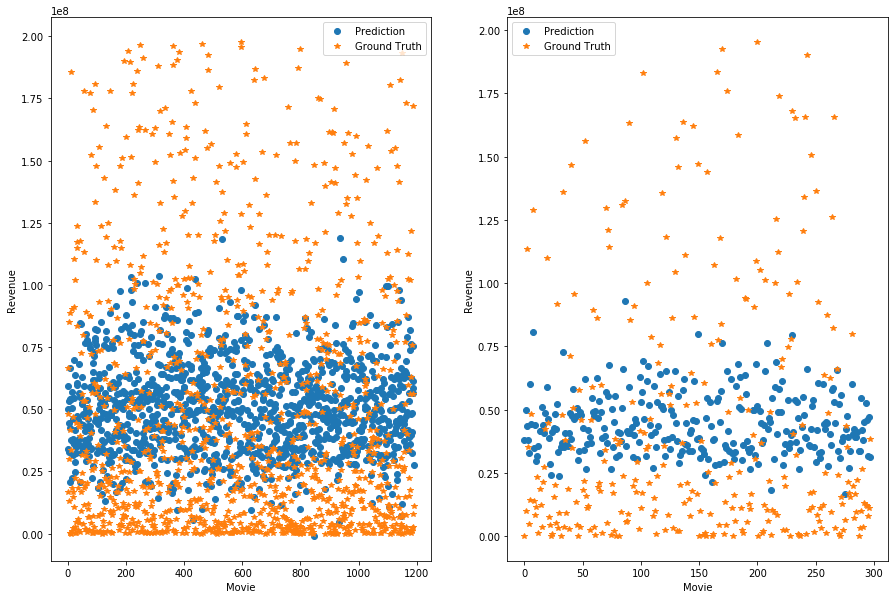

--- Epoch 1201 ---
[Epoch 1201/3000] [Batch 39/40] [Loss: 0.086930 (0.053242)]  [r2: (0.160449)] [rmse: (0.228311)], ETA: 0:42:07.615291
Testing -- [Batch 9/10] [Loss: 0.064876 (0.049524)] [r2: (0.188626)] [rmse: (0.219803)]
--- Epoch 1202 ---
[Epoch 1202/3000] [Batch 39/40] [Loss: 0.039078 (0.054511)]  [r2: (0.160266)] [rmse: (0.231026)], ETA: 0:41:01.497314
Testing -- [Batch 9/10] [Loss: 0.071245 (0.049562)] [r2: (0.199212)] [rmse: (0.220614)]
--- Epoch 1203 ---
[Epoch 1203/3000] [Batch 39/40] [Loss: 0.056284 (0.052080)]  [r2: (0.184983)] [rmse: (0.225889)], ETA: 0:42:05.437489
Testing -- [Batch 9/10] [Loss: 0.029660 (0.049284)] [r2: (0.213547)] [rmse: (0.220245)]
--- Epoch 1204 ---
[Epoch 1204/3000] [Batch 39/40] [Loss: 0.075382 (0.055624)]  [r2: (0.143124)] [rmse: (0.232834)], ETA: 0:41:46.193686
Testing -- [Batch 9/10] [Loss: 0.035902 (0.049329)] [r2: (0.211168)] [rmse: (0.221052)]
--- Epoch 1205 ---
[Epoch 1205/3000] [Batch 39/40] [Loss: 0.057333 (0.054320)]  [r2: (0.160743)] [rm

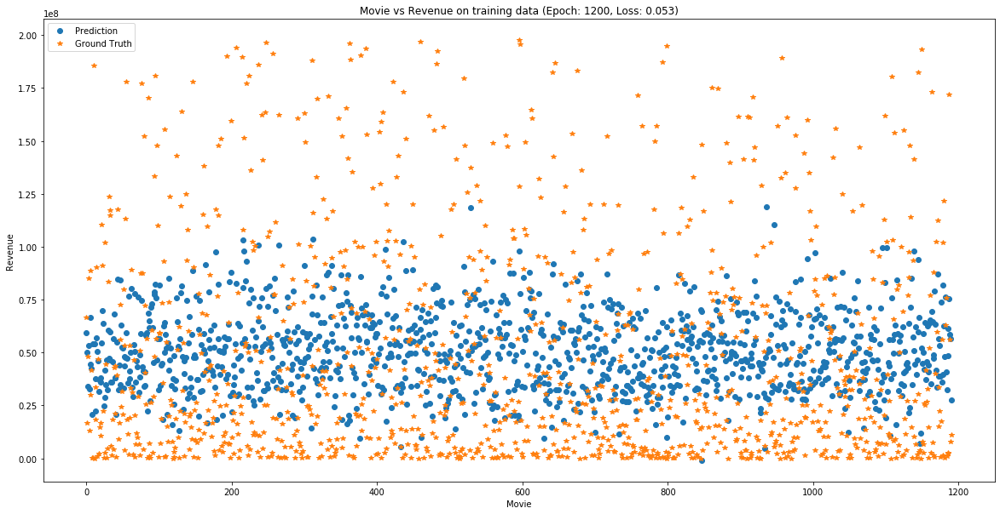

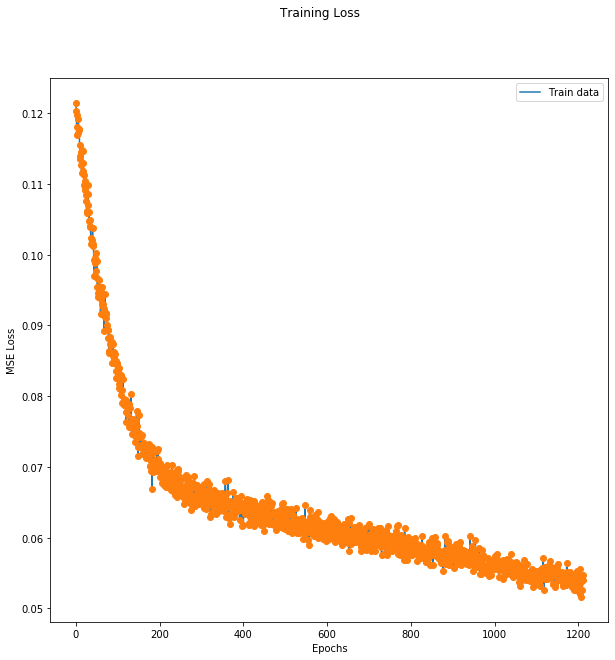

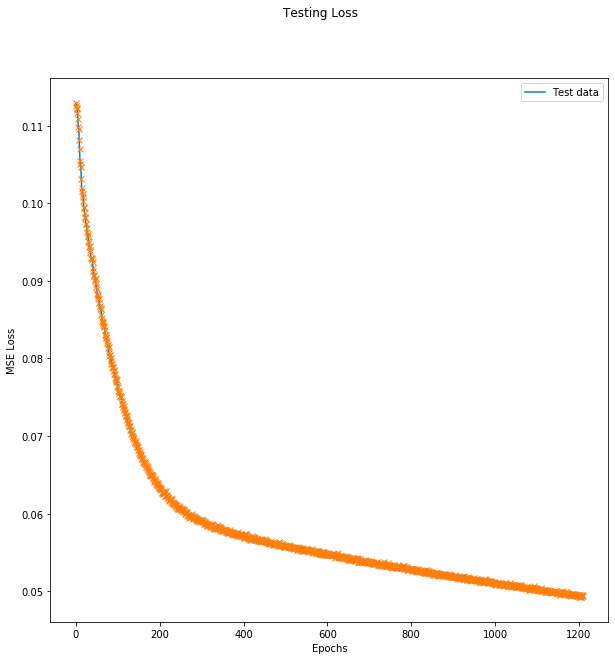

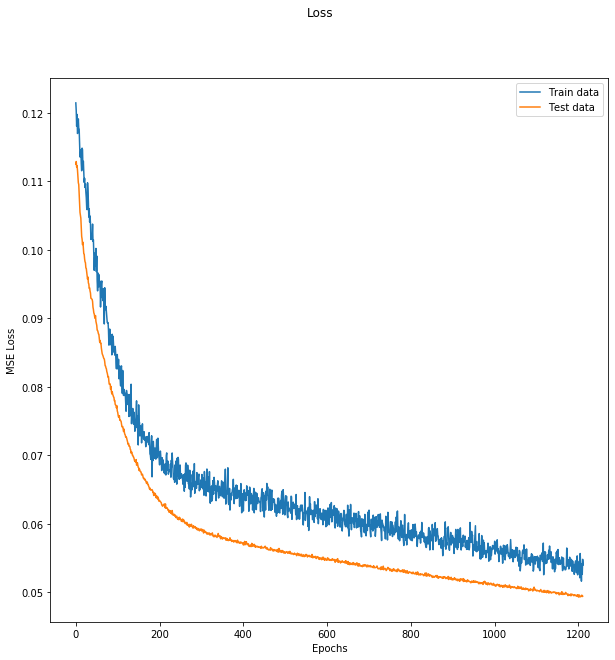

MAPE :  38.20404624604001


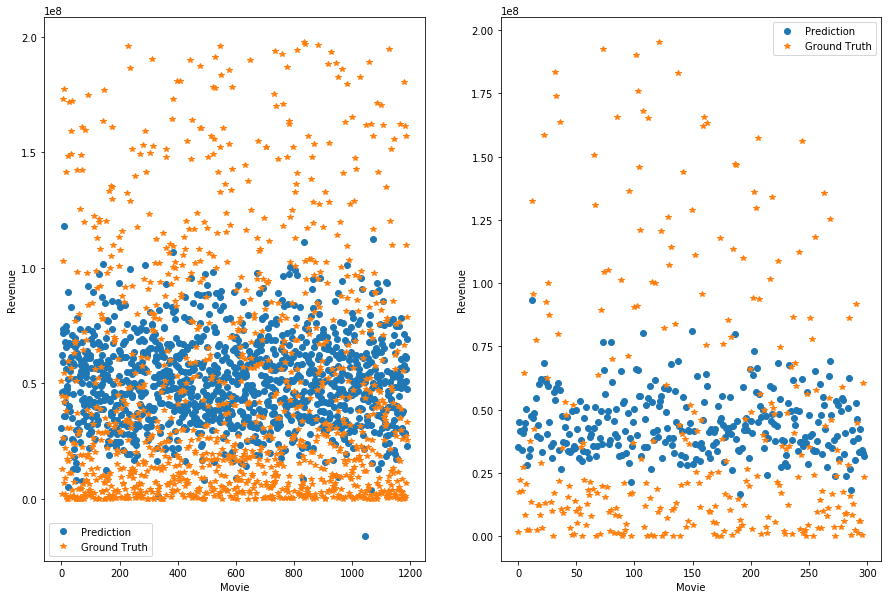

--- Epoch 1212 ---
[Epoch 1212/3000] [Batch 39/40] [Loss: 0.034156 (0.054021)]  [r2: (0.160667)] [rmse: (0.230554)], ETA: 0:41:19.072491
Testing -- [Batch 9/10] [Loss: 0.050007 (0.049371)] [r2: (0.211104)] [rmse: (0.219641)]
--- Epoch 1213 ---
[Epoch 1213/3000] [Batch 39/40] [Loss: 0.050970 (0.052864)]  [r2: (0.193297)] [rmse: (0.227295)], ETA: 0:41:57.508059
Testing -- [Batch 9/10] [Loss: 0.032233 (0.049246)] [r2: (0.183883)] [rmse: (0.218100)]
--- Epoch 1214 ---
[Epoch 1214/3000] [Batch 39/40] [Loss: 0.066500 (0.053360)]  [r2: (0.173922)] [rmse: (0.228624)], ETA: 0:42:34.554191
Testing -- [Batch 9/10] [Loss: 0.036411 (0.049262)] [r2: (0.207552)] [rmse: (0.220166)]
--- Epoch 1215 ---
[Epoch 1215/3000] [Batch 39/40] [Loss: 0.050337 (0.052837)]  [r2: (0.190894)] [rmse: (0.227842)], ETA: 0:42:08.231916
Testing -- [Batch 9/10] [Loss: 0.045814 (0.049308)] [r2: (0.208836)] [rmse: (0.220024)]
--- Epoch 1216 ---
[Epoch 1216/3000] [Batch 39/40] [Loss: 0.045856 (0.053134)]  [r2: (0.172414)] [rm

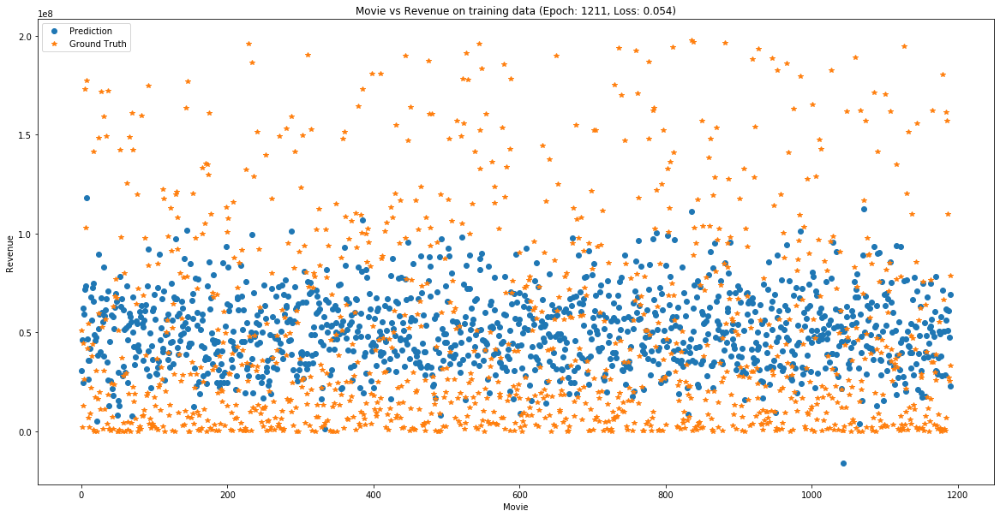

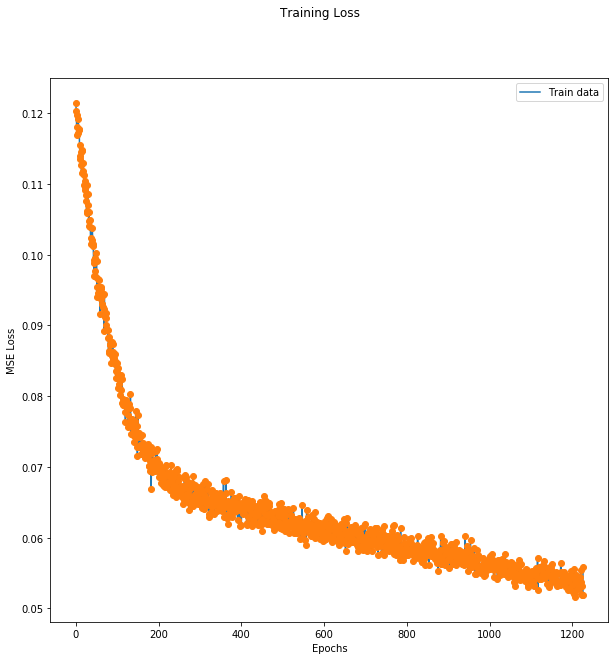

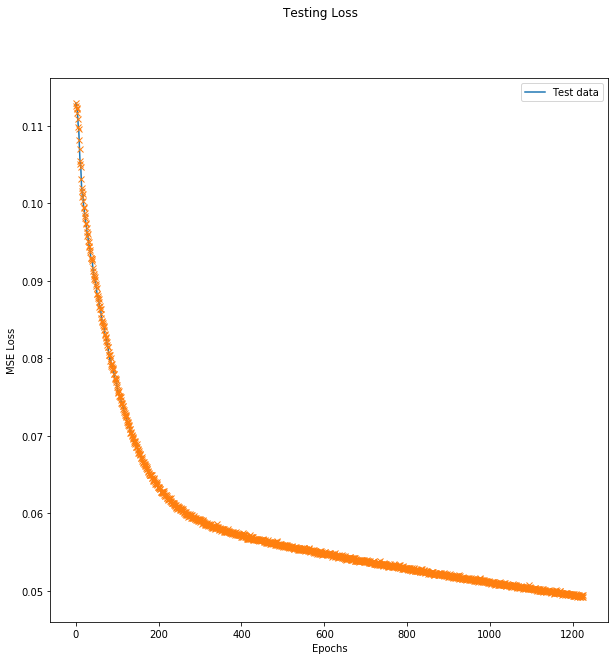

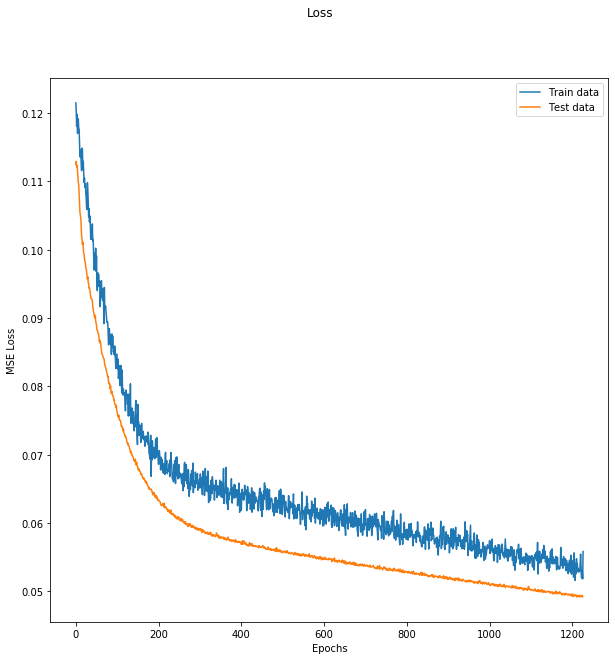

MAPE :  37.89462053747712


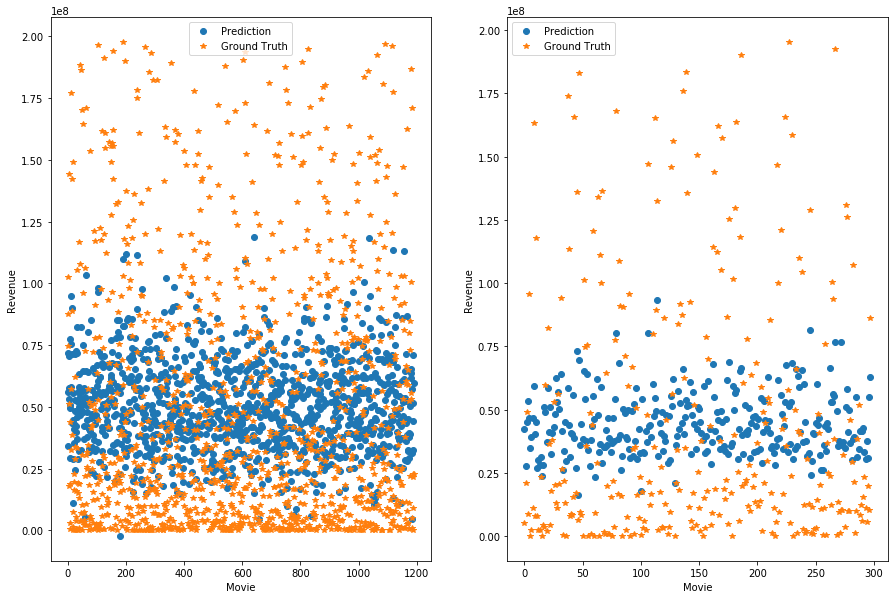

--- Epoch 1227 ---
[Epoch 1227/3000] [Batch 39/40] [Loss: 0.069590 (0.052165)]  [r2: (0.197244)] [rmse: (0.226145)], ETA: 0:41:11.360550
Testing -- [Batch 9/10] [Loss: 0.061326 (0.049304)] [r2: (0.206628)] [rmse: (0.220359)]
--- Epoch 1228 ---
[Epoch 1228/3000] [Batch 39/40] [Loss: 0.027495 (0.052255)]  [r2: (0.189550)] [rmse: (0.226734)], ETA: 0:42:11.377248
Testing -- [Batch 9/10] [Loss: 0.054710 (0.049254)] [r2: (0.197747)] [rmse: (0.219919)]
--- Epoch 1229 ---
[Epoch 1229/3000] [Batch 39/40] [Loss: 0.036622 (0.053360)]  [r2: (0.148170)] [rmse: (0.228740)], ETA: 0:42:39.977926
Testing -- [Batch 9/10] [Loss: 0.049567 (0.049223)] [r2: (0.199418)] [rmse: (0.220153)]
--- Epoch 1230 ---
[Epoch 1230/3000] [Batch 39/40] [Loss: 0.040021 (0.054392)]  [r2: (0.168708)] [rmse: (0.230438)], ETA: 0:41:06.957270
Testing -- [Batch 9/10] [Loss: 0.051378 (0.049220)] [r2: (0.209823)] [rmse: (0.220652)]
--- Epoch 1231 ---
[Epoch 1231/3000] [Batch 39/40] [Loss: 0.051086 (0.053795)]  [r2: (0.174718)] [rm

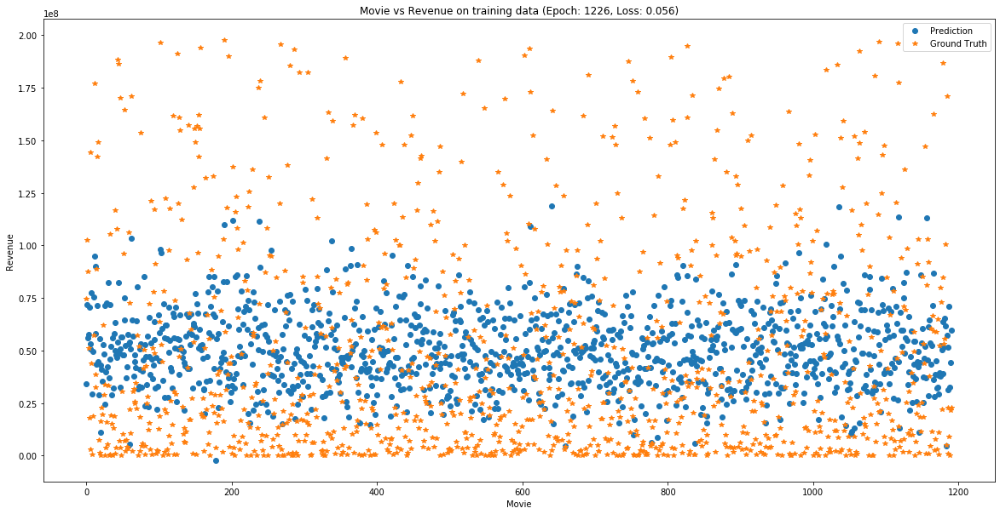

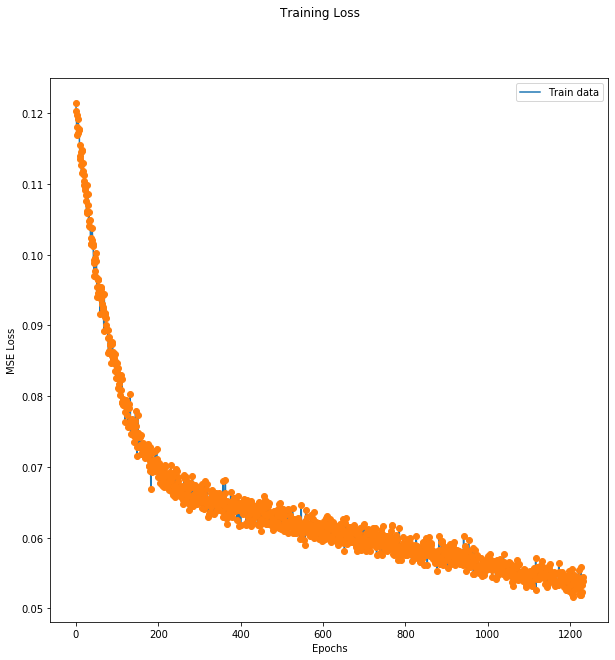

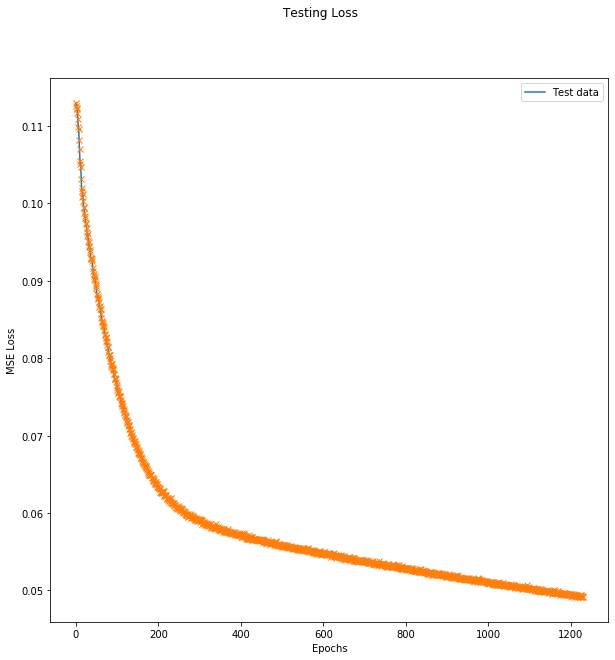

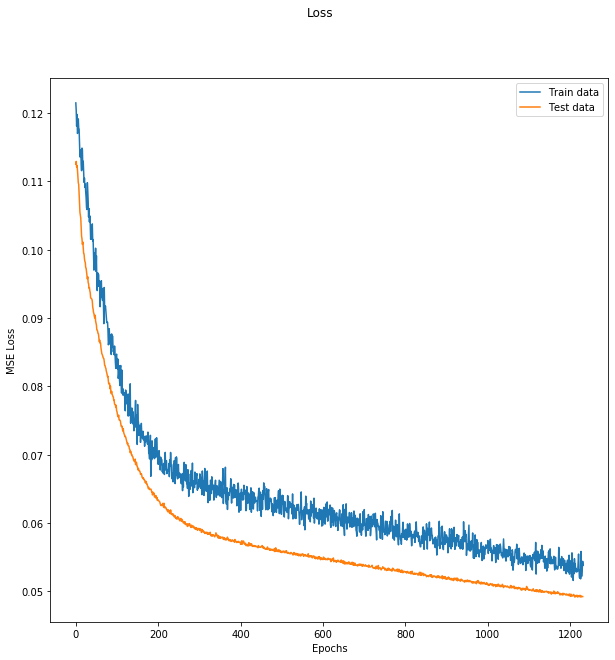

MAPE :  37.77913468519203


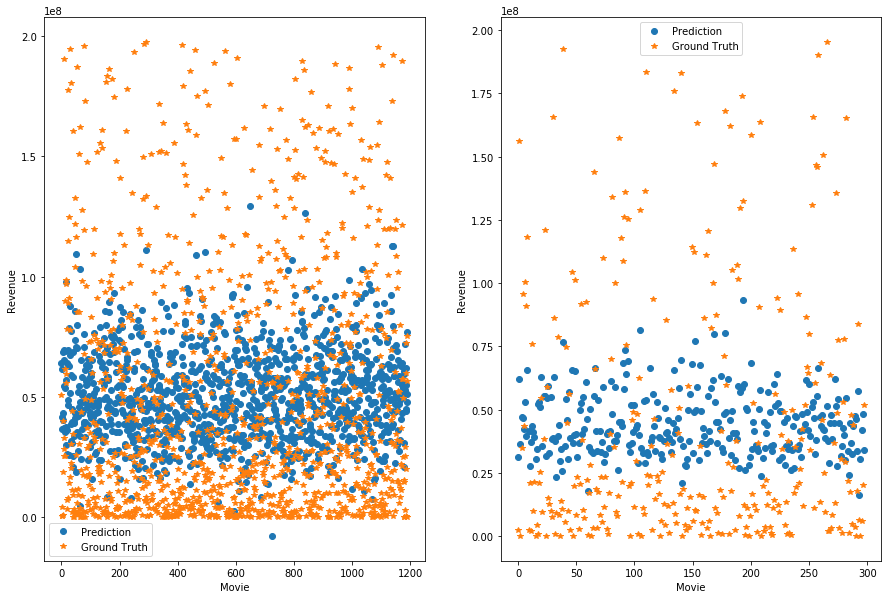

--- Epoch 1232 ---
[Epoch 1232/3000] [Batch 39/40] [Loss: 0.028599 (0.053809)]  [r2: (0.153900)] [rmse: (0.229872)], ETA: 0:40:37.727952
Testing -- [Batch 9/10] [Loss: 0.076497 (0.049372)] [r2: (0.211749)] [rmse: (0.220930)]
--- Epoch 1233 ---
[Epoch 1233/3000] [Batch 39/40] [Loss: 0.045632 (0.052857)]  [r2: (0.192027)] [rmse: (0.227060)], ETA: 0:41:08.820006
Testing -- [Batch 9/10] [Loss: 0.044124 (0.049148)] [r2: (0.200564)] [rmse: (0.219200)]
--- Epoch 1234 ---
[Epoch 1234/3000] [Batch 39/40] [Loss: 0.039719 (0.055701)]  [r2: (0.134331)] [rmse: (0.232996)], ETA: 0:40:56.682860
Testing -- [Batch 9/10] [Loss: 0.070029 (0.049326)] [r2: (0.204244)] [rmse: (0.219941)]
--- Epoch 1235 ---
[Epoch 1235/3000] [Batch 39/40] [Loss: 0.044378 (0.054367)]  [r2: (0.150476)] [rmse: (0.230636)], ETA: 0:41:21.013440
Testing -- [Batch 9/10] [Loss: 0.075750 (0.049369)] [r2: (0.183693)] [rmse: (0.218875)]
--- Epoch 1236 ---
[Epoch 1236/3000] [Batch 39/40] [Loss: 0.043027 (0.052990)]  [r2: (0.175120)] [rm

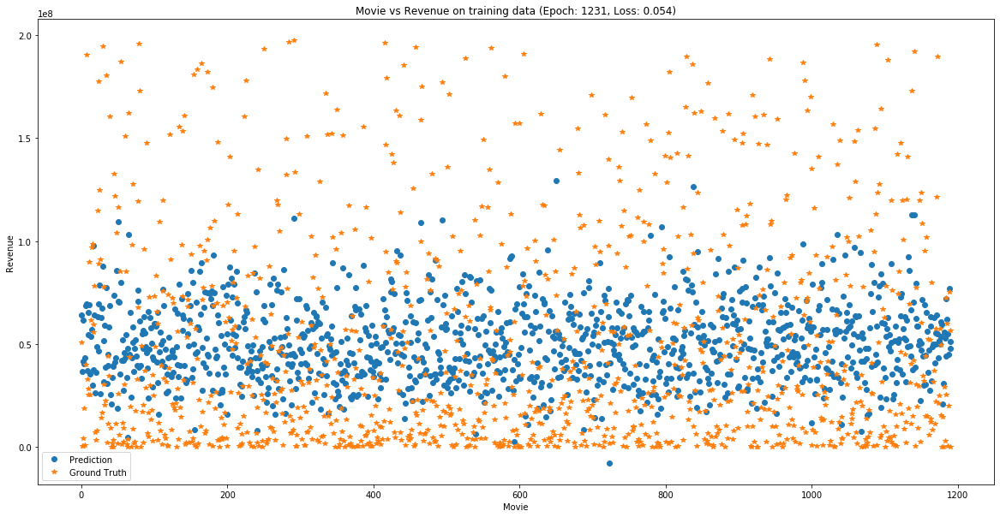

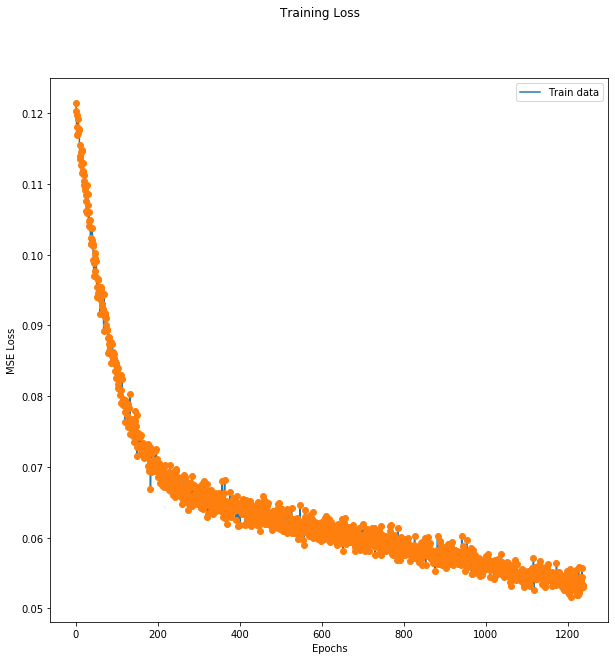

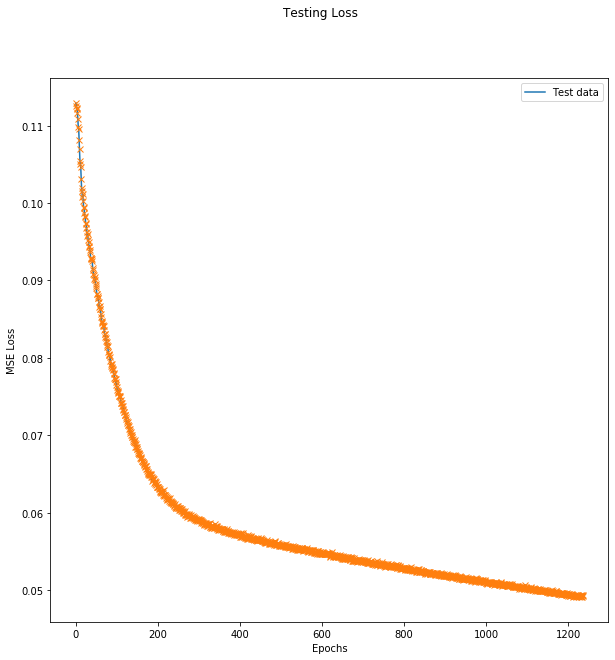

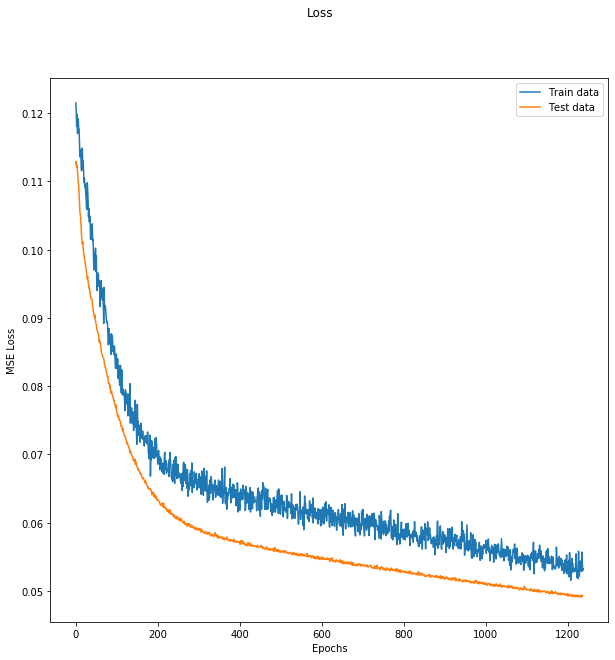

MAPE :  37.820191031181466


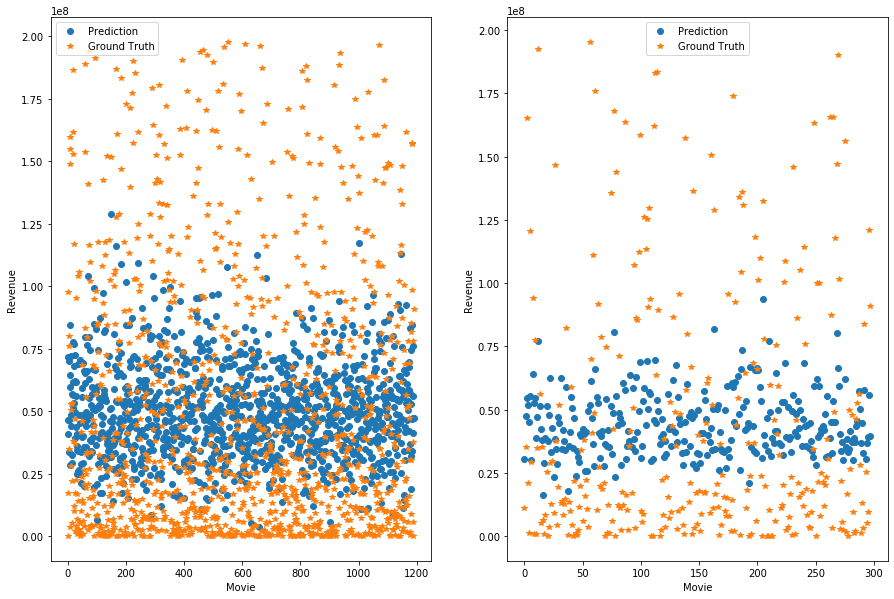

--- Epoch 1238 ---
[Epoch 1238/3000] [Batch 39/40] [Loss: 0.077993 (0.054340)]  [r2: (0.145571)] [rmse: (0.230617)], ETA: 0:41:10.966418
Testing -- [Batch 9/10] [Loss: 0.049889 (0.049173)] [r2: (0.229880)] [rmse: (0.220534)]
--- Epoch 1239 ---
[Epoch 1239/3000] [Batch 39/40] [Loss: 0.050369 (0.054492)]  [r2: (0.139470)] [rmse: (0.231103)], ETA: 0:40:48.699638
Testing -- [Batch 9/10] [Loss: 0.061387 (0.049244)] [r2: (0.201877)] [rmse: (0.218808)]
--- Epoch 1240 ---
[Epoch 1240/3000] [Batch 39/40] [Loss: 0.073193 (0.052148)]  [r2: (0.194635)] [rmse: (0.226393)], ETA: 0:41:57.228092
Testing -- [Batch 9/10] [Loss: 0.029651 (0.049031)] [r2: (0.215958)] [rmse: (0.217617)]
Train R2 =  0.22930441414282288
Test R2 =  0.22721076265982132


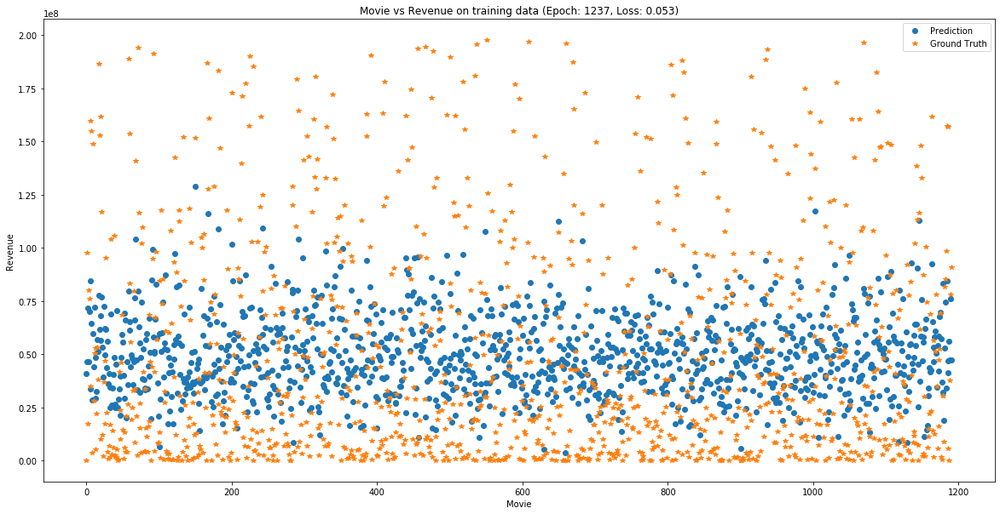

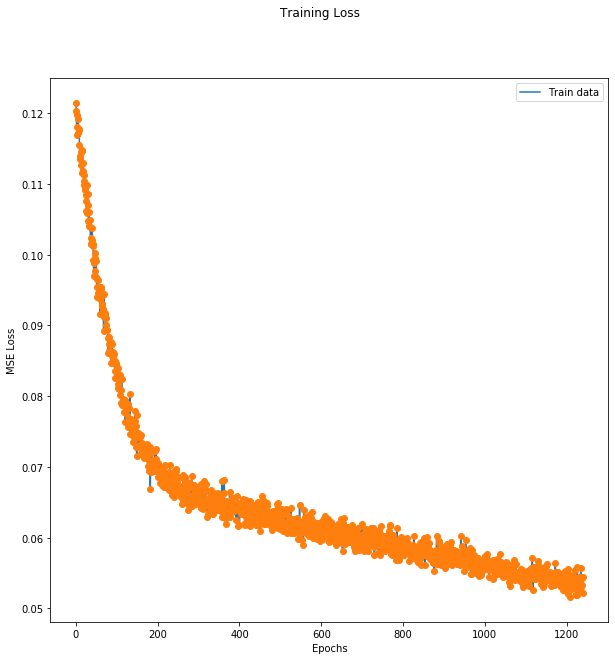

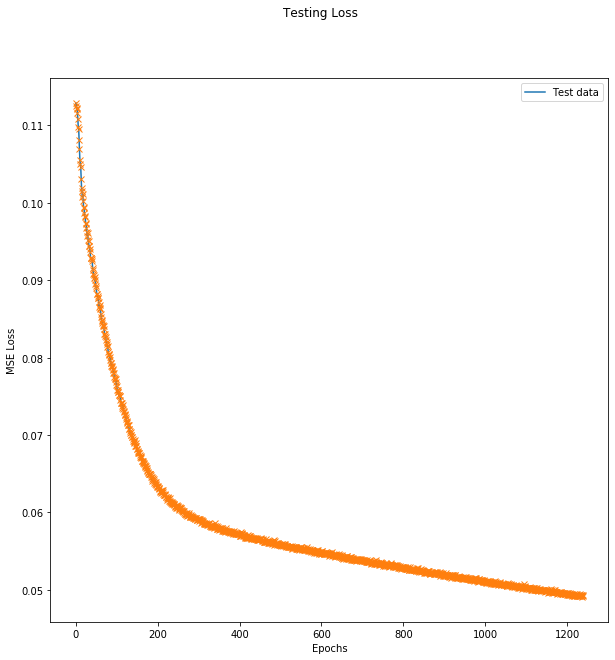

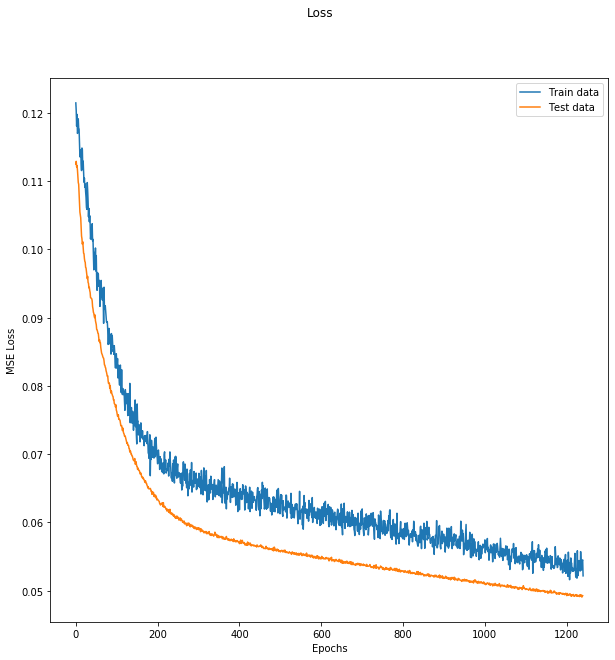

MAPE :  37.773295238333546


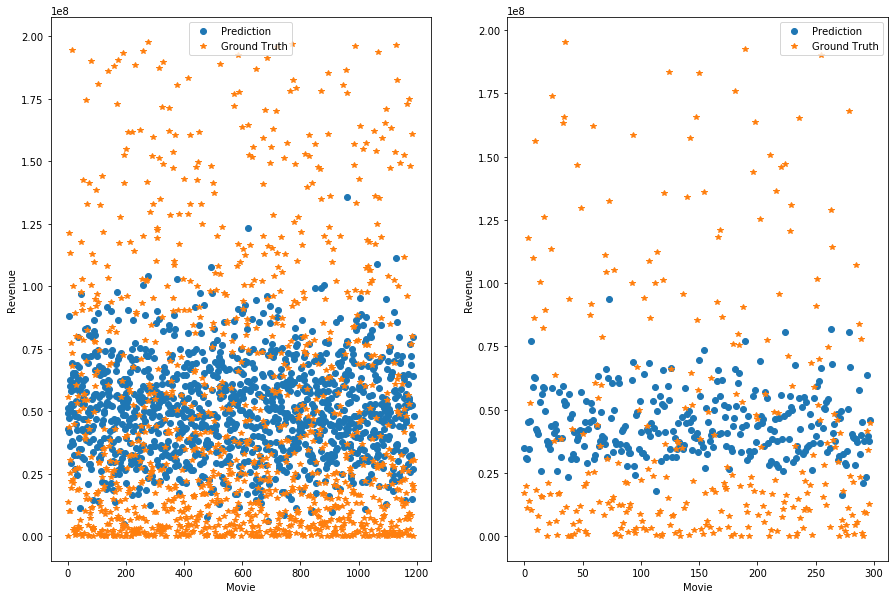

--- Epoch 1241 ---
[Epoch 1241/3000] [Batch 39/40] [Loss: 0.050118 (0.052944)]  [r2: (0.151518)] [rmse: (0.227212)], ETA: 0:41:06.740229
Testing -- [Batch 9/10] [Loss: 0.068879 (0.049273)] [r2: (0.189659)] [rmse: (0.218061)]
--- Epoch 1242 ---
[Epoch 1242/3000] [Batch 39/40] [Loss: 0.059878 (0.052361)]  [r2: (0.197381)] [rmse: (0.227079)], ETA: 0:41:56.477313
Testing -- [Batch 9/10] [Loss: 0.102921 (0.049491)] [r2: (0.159792)] [rmse: (0.217524)]
--- Epoch 1243 ---
[Epoch 1243/3000] [Batch 39/40] [Loss: 0.053671 (0.053151)]  [r2: (0.172554)] [rmse: (0.228200)], ETA: 0:40:03.947074
Testing -- [Batch 9/10] [Loss: 0.054010 (0.049147)] [r2: (0.208000)] [rmse: (0.219999)]
--- Epoch 1244 ---
[Epoch 1244/3000] [Batch 39/40] [Loss: 0.044881 (0.051965)]  [r2: (0.184278)] [rmse: (0.225702)], ETA: 0:42:35.656741
Testing -- [Batch 9/10] [Loss: 0.056037 (0.049142)] [r2: (0.218596)] [rmse: (0.219822)]
--- Epoch 1245 ---
[Epoch 1245/3000] [Batch 39/40] [Loss: 0.064896 (0.053086)]  [r2: (0.142697)] [rm

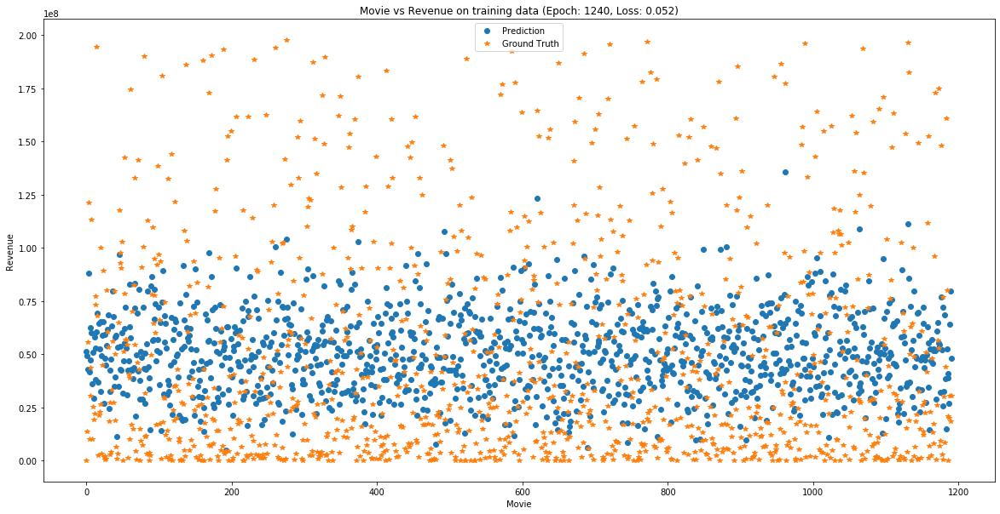

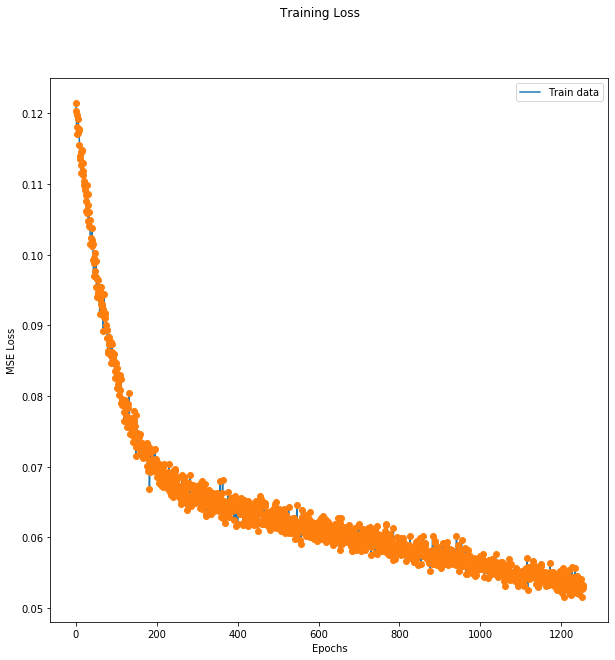

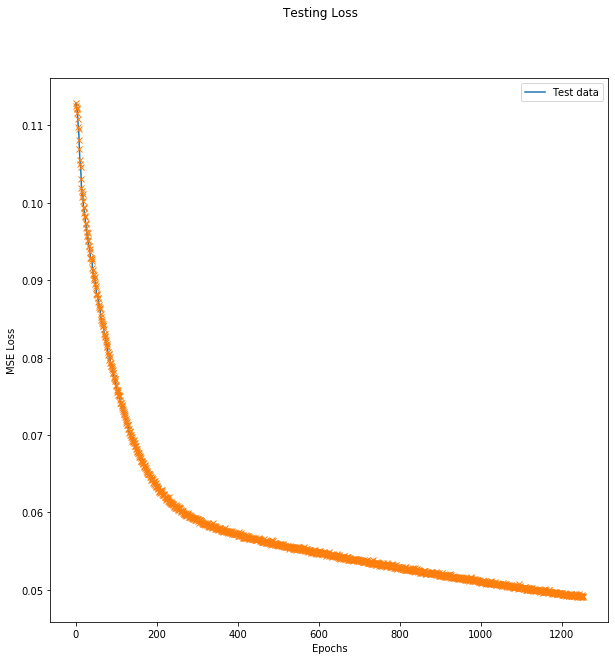

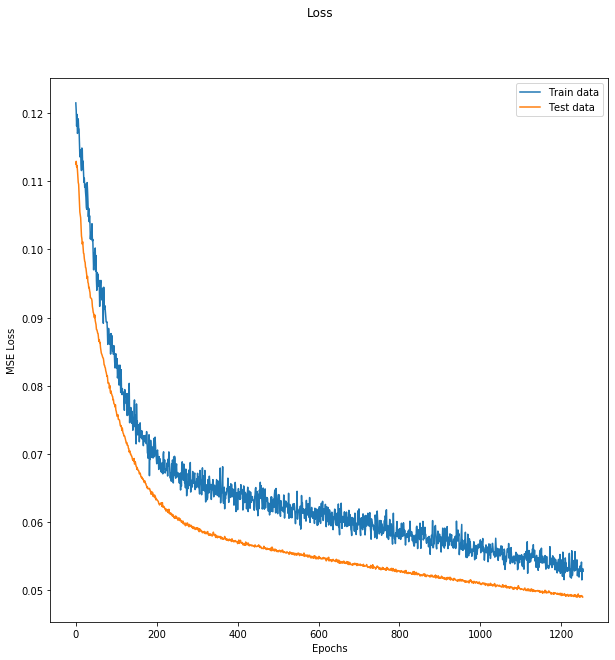

MAPE :  37.63088849471748


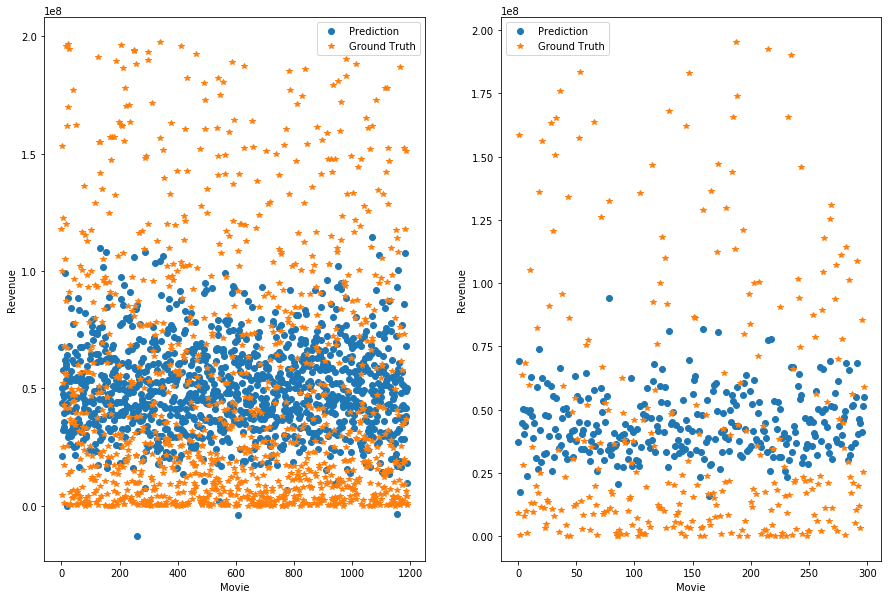

--- Epoch 1255 ---
[Epoch 1255/3000] [Batch 39/40] [Loss: 0.043139 (0.054828)]  [r2: (0.129175)] [rmse: (0.231582)], ETA: 0:42:09.559423
Testing -- [Batch 9/10] [Loss: 0.075044 (0.049204)] [r2: (0.184169)] [rmse: (0.219527)]
--- Epoch 1256 ---
[Epoch 1256/3000] [Batch 39/40] [Loss: 0.048153 (0.053140)]  [r2: (0.172828)] [rmse: (0.228217)], ETA: 0:44:06.346855
Testing -- [Batch 9/10] [Loss: 0.053538 (0.049025)] [r2: (0.197723)] [rmse: (0.219862)]
--- Epoch 1257 ---
[Epoch 1257/3000] [Batch 39/40] [Loss: 0.045515 (0.052047)]  [r2: (0.186839)] [rmse: (0.226615)], ETA: 0:43:14.872578
Testing -- [Batch 9/10] [Loss: 0.044096 (0.048950)] [r2: (0.185944)] [rmse: (0.218009)]
--- Epoch 1258 ---
[Epoch 1258/3000] [Batch 39/40] [Loss: 0.052252 (0.052464)]  [r2: (0.185308)] [rmse: (0.227126)], ETA: 0:40:59.772965
Testing -- [Batch 9/10] [Loss: 0.061339 (0.049074)] [r2: (0.187132)] [rmse: (0.218016)]
--- Epoch 1259 ---
[Epoch 1259/3000] [Batch 39/40] [Loss: 0.065272 (0.054009)]  [r2: (0.155323)] [rm

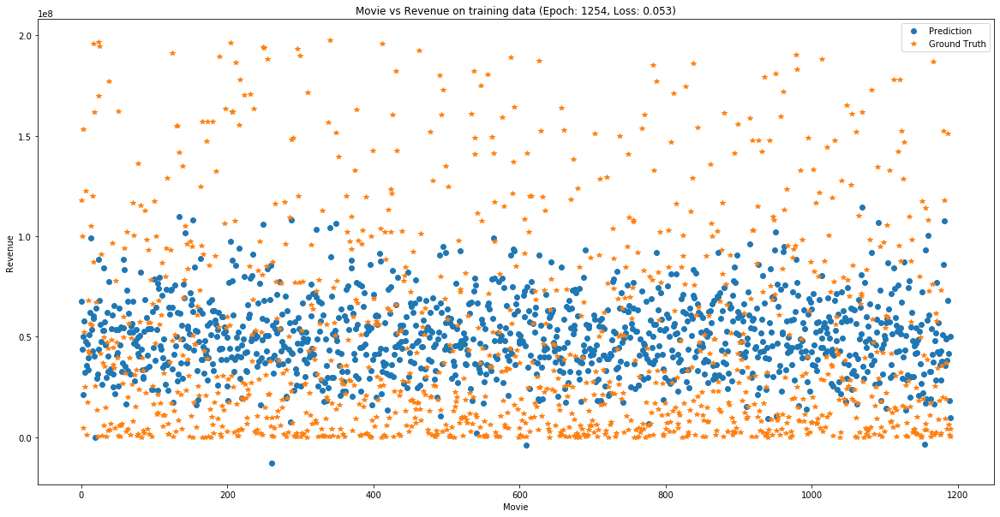

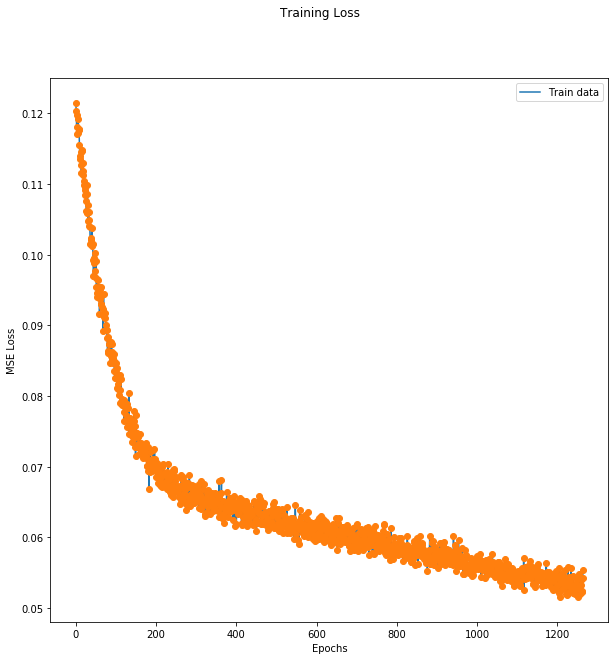

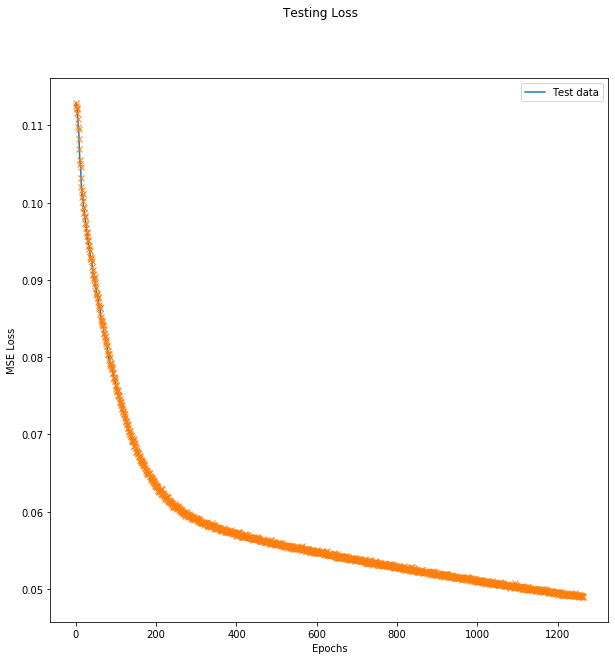

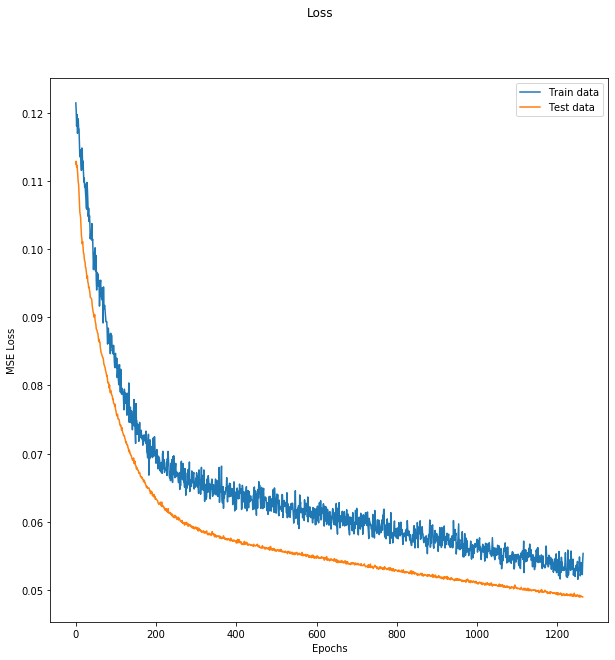

MAPE :  37.44580911278027


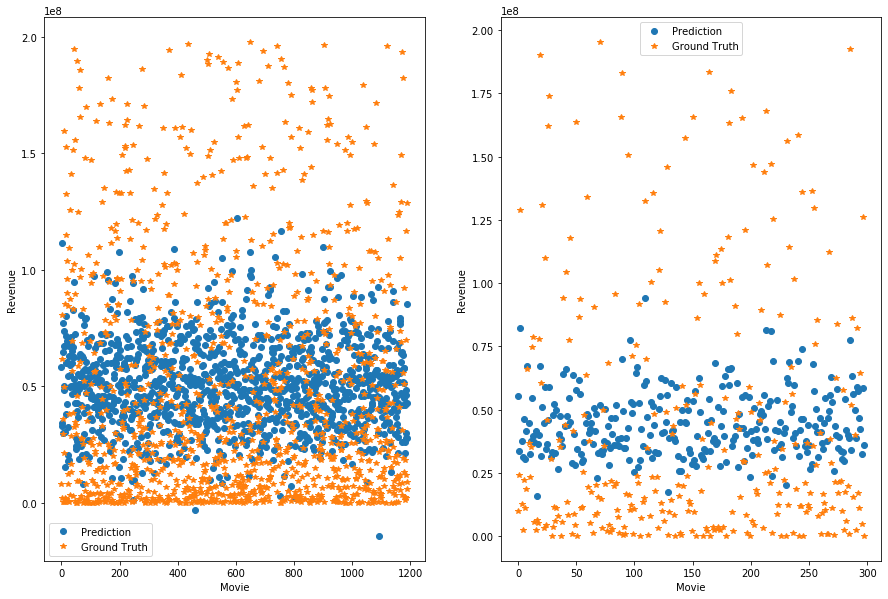

--- Epoch 1265 ---
[Epoch 1265/3000] [Batch 39/40] [Loss: 0.062965 (0.052836)]  [r2: (0.184825)] [rmse: (0.227939)], ETA: 0:40:28.666244
Testing -- [Batch 9/10] [Loss: 0.052120 (0.048980)] [r2: (0.216520)] [rmse: (0.220144)]
--- Epoch 1266 ---
[Epoch 1266/3000] [Batch 39/40] [Loss: 0.046243 (0.053306)]  [r2: (0.181523)] [rmse: (0.228681)], ETA: 0:41:49.059823
Testing -- [Batch 9/10] [Loss: 0.032307 (0.048841)] [r2: (0.166813)] [rmse: (0.218332)]
Train R2 =  0.20899380870004436
Test R2 =  0.23048589479786896


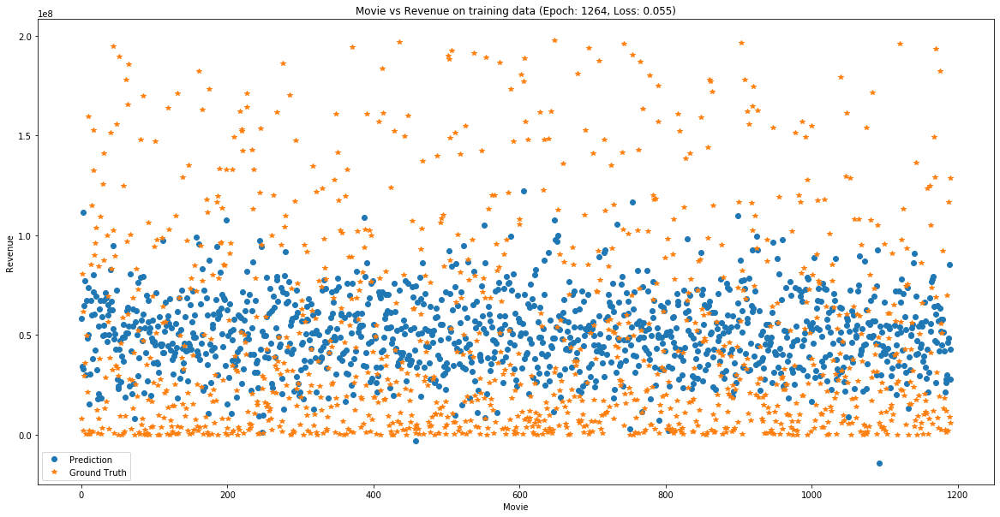

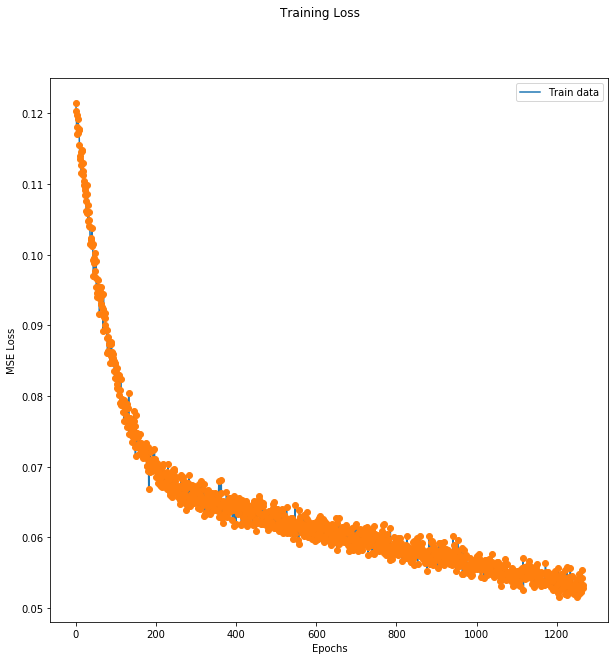

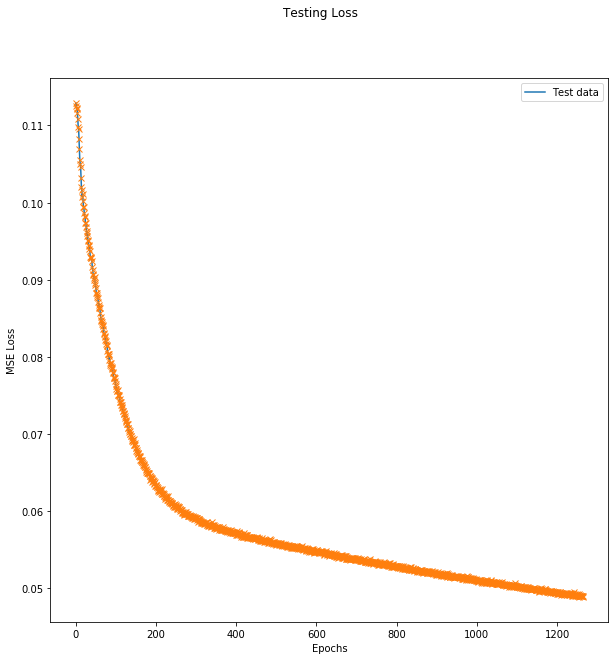

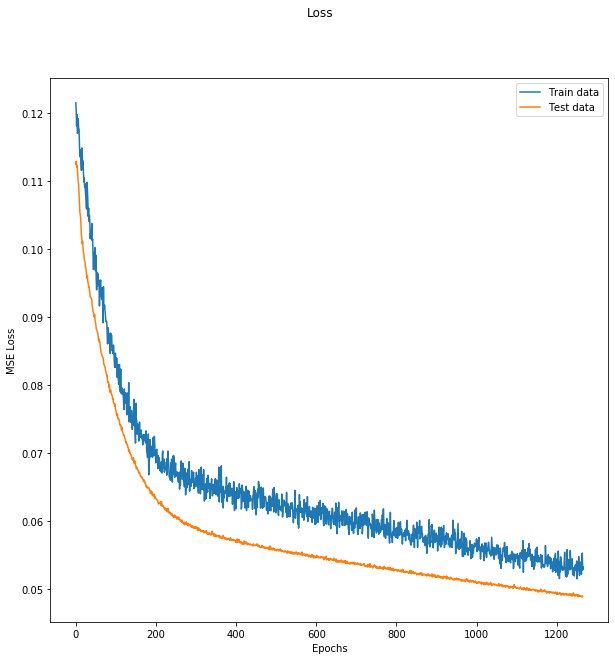

MAPE :  37.52441114382595


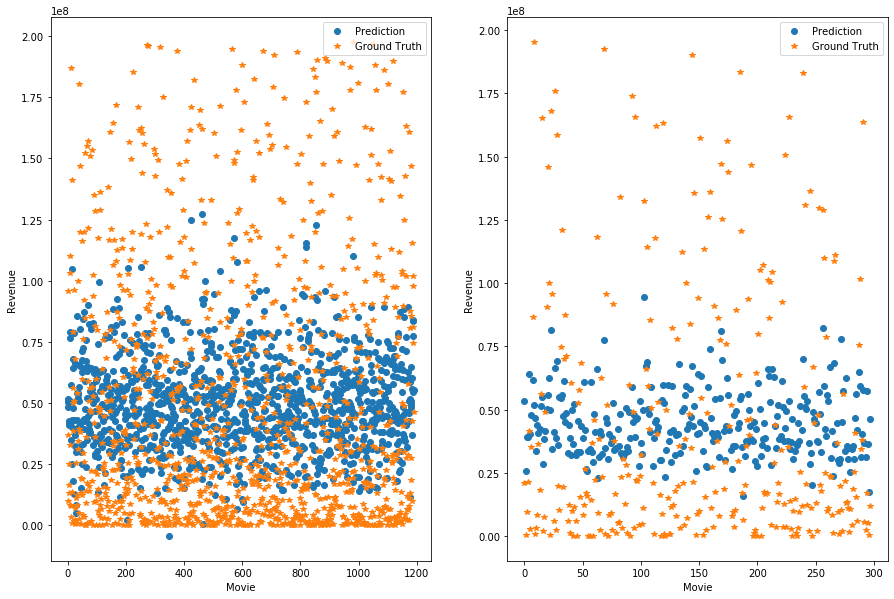

--- Epoch 1267 ---
[Epoch 1267/3000] [Batch 39/40] [Loss: 0.107218 (0.054459)]  [r2: (0.127380)] [rmse: (0.231449)], ETA: 0:41:32.547727
Testing -- [Batch 9/10] [Loss: 0.056951 (0.049009)] [r2: (0.139869)] [rmse: (0.216821)]
--- Epoch 1268 ---
[Epoch 1268/3000] [Batch 39/40] [Loss: 0.049814 (0.053054)]  [r2: (0.179540)] [rmse: (0.228190)], ETA: 0:42:34.302561
Testing -- [Batch 9/10] [Loss: 0.060190 (0.049018)] [r2: (0.201744)] [rmse: (0.219243)]
--- Epoch 1269 ---
[Epoch 1269/3000] [Batch 39/40] [Loss: 0.029917 (0.052960)]  [r2: (0.176360)] [rmse: (0.228459)], ETA: 0:40:23.905304
Testing -- [Batch 9/10] [Loss: 0.054777 (0.048977)] [r2: (0.205255)] [rmse: (0.219460)]
--- Epoch 1270 ---
[Epoch 1270/3000] [Batch 39/40] [Loss: 0.064198 (0.052744)]  [r2: (0.186104)] [rmse: (0.226515)], ETA: 0:40:51.113102
Testing -- [Batch 9/10] [Loss: 0.049738 (0.048922)] [r2: (0.217246)] [rmse: (0.219735)]
--- Epoch 1271 ---
[Epoch 1271/3000] [Batch 39/40] [Loss: 0.059596 (0.052774)]  [r2: (0.177983)] [rm

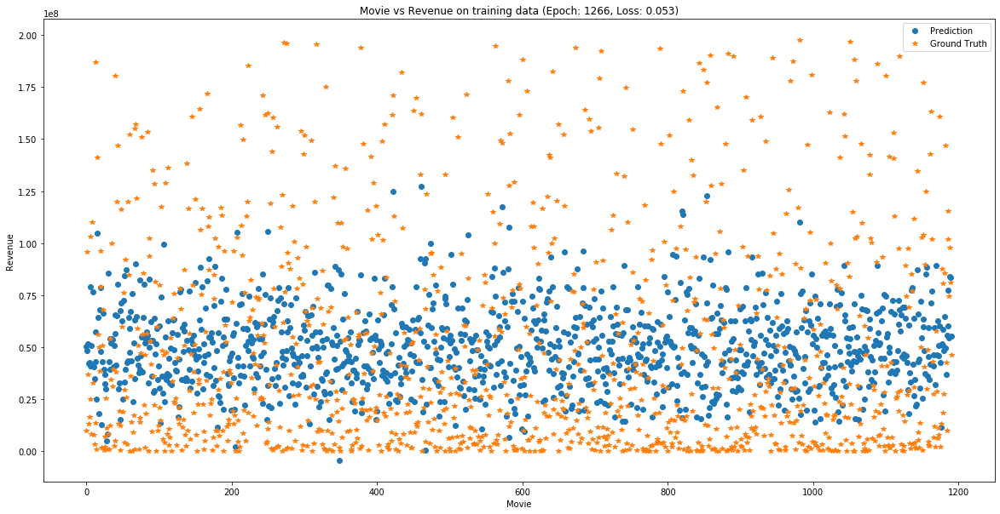

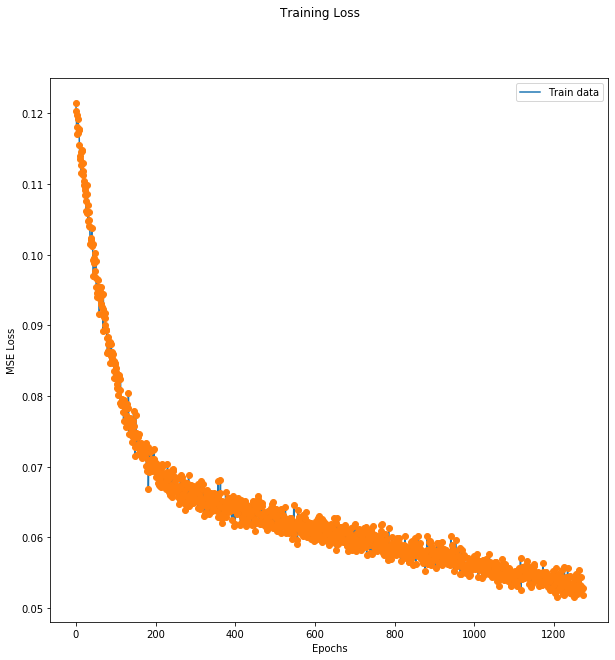

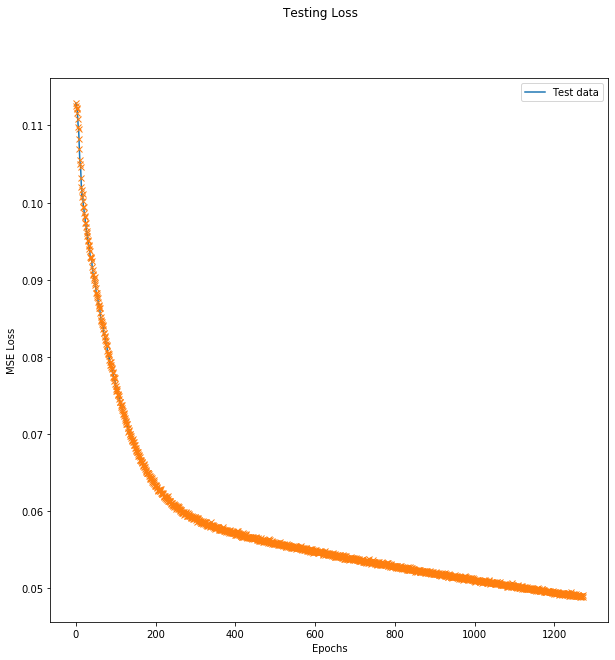

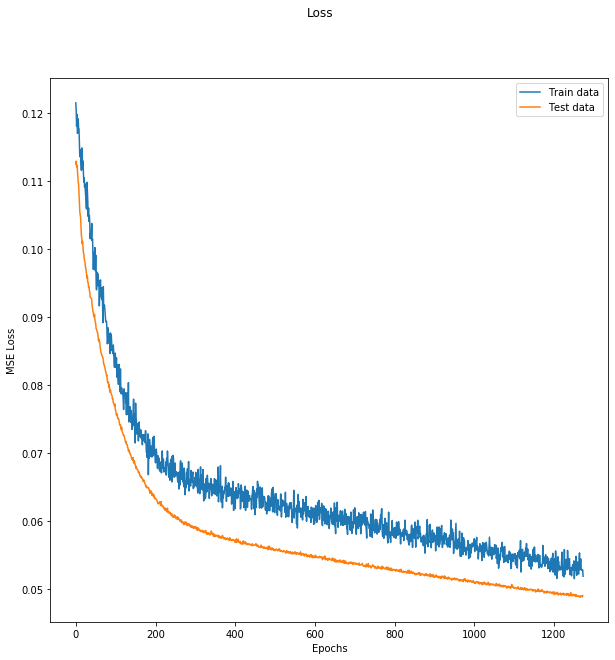

MAPE :  37.459396039081504


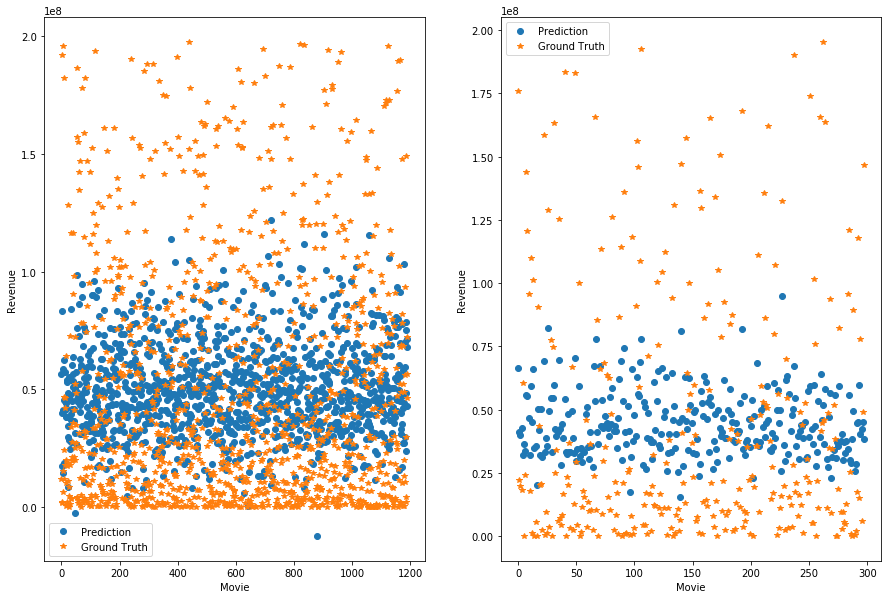

--- Epoch 1274 ---
[Epoch 1274/3000] [Batch 39/40] [Loss: 0.034379 (0.052028)]  [r2: (0.161585)] [rmse: (0.224293)], ETA: 0:41:16.930037
Testing -- [Batch 9/10] [Loss: 0.046161 (0.048873)] [r2: (0.187304)] [rmse: (0.219244)]
--- Epoch 1275 ---
[Epoch 1275/3000] [Batch 39/40] [Loss: 0.035441 (0.052161)]  [r2: (0.178266)] [rmse: (0.225809)], ETA: 0:41:45.056124
Testing -- [Batch 9/10] [Loss: 0.017583 (0.048668)] [r2: (0.209066)] [rmse: (0.215616)]
Train R2 =  0.2248850626136243
Test R2 =  0.23168253230450764


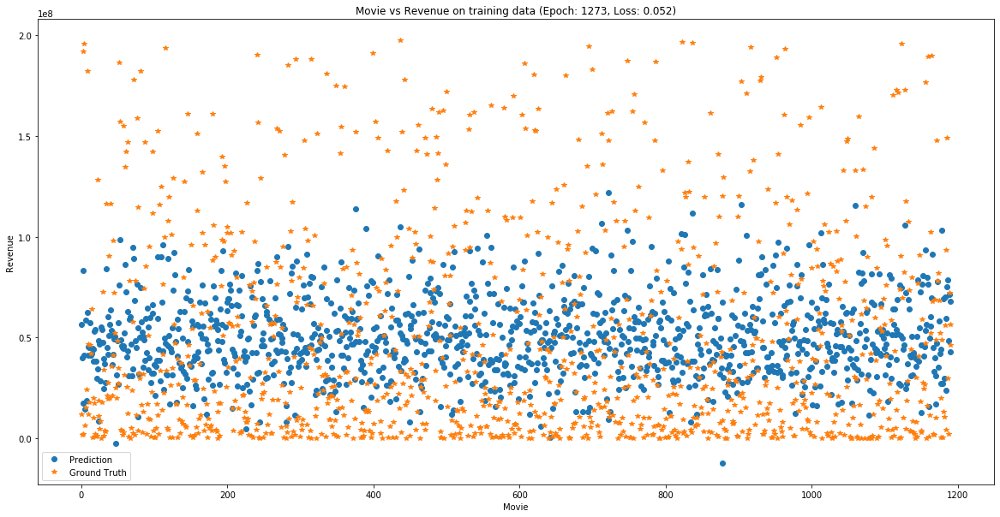

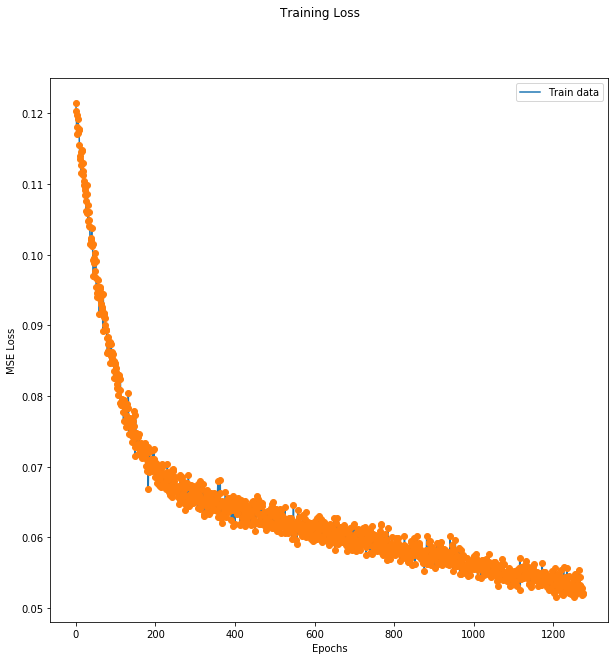

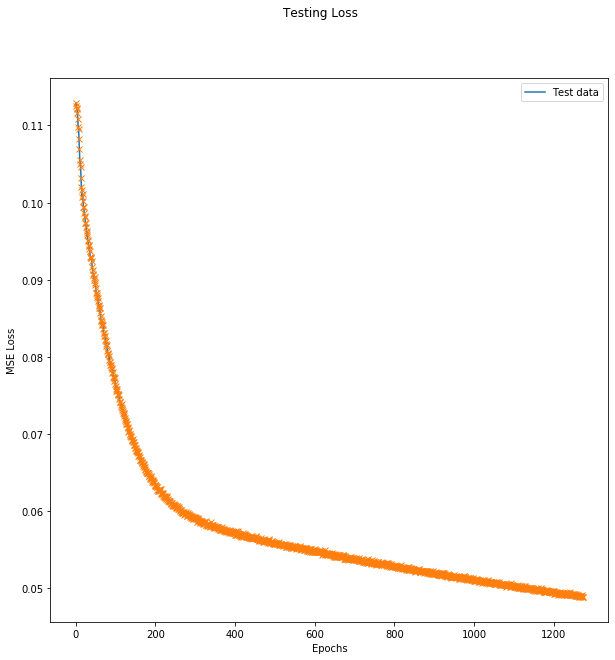

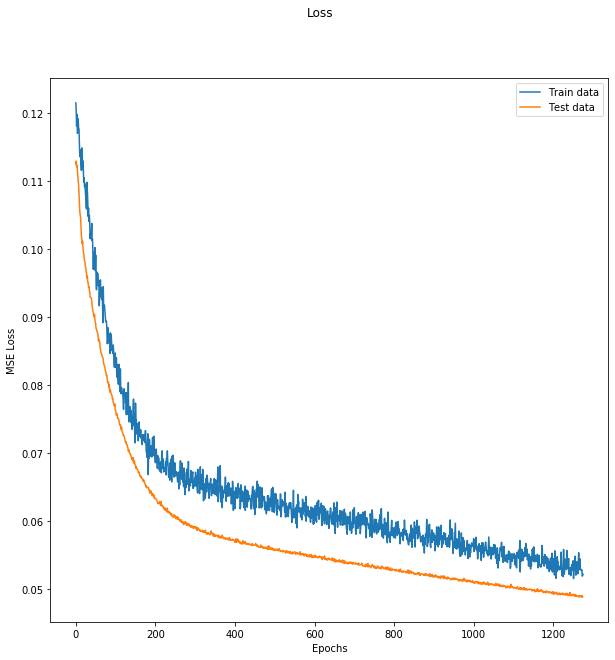

MAPE :  37.53711715051456


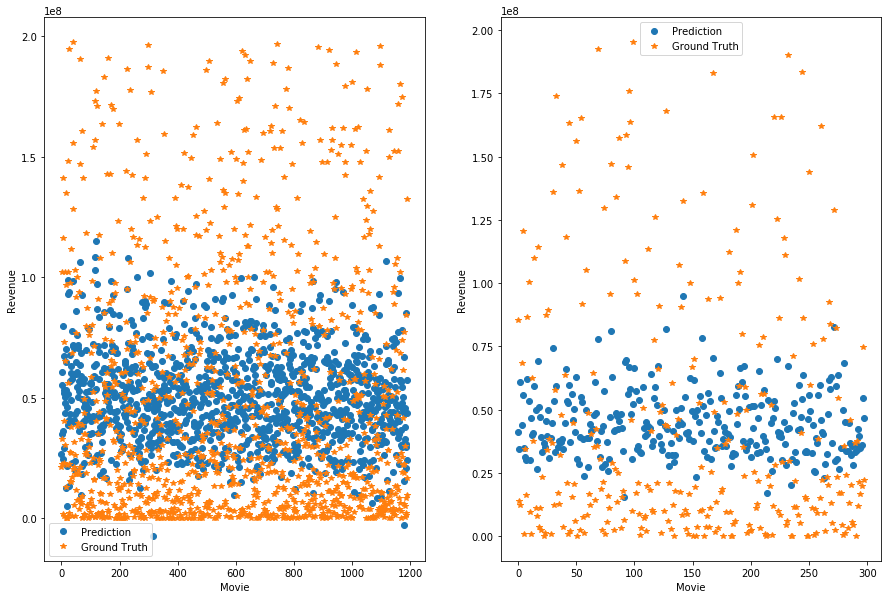

--- Epoch 1276 ---
[Epoch 1276/3000] [Batch 39/40] [Loss: 0.049773 (0.053022)]  [r2: (0.178622)] [rmse: (0.227951)], ETA: 0:39:54.905106
Testing -- [Batch 9/10] [Loss: 0.044036 (0.048848)] [r2: (0.202917)] [rmse: (0.218726)]
--- Epoch 1277 ---
[Epoch 1277/3000] [Batch 39/40] [Loss: 0.048012 (0.053395)]  [r2: (0.164286)] [rmse: (0.229249)], ETA: 0:41:05.412913
Testing -- [Batch 9/10] [Loss: 0.071485 (0.049040)] [r2: (0.186324)] [rmse: (0.217620)]
--- Epoch 1278 ---
[Epoch 1278/3000] [Batch 39/40] [Loss: 0.048110 (0.052829)]  [r2: (0.172200)] [rmse: (0.227668)], ETA: 0:40:24.590083
Testing -- [Batch 9/10] [Loss: 0.073841 (0.049035)] [r2: (0.208416)] [rmse: (0.219422)]
--- Epoch 1279 ---
[Epoch 1279/3000] [Batch 39/40] [Loss: 0.031408 (0.053600)]  [r2: (0.144421)] [rmse: (0.228619)], ETA: 0:40:58.743928
Testing -- [Batch 9/10] [Loss: 0.030612 (0.048743)] [r2: (0.180186)] [rmse: (0.219269)]
--- Epoch 1280 ---
[Epoch 1280/3000] [Batch 39/40] [Loss: 0.027343 (0.050145)]  [r2: (0.223347)] [rm

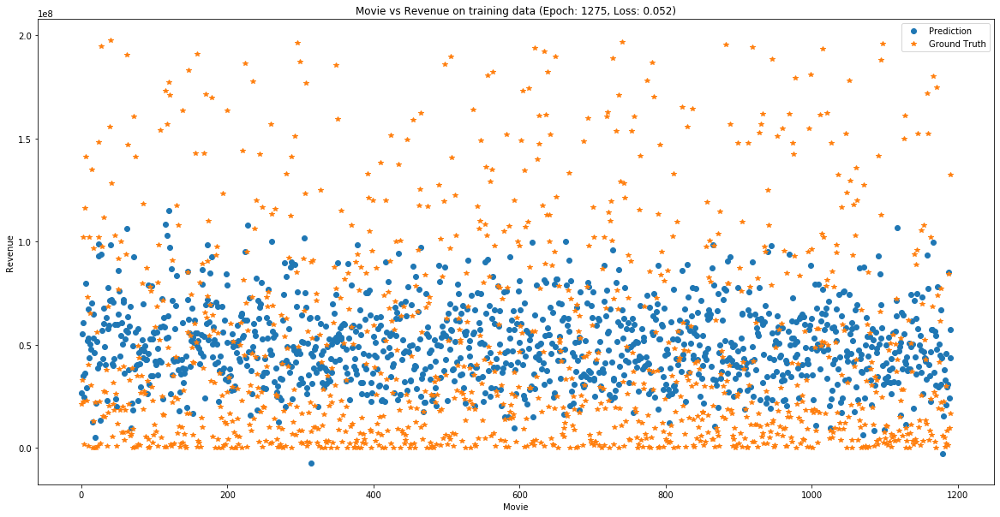

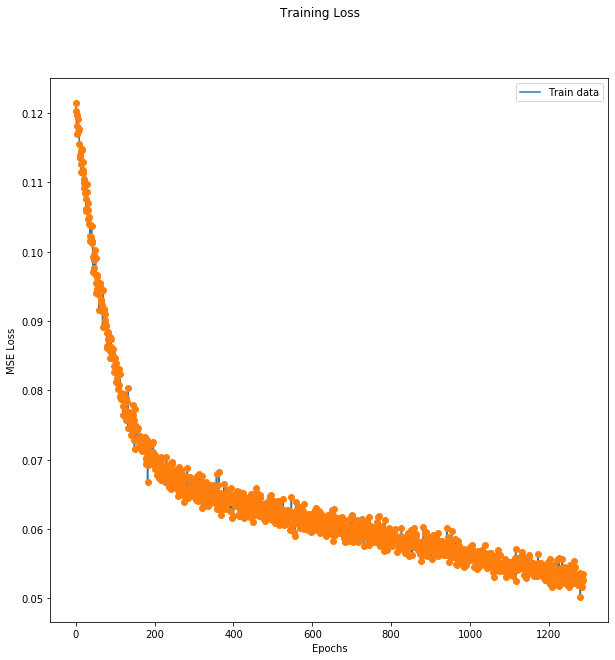

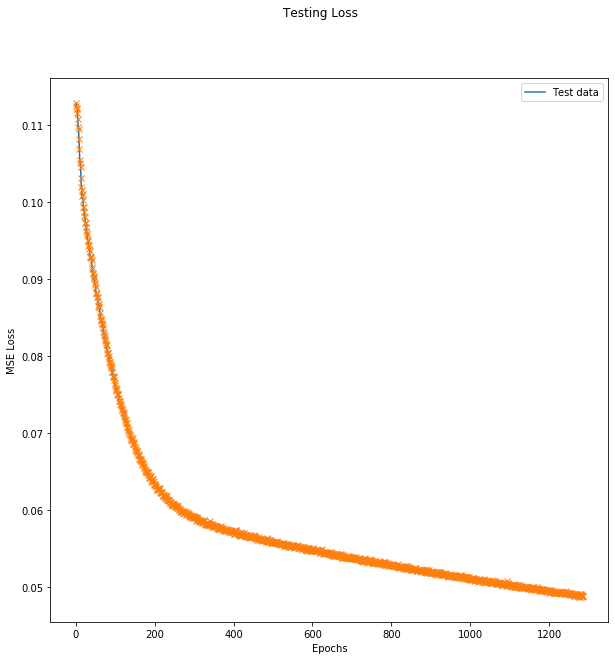

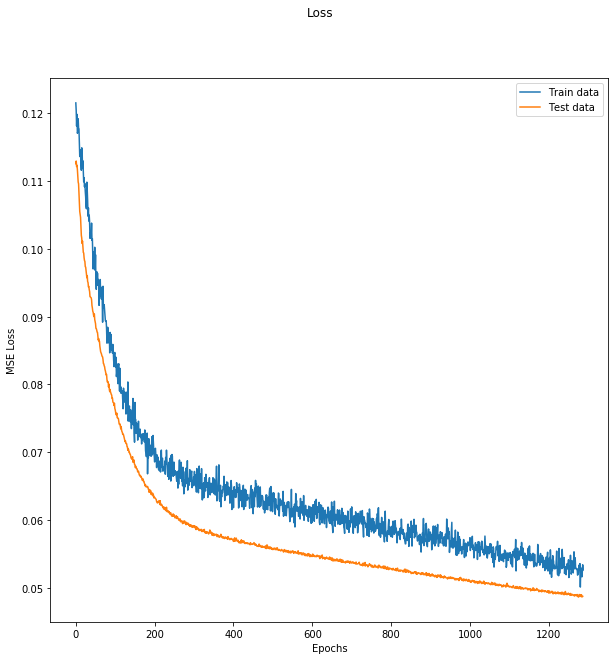

MAPE :  37.3656321236521


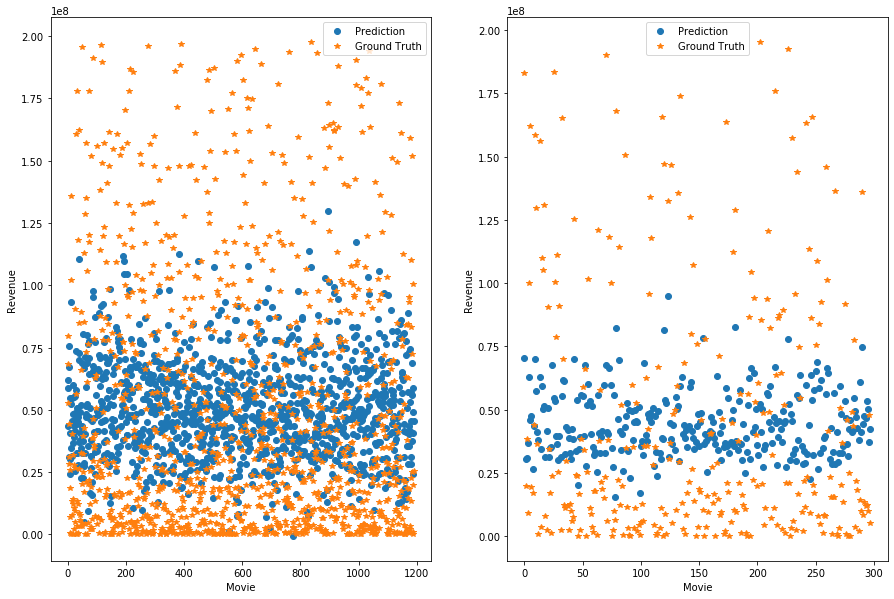

--- Epoch 1288 ---
[Epoch 1288/3000] [Batch 39/40] [Loss: 0.034776 (0.053593)]  [r2: (0.159857)] [rmse: (0.229426)], ETA: 0:39:26.509759
Testing -- [Batch 9/10] [Loss: 0.054644 (0.048812)] [r2: (0.207890)] [rmse: (0.218761)]
--- Epoch 1289 ---
[Epoch 1289/3000] [Batch 39/40] [Loss: 0.057018 (0.053767)]  [r2: (0.134233)] [rmse: (0.229860)], ETA: 0:40:51.869284
Testing -- [Batch 9/10] [Loss: 0.042298 (0.048736)] [r2: (0.223109)] [rmse: (0.219687)]
--- Epoch 1290 ---
[Epoch 1290/3000] [Batch 39/40] [Loss: 0.058018 (0.053552)]  [r2: (0.176401)] [rmse: (0.228604)], ETA: 0:39:37.059470
Testing -- [Batch 9/10] [Loss: 0.050478 (0.048790)] [r2: (0.202682)] [rmse: (0.218584)]
--- Epoch 1291 ---
[Epoch 1291/3000] [Batch 39/40] [Loss: 0.038714 (0.051000)]  [r2: (0.202772)] [rmse: (0.223454)], ETA: 0:39:24.657223
Testing -- [Batch 9/10] [Loss: 0.048414 (0.048764)] [r2: (0.191349)] [rmse: (0.218784)]
--- Epoch 1292 ---
[Epoch 1292/3000] [Batch 39/40] [Loss: 0.040160 (0.051831)]  [r2: (0.210719)] [rm

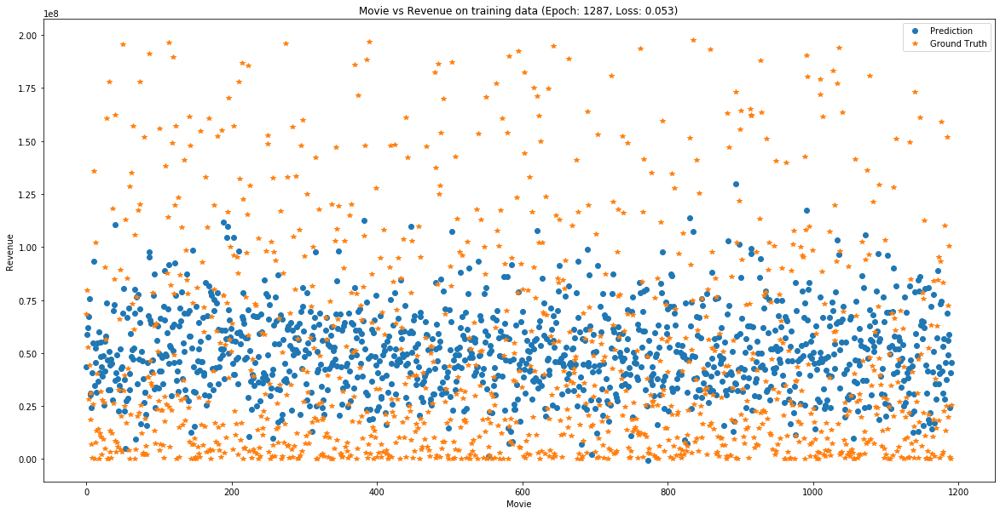

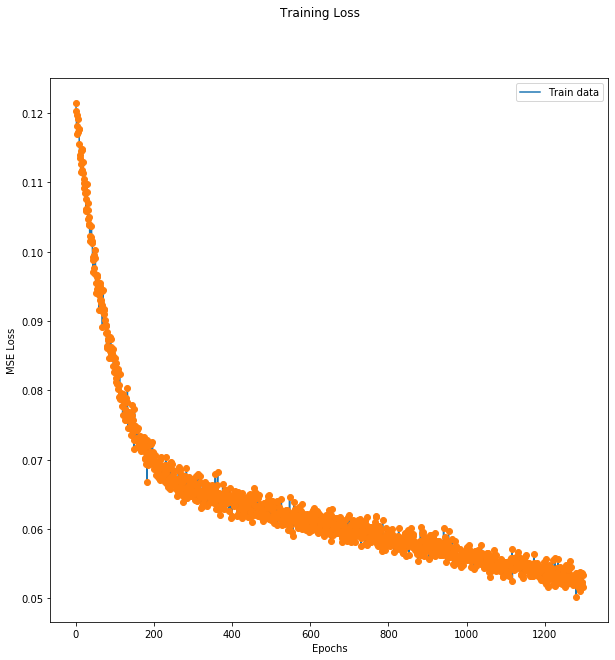

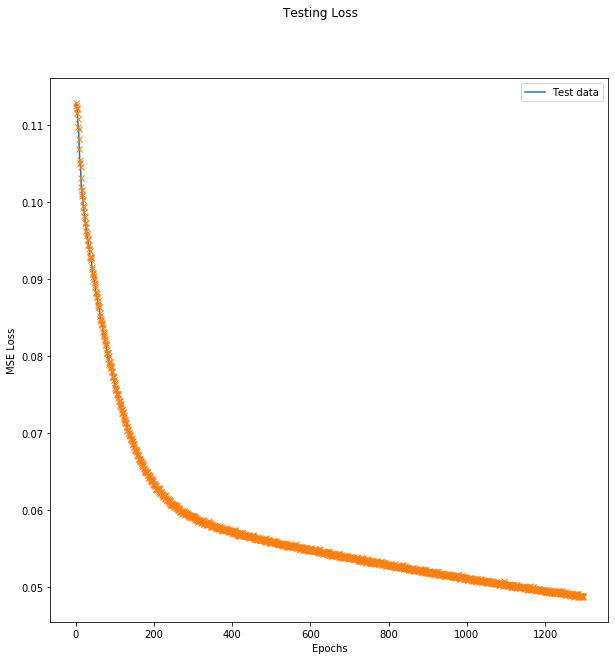

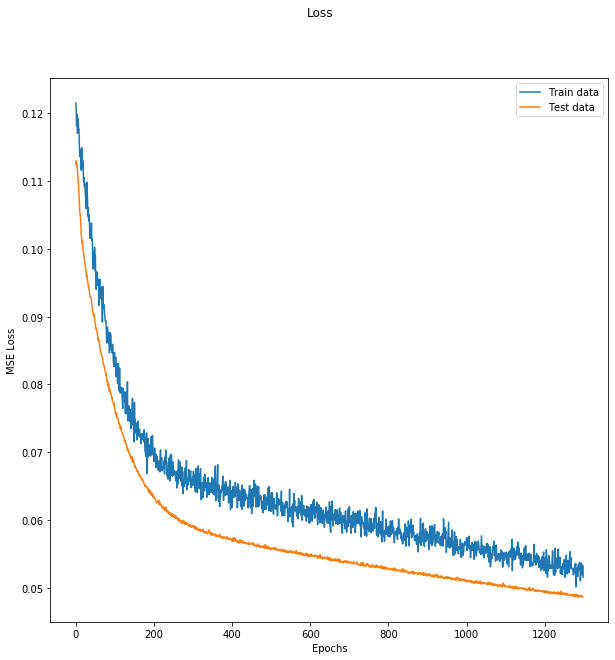

MAPE :  37.23466550948245


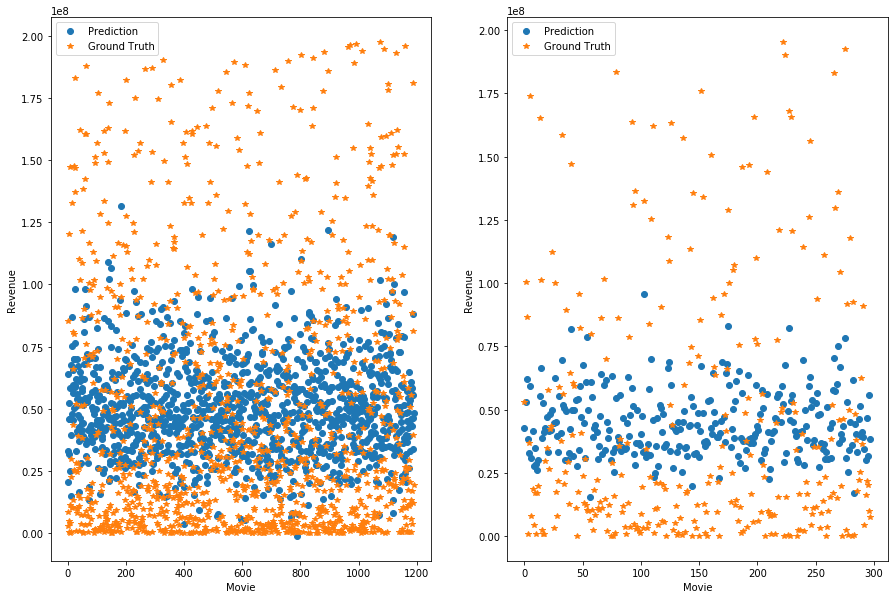

--- Epoch 1299 ---
[Epoch 1299/3000] [Batch 39/40] [Loss: 0.059235 (0.051398)]  [r2: (0.186516)] [rmse: (0.224937)], ETA: 0:41:02.985019
Testing -- [Batch 9/10] [Loss: 0.026913 (0.048541)] [r2: (0.224846)] [rmse: (0.218142)]
Train R2 =  0.23894604489039006
Test R2 =  0.23467414280896015


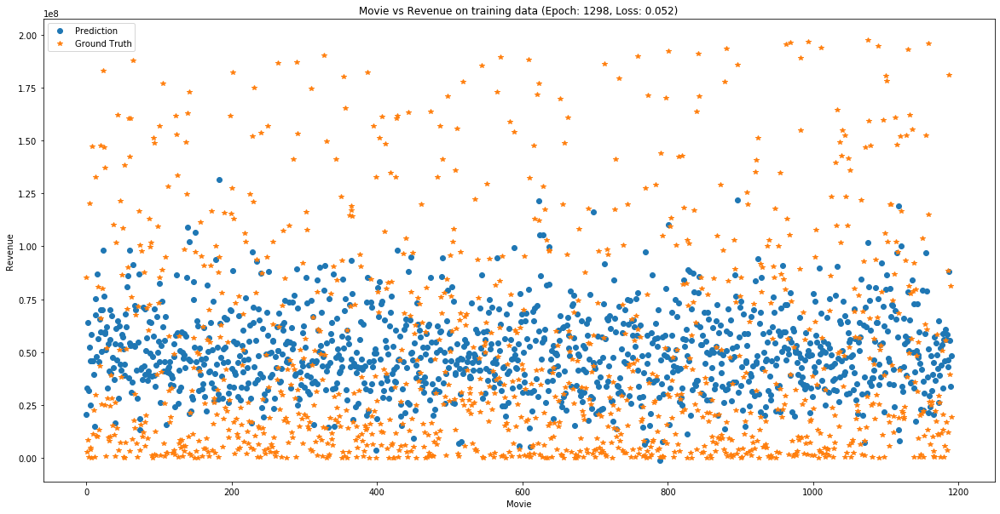

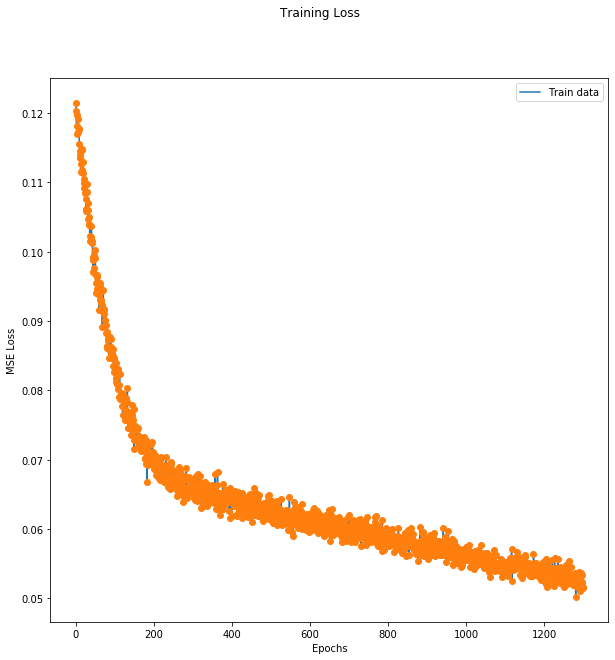

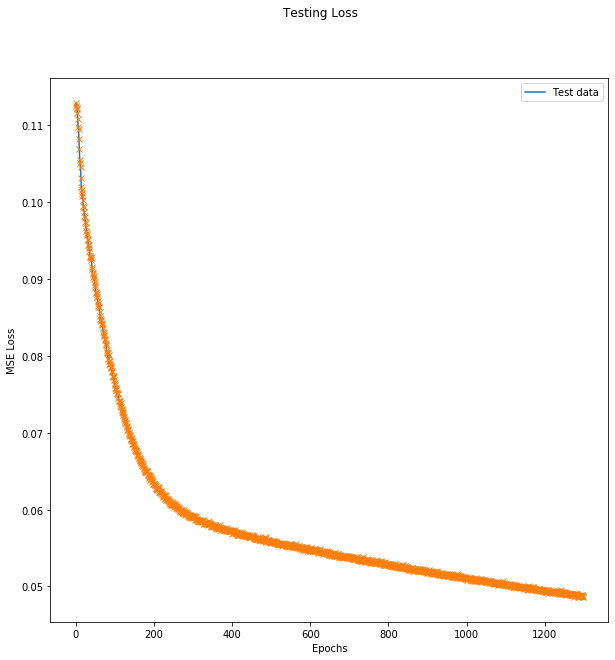

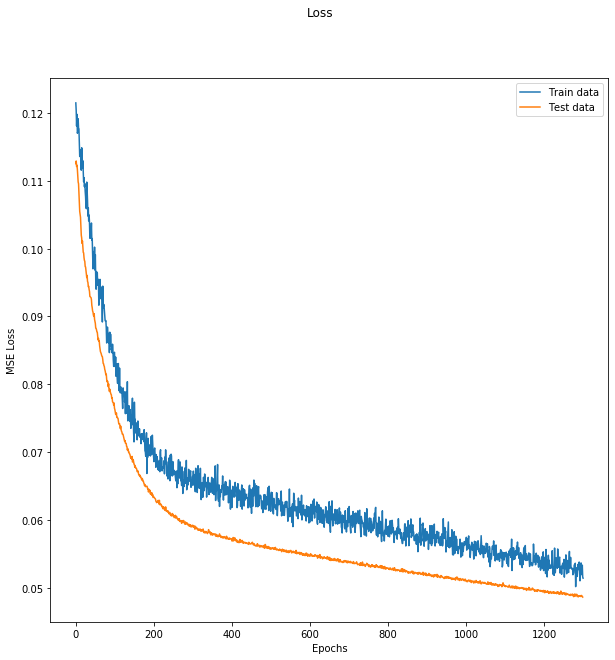

MAPE :  37.258094456544576


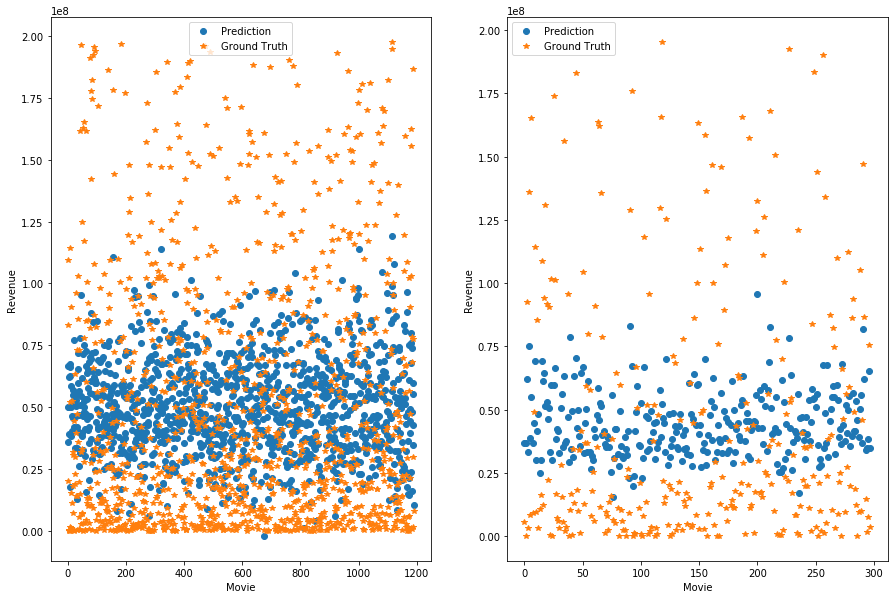

--- Epoch 1300 ---
[Epoch 1300/3000] [Batch 39/40] [Loss: 0.070101 (0.052296)]  [r2: (0.202517)] [rmse: (0.226278)], ETA: 0:39:38.251957
Testing -- [Batch 9/10] [Loss: 0.057710 (0.048744)] [r2: (0.219254)] [rmse: (0.218606)]
--- Epoch 1301 ---
[Epoch 1301/3000] [Batch 39/40] [Loss: 0.036654 (0.052817)]  [r2: (0.127808)] [rmse: (0.227692)], ETA: 0:41:41.607895
Testing -- [Batch 9/10] [Loss: 0.079392 (0.048879)] [r2: (0.171138)] [rmse: (0.218936)]
--- Epoch 1302 ---
[Epoch 1302/3000] [Batch 39/40] [Loss: 0.074511 (0.053778)]  [r2: (0.158334)] [rmse: (0.229662)], ETA: 0:39:44.450763
Testing -- [Batch 9/10] [Loss: 0.053261 (0.048721)] [r2: (0.214927)] [rmse: (0.219287)]
--- Epoch 1303 ---
[Epoch 1303/3000] [Batch 39/40] [Loss: 0.060732 (0.054690)]  [r2: (0.163478)] [rmse: (0.231481)], ETA: 0:39:22.989238
Testing -- [Batch 9/10] [Loss: 0.041919 (0.048628)] [r2: (0.206807)] [rmse: (0.218892)]
--- Epoch 1304 ---
[Epoch 1304/3000] [Batch 39/40] [Loss: 0.032783 (0.053444)]  [r2: (0.186449)] [rm

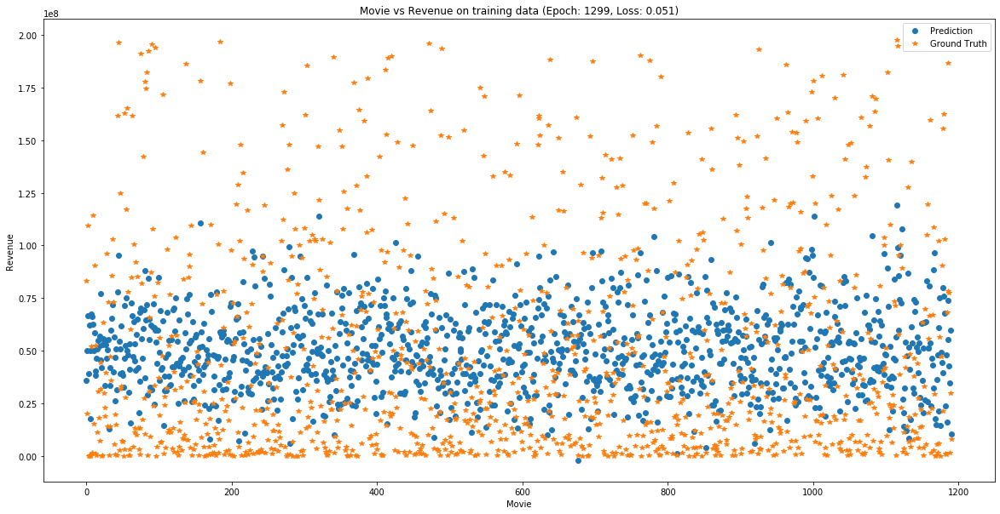

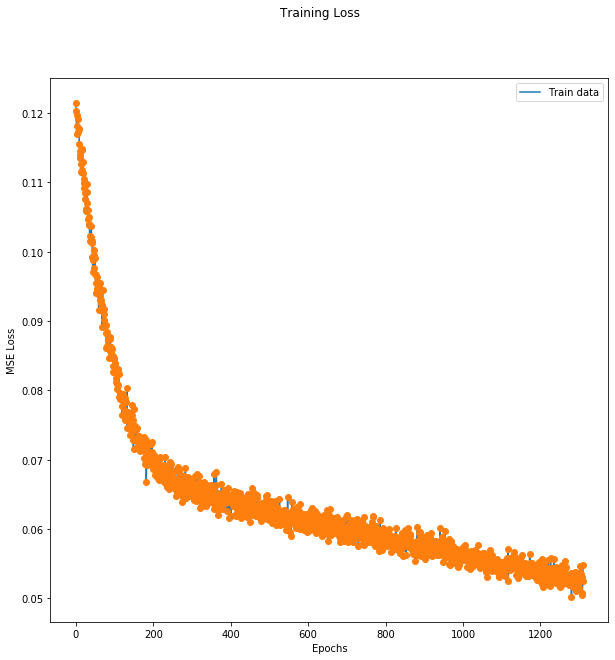

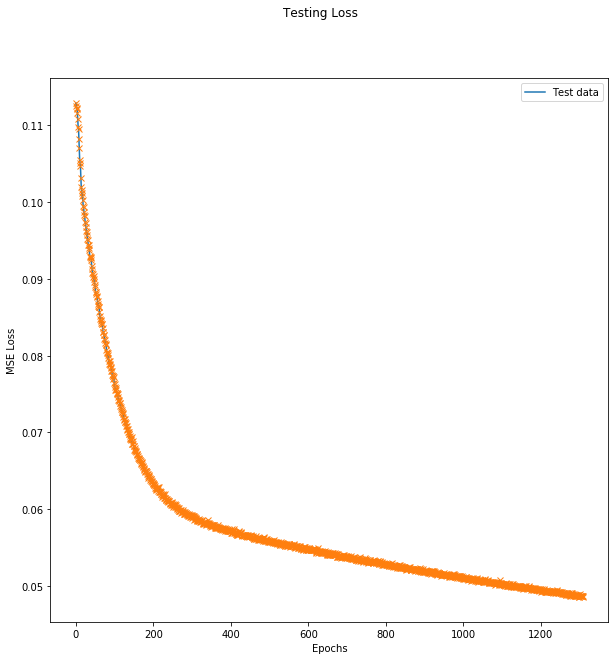

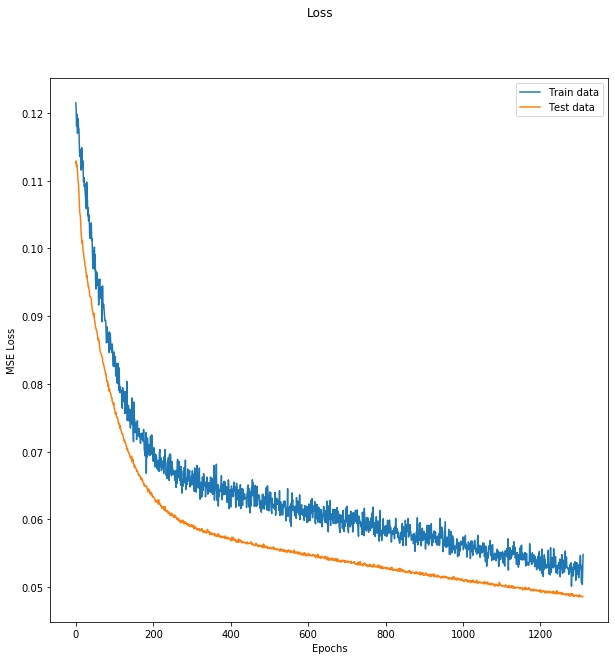

MAPE :  37.1088266874186


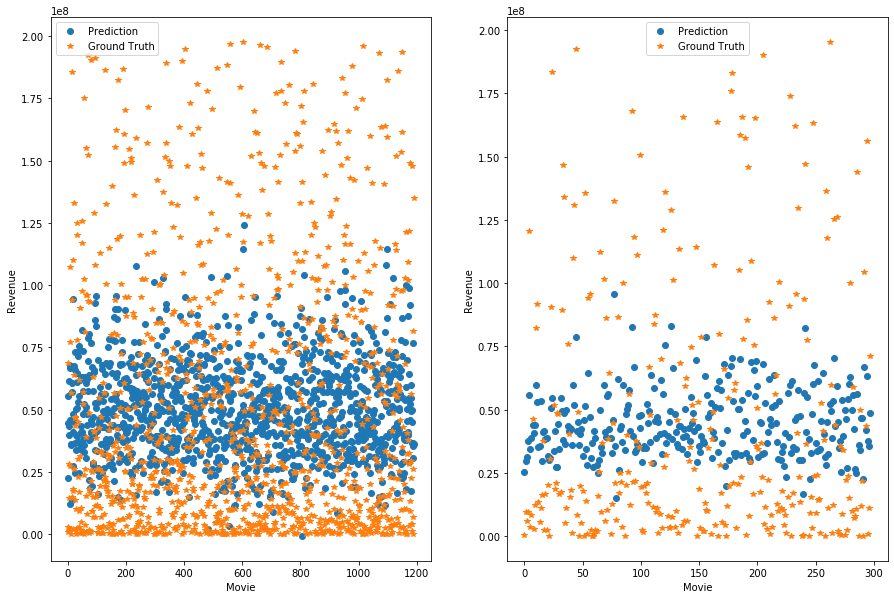

--- Epoch 1311 ---
[Epoch 1311/3000] [Batch 39/40] [Loss: 0.044917 (0.052015)]  [r2: (0.186407)] [rmse: (0.226626)], ETA: 0:39:12.454961
Testing -- [Batch 9/10] [Loss: 0.046534 (0.048569)] [r2: (0.218405)] [rmse: (0.217693)]
--- Epoch 1312 ---
[Epoch 1312/3000] [Batch 39/40] [Loss: 0.065738 (0.054667)]  [r2: (0.120749)] [rmse: (0.230864)], ETA: 0:39:40.342825
Testing -- [Batch 9/10] [Loss: 0.042425 (0.048537)] [r2: (0.208964)] [rmse: (0.217355)]
--- Epoch 1313 ---
[Epoch 1313/3000] [Batch 39/40] [Loss: 0.082734 (0.052325)]  [r2: (0.178566)] [rmse: (0.226148)], ETA: 0:39:34.188494
Testing -- [Batch 9/10] [Loss: 0.033863 (0.048491)] [r2: (0.195034)] [rmse: (0.218400)]
Train R2 =  0.2277364092242603
Test R2 =  0.23619444308801796


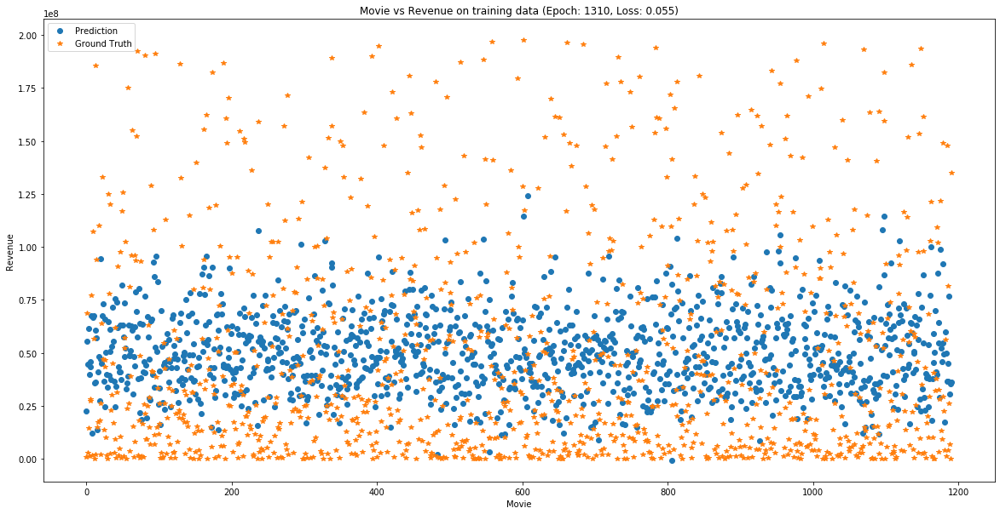

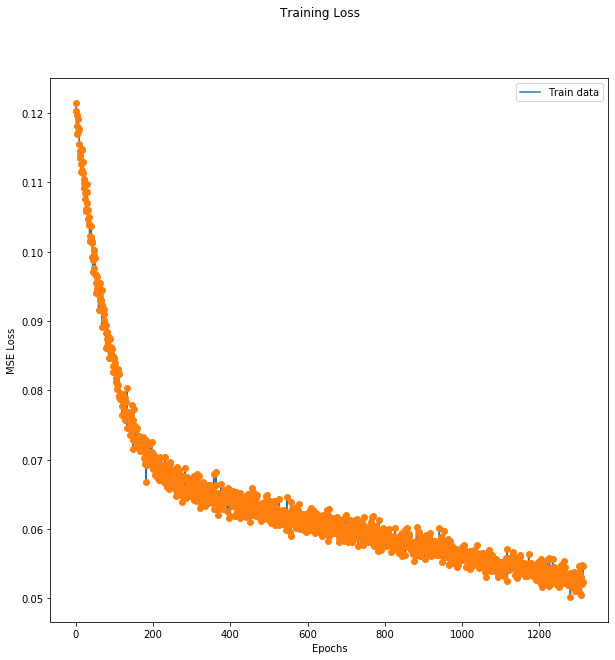

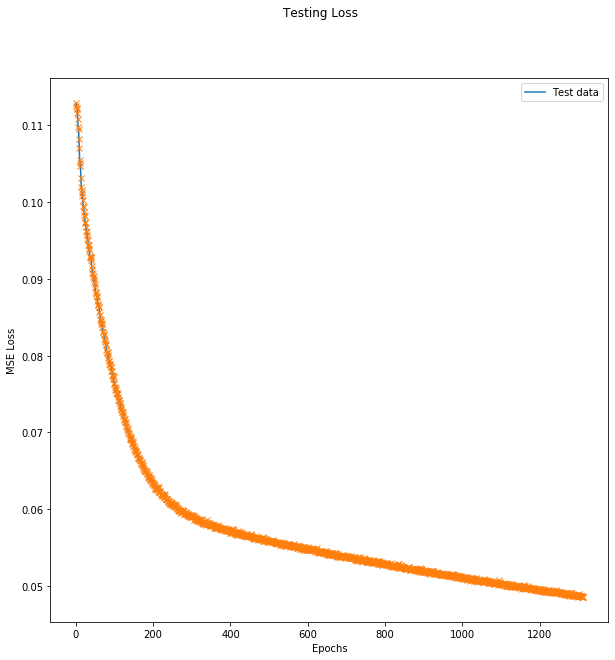

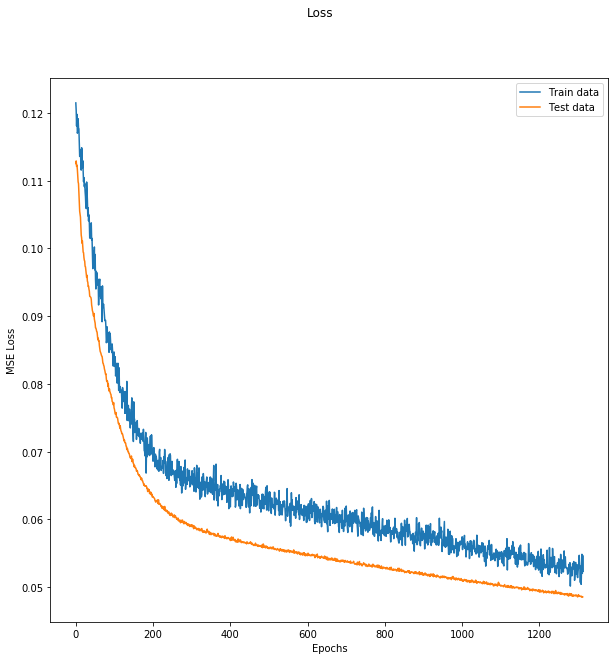

MAPE :  37.04491341228829


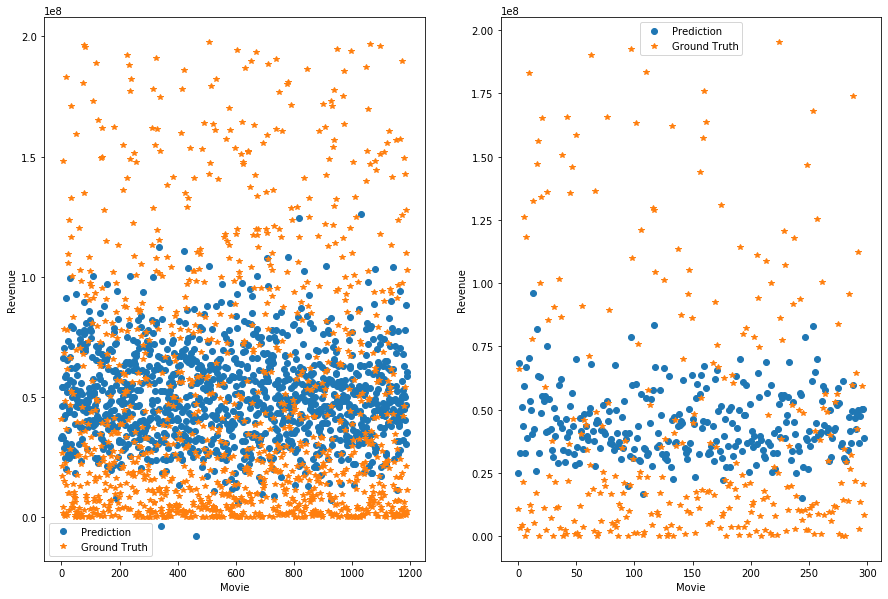

--- Epoch 1314 ---
[Epoch 1314/3000] [Batch 39/40] [Loss: 0.053944 (0.051743)]  [r2: (0.182855)] [rmse: (0.224785)], ETA: 0:38:34.640340
Testing -- [Batch 9/10] [Loss: 0.032192 (0.048456)] [r2: (0.218793)] [rmse: (0.217499)]
Train R2 =  0.23320315681782078
Test R2 =  0.2365788770386571


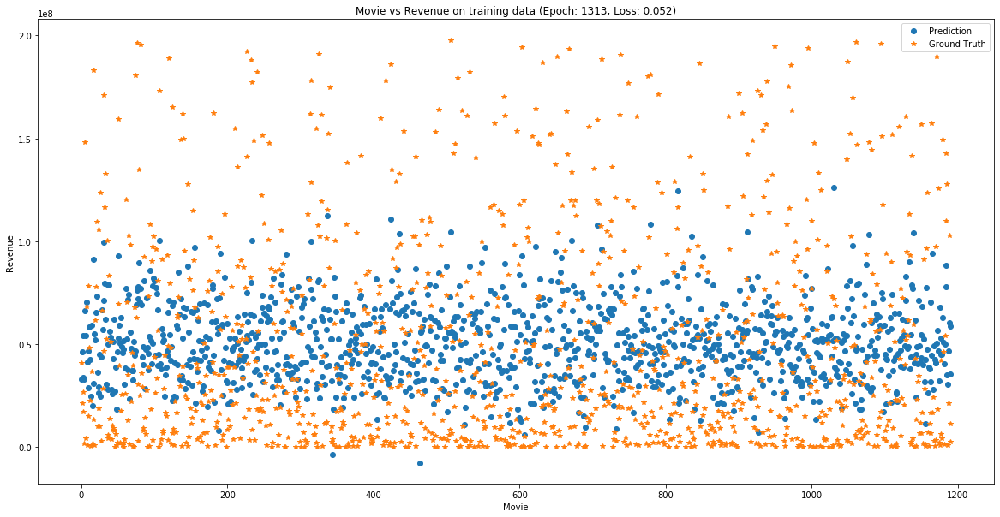

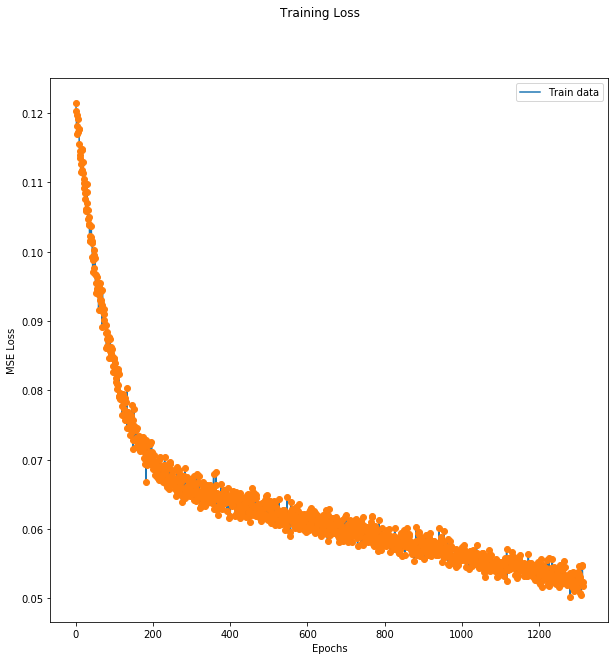

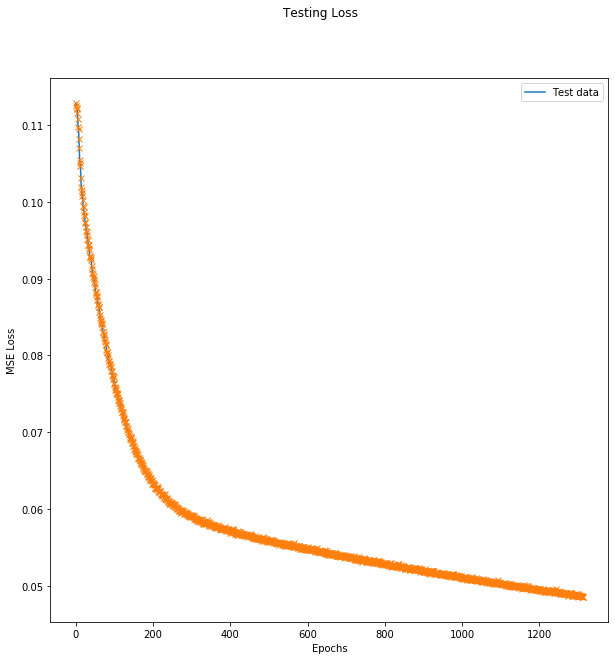

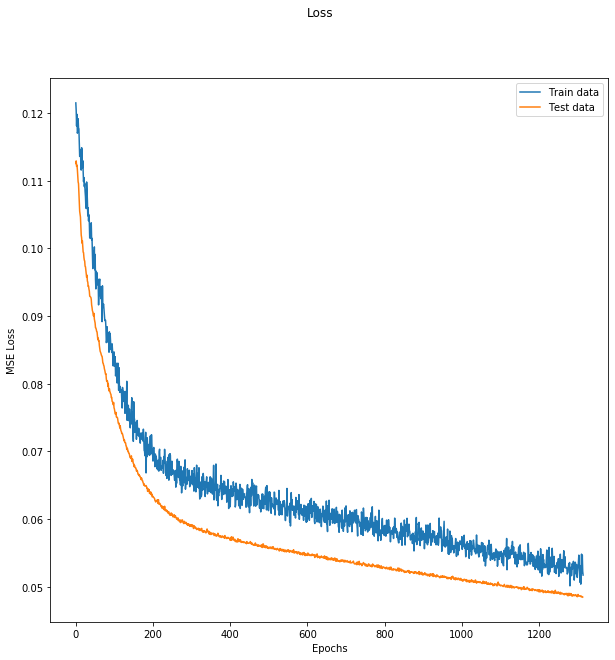

MAPE :  36.83753966816028


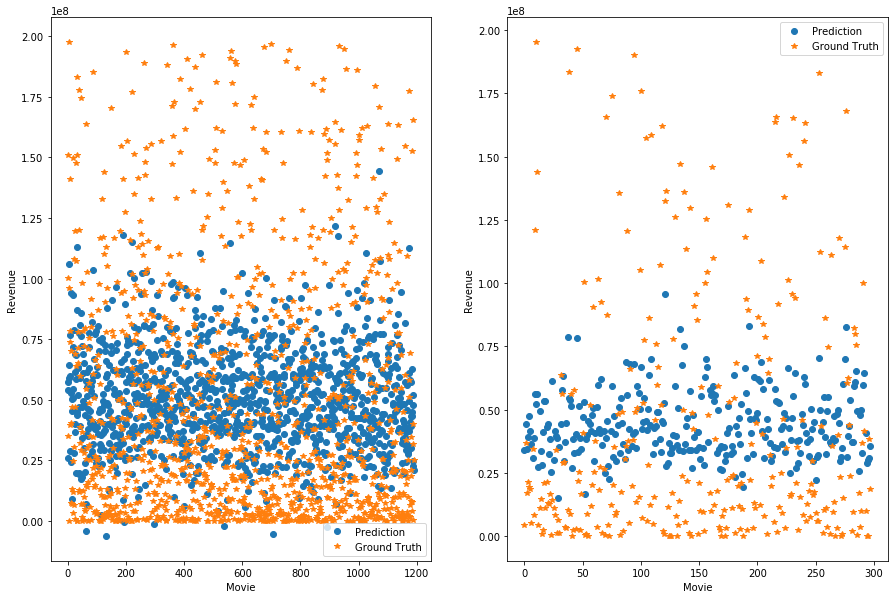

--- Epoch 1315 ---
[Epoch 1315/3000] [Batch 39/40] [Loss: 0.045103 (0.052461)]  [r2: (0.176609)] [rmse: (0.227279)], ETA: 0:39:24.626931
Testing -- [Batch 9/10] [Loss: 0.047742 (0.048558)] [r2: (0.198449)] [rmse: (0.217733)]
--- Epoch 1316 ---
[Epoch 1316/3000] [Batch 39/40] [Loss: 0.027614 (0.052363)]  [r2: (0.186410)] [rmse: (0.226453)], ETA: 0:40:58.033539
Testing -- [Batch 9/10] [Loss: 0.047552 (0.048574)] [r2: (0.221373)] [rmse: (0.219243)]
--- Epoch 1317 ---
[Epoch 1317/3000] [Batch 39/40] [Loss: 0.066393 (0.052076)]  [r2: (0.182930)] [rmse: (0.225894)], ETA: 0:39:05.905915
Testing -- [Batch 9/10] [Loss: 0.044658 (0.048538)] [r2: (0.242761)] [rmse: (0.216201)]
--- Epoch 1318 ---
[Epoch 1318/3000] [Batch 39/40] [Loss: 0.067890 (0.053142)]  [r2: (0.176997)] [rmse: (0.227640)], ETA: 0:39:34.442041
Testing -- [Batch 9/10] [Loss: 0.042755 (0.048513)] [r2: (0.221950)] [rmse: (0.218922)]
--- Epoch 1319 ---
[Epoch 1319/3000] [Batch 39/40] [Loss: 0.046592 (0.053066)]  [r2: (0.169593)] [rm

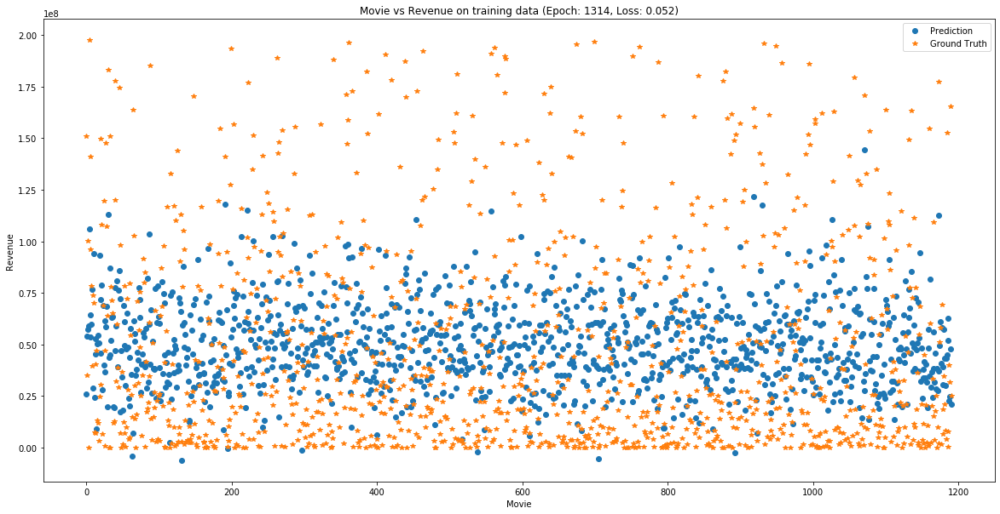

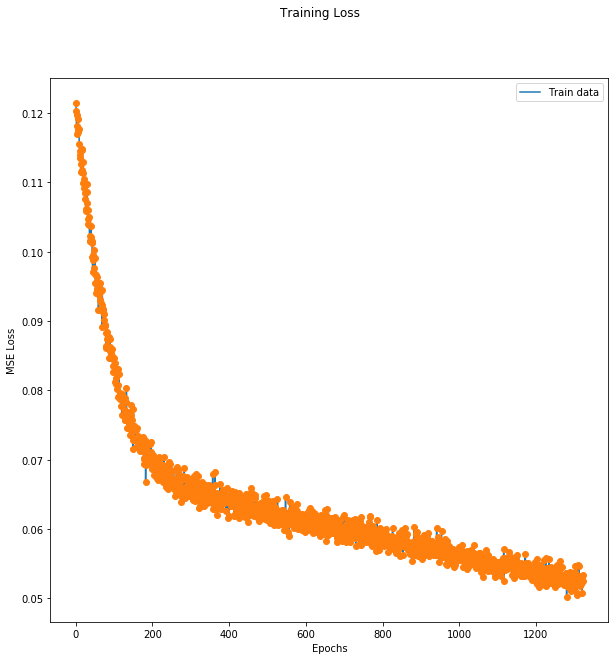

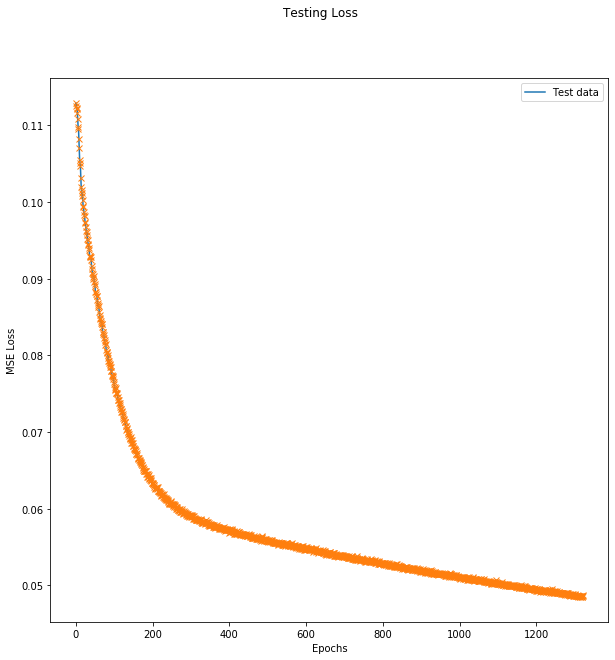

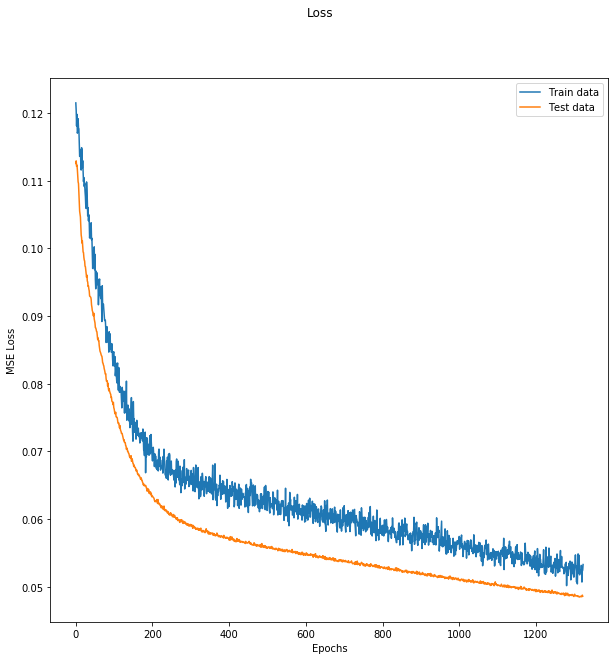

MAPE :  37.26753840767379


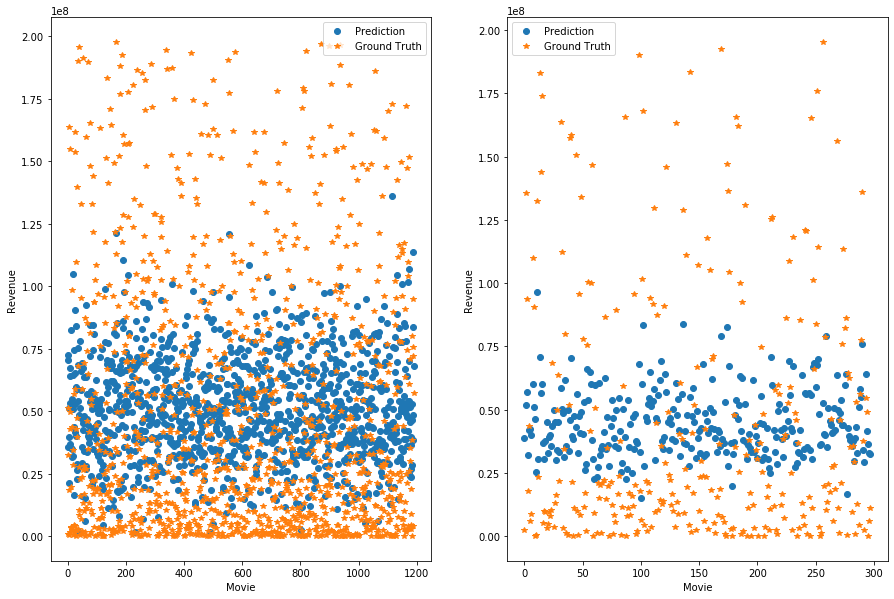

--- Epoch 1324 ---
[Epoch 1324/3000] [Batch 39/40] [Loss: 0.063946 (0.052665)]  [r2: (0.138883)] [rmse: (0.226937)], ETA: 0:38:15.951778
Testing -- [Batch 9/10] [Loss: 0.050026 (0.048531)] [r2: (0.198054)] [rmse: (0.216608)]
--- Epoch 1325 ---
[Epoch 1325/3000] [Batch 39/40] [Loss: 0.039866 (0.053031)]  [r2: (0.174231)] [rmse: (0.227972)], ETA: 0:39:07.152992
Testing -- [Batch 9/10] [Loss: 0.100421 (0.048847)] [r2: (0.217061)] [rmse: (0.216655)]
--- Epoch 1326 ---
[Epoch 1326/3000] [Batch 39/40] [Loss: 0.044902 (0.051677)]  [r2: (0.209897)] [rmse: (0.225454)], ETA: 0:39:16.983358
Testing -- [Batch 9/10] [Loss: 0.062678 (0.048606)] [r2: (0.193755)] [rmse: (0.217985)]
--- Epoch 1327 ---
[Epoch 1327/3000] [Batch 39/40] [Loss: 0.054242 (0.053521)]  [r2: (0.165593)] [rmse: (0.230036)], ETA: 0:38:33.446074
Testing -- [Batch 9/10] [Loss: 0.059451 (0.048577)] [r2: (0.187249)] [rmse: (0.218875)]
--- Epoch 1328 ---
[Epoch 1328/3000] [Batch 39/40] [Loss: 0.097170 (0.053692)]  [r2: (0.182410)] [rm

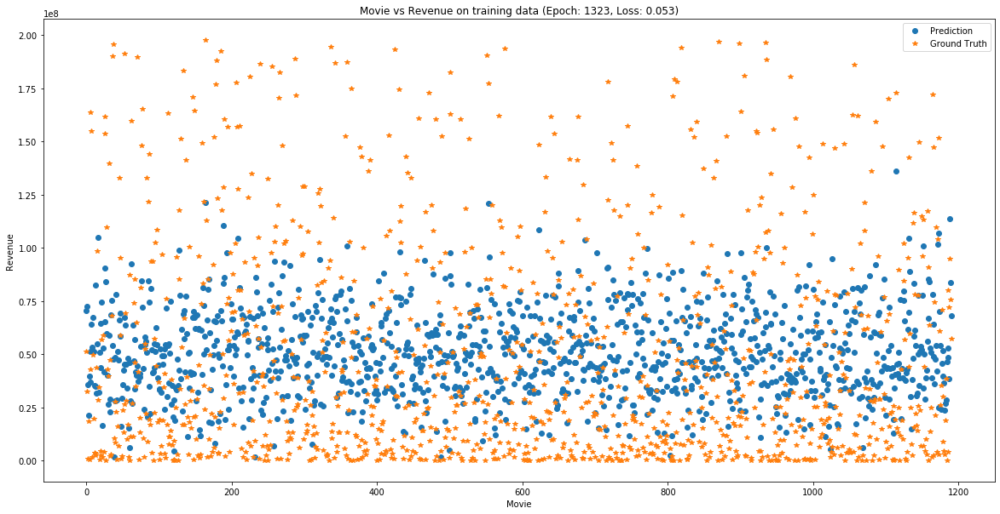

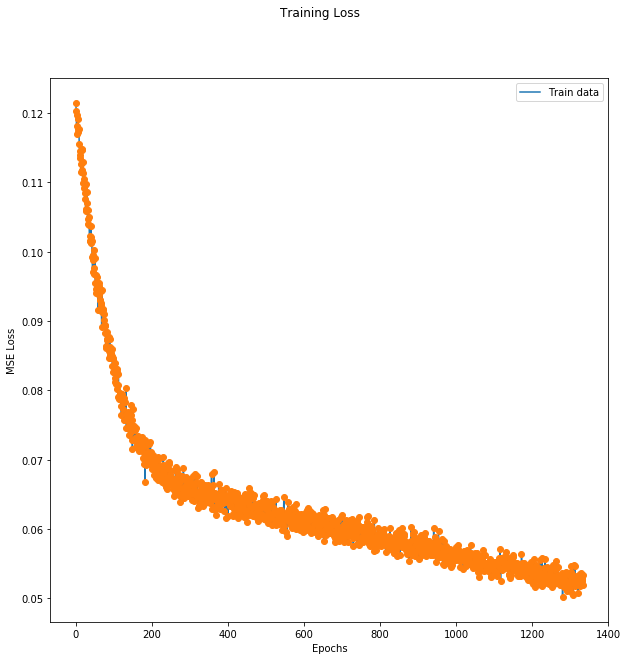

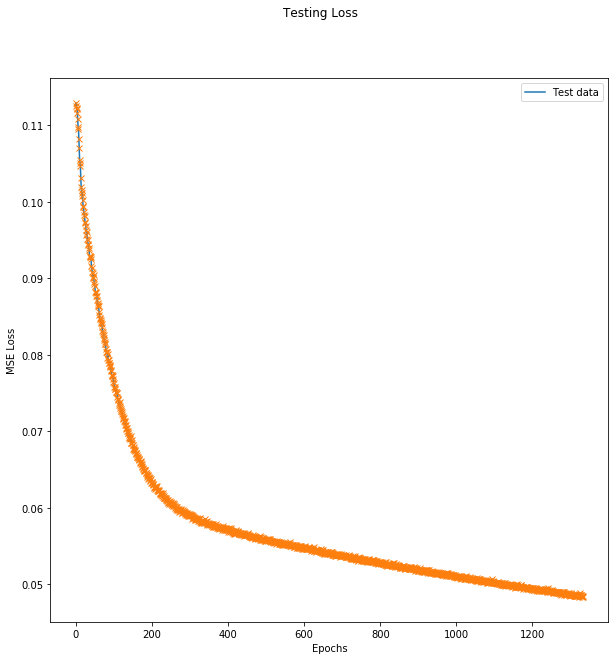

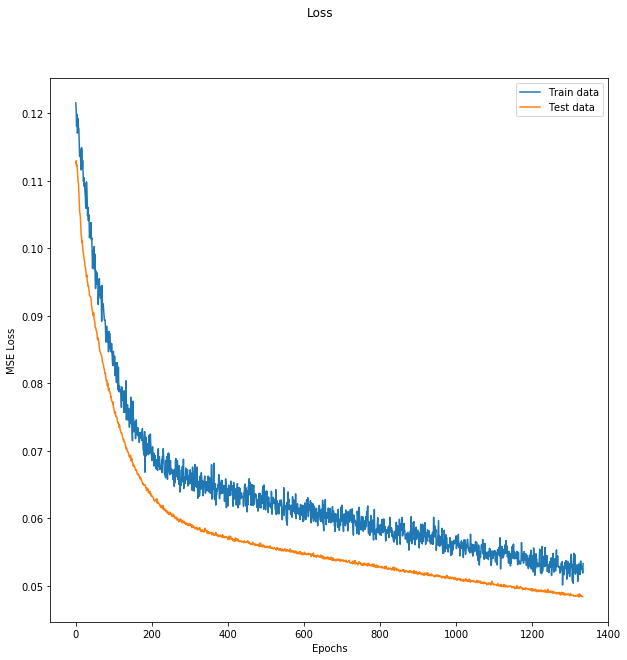

MAPE :  37.05906487633105


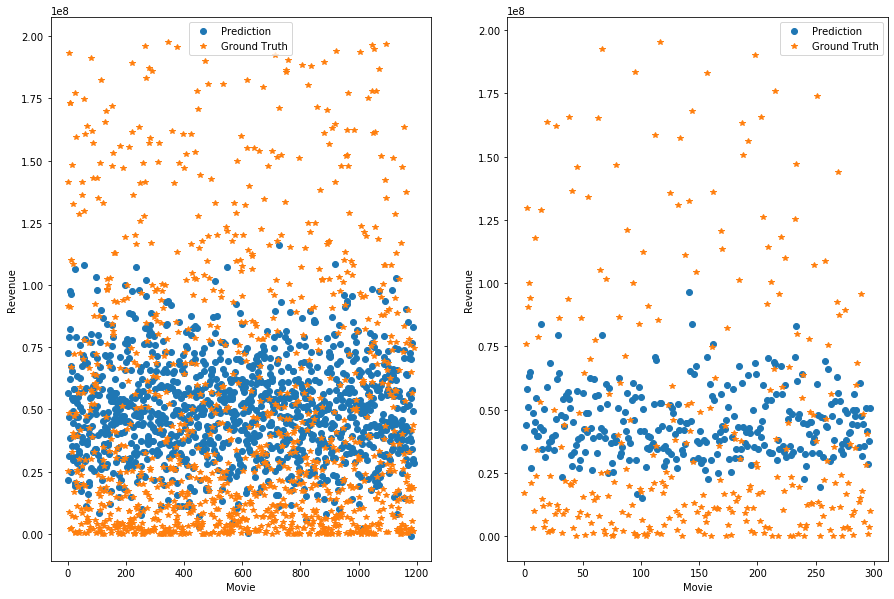

--- Epoch 1335 ---
[Epoch 1335/3000] [Batch 39/40] [Loss: 0.061611 (0.052432)]  [r2: (0.187472)] [rmse: (0.226104)], ETA: 0:39:35.043006
Testing -- [Batch 9/10] [Loss: 0.047377 (0.048449)] [r2: (0.219724)] [rmse: (0.219287)]
--- Epoch 1336 ---
[Epoch 1336/3000] [Batch 39/40] [Loss: 0.060829 (0.052413)]  [r2: (0.184362)] [rmse: (0.226795)], ETA: 0:39:03.735775
Testing -- [Batch 9/10] [Loss: 0.033251 (0.048335)] [r2: (0.212615)] [rmse: (0.217086)]
--- Epoch 1337 ---
[Epoch 1337/3000] [Batch 39/40] [Loss: 0.067244 (0.051747)]  [r2: (0.214005)] [rmse: (0.225047)], ETA: 0:38:46.666353
Testing -- [Batch 9/10] [Loss: 0.044008 (0.048389)] [r2: (0.218410)] [rmse: (0.218043)]
--- Epoch 1338 ---
[Epoch 1338/3000] [Batch 39/40] [Loss: 0.079713 (0.051544)]  [r2: (0.197238)] [rmse: (0.224828)], ETA: 0:40:07.115707
Testing -- [Batch 9/10] [Loss: 0.054979 (0.048474)] [r2: (0.211670)] [rmse: (0.218507)]
--- Epoch 1339 ---
[Epoch 1339/3000] [Batch 39/40] [Loss: 0.023613 (0.052279)]  [r2: (0.173537)] [rm

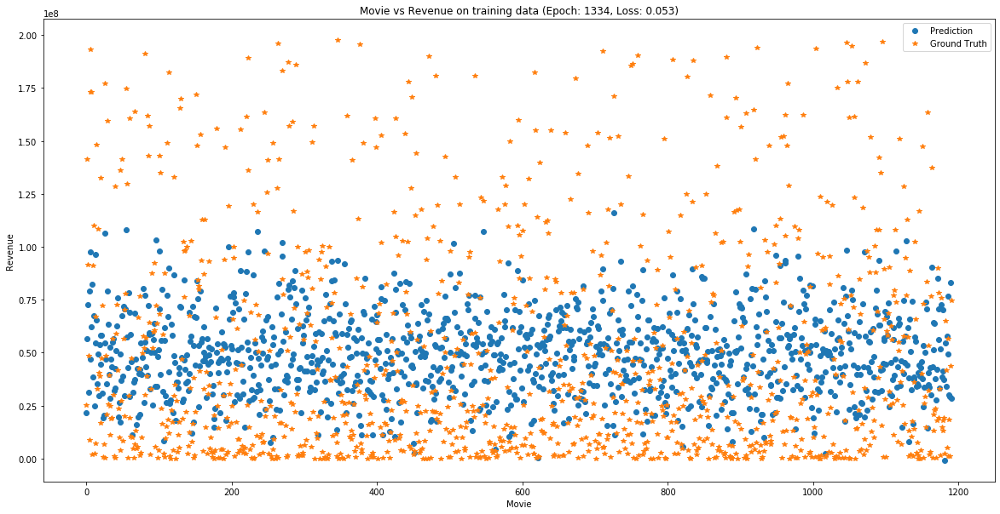

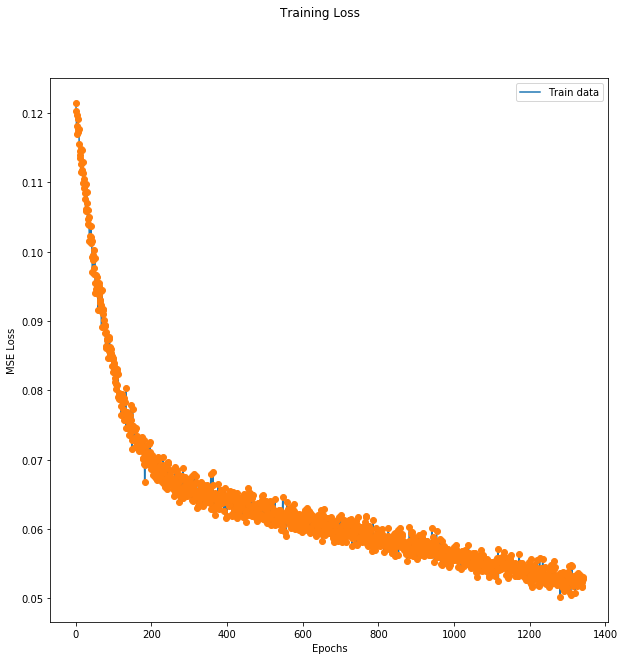

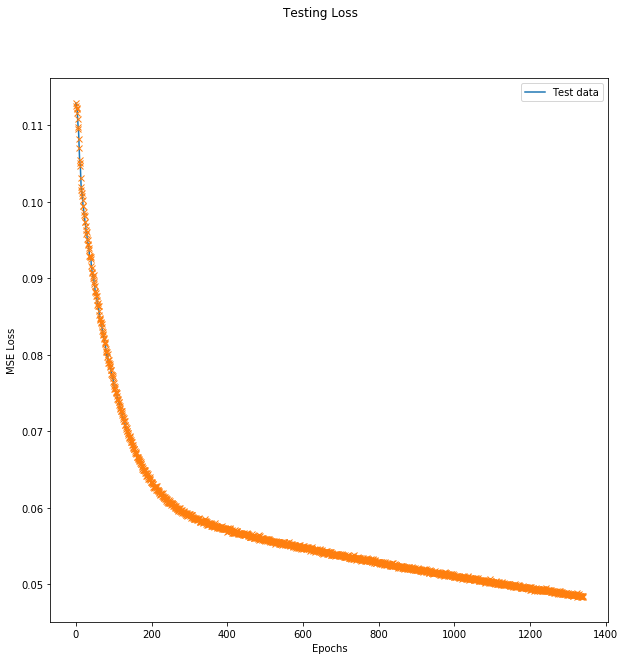

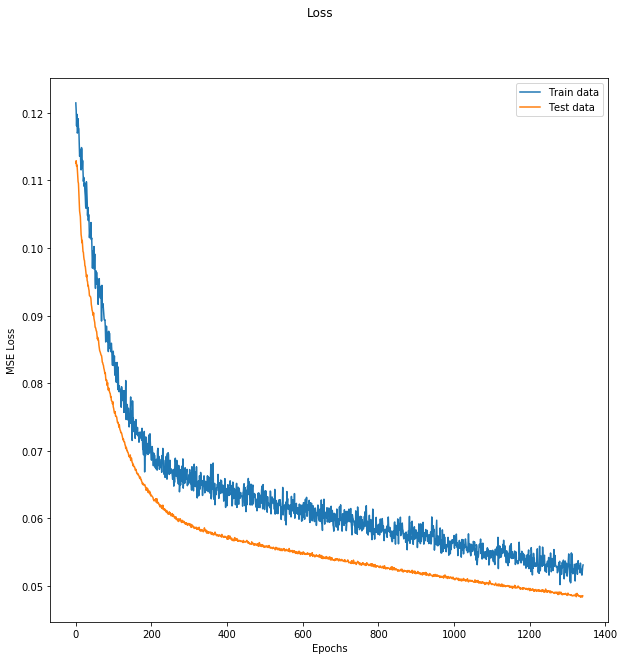

MAPE :  36.99620792972917


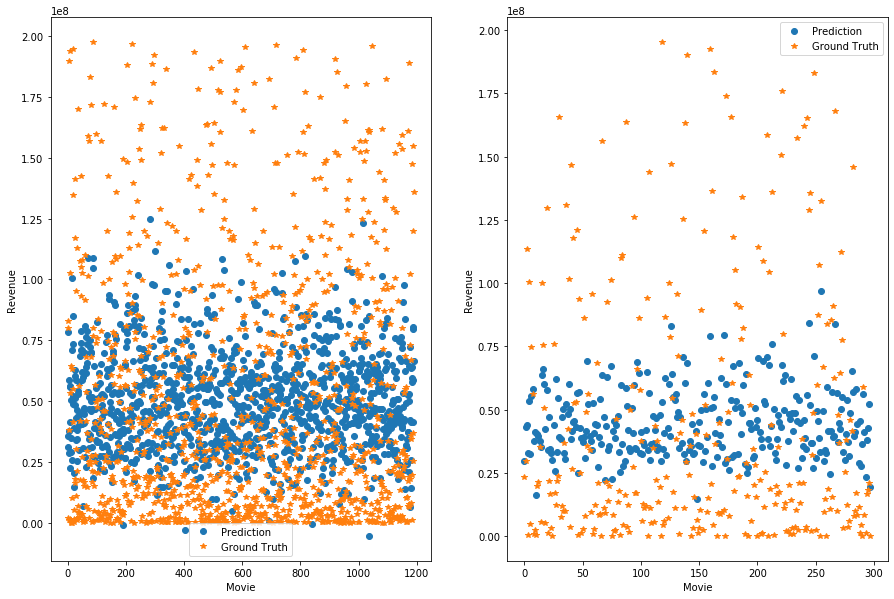

--- Epoch 1342 ---
[Epoch 1342/3000] [Batch 39/40] [Loss: 0.056565 (0.051698)]  [r2: (0.169065)] [rmse: (0.224498)], ETA: 0:38:45.972106
Testing -- [Batch 9/10] [Loss: 0.039276 (0.048362)] [r2: (0.210295)] [rmse: (0.217597)]
--- Epoch 1343 ---
[Epoch 1343/3000] [Batch 39/40] [Loss: 0.051271 (0.051274)]  [r2: (0.183107)] [rmse: (0.224834)], ETA: 0:40:56.567008
Testing -- [Batch 9/10] [Loss: 0.046768 (0.048377)] [r2: (0.205547)] [rmse: (0.219217)]
--- Epoch 1344 ---
[Epoch 1344/3000] [Batch 39/40] [Loss: 0.041074 (0.053359)]  [r2: (0.193177)] [rmse: (0.228679)], ETA: 0:38:29.796033
Testing -- [Batch 9/10] [Loss: 0.050519 (0.048407)] [r2: (0.209974)] [rmse: (0.217361)]
--- Epoch 1345 ---
[Epoch 1345/3000] [Batch 39/40] [Loss: 0.032466 (0.052855)]  [r2: (0.168479)] [rmse: (0.228289)], ETA: 0:38:58.181741
Testing -- [Batch 9/10] [Loss: 0.028341 (0.048244)] [r2: (0.197014)] [rmse: (0.216776)]
Train R2 =  0.2141854900232517
Test R2 =  0.2395233506465254


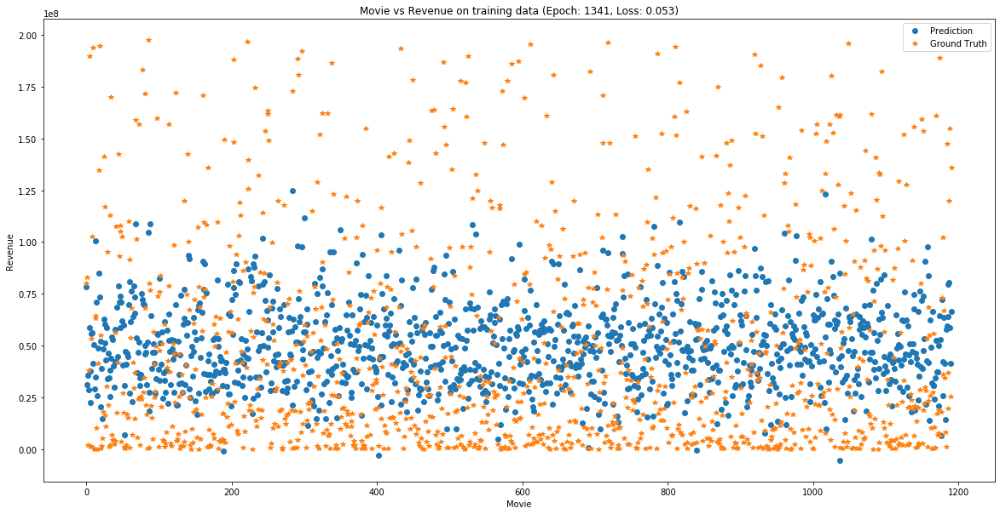

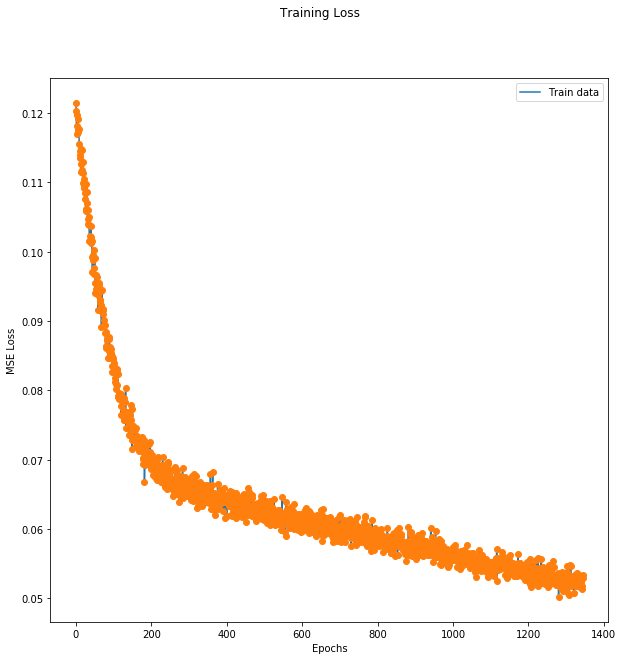

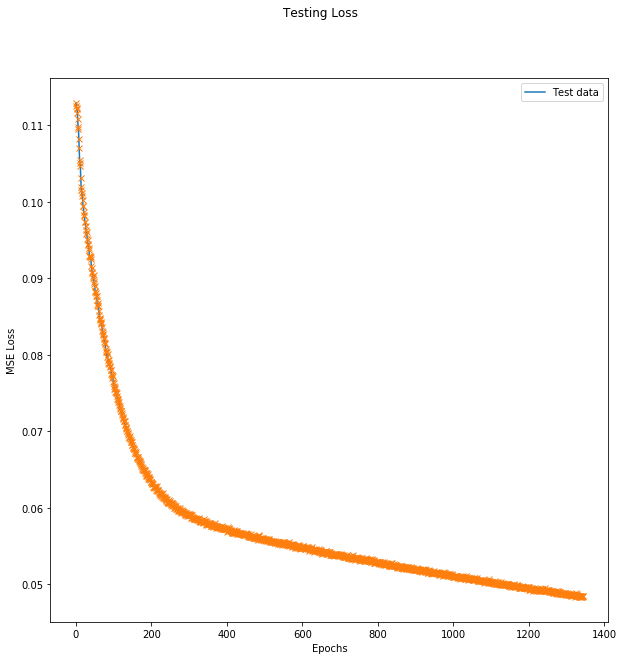

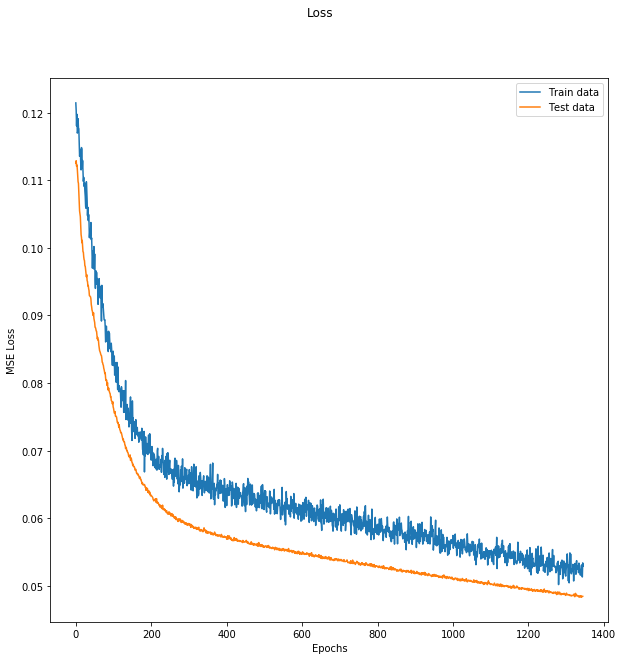

MAPE :  37.01251997118064


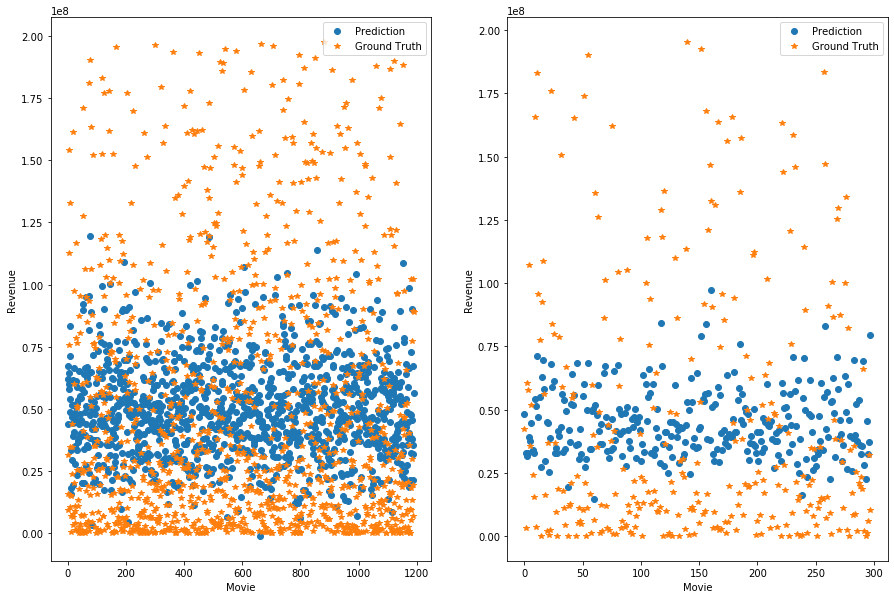

--- Epoch 1346 ---
[Epoch 1346/3000] [Batch 39/40] [Loss: 0.060341 (0.053324)]  [r2: (0.169038)] [rmse: (0.229676)], ETA: 0:38:04.571934
Testing -- [Batch 9/10] [Loss: 0.036016 (0.048281)] [r2: (0.217210)] [rmse: (0.217690)]
--- Epoch 1347 ---
[Epoch 1347/3000] [Batch 39/40] [Loss: 0.034143 (0.052537)]  [r2: (0.165277)] [rmse: (0.226661)], ETA: 0:38:43.821864
Testing -- [Batch 9/10] [Loss: 0.039861 (0.048307)] [r2: (0.160290)] [rmse: (0.216573)]
--- Epoch 1348 ---
[Epoch 1348/3000] [Batch 39/40] [Loss: 0.066411 (0.052474)]  [r2: (0.191248)] [rmse: (0.226770)], ETA: 0:38:33.267135
Testing -- [Batch 9/10] [Loss: 0.039979 (0.048297)] [r2: (0.233381)] [rmse: (0.218304)]
--- Epoch 1349 ---
[Epoch 1349/3000] [Batch 39/40] [Loss: 0.066209 (0.053335)]  [r2: (0.163179)] [rmse: (0.228259)], ETA: 0:37:47.003075
Testing -- [Batch 9/10] [Loss: 0.036917 (0.048257)] [r2: (0.202112)] [rmse: (0.218123)]
--- Epoch 1350 ---
[Epoch 1350/3000] [Batch 39/40] [Loss: 0.032003 (0.052963)]  [r2: (0.166574)] [rm

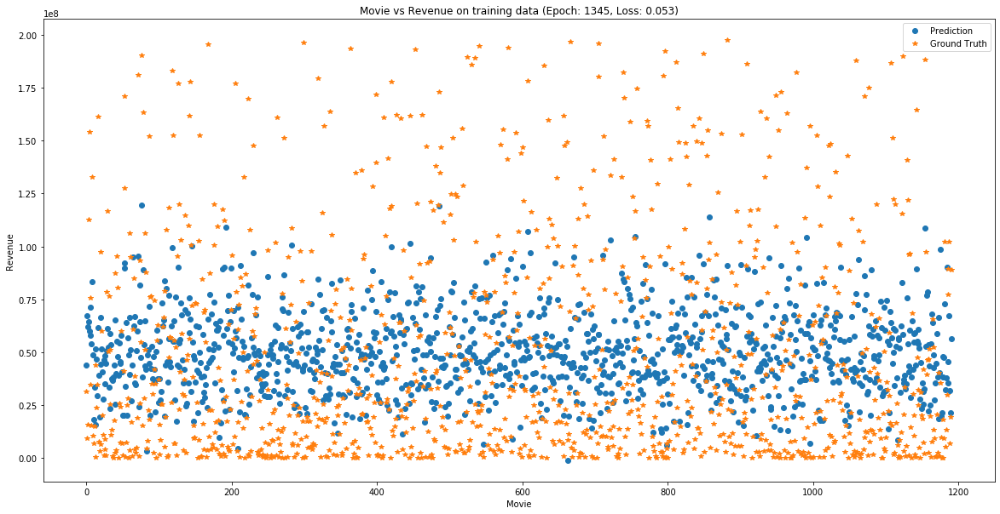

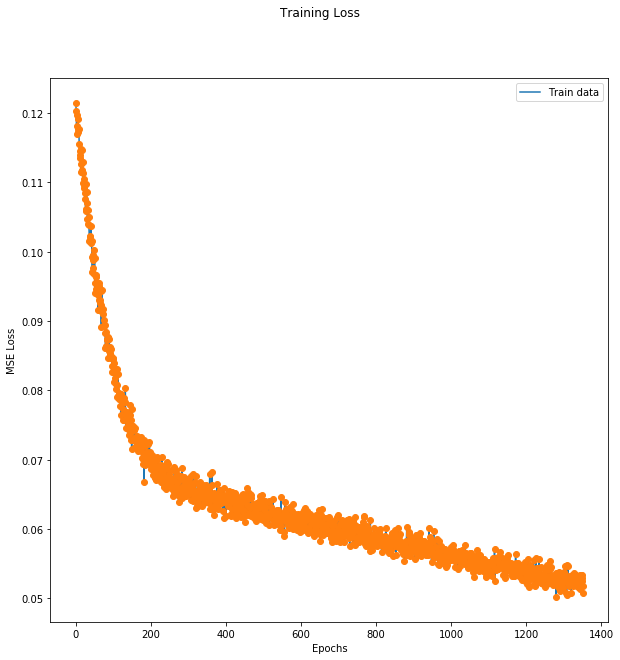

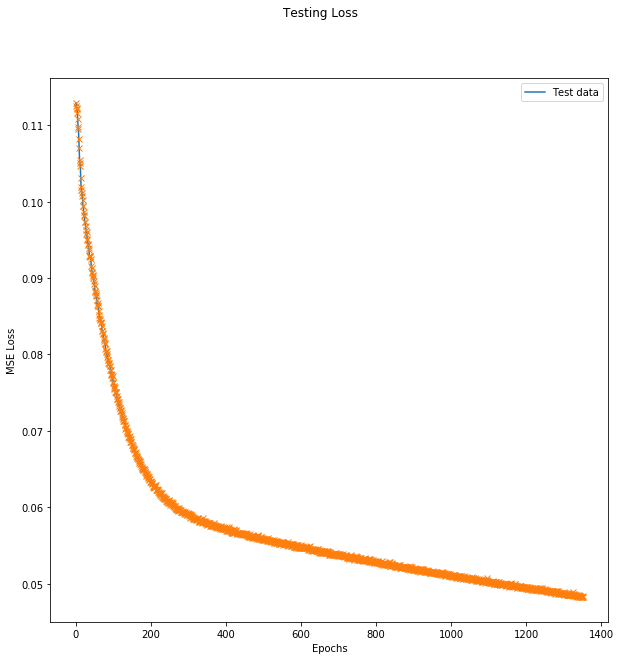

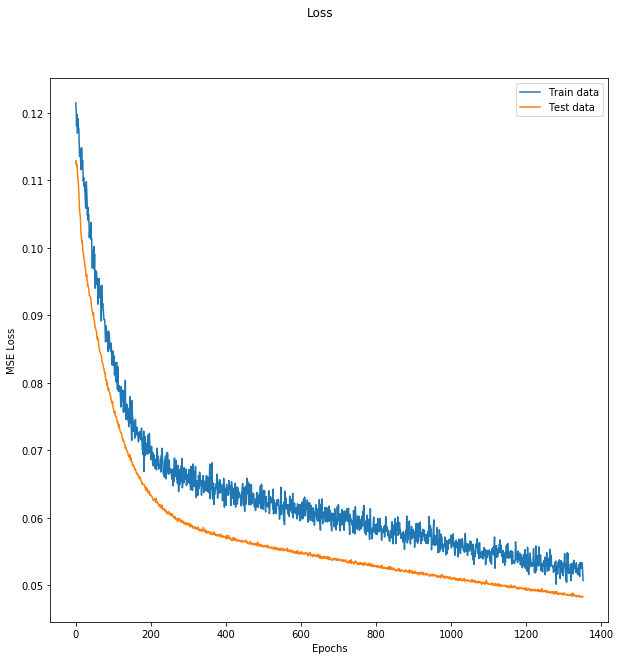

MAPE :  36.75756544894342


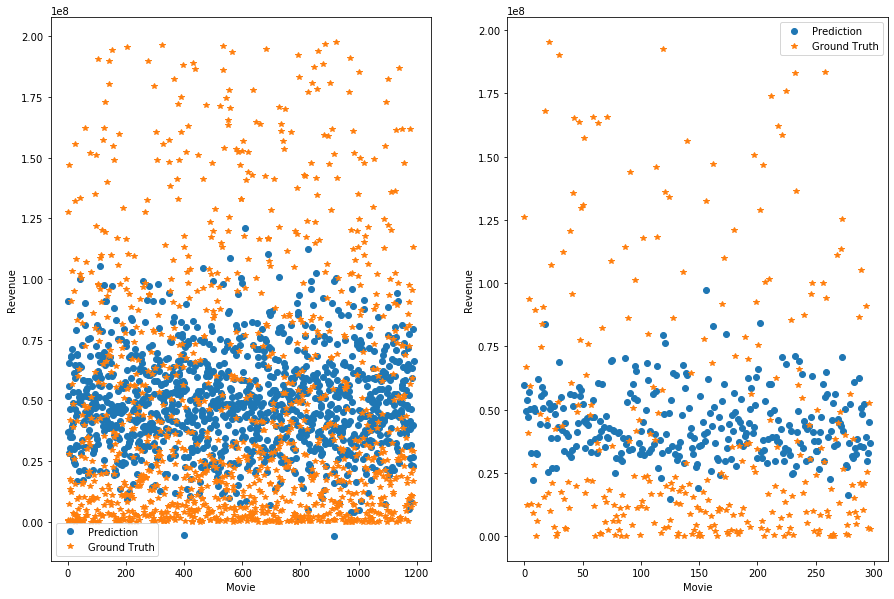

--- Epoch 1353 ---
[Epoch 1353/3000] [Batch 39/40] [Loss: 0.029892 (0.051398)]  [r2: (0.152766)] [rmse: (0.223943)], ETA: 0:37:44.599844
Testing -- [Batch 9/10] [Loss: 0.073636 (0.048448)] [r2: (0.196700)] [rmse: (0.216796)]
--- Epoch 1354 ---
[Epoch 1354/3000] [Batch 39/40] [Loss: 0.074345 (0.051928)]  [r2: (0.176164)] [rmse: (0.225650)], ETA: 0:41:39.503737
Testing -- [Batch 9/10] [Loss: 0.038453 (0.048231)] [r2: (0.225832)] [rmse: (0.218610)]
--- Epoch 1355 ---
[Epoch 1355/3000] [Batch 39/40] [Loss: 0.028455 (0.052944)]  [r2: (0.179327)] [rmse: (0.228319)], ETA: 0:37:43.572896
Testing -- [Batch 9/10] [Loss: 0.040498 (0.048246)] [r2: (0.235967)] [rmse: (0.217314)]
--- Epoch 1356 ---
[Epoch 1356/3000] [Batch 39/40] [Loss: 0.033887 (0.052879)]  [r2: (0.187960)] [rmse: (0.227748)], ETA: 0:37:07.034571
Testing -- [Batch 9/10] [Loss: 0.044598 (0.048279)] [r2: (0.232261)] [rmse: (0.218708)]
--- Epoch 1357 ---
[Epoch 1357/3000] [Batch 39/40] [Loss: 0.057487 (0.052296)]  [r2: (0.176378)] [rm

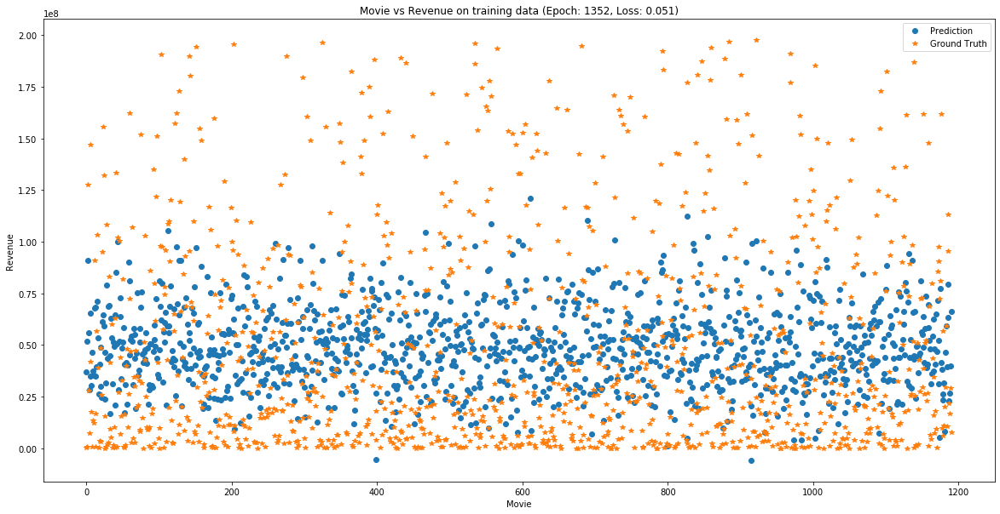

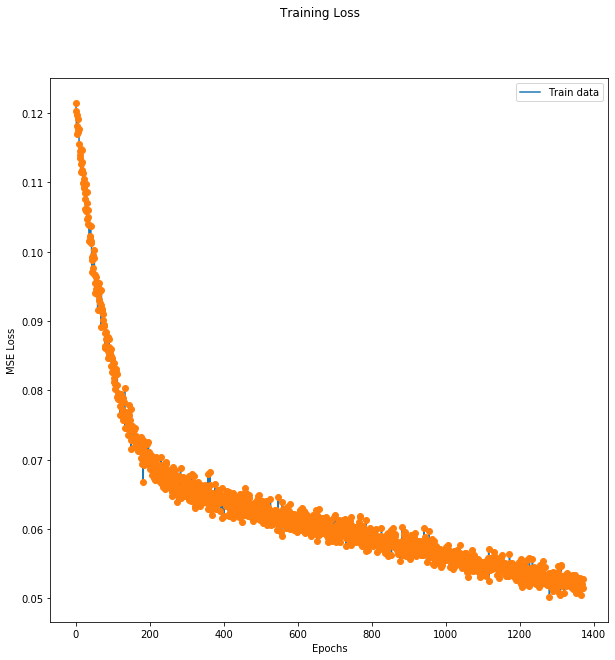

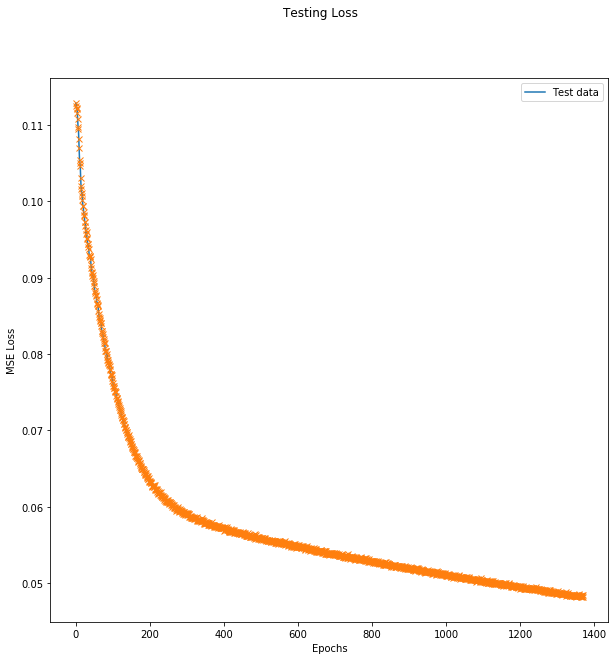

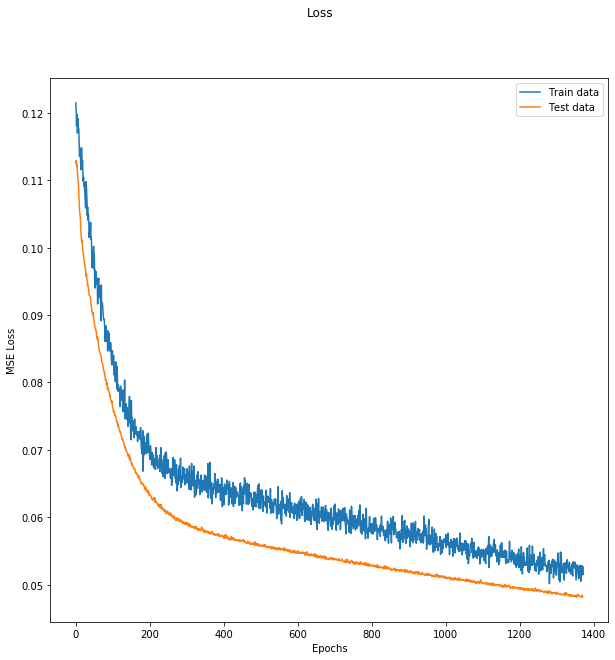

MAPE :  36.55745684861593


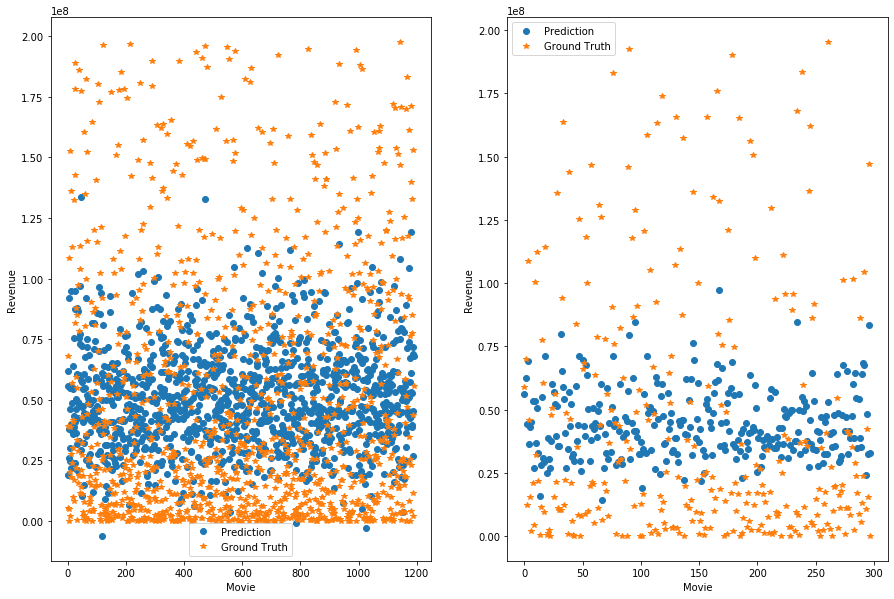

--- Epoch 1372 ---
[Epoch 1372/3000] [Batch 39/40] [Loss: 0.048522 (0.052649)]  [r2: (0.185255)] [rmse: (0.226598)], ETA: 0:37:56.164802
Testing -- [Batch 9/10] [Loss: 0.061513 (0.048292)] [r2: (0.216357)] [rmse: (0.218540)]
--- Epoch 1373 ---
[Epoch 1373/3000] [Batch 39/40] [Loss: 0.039058 (0.052945)]  [r2: (0.184929)] [rmse: (0.228064)], ETA: 0:37:34.157048
Testing -- [Batch 9/10] [Loss: 0.057107 (0.048248)] [r2: (0.217678)] [rmse: (0.216395)]
--- Epoch 1374 ---
[Epoch 1374/3000] [Batch 39/40] [Loss: 0.075620 (0.052579)]  [r2: (0.179397)] [rmse: (0.226778)], ETA: 0:36:53.159277
Testing -- [Batch 9/10] [Loss: 0.026225 (0.048035)] [r2: (0.176828)] [rmse: (0.216829)]
Train R2 =  0.22314672414324643
Test R2 =  0.24260590896319123


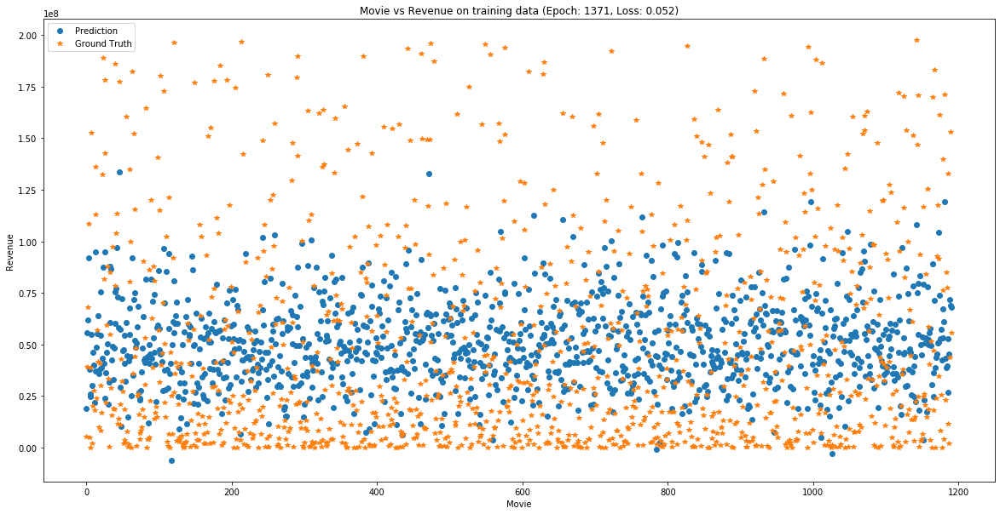

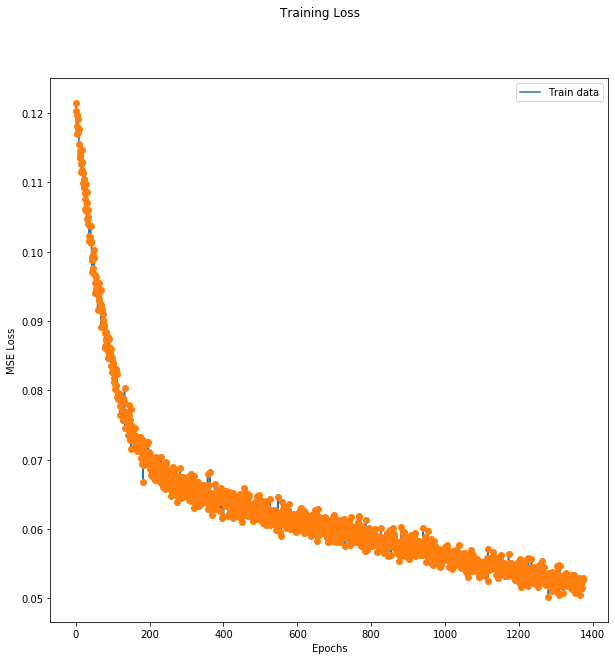

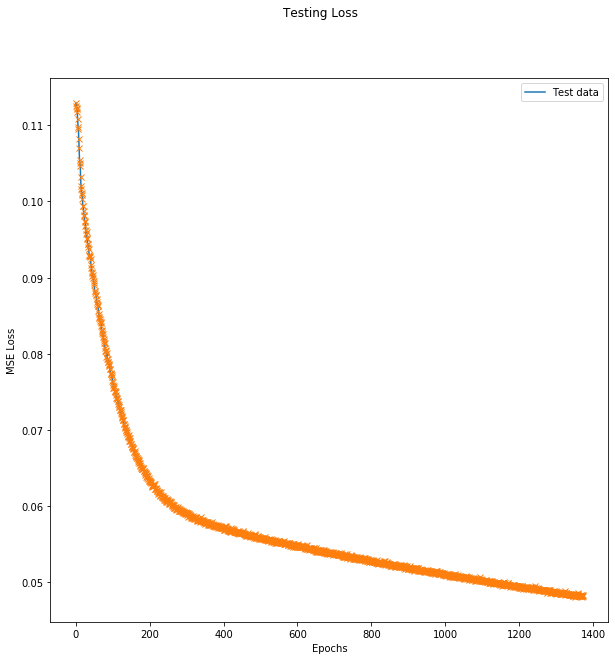

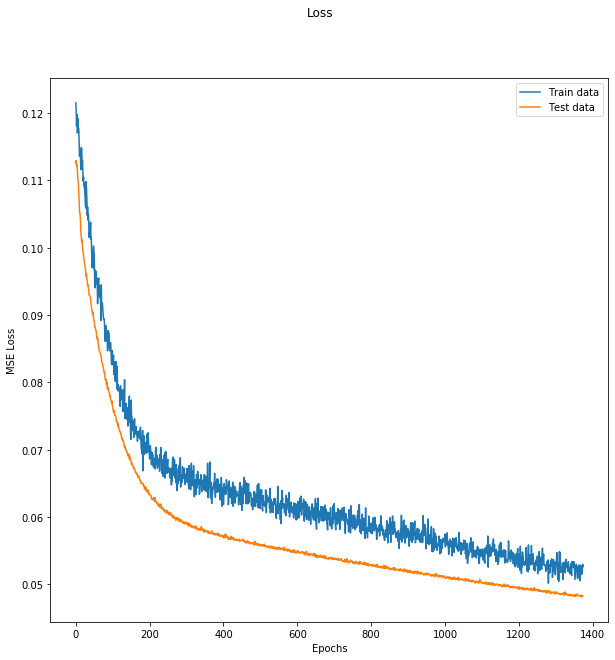

MAPE :  36.618720014438175


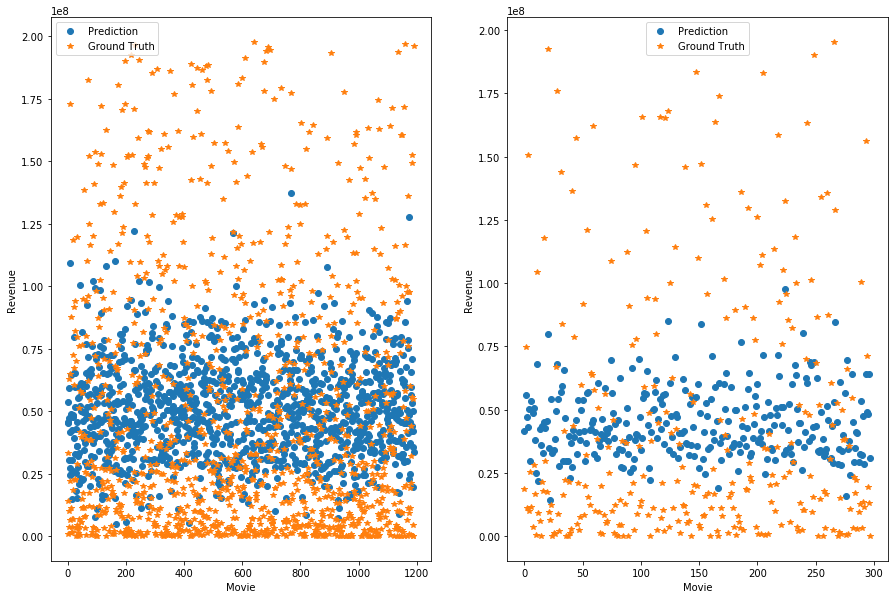

--- Epoch 1375 ---
[Epoch 1375/3000] [Batch 39/40] [Loss: 0.058889 (0.053269)]  [r2: (0.140695)] [rmse: (0.228726)], ETA: 0:39:07.301072
Testing -- [Batch 9/10] [Loss: 0.073521 (0.048347)] [r2: (0.218293)] [rmse: (0.217091)]
--- Epoch 1376 ---
[Epoch 1376/3000] [Batch 39/40] [Loss: 0.037014 (0.051767)]  [r2: (0.169339)] [rmse: (0.225745)], ETA: 0:38:15.891526
Testing -- [Batch 9/10] [Loss: 0.075266 (0.048364)] [r2: (0.190985)] [rmse: (0.218560)]
--- Epoch 1377 ---
[Epoch 1377/3000] [Batch 39/40] [Loss: 0.046175 (0.052837)]  [r2: (0.163484)] [rmse: (0.228149)], ETA: 0:36:45.933334
Testing -- [Batch 9/10] [Loss: 0.023950 (0.047983)] [r2: (0.160352)] [rmse: (0.215409)]
Train R2 =  0.21598719583570547
Test R2 =  0.24319529233700254


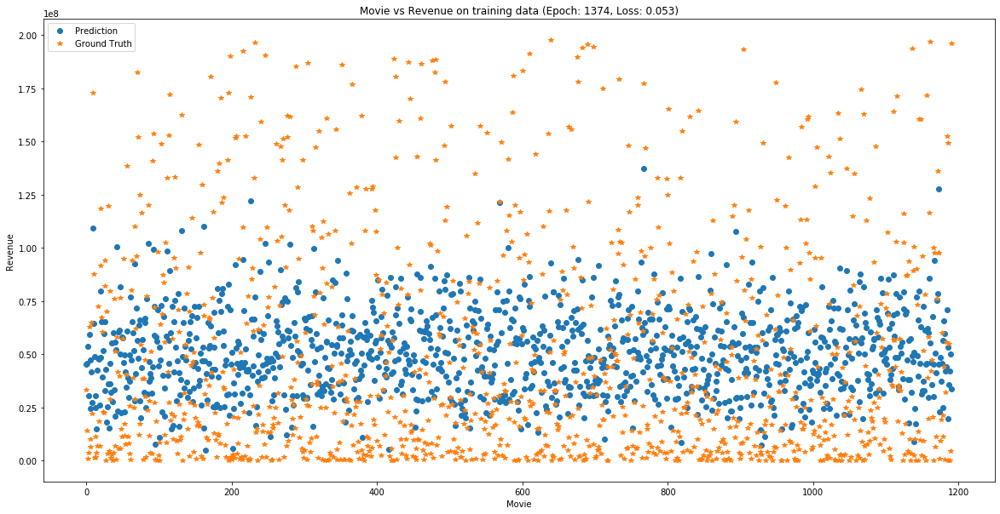

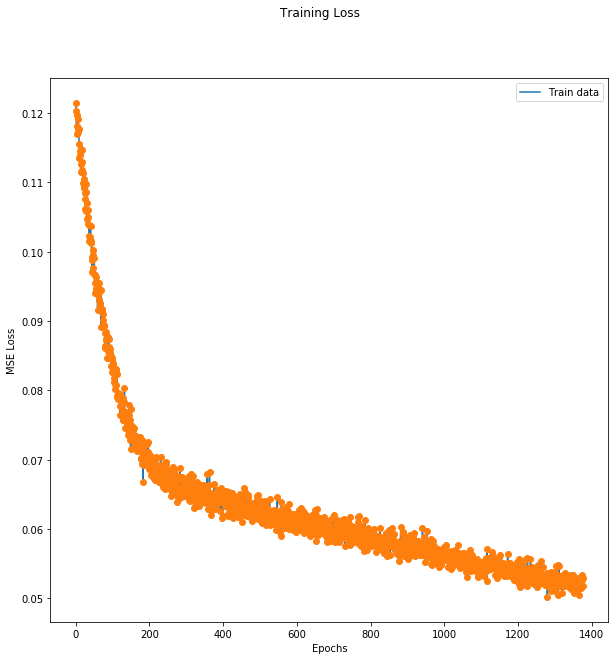

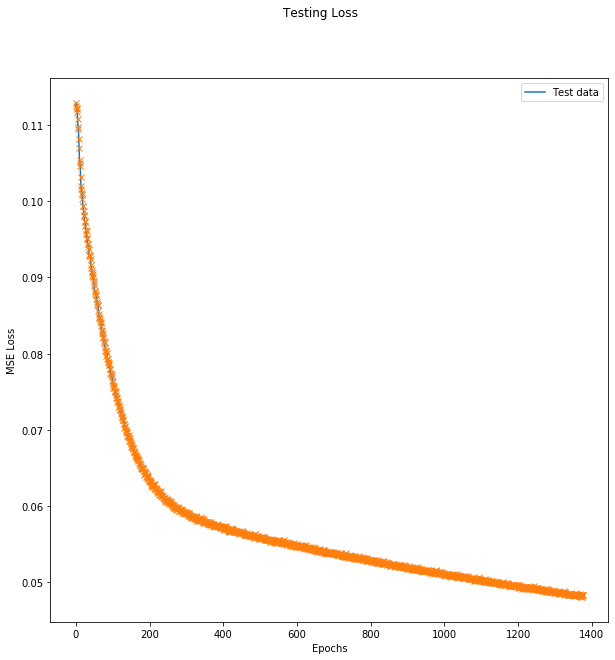

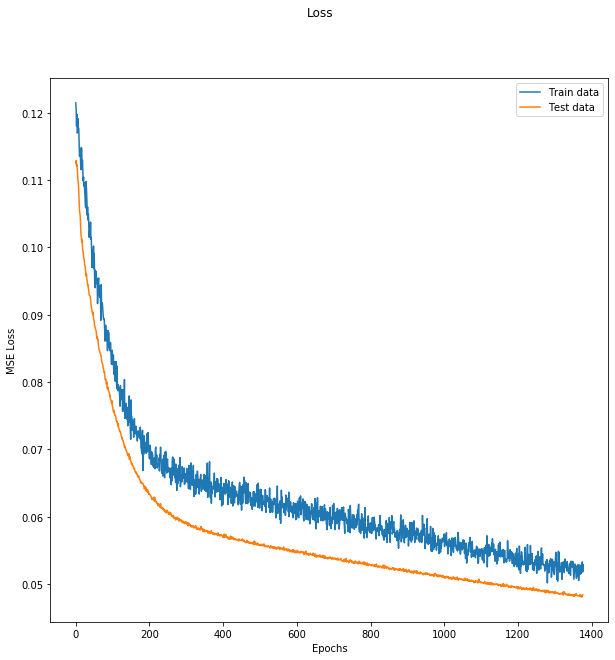

MAPE :  36.58416093068996


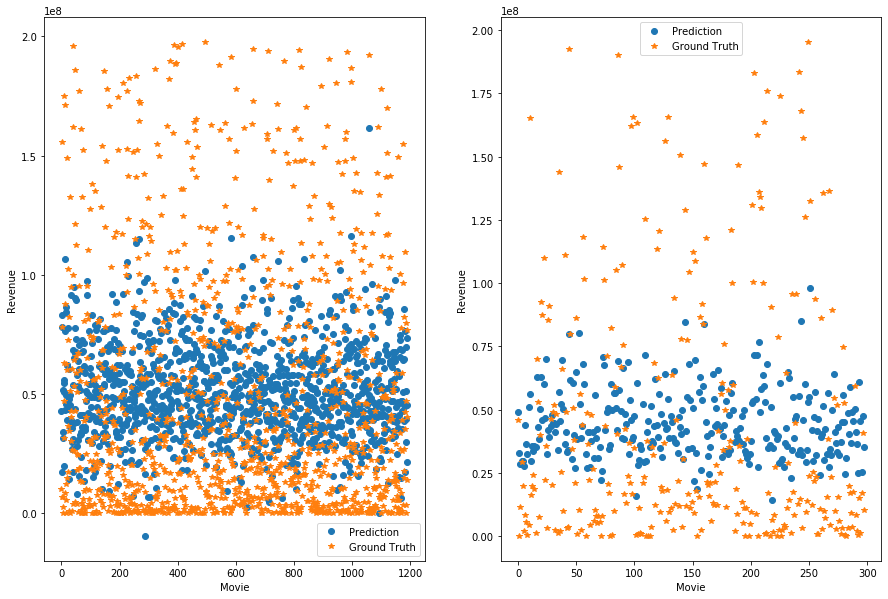

--- Epoch 1378 ---
[Epoch 1378/3000] [Batch 39/40] [Loss: 0.055095 (0.052559)]  [r2: (0.174942)] [rmse: (0.226595)], ETA: 0:37:40.953410
Testing -- [Batch 9/10] [Loss: 0.034990 (0.048066)] [r2: (0.200980)] [rmse: (0.217385)]
--- Epoch 1379 ---
[Epoch 1379/3000] [Batch 39/40] [Loss: 0.038043 (0.052479)]  [r2: (0.179899)] [rmse: (0.227495)], ETA: 0:36:36.322765
Testing -- [Batch 9/10] [Loss: 0.033911 (0.048040)] [r2: (0.228116)] [rmse: (0.218161)]
--- Epoch 1380 ---
[Epoch 1380/3000] [Batch 39/40] [Loss: 0.049020 (0.051532)]  [r2: (0.198881)] [rmse: (0.224682)], ETA: 0:36:39.182213
Testing -- [Batch 9/10] [Loss: 0.025997 (0.047973)] [r2: (0.199141)] [rmse: (0.215189)]
Train R2 =  0.2358022097628979
Test R2 =  0.24356453797741406


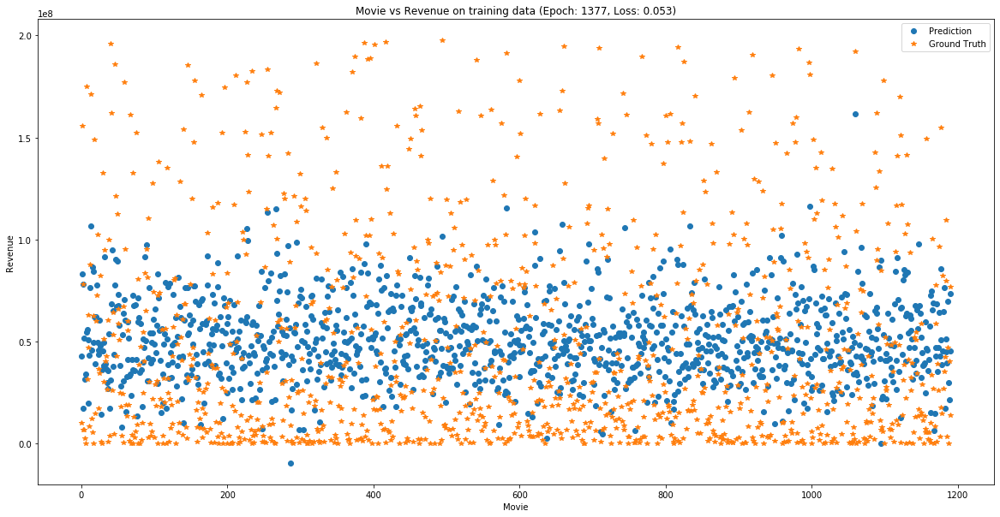

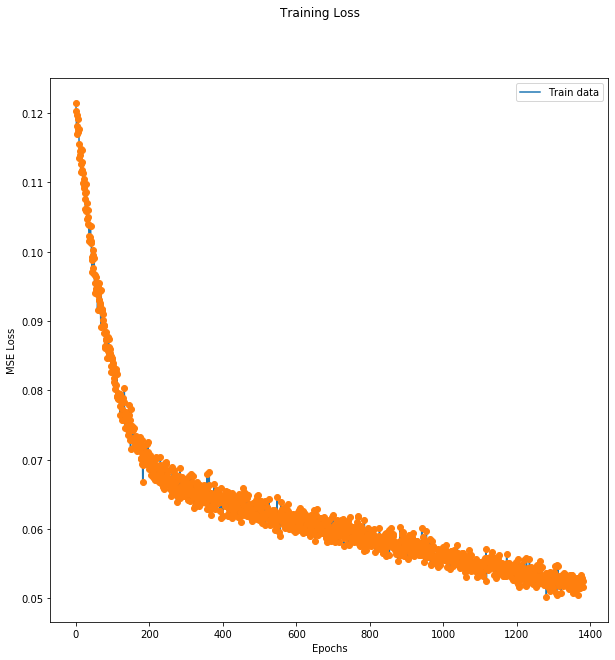

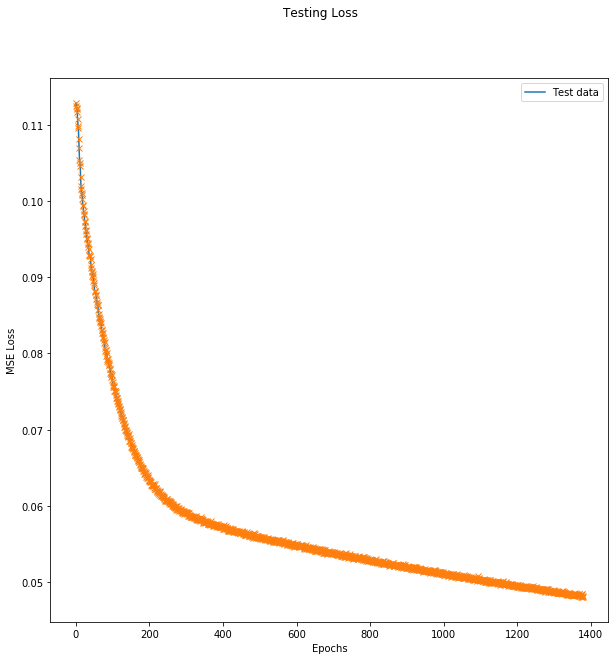

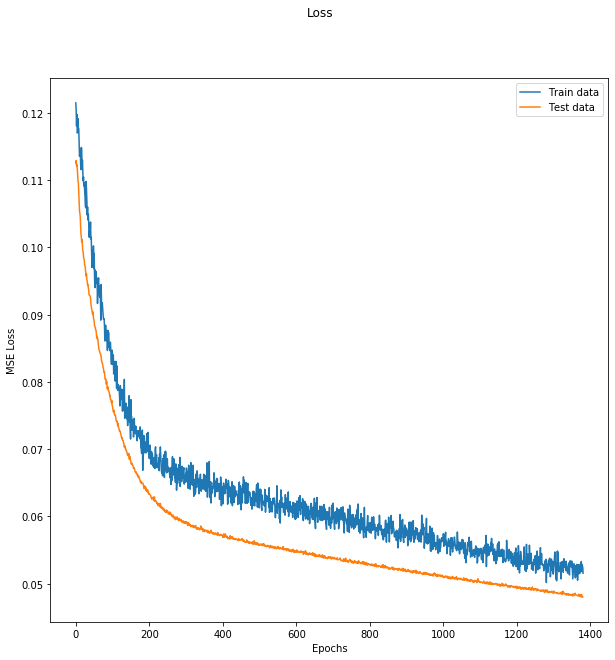

MAPE :  36.48543225879754


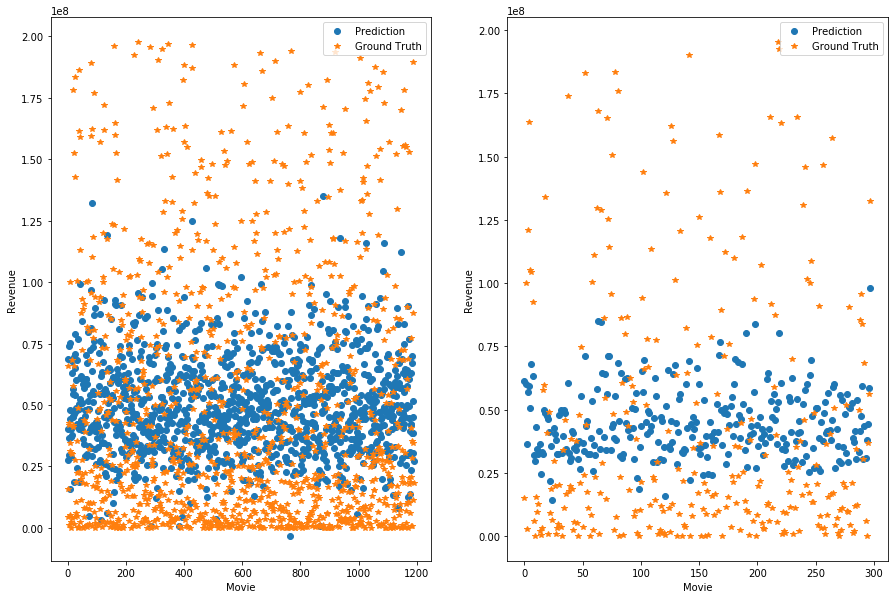

--- Epoch 1381 ---
[Epoch 1381/3000] [Batch 39/40] [Loss: 0.078914 (0.052441)]  [r2: (0.204301)] [rmse: (0.225881)], ETA: 0:38:29.279741
Testing -- [Batch 9/10] [Loss: 0.050892 (0.048142)] [r2: (0.207112)] [rmse: (0.217188)]
--- Epoch 1382 ---
[Epoch 1382/3000] [Batch 39/40] [Loss: 0.074017 (0.051833)]  [r2: (0.200051)] [rmse: (0.225302)], ETA: 0:37:54.697043
Testing -- [Batch 9/10] [Loss: 0.023494 (0.047924)] [r2: (0.222117)] [rmse: (0.216309)]
Train R2 =  0.2341024187981564
Test R2 =  0.24407825485361


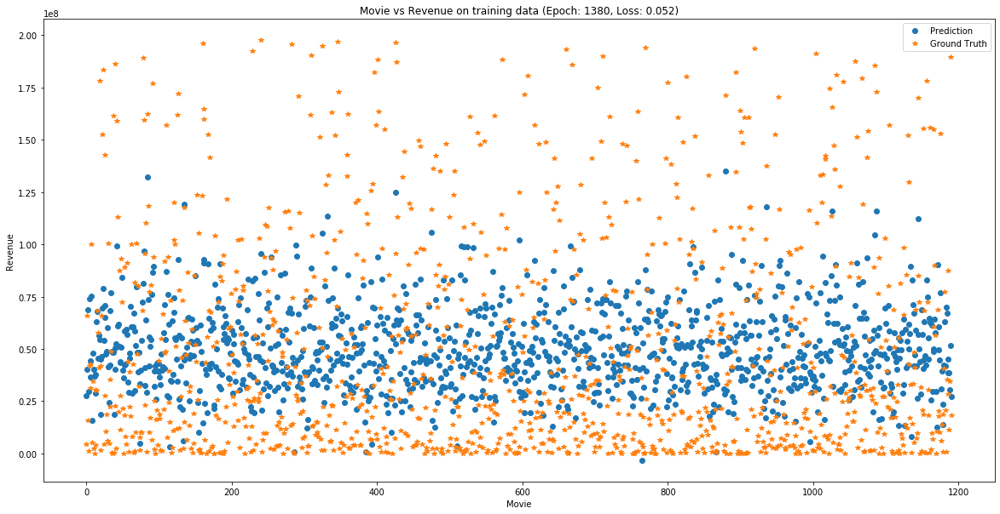

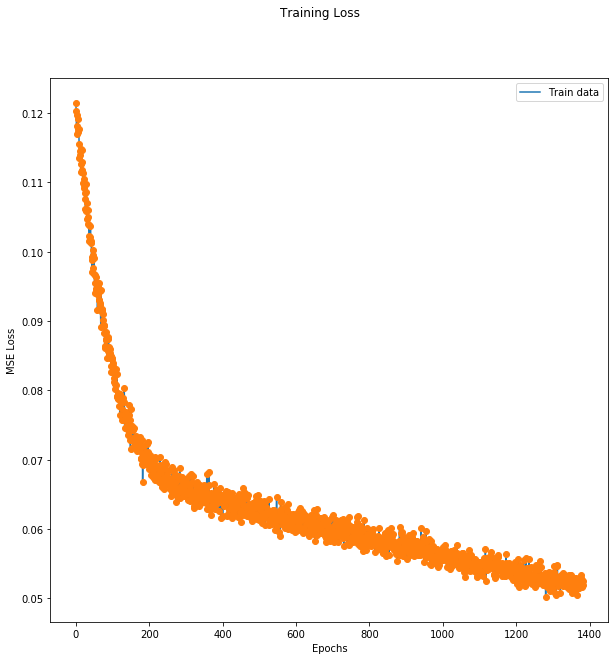

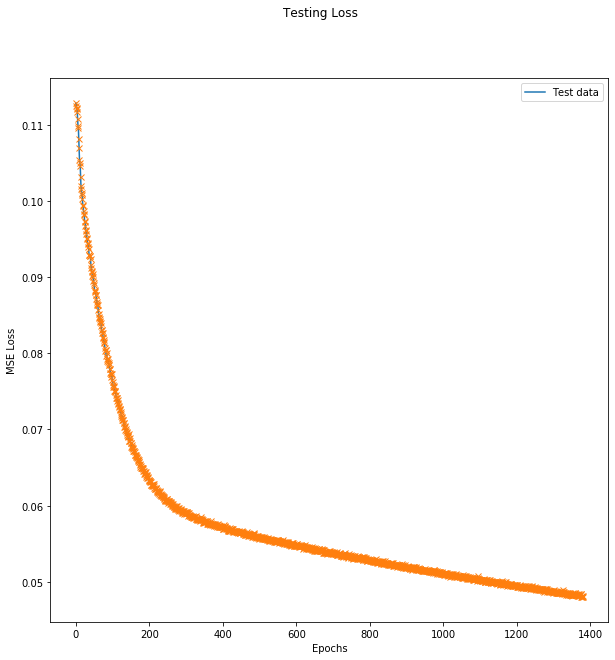

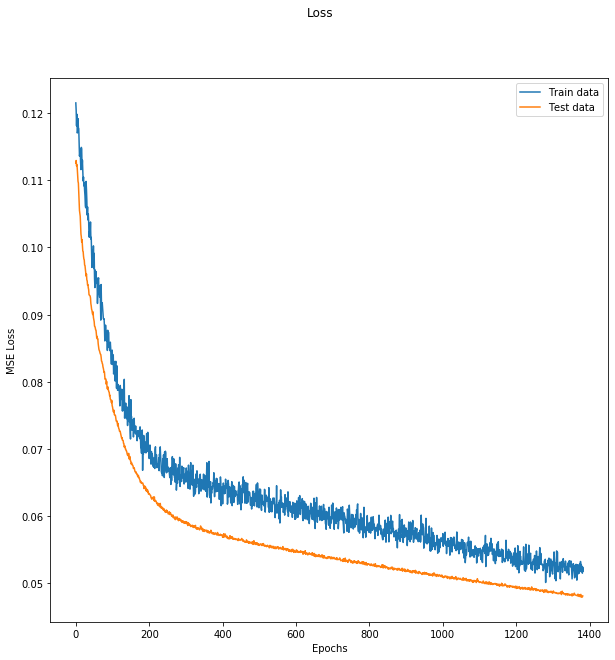

MAPE :  36.48503393801682


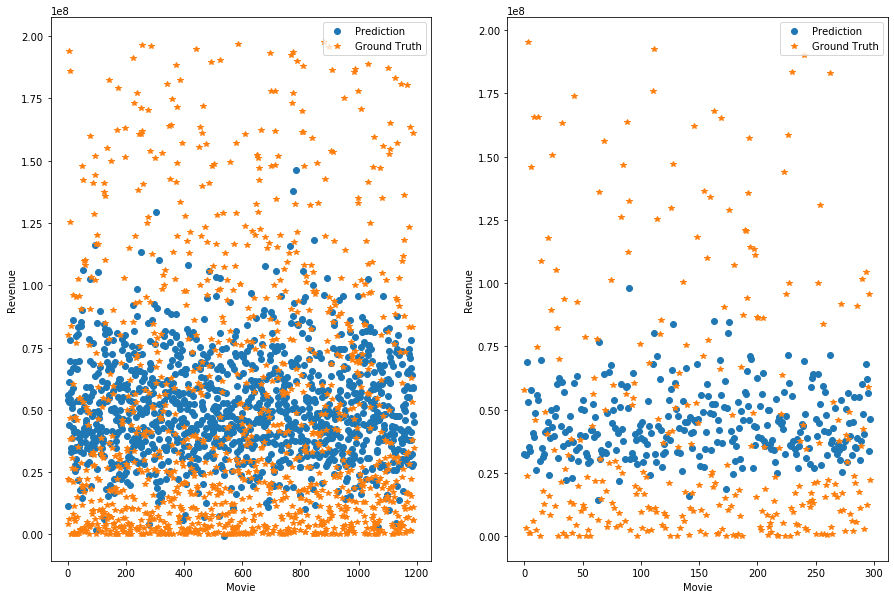

--- Epoch 1383 ---
[Epoch 1383/3000] [Batch 39/40] [Loss: 0.031831 (0.052845)]  [r2: (0.170633)] [rmse: (0.227546)], ETA: 0:37:35.936846
Testing -- [Batch 9/10] [Loss: 0.063035 (0.048195)] [r2: (0.224525)] [rmse: (0.215573)]
--- Epoch 1384 ---
[Epoch 1384/3000] [Batch 39/40] [Loss: 0.072965 (0.049701)]  [r2: (0.198411)] [rmse: (0.220555)], ETA: 0:37:19.000170
Testing -- [Batch 9/10] [Loss: 0.076510 (0.048270)] [r2: (0.199753)] [rmse: (0.217466)]
--- Epoch 1385 ---
[Epoch 1385/3000] [Batch 39/40] [Loss: 0.057459 (0.052235)]  [r2: (0.194458)] [rmse: (0.226980)], ETA: 0:37:51.385051
Testing -- [Batch 9/10] [Loss: 0.051057 (0.048082)] [r2: (0.235902)] [rmse: (0.217613)]
--- Epoch 1386 ---
[Epoch 1386/3000] [Batch 39/40] [Loss: 0.029891 (0.050684)]  [r2: (0.214356)] [rmse: (0.222286)], ETA: 0:38:18.651692
Testing -- [Batch 9/10] [Loss: 0.039150 (0.048014)] [r2: (0.216991)] [rmse: (0.217280)]
--- Epoch 1387 ---
[Epoch 1387/3000] [Batch 39/40] [Loss: 0.056447 (0.051656)]  [r2: (0.184007)] [rm

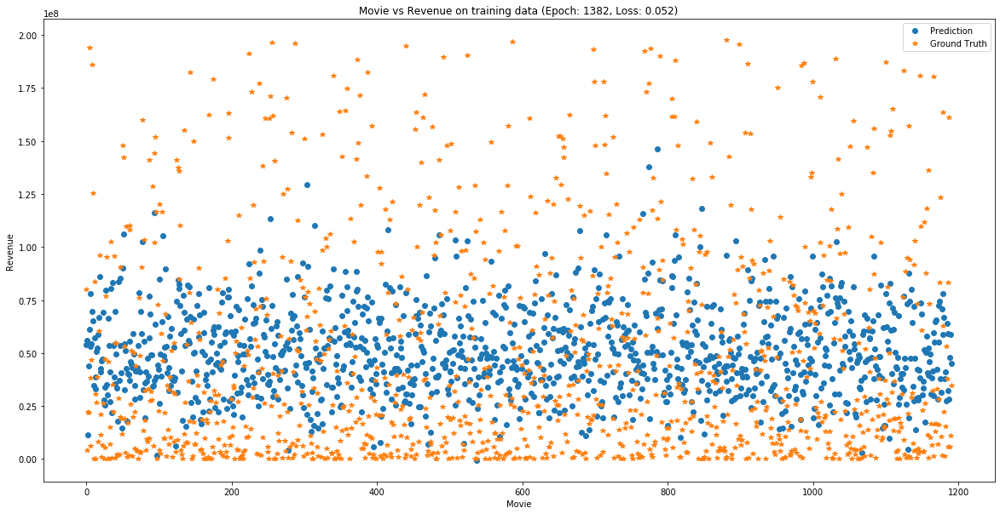

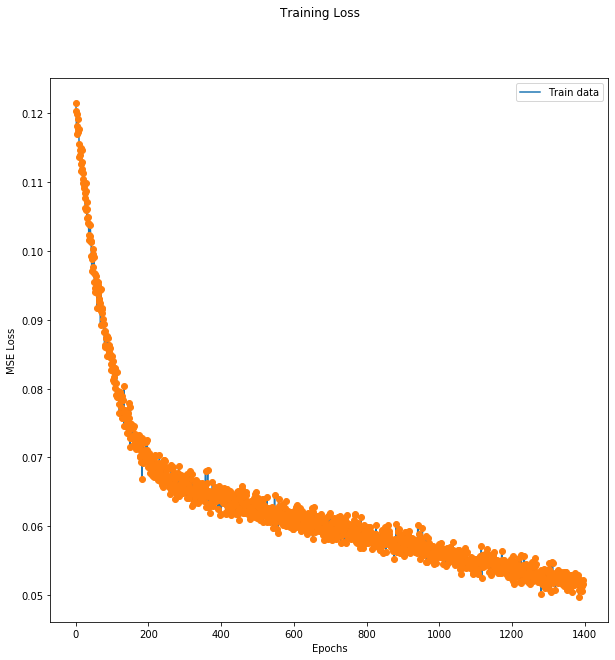

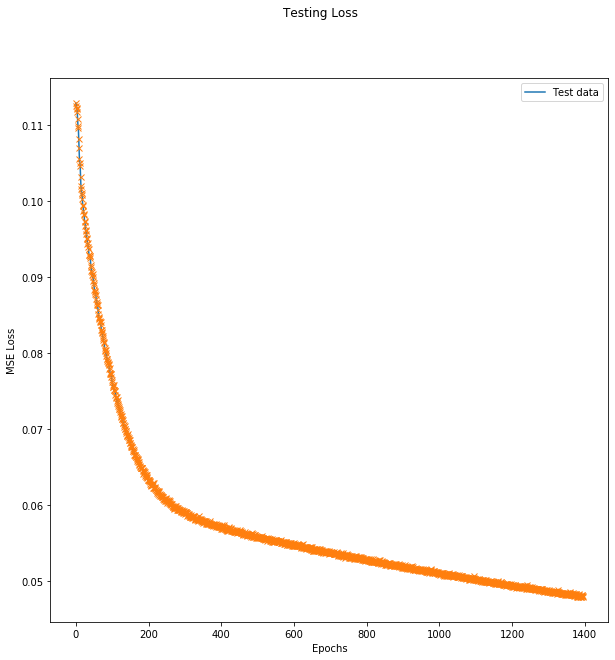

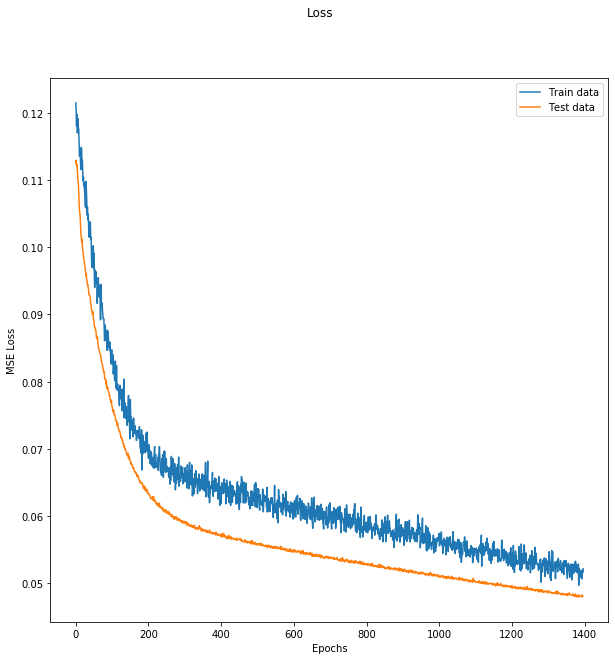

MAPE :  36.38758310799081


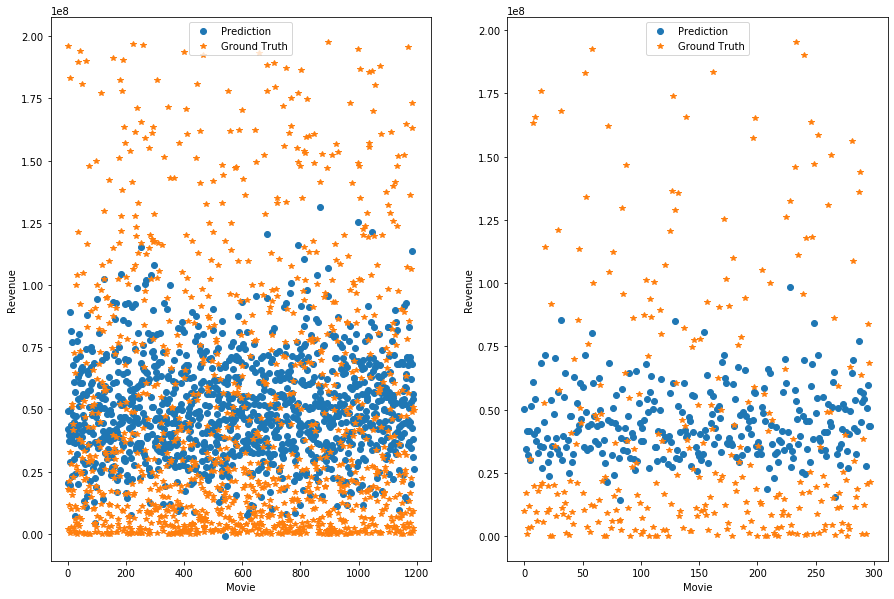

--- Epoch 1397 ---
[Epoch 1397/3000] [Batch 39/40] [Loss: 0.048816 (0.051081)]  [r2: (0.200650)] [rmse: (0.224216)], ETA: 0:36:36.700635
Testing -- [Batch 9/10] [Loss: 0.050491 (0.048030)] [r2: (0.225756)] [rmse: (0.218425)]
--- Epoch 1398 ---
[Epoch 1398/3000] [Batch 39/40] [Loss: 0.050124 (0.051550)]  [r2: (0.217166)] [rmse: (0.224707)], ETA: 0:36:43.299623
Testing -- [Batch 9/10] [Loss: 0.063948 (0.048136)] [r2: (0.151821)] [rmse: (0.216087)]
--- Epoch 1399 ---
[Epoch 1399/3000] [Batch 39/40] [Loss: 0.072778 (0.051425)]  [r2: (0.204189)] [rmse: (0.224637)], ETA: 0:36:39.161559
Testing -- [Batch 9/10] [Loss: 0.042024 (0.047979)] [r2: (0.224251)] [rmse: (0.217831)]
--- Epoch 1400 ---
[Epoch 1400/3000] [Batch 39/40] [Loss: 0.030637 (0.052601)]  [r2: (0.192812)] [rmse: (0.227396)], ETA: 0:37:19.463962
Testing -- [Batch 9/10] [Loss: 0.045993 (0.047993)] [r2: (0.240579)] [rmse: (0.216686)]
--- Epoch 1401 ---
[Epoch 1401/3000] [Batch 39/40] [Loss: 0.064383 (0.051330)]  [r2: (0.193603)] [rm

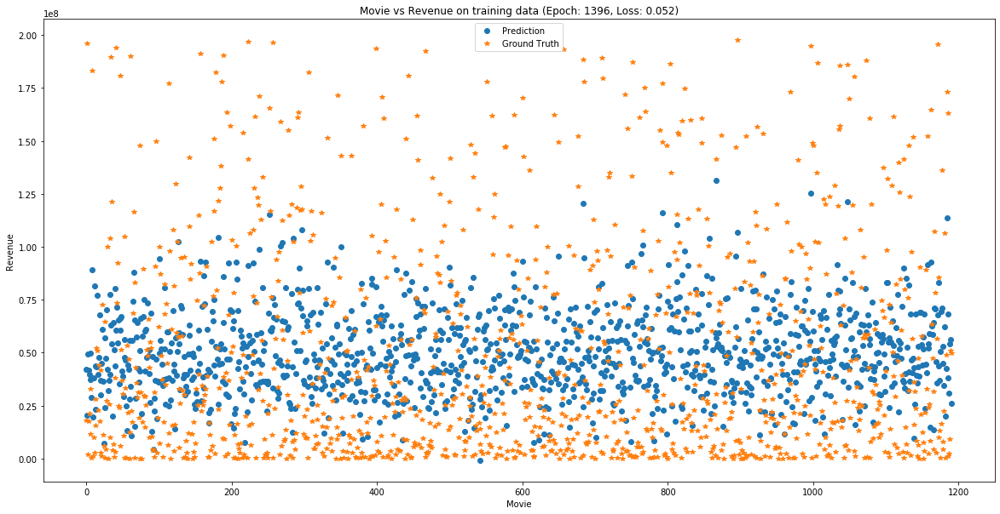

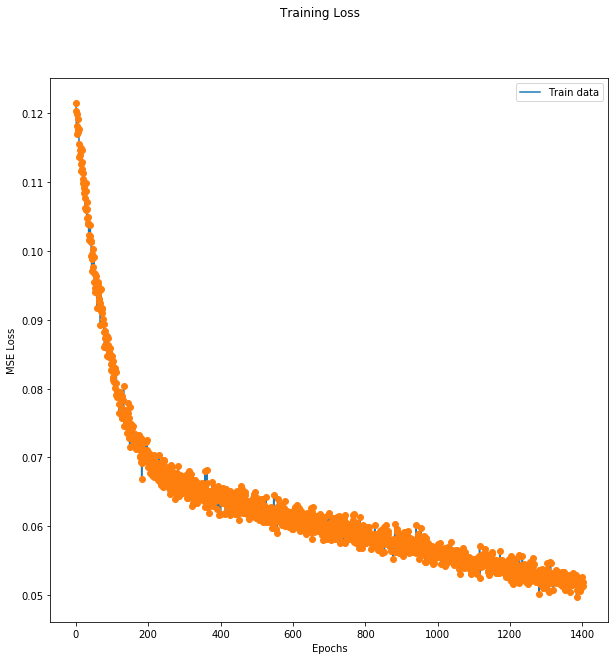

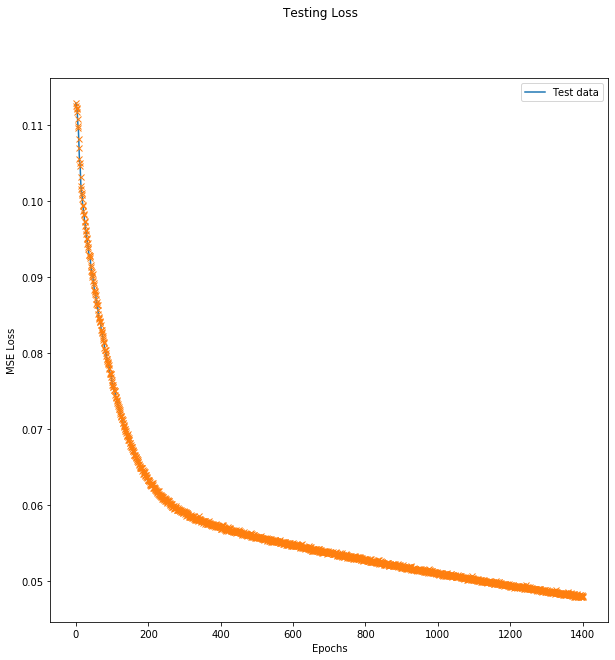

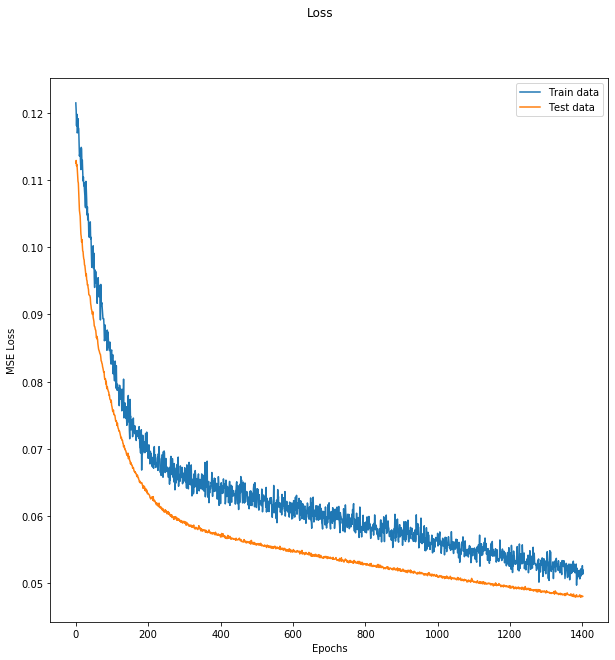

MAPE :  36.313876292491265


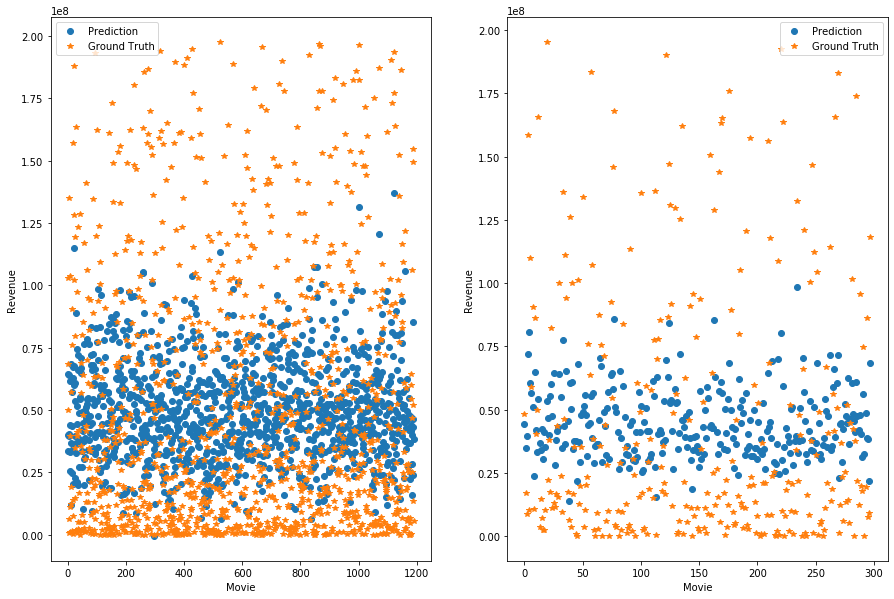

--- Epoch 1403 ---
[Epoch 1403/3000] [Batch 39/40] [Loss: 0.028980 (0.050884)]  [r2: (0.209055)] [rmse: (0.223396)], ETA: 0:37:07.119236
Testing -- [Batch 9/10] [Loss: 0.030952 (0.047846)] [r2: (0.227737)] [rmse: (0.216363)]
Train R2 =  0.24322957378184173
Test R2 =  0.24609157133212


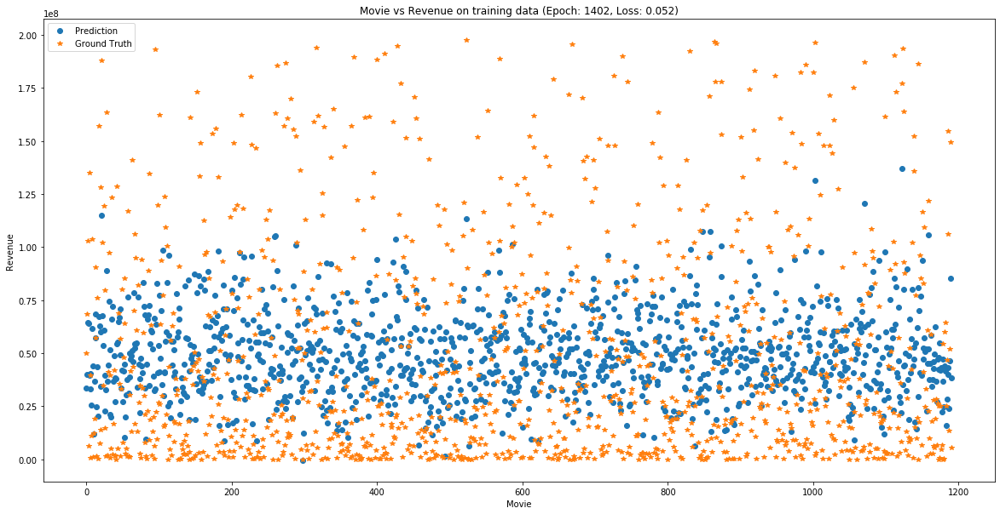

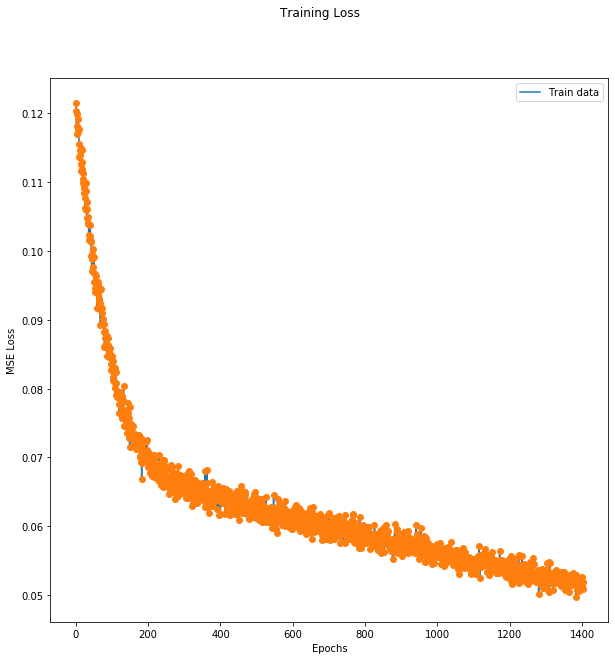

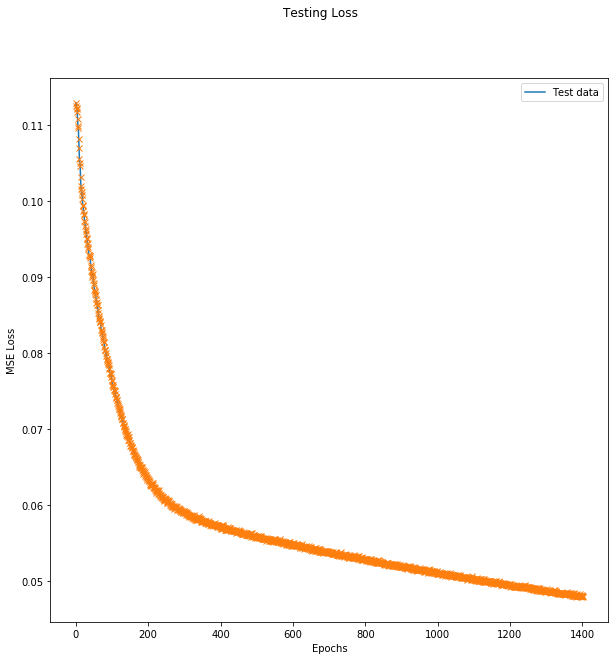

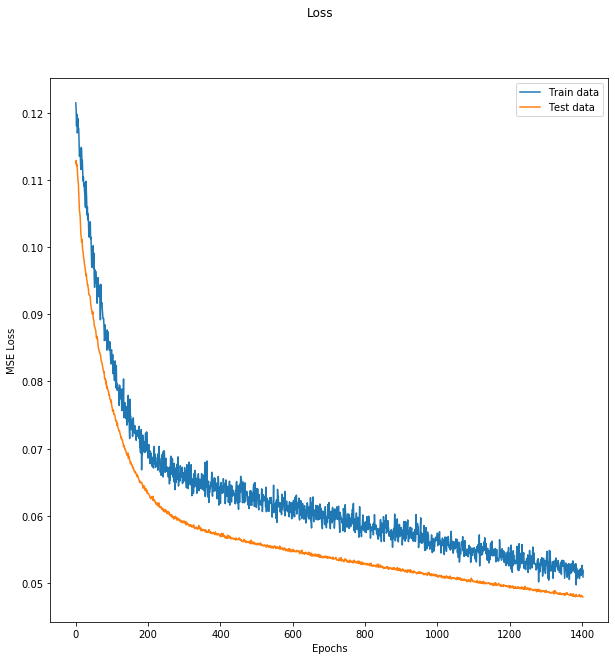

MAPE :  36.28016642879482


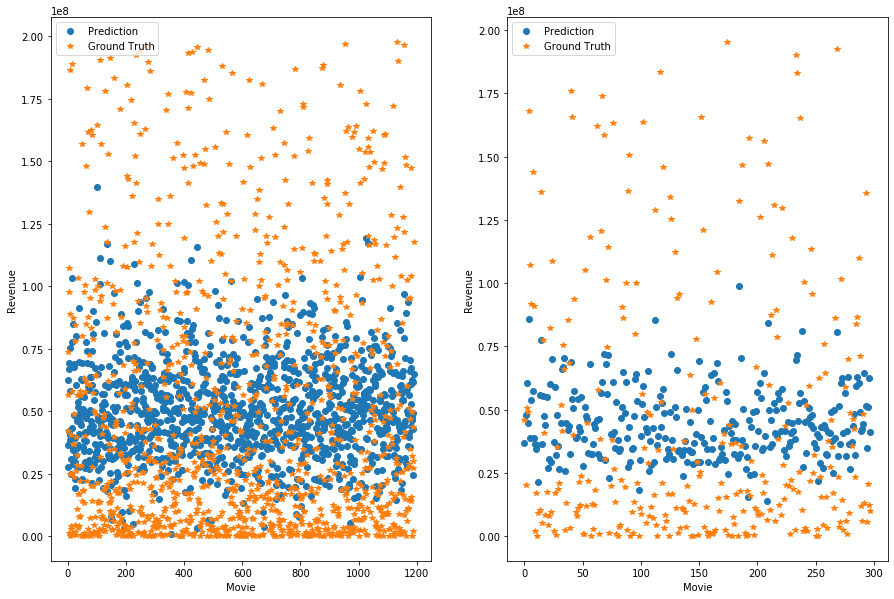

--- Epoch 1404 ---
[Epoch 1404/3000] [Batch 39/40] [Loss: 0.040524 (0.053175)]  [r2: (0.186564)] [rmse: (0.227501)], ETA: 0:40:29.190754
Testing -- [Batch 9/10] [Loss: 0.067744 (0.048099)] [r2: (0.191317)] [rmse: (0.216653)]
--- Epoch 1405 ---
[Epoch 1405/3000] [Batch 39/40] [Loss: 0.057250 (0.050387)]  [r2: (0.209040)] [rmse: (0.221192)], ETA: 0:37:49.751403
Testing -- [Batch 9/10] [Loss: 0.043109 (0.047938)] [r2: (0.240282)] [rmse: (0.217857)]
--- Epoch 1406 ---
[Epoch 1406/3000] [Batch 39/40] [Loss: 0.062250 (0.052597)]  [r2: (0.207785)] [rmse: (0.226783)], ETA: 0:36:43.866688
Testing -- [Batch 9/10] [Loss: 0.039744 (0.047913)] [r2: (0.228653)] [rmse: (0.217404)]
--- Epoch 1407 ---
[Epoch 1407/3000] [Batch 39/40] [Loss: 0.031097 (0.051794)]  [r2: (0.171026)] [rmse: (0.224908)], ETA: 0:42:53.017852
Testing -- [Batch 9/10] [Loss: 0.062462 (0.048075)] [r2: (0.215184)] [rmse: (0.216317)]
--- Epoch 1408 ---
[Epoch 1408/3000] [Batch 39/40] [Loss: 0.038094 (0.050758)]  [r2: (0.193003)] [rm

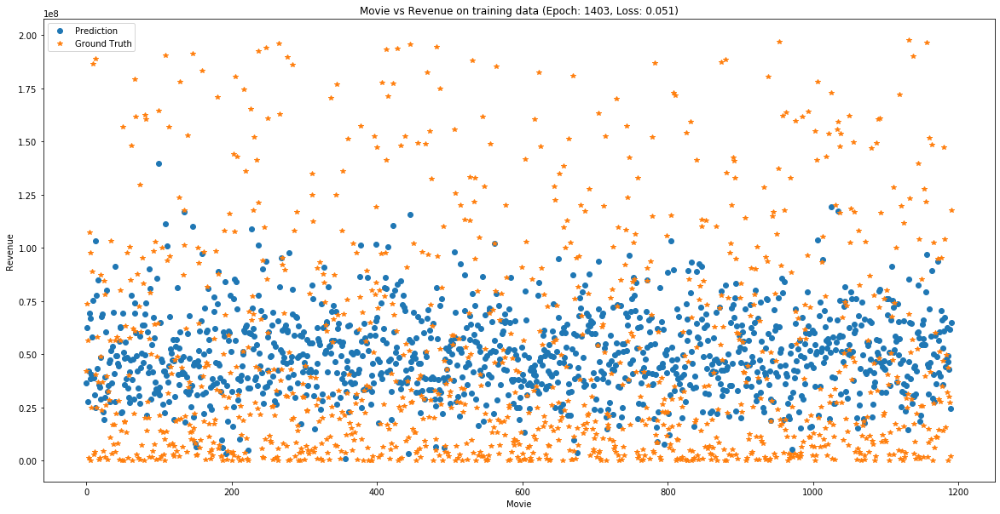

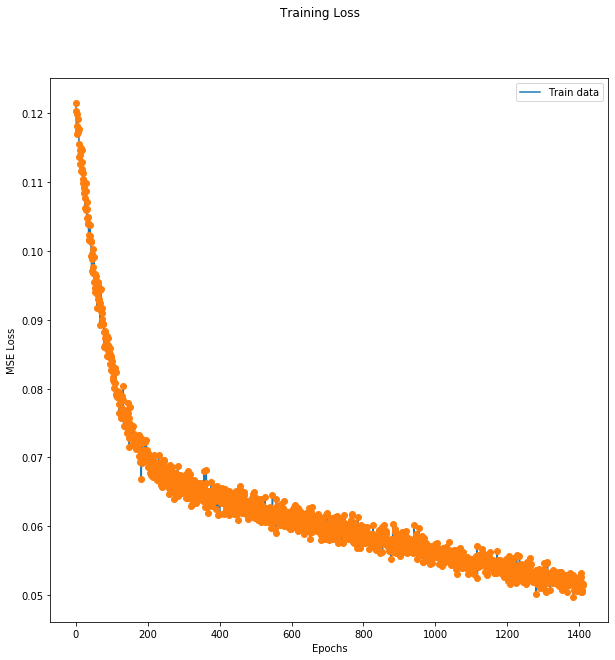

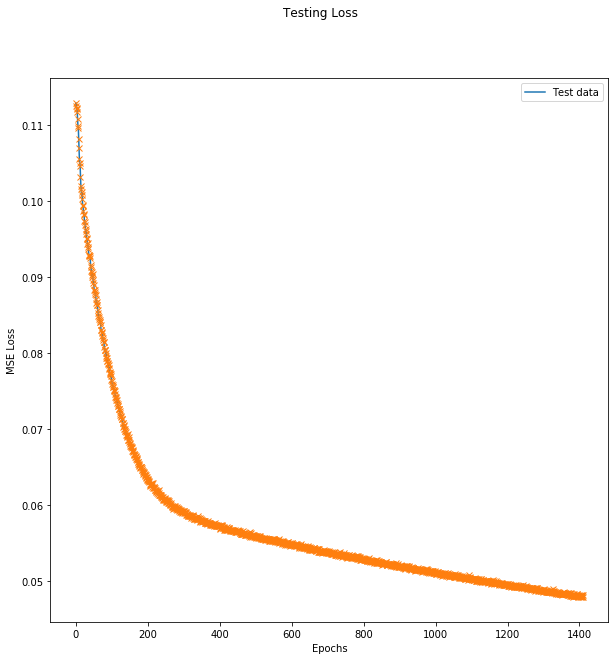

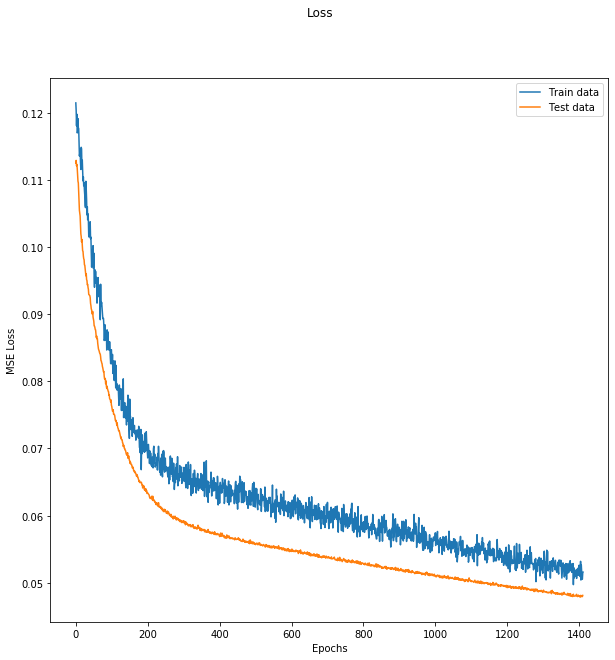

MAPE :  36.26834358867228


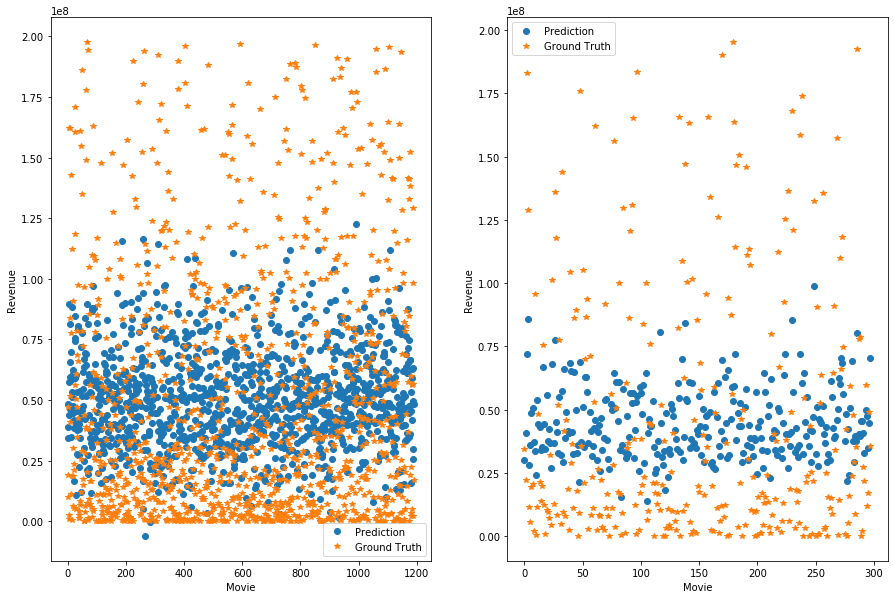

--- Epoch 1412 ---
[Epoch 1412/3000] [Batch 39/40] [Loss: 0.064072 (0.050760)]  [r2: (0.214055)] [rmse: (0.223020)], ETA: 0:36:09.034260
Testing -- [Batch 9/10] [Loss: 0.053078 (0.047935)] [r2: (0.120276)] [rmse: (0.214655)]
--- Epoch 1413 ---
[Epoch 1413/3000] [Batch 39/40] [Loss: 0.054242 (0.051510)]  [r2: (0.181161)] [rmse: (0.223965)], ETA: 0:37:49.931124
Testing -- [Batch 9/10] [Loss: 0.077392 (0.048094)] [r2: (0.234910)] [rmse: (0.215206)]
--- Epoch 1414 ---
[Epoch 1414/3000] [Batch 39/40] [Loss: 0.023063 (0.051550)]  [r2: (0.188579)] [rmse: (0.224303)], ETA: 0:36:14.977371
Testing -- [Batch 9/10] [Loss: 0.060831 (0.047985)] [r2: (0.229121)] [rmse: (0.215278)]
--- Epoch 1415 ---
[Epoch 1415/3000] [Batch 39/40] [Loss: 0.038198 (0.052208)]  [r2: (0.184260)] [rmse: (0.225985)], ETA: 0:36:05.538328
Testing -- [Batch 9/10] [Loss: 0.033101 (0.047789)] [r2: (0.222569)] [rmse: (0.216027)]
Train R2 =  0.22449127570376737
Test R2 =  0.247226074413039


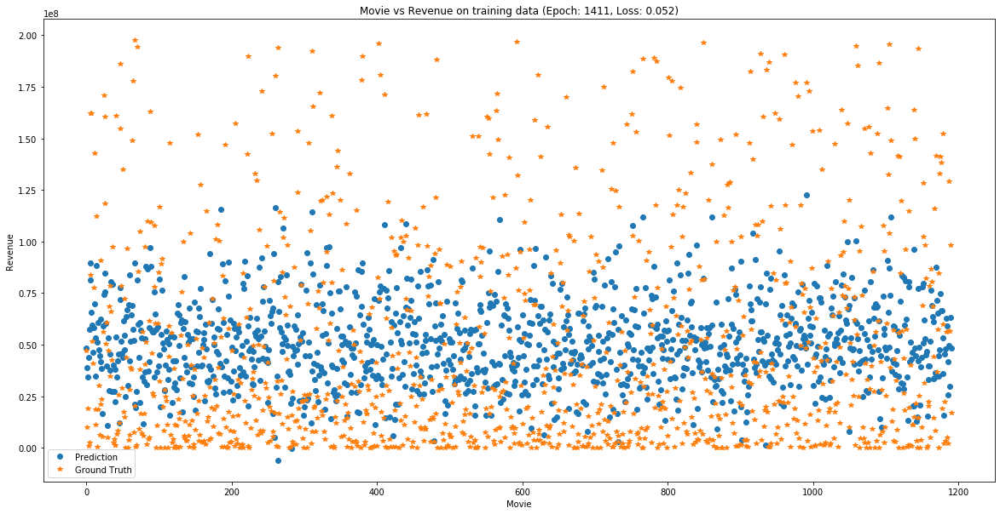

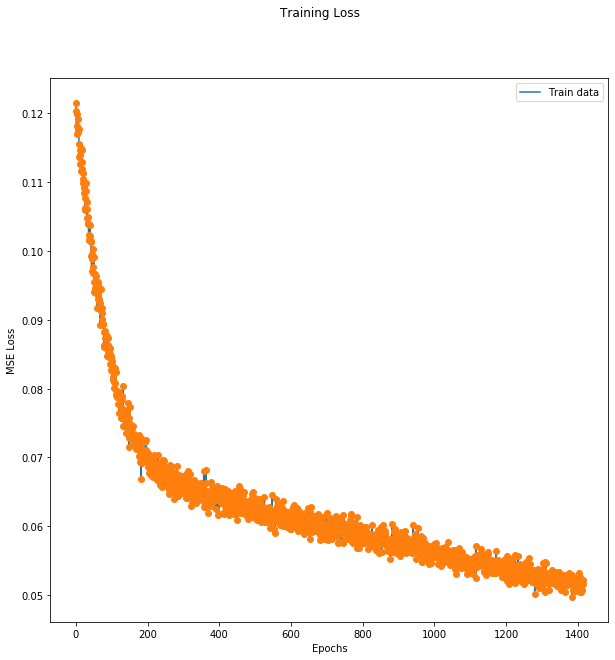

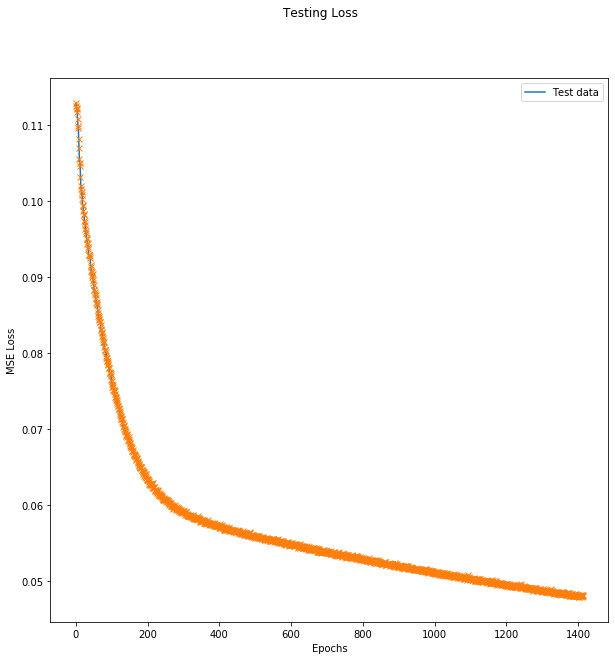

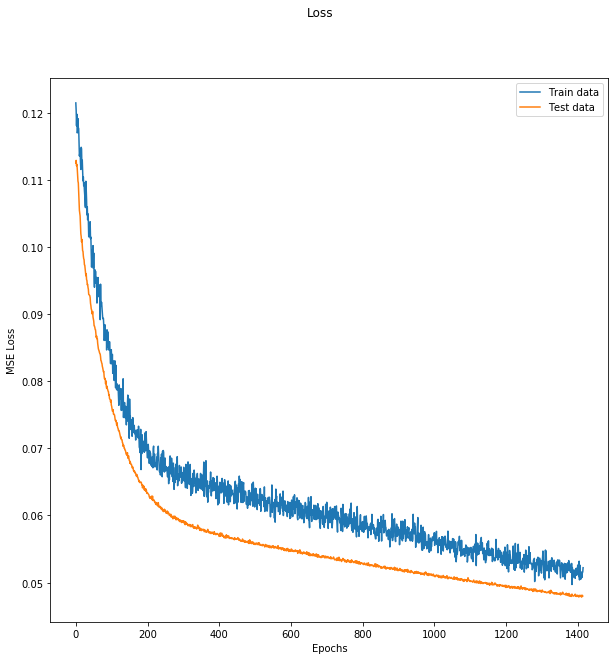

MAPE :  36.43049783053889


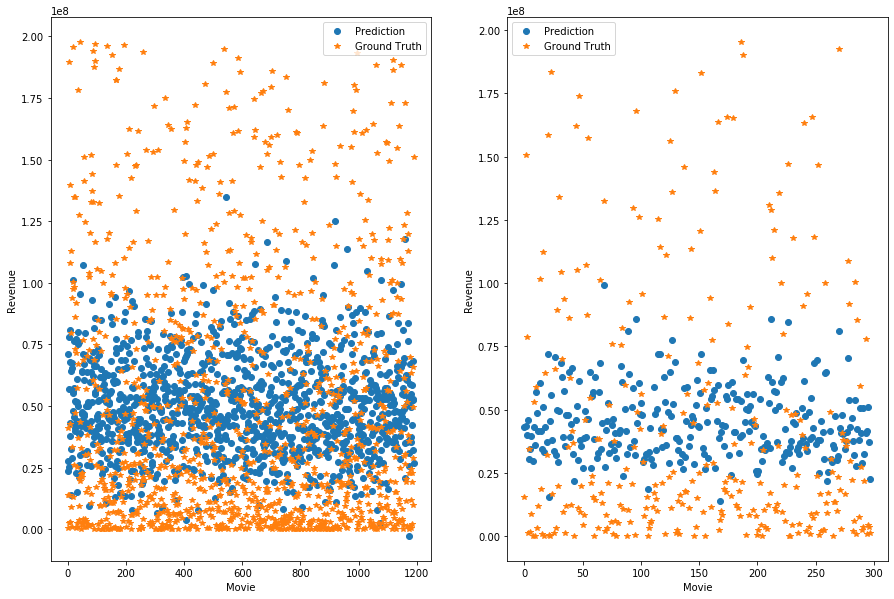

--- Epoch 1416 ---
[Epoch 1416/3000] [Batch 39/40] [Loss: 0.023586 (0.052375)]  [r2: (0.194682)] [rmse: (0.225985)], ETA: 0:36:13.289746
Testing -- [Batch 9/10] [Loss: 0.034088 (0.047788)] [r2: (0.230441)] [rmse: (0.216297)]
Train R2 =  0.22036703344599118
Test R2 =  0.24734544629837796


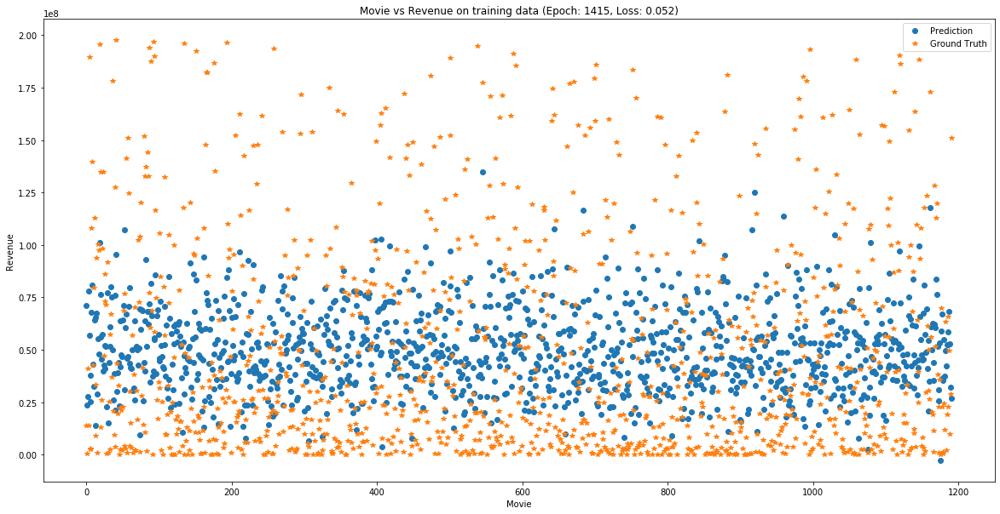

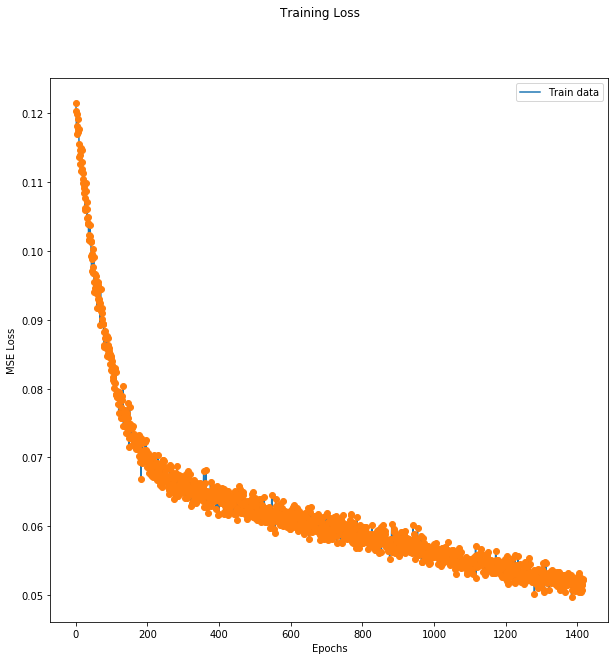

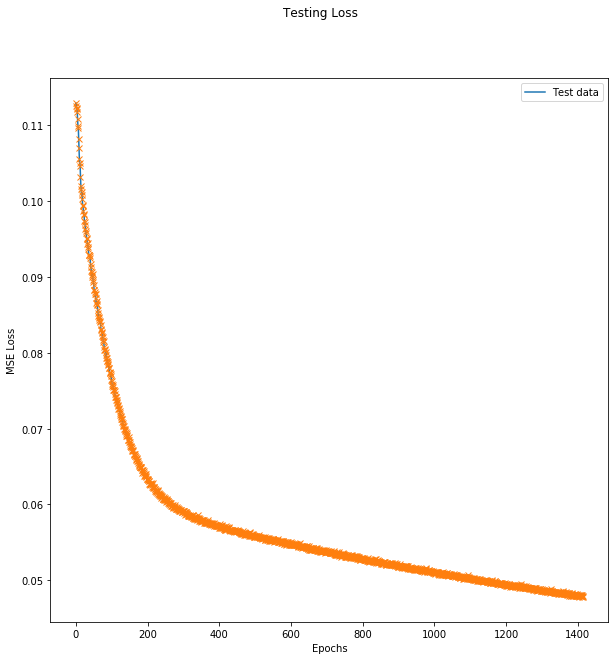

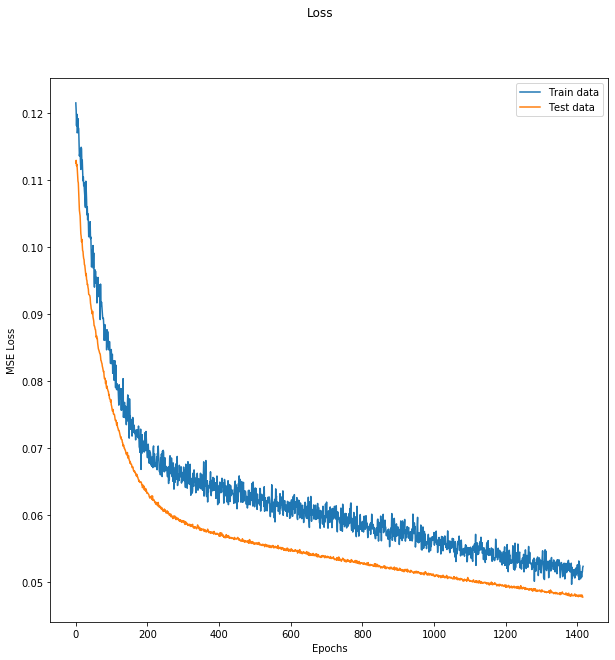

MAPE :  36.431232330725905


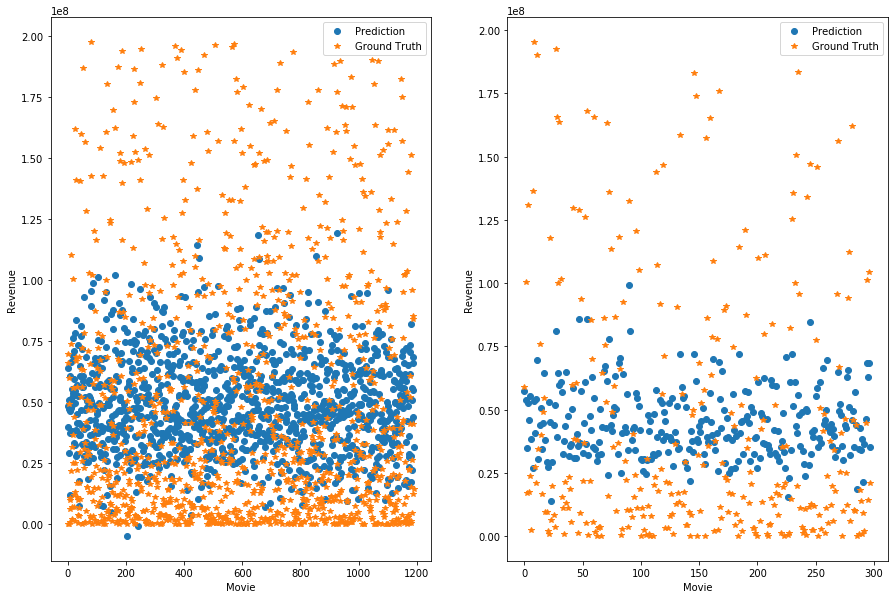

--- Epoch 1417 ---
[Epoch 1417/3000] [Batch 39/40] [Loss: 0.057806 (0.052240)]  [r2: (0.171924)] [rmse: (0.226563)], ETA: 0:37:54.375178
Testing -- [Batch 9/10] [Loss: 0.048706 (0.047877)] [r2: (0.195731)] [rmse: (0.216391)]
--- Epoch 1418 ---
[Epoch 1418/3000] [Batch 39/40] [Loss: 0.075887 (0.051005)]  [r2: (0.216098)] [rmse: (0.223714)], ETA: 0:35:53.852846
Testing -- [Batch 9/10] [Loss: 0.053426 (0.047927)] [r2: (0.243854)] [rmse: (0.216548)]
--- Epoch 1419 ---
[Epoch 1419/3000] [Batch 39/40] [Loss: 0.047053 (0.050826)]  [r2: (0.208341)] [rmse: (0.223474)], ETA: 0:36:01.305483
Testing -- [Batch 9/10] [Loss: 0.072799 (0.048021)] [r2: (0.226501)] [rmse: (0.215794)]
--- Epoch 1420 ---
[Epoch 1420/3000] [Batch 39/40] [Loss: 0.030544 (0.050508)]  [r2: (0.219816)] [rmse: (0.222007)], ETA: 0:36:00.012884
Testing -- [Batch 9/10] [Loss: 0.051685 (0.047881)] [r2: (0.229707)] [rmse: (0.216964)]
--- Epoch 1421 ---
[Epoch 1421/3000] [Batch 39/40] [Loss: 0.039567 (0.051414)]  [r2: (0.198612)] [rm

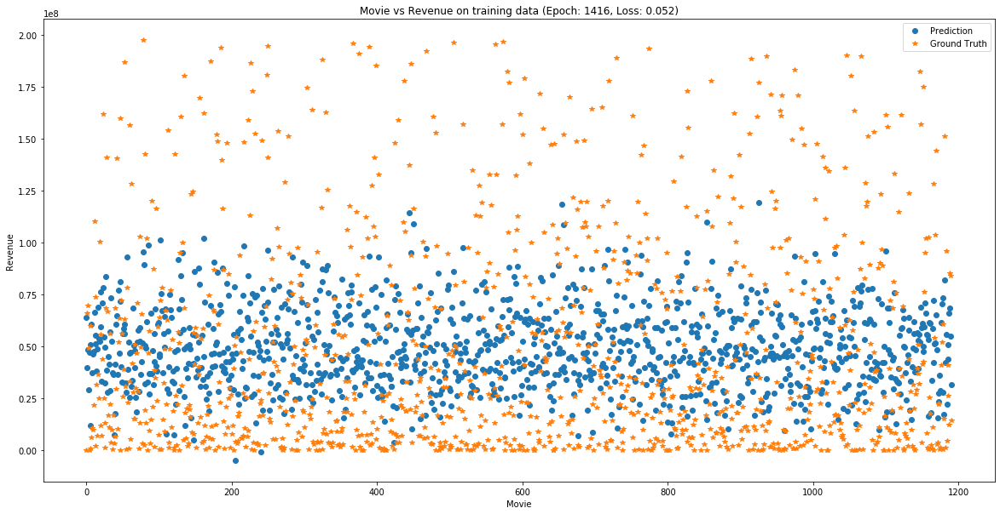

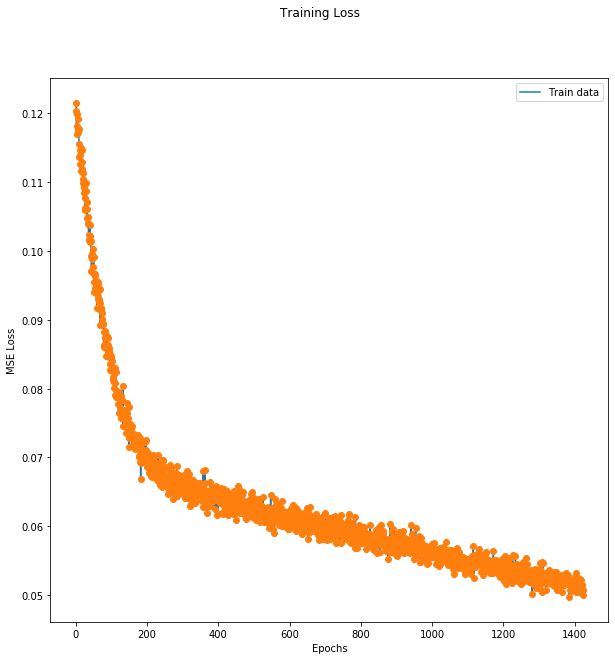

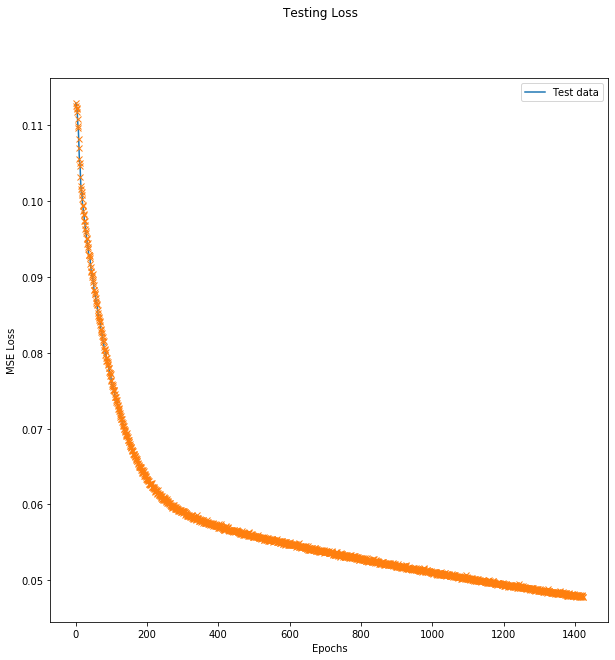

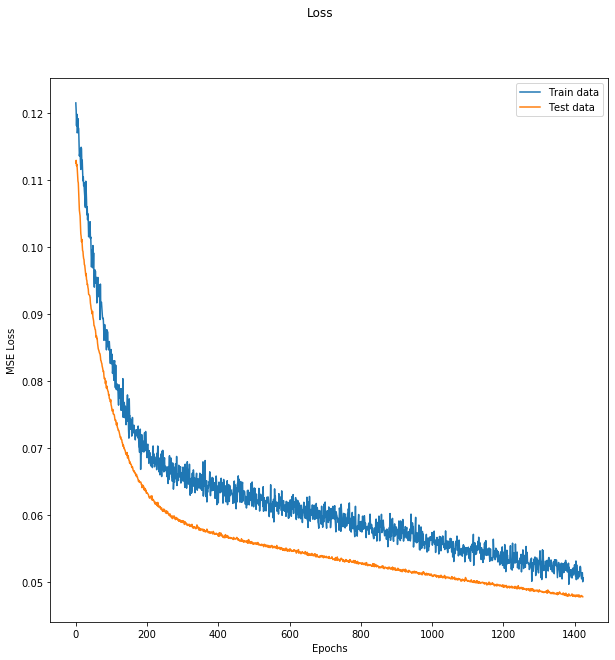

MAPE :  36.266208326784465


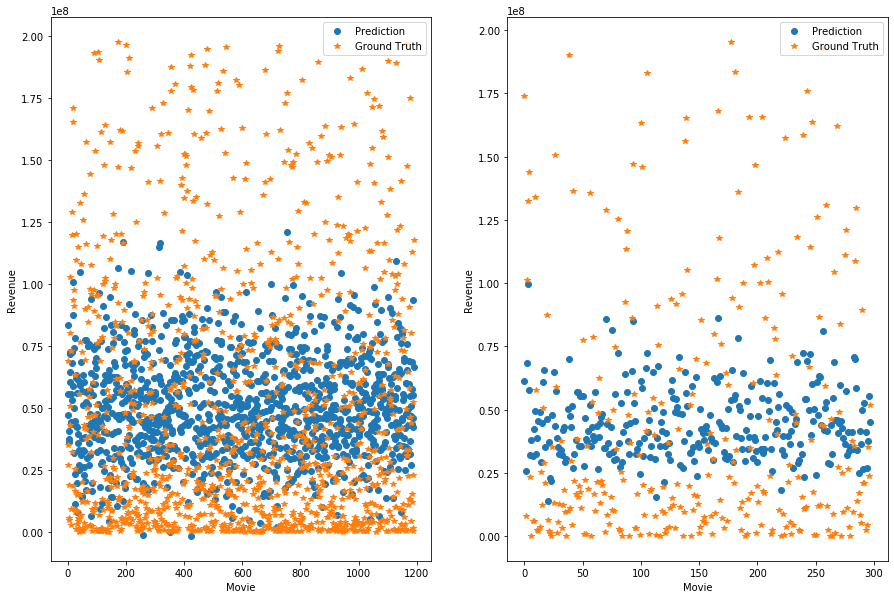

--- Epoch 1425 ---
[Epoch 1425/3000] [Batch 39/40] [Loss: 0.025760 (0.050740)]  [r2: (0.206181)] [rmse: (0.221890)], ETA: 0:37:32.651555
Testing -- [Batch 9/10] [Loss: 0.069258 (0.047953)] [r2: (0.240360)] [rmse: (0.216921)]
--- Epoch 1426 ---
[Epoch 1426/3000] [Batch 39/40] [Loss: 0.051704 (0.049993)]  [r2: (0.237040)] [rmse: (0.220918)], ETA: 0:35:48.849936
Testing -- [Batch 9/10] [Loss: 0.047408 (0.047787)] [r2: (0.217435)] [rmse: (0.217233)]
--- Epoch 1427 ---
[Epoch 1427/3000] [Batch 39/40] [Loss: 0.044262 (0.051772)]  [r2: (0.207680)] [rmse: (0.225300)], ETA: 0:36:24.499119
Testing -- [Batch 9/10] [Loss: 0.063143 (0.047888)] [r2: (0.220260)] [rmse: (0.216644)]
--- Epoch 1428 ---
[Epoch 1428/3000] [Batch 39/40] [Loss: 0.059888 (0.049692)]  [r2: (0.233026)] [rmse: (0.220807)], ETA: 0:37:38.725996
Testing -- [Batch 9/10] [Loss: 0.048709 (0.047816)] [r2: (0.240556)] [rmse: (0.217189)]
--- Epoch 1429 ---
[Epoch 1429/3000] [Batch 39/40] [Loss: 0.043646 (0.051370)]  [r2: (0.192183)] [rm

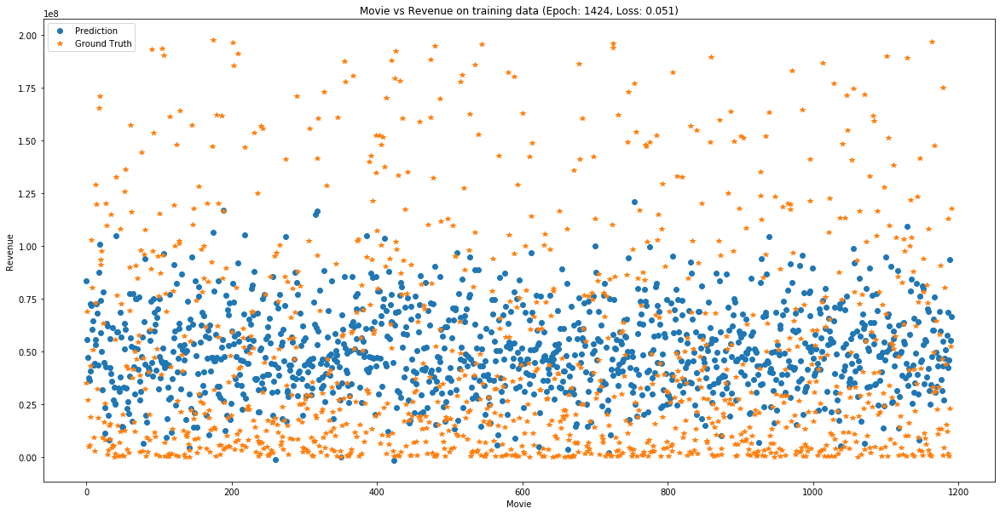

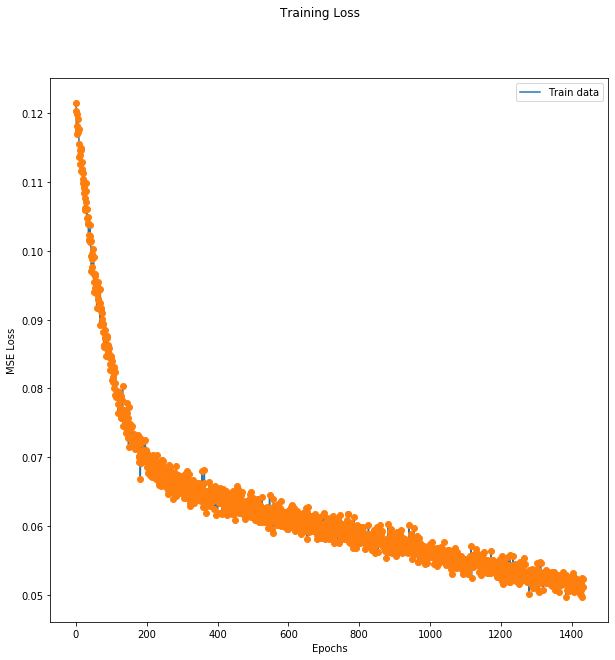

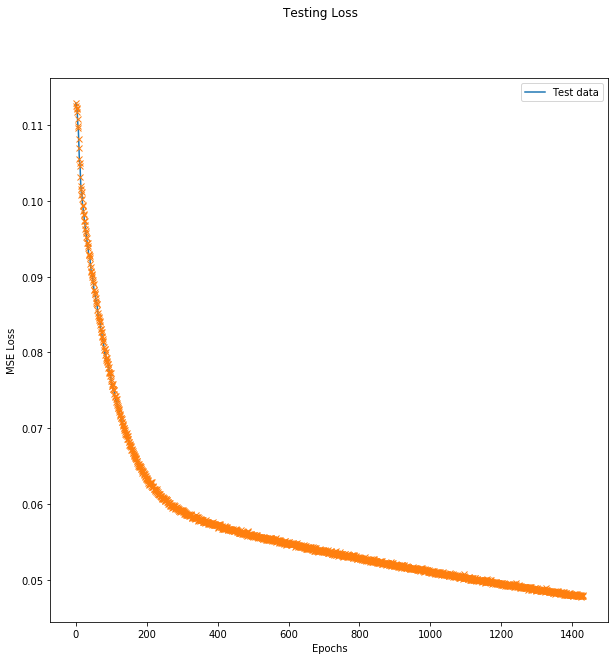

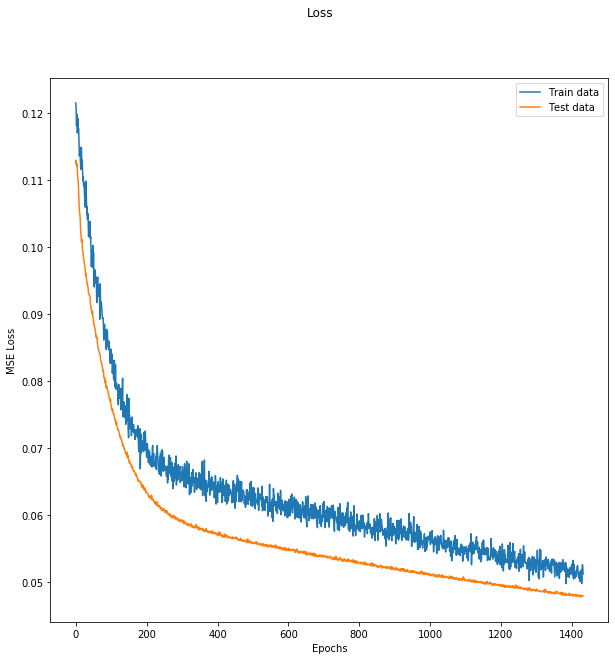

MAPE :  36.18430052116993


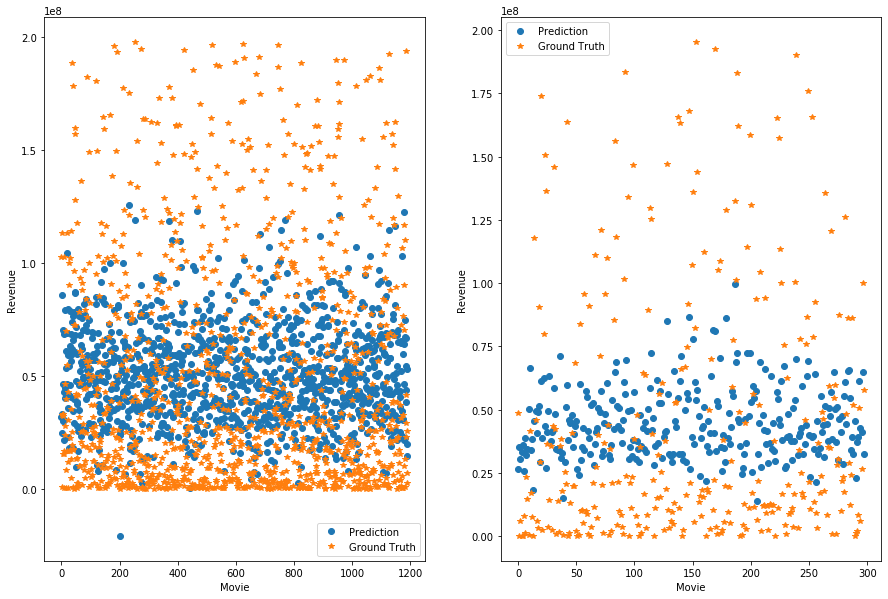

--- Epoch 1433 ---
[Epoch 1433/3000] [Batch 39/40] [Loss: 0.035362 (0.050516)]  [r2: (0.210780)] [rmse: (0.223316)], ETA: 0:36:32.724137
Testing -- [Batch 9/10] [Loss: 0.058083 (0.047813)] [r2: (0.222046)] [rmse: (0.216205)]
--- Epoch 1434 ---
[Epoch 1434/3000] [Batch 39/40] [Loss: 0.046252 (0.051941)]  [r2: (0.176179)] [rmse: (0.225665)], ETA: 0:35:37.533382
Testing -- [Batch 9/10] [Loss: 0.043868 (0.047706)] [r2: (0.216635)] [rmse: (0.216119)]
--- Epoch 1435 ---
[Epoch 1435/3000] [Batch 39/40] [Loss: 0.051188 (0.052193)]  [r2: (0.198924)] [rmse: (0.226412)], ETA: 0:36:44.287592
Testing -- [Batch 9/10] [Loss: 0.049465 (0.047733)] [r2: (0.245473)] [rmse: (0.216965)]
--- Epoch 1436 ---
[Epoch 1436/3000] [Batch 39/40] [Loss: 0.022783 (0.050604)]  [r2: (0.194915)] [rmse: (0.222592)], ETA: 0:38:35.688102
Testing -- [Batch 9/10] [Loss: 0.036279 (0.047653)] [r2: (0.239661)] [rmse: (0.216250)]
--- Epoch 1437 ---
[Epoch 1437/3000] [Batch 39/40] [Loss: 0.063475 (0.050387)]  [r2: (0.221337)] [rm

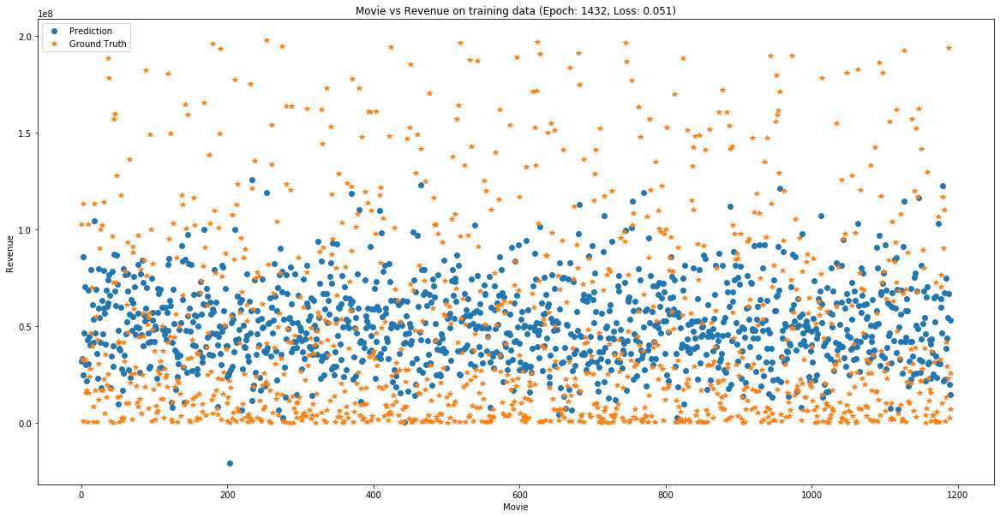

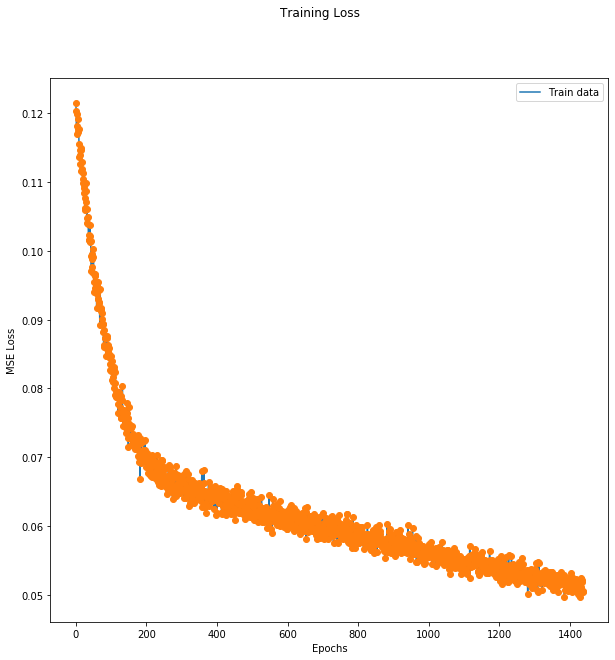

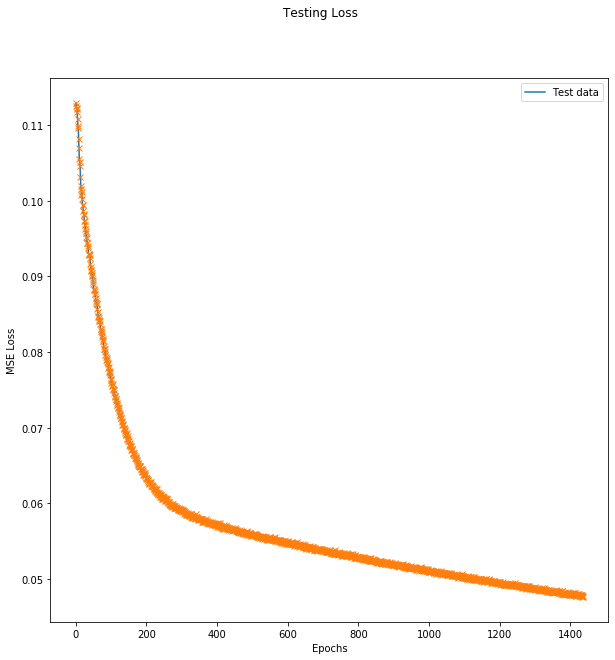

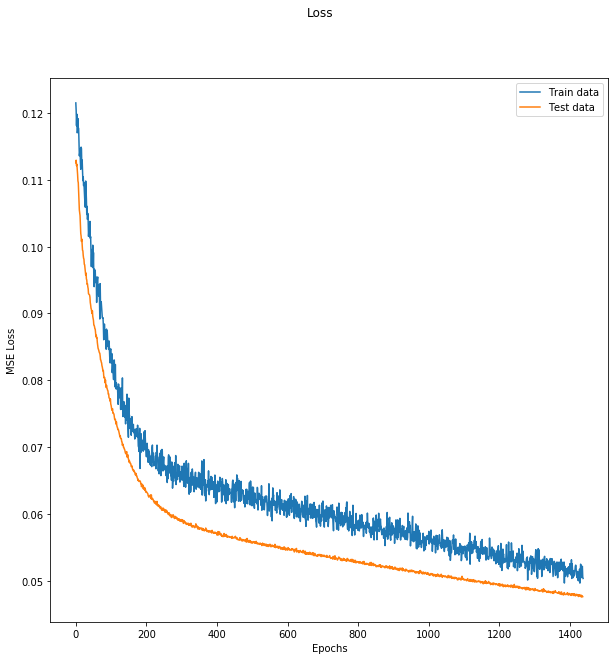

MAPE :  36.09828865149183


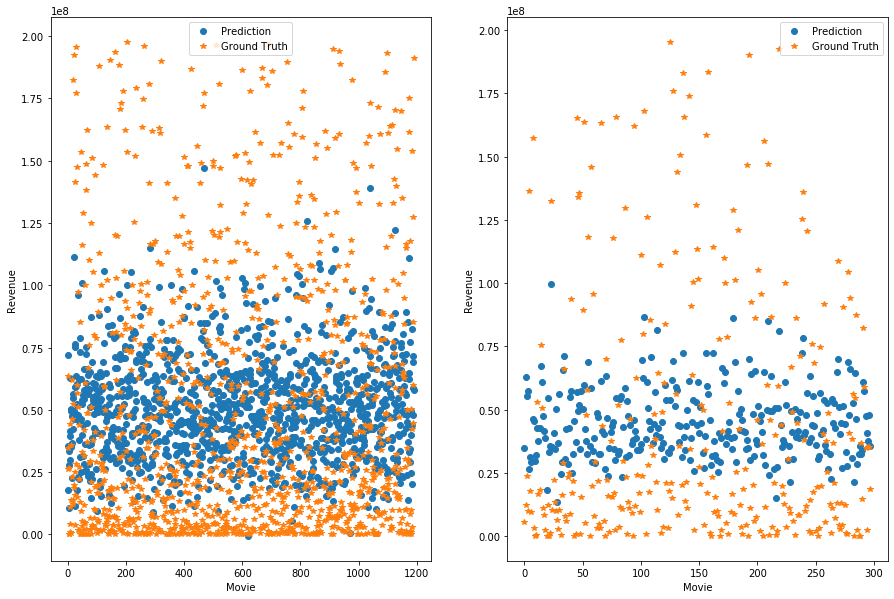

--- Epoch 1438 ---
[Epoch 1438/3000] [Batch 39/40] [Loss: 0.048002 (0.052041)]  [r2: (0.198659)] [rmse: (0.225659)], ETA: 0:35:49.354042
Testing -- [Batch 9/10] [Loss: 0.064320 (0.047842)] [r2: (0.213440)] [rmse: (0.217906)]
--- Epoch 1439 ---
[Epoch 1439/3000] [Batch 39/40] [Loss: 0.027353 (0.050834)]  [r2: (0.209368)] [rmse: (0.223235)], ETA: 0:35:39.675479
Testing -- [Batch 9/10] [Loss: 0.051669 (0.047723)] [r2: (0.231957)] [rmse: (0.216379)]
--- Epoch 1440 ---
[Epoch 1440/3000] [Batch 39/40] [Loss: 0.061196 (0.049617)]  [r2: (0.229259)] [rmse: (0.220907)], ETA: 0:36:36.571688
Testing -- [Batch 9/10] [Loss: 0.051400 (0.047713)] [r2: (0.223151)] [rmse: (0.216070)]
--- Epoch 1441 ---
[Epoch 1441/3000] [Batch 39/40] [Loss: 0.039014 (0.049954)]  [r2: (0.218972)] [rmse: (0.220947)], ETA: 0:35:21.865846
Testing -- [Batch 9/10] [Loss: 0.024696 (0.047527)] [r2: (0.205006)] [rmse: (0.215323)]
Train R2 =  0.25824829598957744
Test R2 =  0.25049019628421865


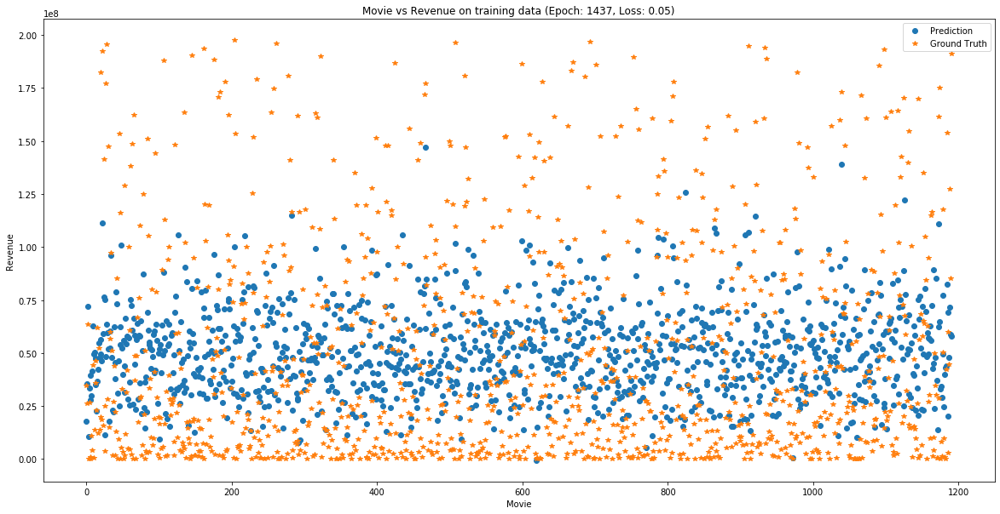

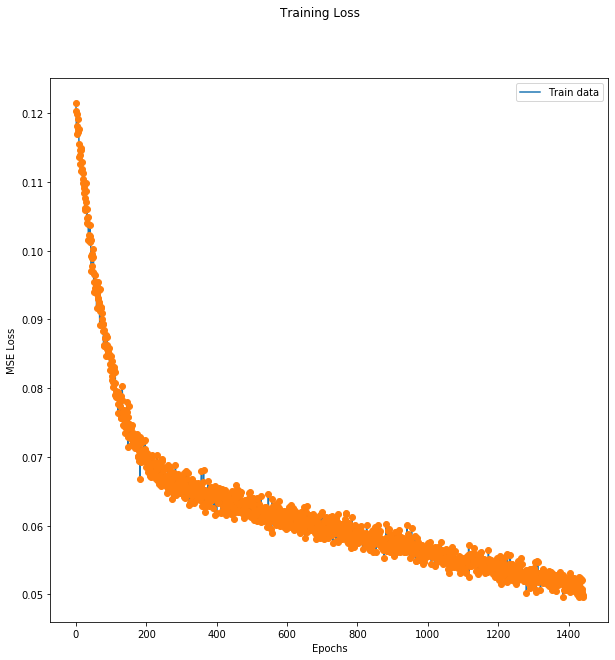

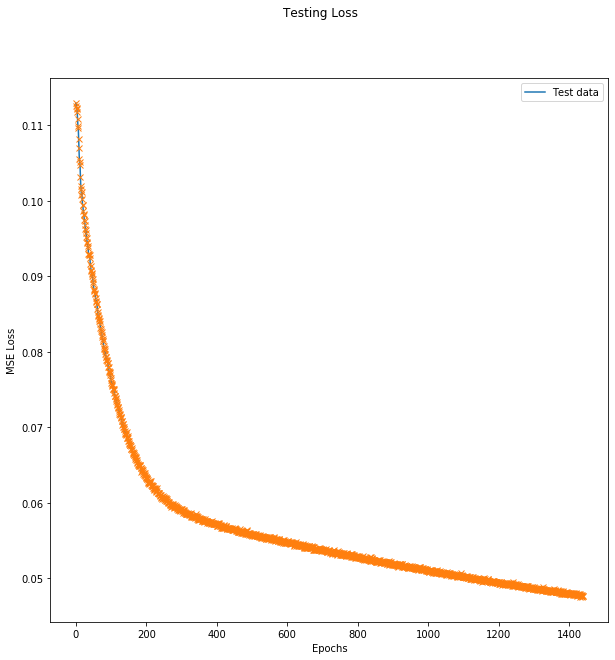

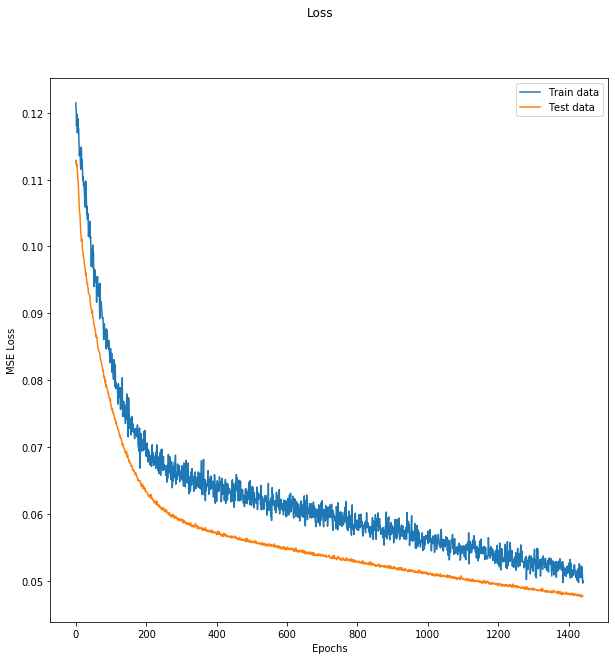

MAPE :  36.11323471874287


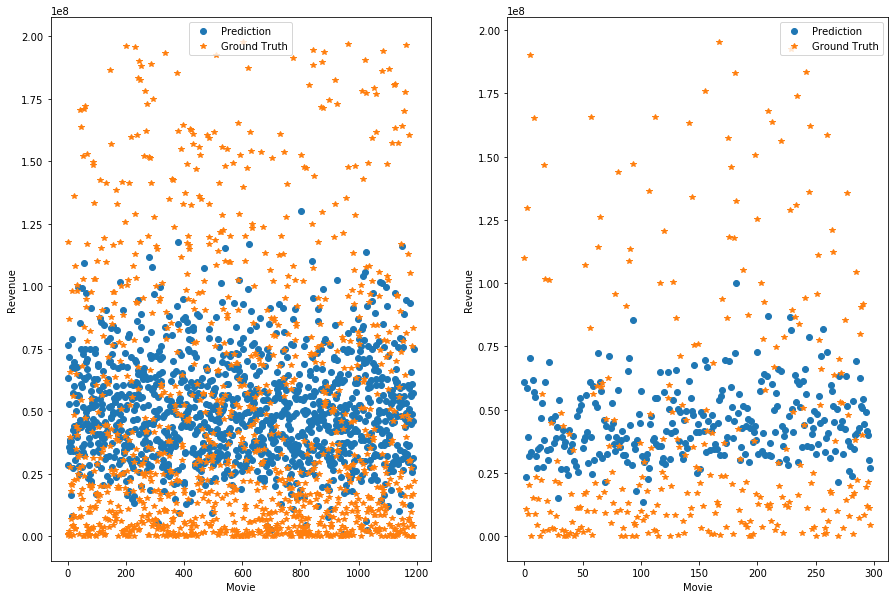

--- Epoch 1442 ---
[Epoch 1442/3000] [Batch 39/40] [Loss: 0.027980 (0.051287)]  [r2: (0.210566)] [rmse: (0.224466)], ETA: 0:37:44.642685
Testing -- [Batch 9/10] [Loss: 0.043088 (0.047633)] [r2: (0.208617)] [rmse: (0.216191)]
--- Epoch 1443 ---
[Epoch 1443/3000] [Batch 39/40] [Loss: 0.047970 (0.050226)]  [r2: (0.217449)] [rmse: (0.221820)], ETA: 0:35:29.633520
Testing -- [Batch 9/10] [Loss: 0.030271 (0.047536)] [r2: (0.200973)] [rmse: (0.214126)]
--- Epoch 1444 ---
[Epoch 1444/3000] [Batch 39/40] [Loss: 0.037587 (0.050793)]  [r2: (0.219489)] [rmse: (0.223312)], ETA: 0:35:03.899400
Testing -- [Batch 9/10] [Loss: 0.042703 (0.047626)] [r2: (0.232409)] [rmse: (0.216658)]
--- Epoch 1445 ---
[Epoch 1445/3000] [Batch 39/40] [Loss: 0.041116 (0.049819)]  [r2: (0.224640)] [rmse: (0.221005)], ETA: 0:34:52.942853
Testing -- [Batch 9/10] [Loss: 0.032936 (0.047570)] [r2: (0.206298)] [rmse: (0.215548)]
--- Epoch 1446 ---
[Epoch 1446/3000] [Batch 39/40] [Loss: 0.052566 (0.052083)]  [r2: (0.201299)] [rm

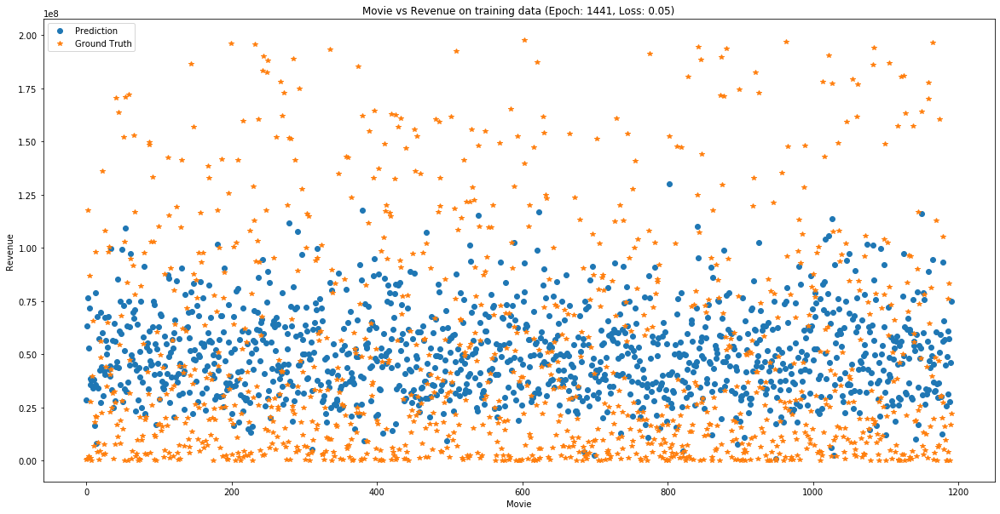

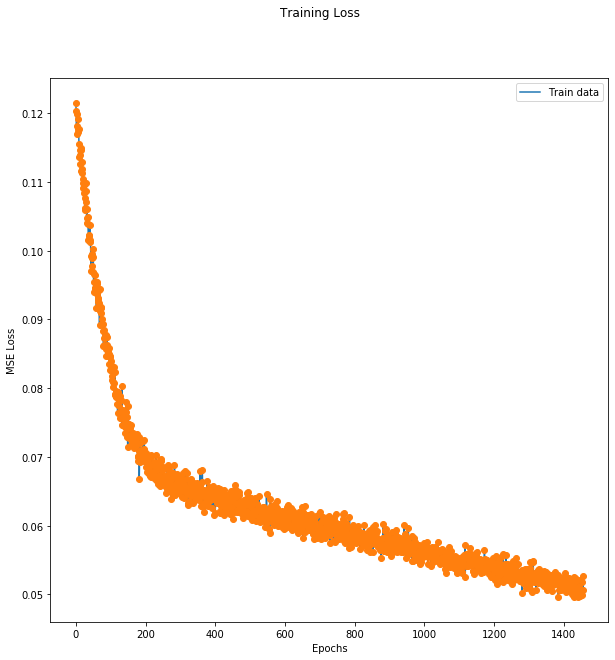

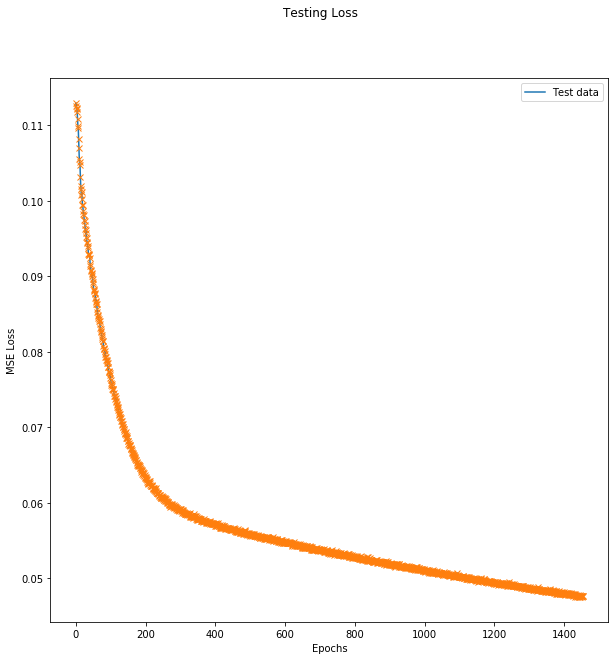

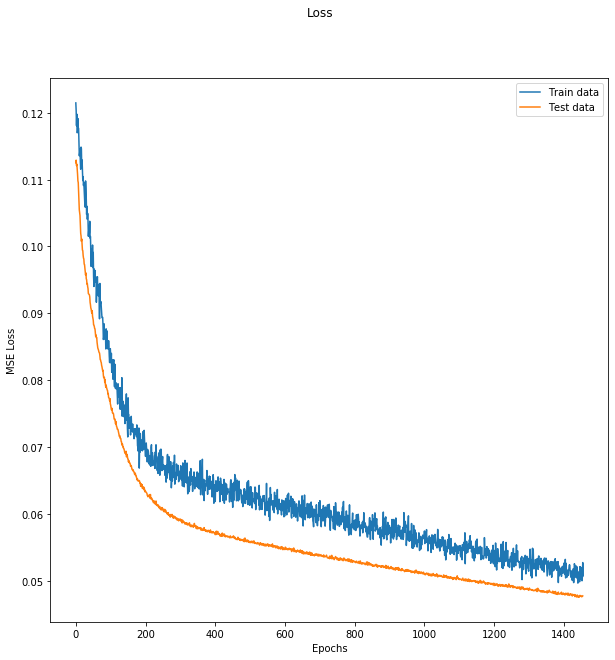

MAPE :  35.89820592230244


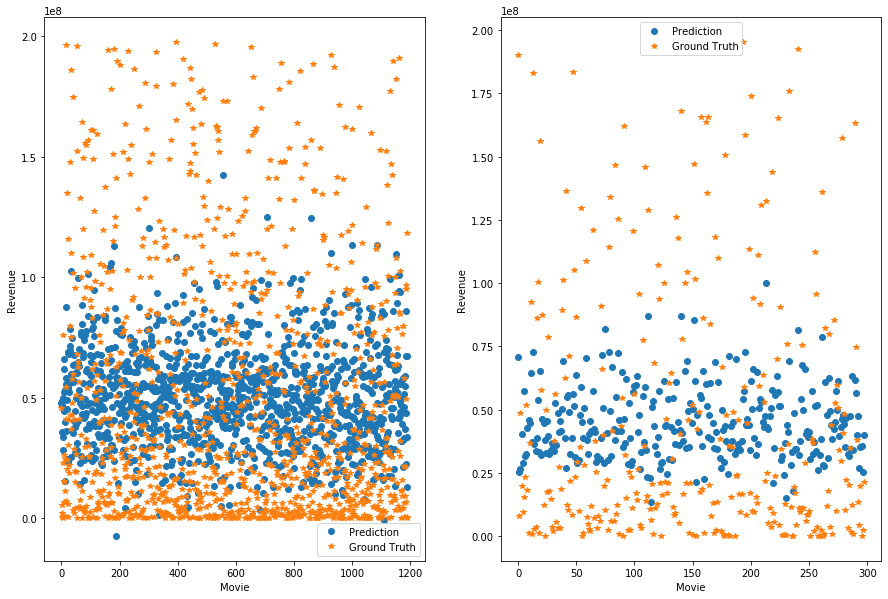

--- Epoch 1456 ---
[Epoch 1456/3000] [Batch 39/40] [Loss: 0.027559 (0.052006)]  [r2: (0.197549)] [rmse: (0.225591)], ETA: 0:37:24.132982
Testing -- [Batch 9/10] [Loss: 0.021268 (0.047417)] [r2: (0.180581)] [rmse: (0.215722)]
Train R2 =  0.2263253100978575
Test R2 =  0.25185771250143596


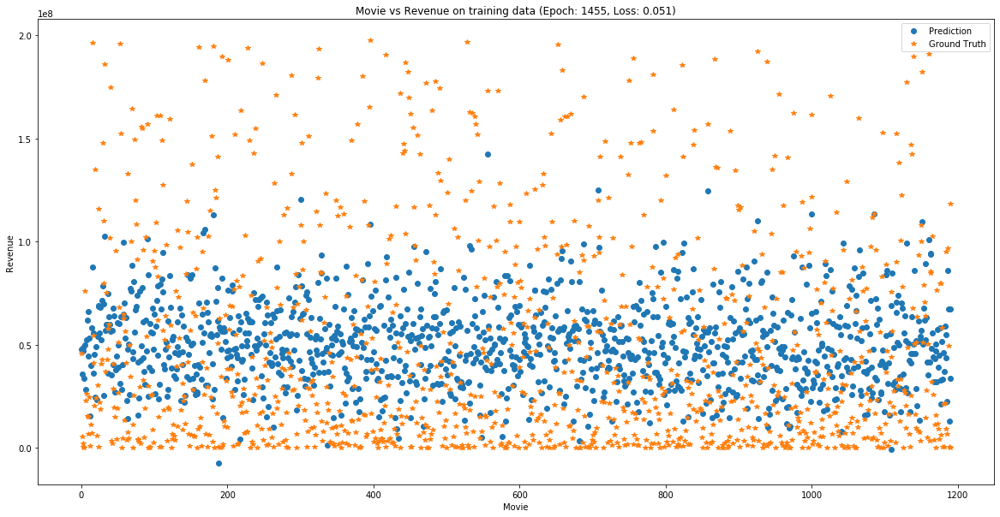

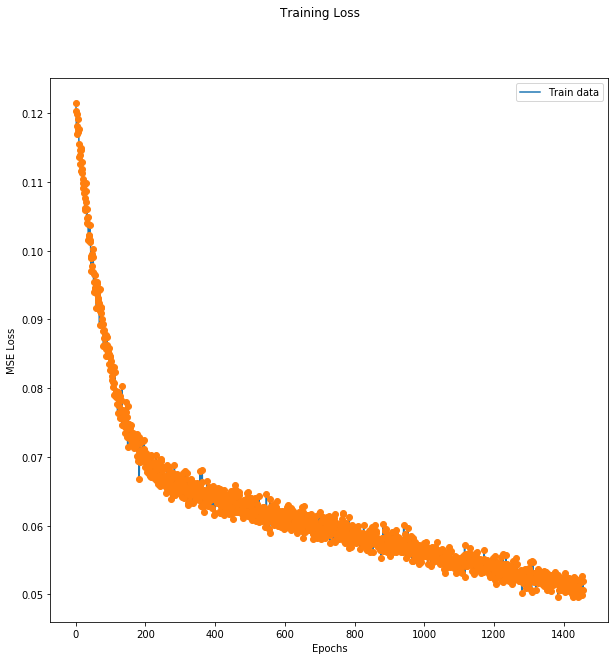

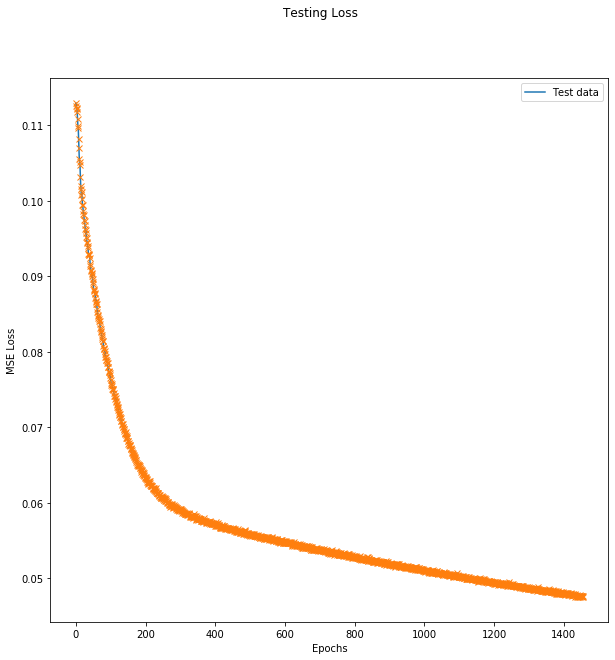

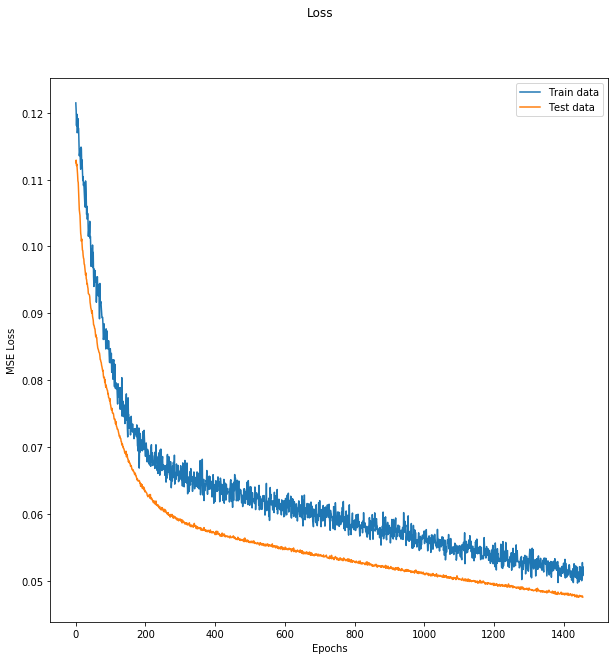

MAPE :  35.99235878264393


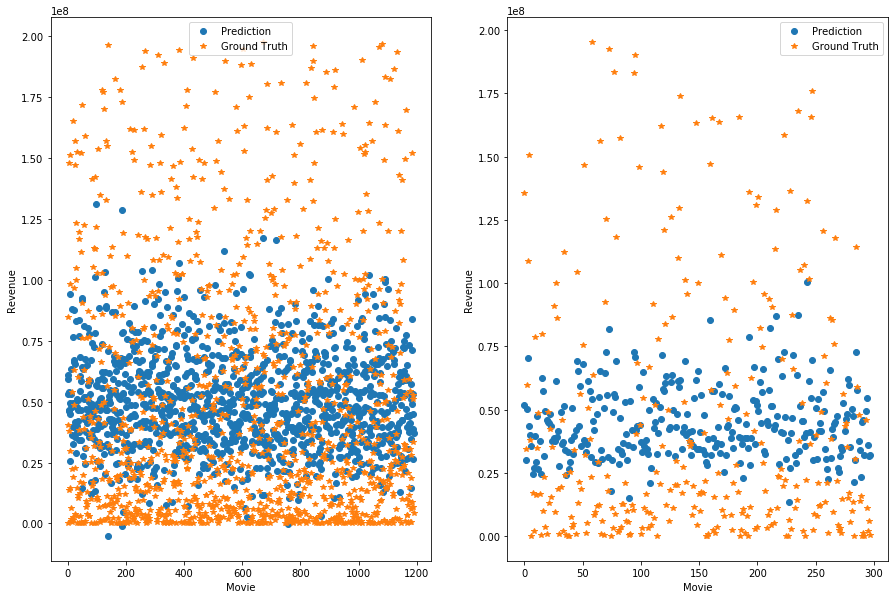

--- Epoch 1457 ---
[Epoch 1457/3000] [Batch 39/40] [Loss: 0.098841 (0.051248)]  [r2: (0.215954)] [rmse: (0.222739)], ETA: 0:36:16.060899
Testing -- [Batch 9/10] [Loss: 0.045480 (0.047568)] [r2: (0.206618)] [rmse: (0.215690)]
--- Epoch 1458 ---
[Epoch 1458/3000] [Batch 39/40] [Loss: 0.059225 (0.051420)]  [r2: (0.201787)] [rmse: (0.224143)], ETA: 0:34:38.976427
Testing -- [Batch 9/10] [Loss: 0.021926 (0.047409)] [r2: (0.196114)] [rmse: (0.213532)]
Train R2 =  0.23862551405004218
Test R2 =  0.2520511449342927


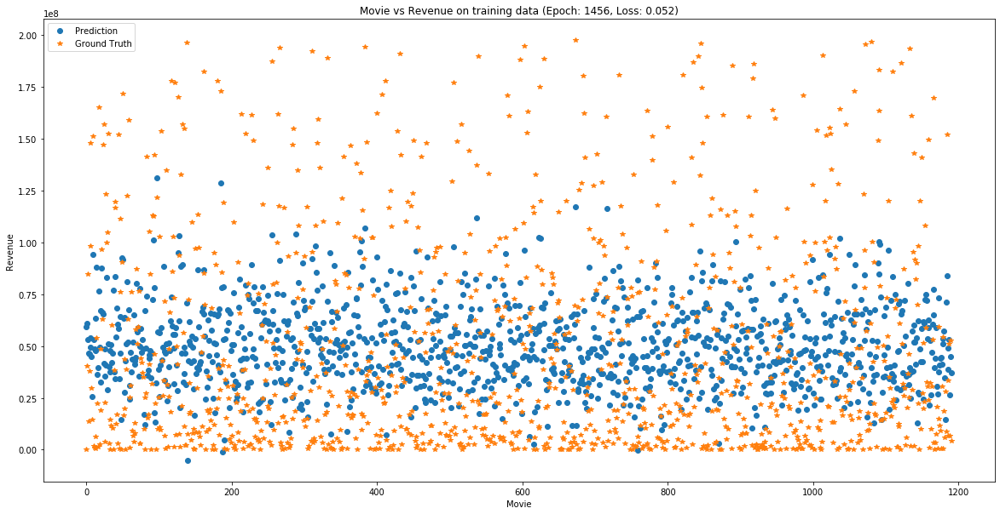

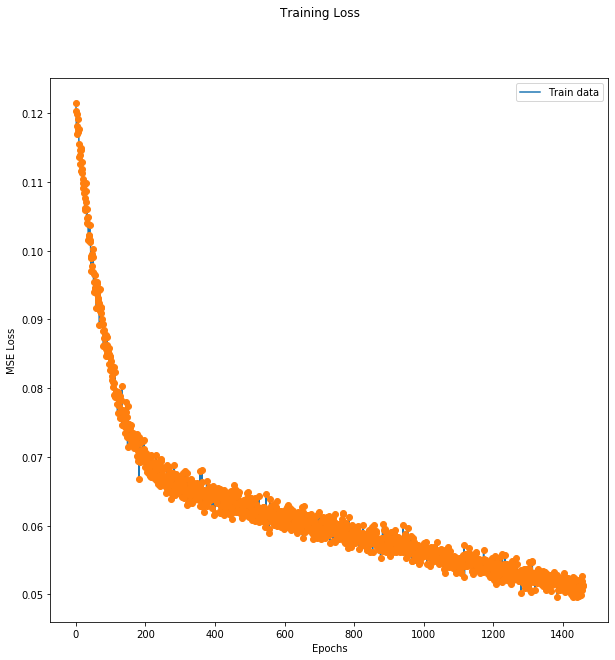

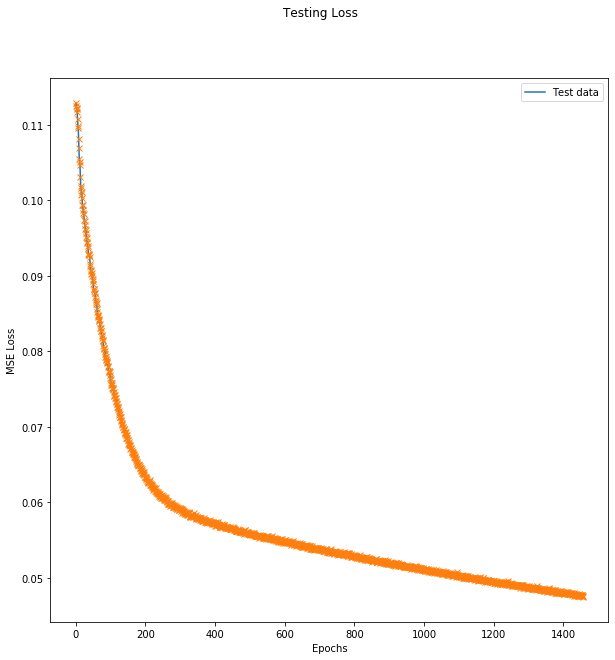

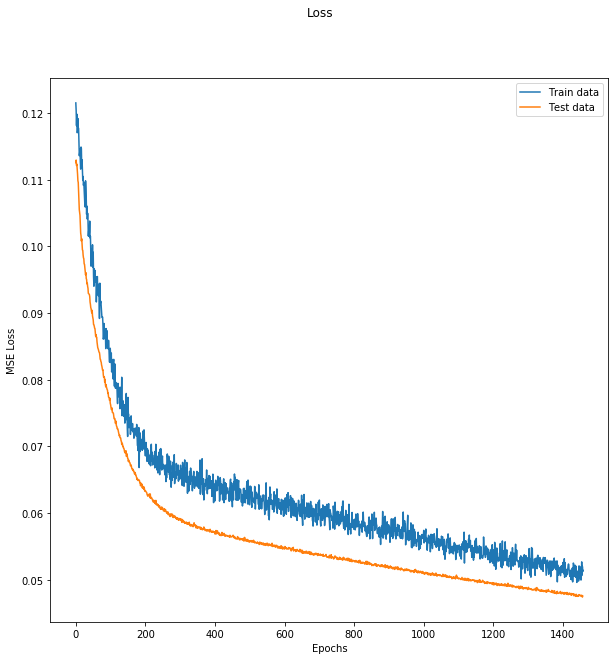

MAPE :  35.93881661571065


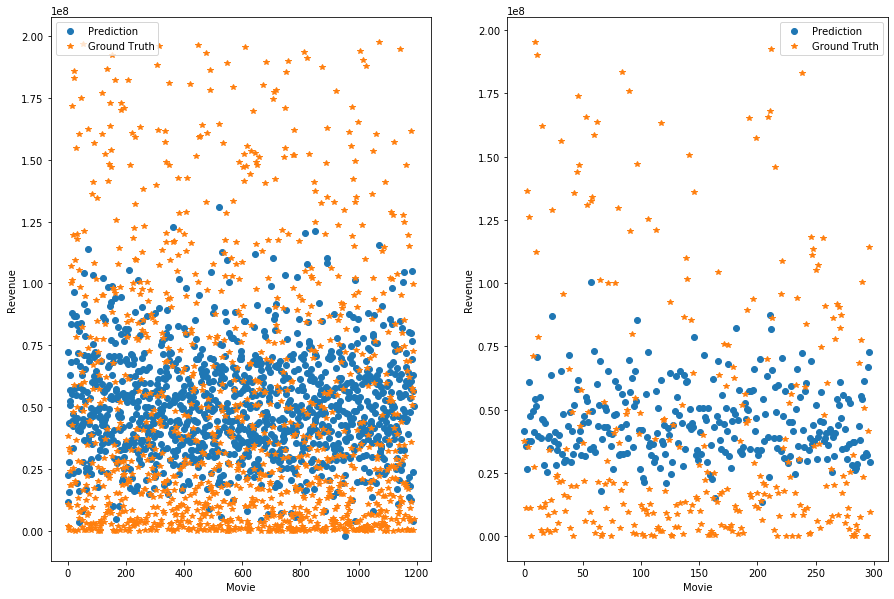

--- Epoch 1459 ---
[Epoch 1459/3000] [Batch 39/40] [Loss: 0.056977 (0.050663)]  [r2: (0.188045)] [rmse: (0.222647)], ETA: 0:35:47.360375
Testing -- [Batch 9/10] [Loss: 0.026422 (0.047438)] [r2: (0.221286)] [rmse: (0.215774)]
--- Epoch 1460 ---
[Epoch 1460/3000] [Batch 39/40] [Loss: 0.049717 (0.051567)]  [r2: (0.204242)] [rmse: (0.224896)], ETA: 0:37:03.109824
Testing -- [Batch 9/10] [Loss: 0.044931 (0.047543)] [r2: (0.232717)] [rmse: (0.216458)]
--- Epoch 1461 ---
[Epoch 1461/3000] [Batch 39/40] [Loss: 0.050895 (0.050099)]  [r2: (0.211308)] [rmse: (0.221713)], ETA: 0:36:08.421401
Testing -- [Batch 9/10] [Loss: 0.085501 (0.047803)] [r2: (0.219180)] [rmse: (0.216290)]
--- Epoch 1462 ---
[Epoch 1462/3000] [Batch 39/40] [Loss: 0.059467 (0.051743)]  [r2: (0.188051)] [rmse: (0.224118)], ETA: 0:37:30.636630
Testing -- [Batch 9/10] [Loss: 0.033461 (0.047437)] [r2: (0.214066)] [rmse: (0.216037)]
--- Epoch 1463 ---
[Epoch 1463/3000] [Batch 39/40] [Loss: 0.045211 (0.050667)]  [r2: (0.206760)] [rm

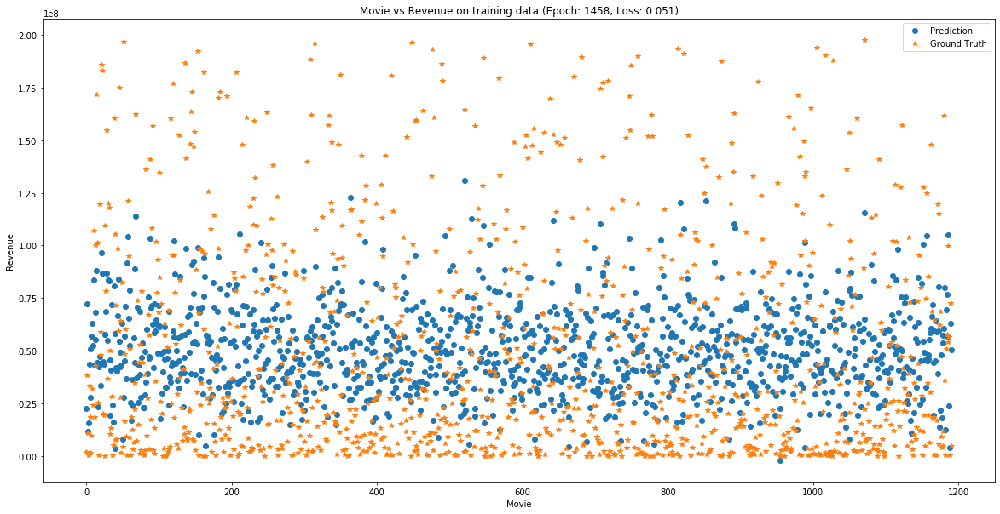

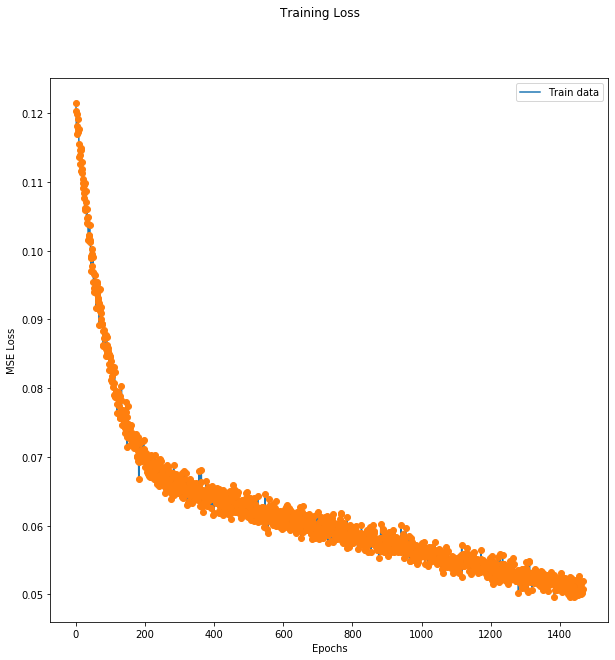

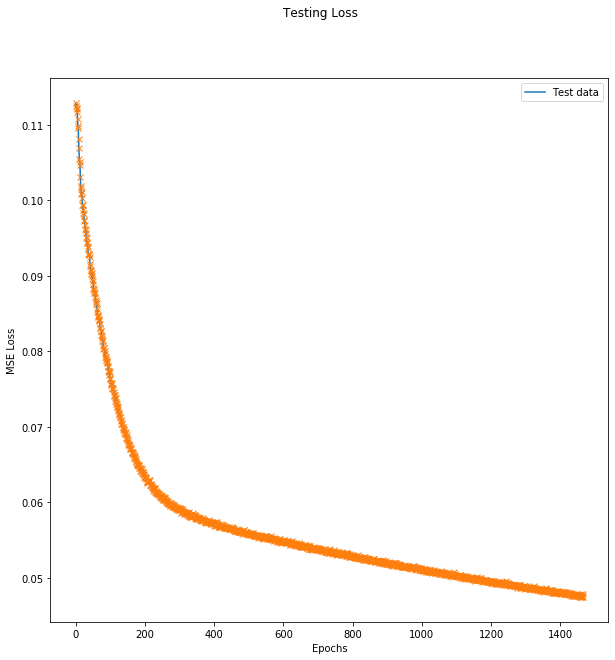

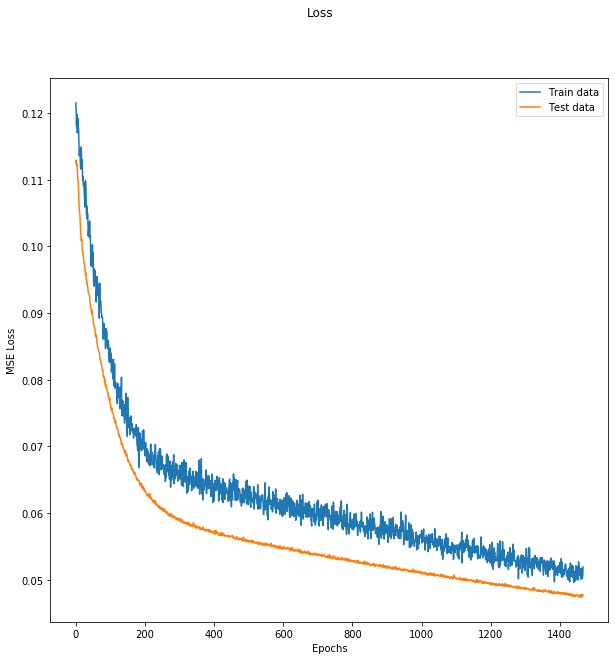

MAPE :  35.67786934408632


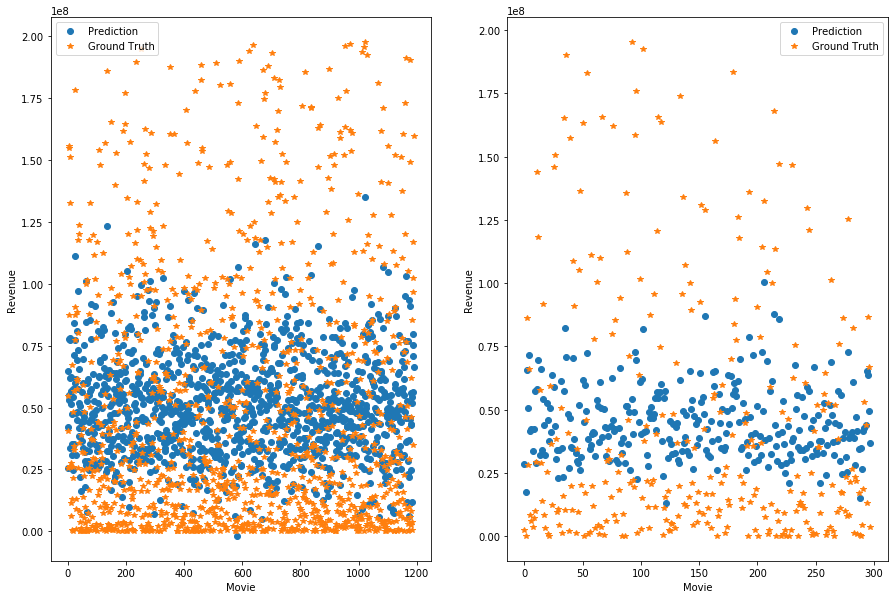

--- Epoch 1468 ---
[Epoch 1468/3000] [Batch 39/40] [Loss: 0.085633 (0.050828)]  [r2: (0.212091)] [rmse: (0.222850)], ETA: 0:34:56.760884
Testing -- [Batch 9/10] [Loss: 0.064913 (0.047627)] [r2: (0.245324)] [rmse: (0.216895)]
--- Epoch 1469 ---
[Epoch 1469/3000] [Batch 39/40] [Loss: 0.048585 (0.051821)]  [r2: (0.192716)] [rmse: (0.225614)], ETA: 0:35:01.286318
Testing -- [Batch 9/10] [Loss: 0.053312 (0.047544)] [r2: (0.201901)] [rmse: (0.214945)]
--- Epoch 1470 ---
[Epoch 1470/3000] [Batch 39/40] [Loss: 0.050952 (0.050213)]  [r2: (0.218687)] [rmse: (0.221943)], ETA: 0:35:48.704051
Testing -- [Batch 9/10] [Loss: 0.029181 (0.047383)] [r2: (0.198210)] [rmse: (0.213957)]
--- Epoch 1471 ---
[Epoch 1471/3000] [Batch 39/40] [Loss: 0.067769 (0.051049)]  [r2: (0.209824)] [rmse: (0.223842)], ETA: 0:34:58.437577
Testing -- [Batch 9/10] [Loss: 0.028746 (0.047380)] [r2: (0.238439)] [rmse: (0.216428)]
--- Epoch 1472 ---
[Epoch 1472/3000] [Batch 39/40] [Loss: 0.043984 (0.050450)]  [r2: (0.209295)] [rm

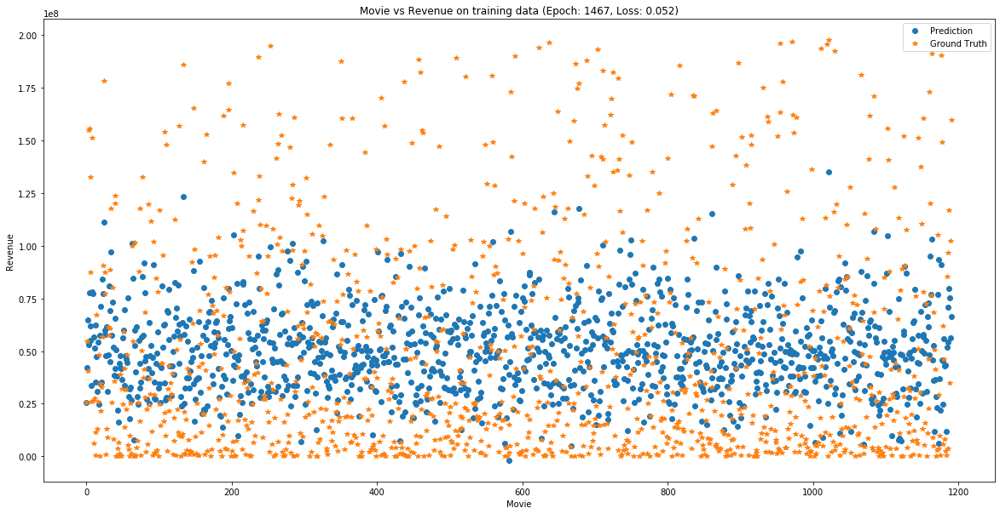

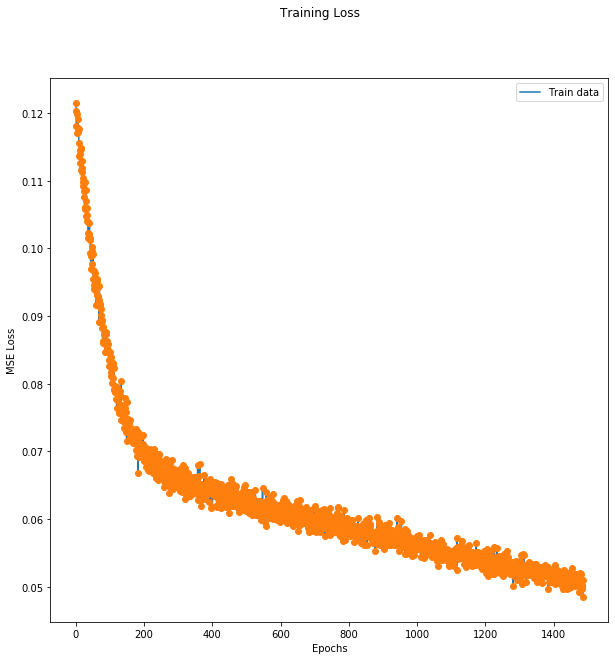

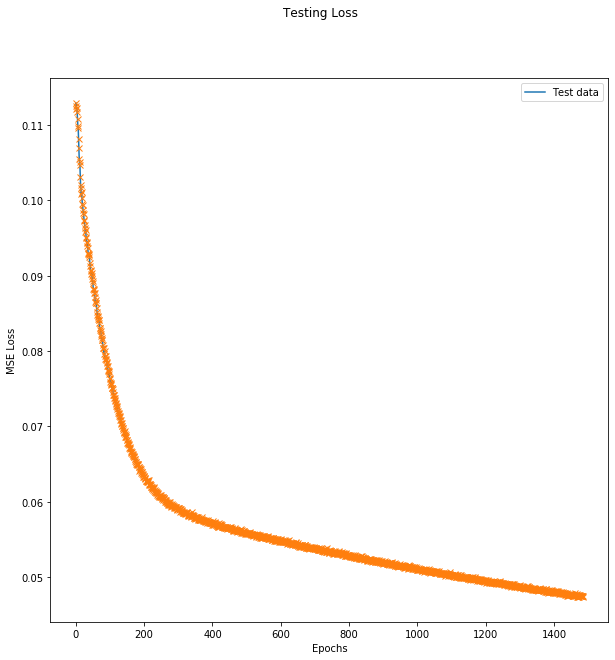

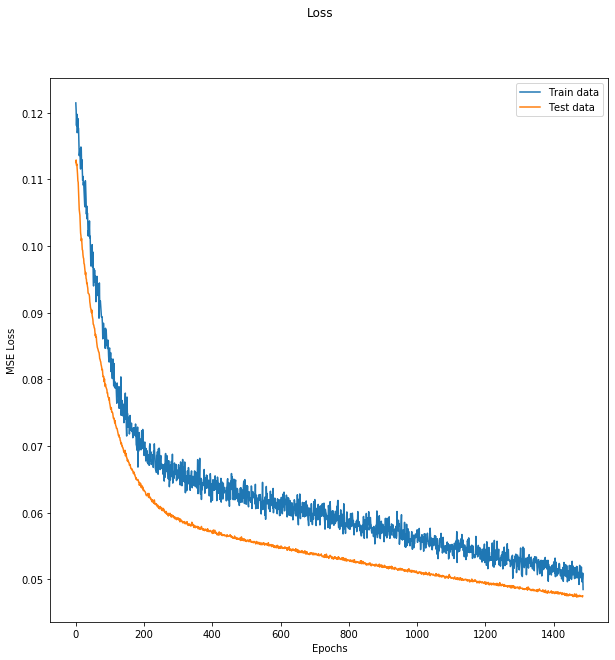

MAPE :  35.76821016062805


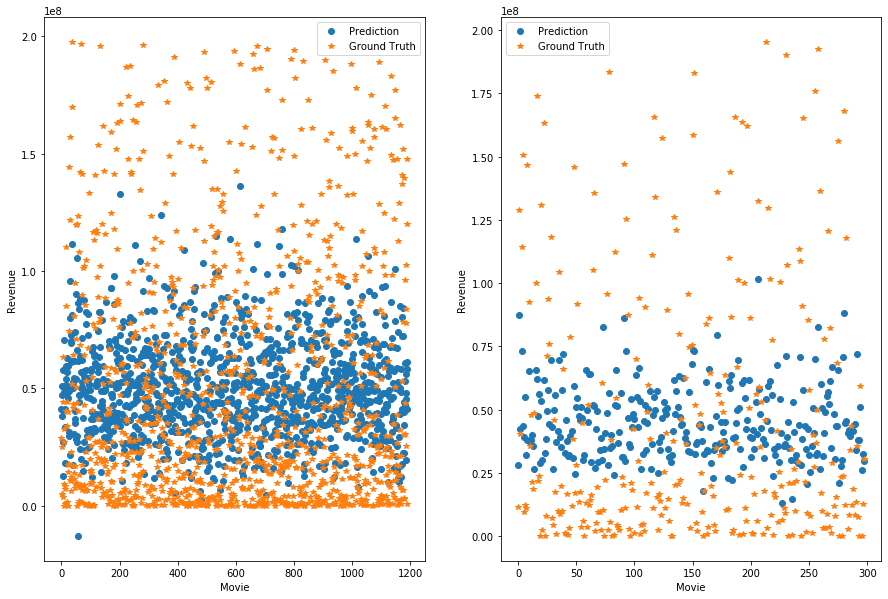

--- Epoch 1487 ---
[Epoch 1487/3000] [Batch 39/40] [Loss: 0.047049 (0.049808)]  [r2: (0.233759)] [rmse: (0.220710)], ETA: 0:34:14.388063
Testing -- [Batch 9/10] [Loss: 0.044877 (0.047351)] [r2: (0.230698)] [rmse: (0.216267)]
--- Epoch 1488 ---
[Epoch 1488/3000] [Batch 39/40] [Loss: 0.044518 (0.051669)]  [r2: (0.192082)] [rmse: (0.225088)], ETA: 0:34:33.491929
Testing -- [Batch 9/10] [Loss: 0.028162 (0.047250)] [r2: (0.186900)] [rmse: (0.214523)]
Train R2 =  0.23325500227119234
Test R2 =  0.2552275583372814


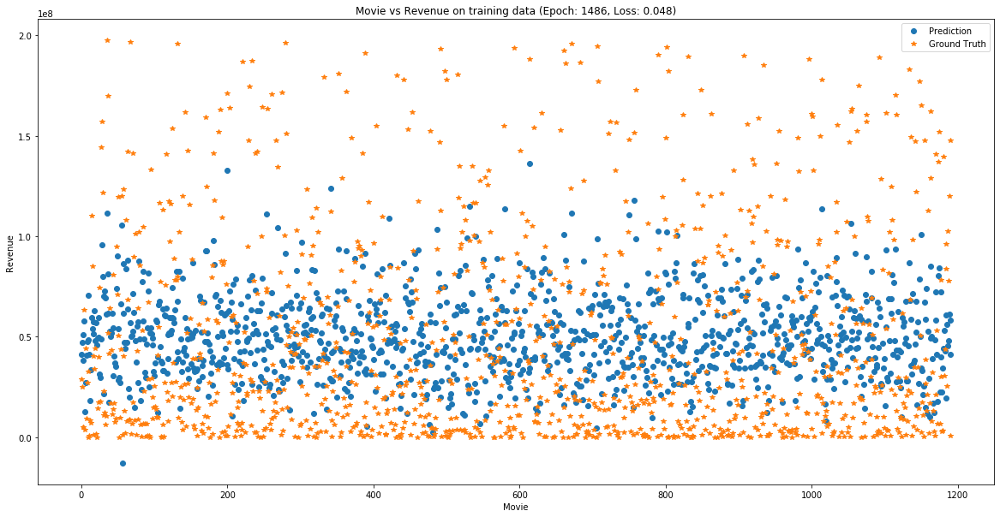

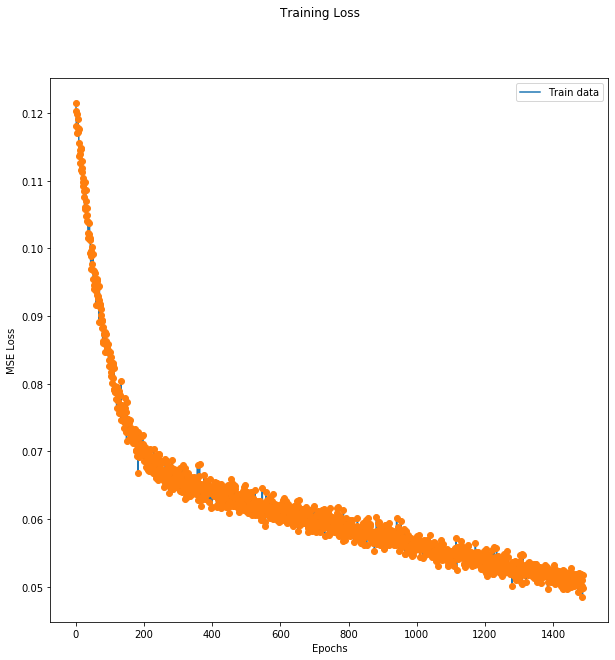

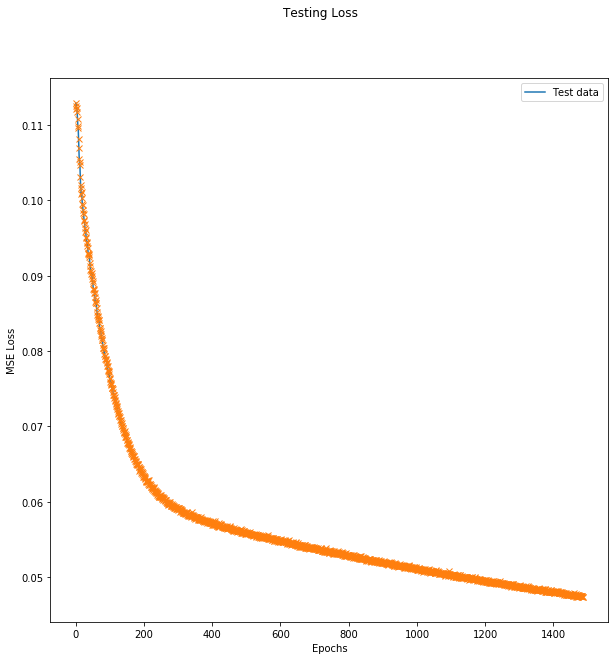

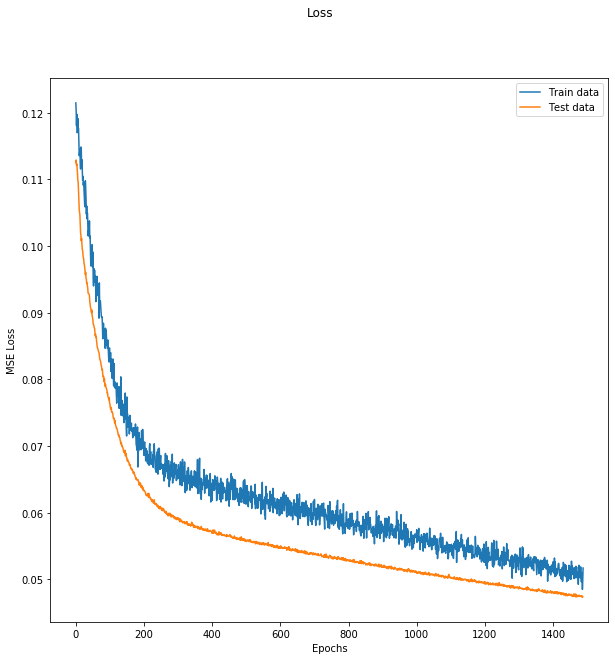

MAPE :  35.60791833673159


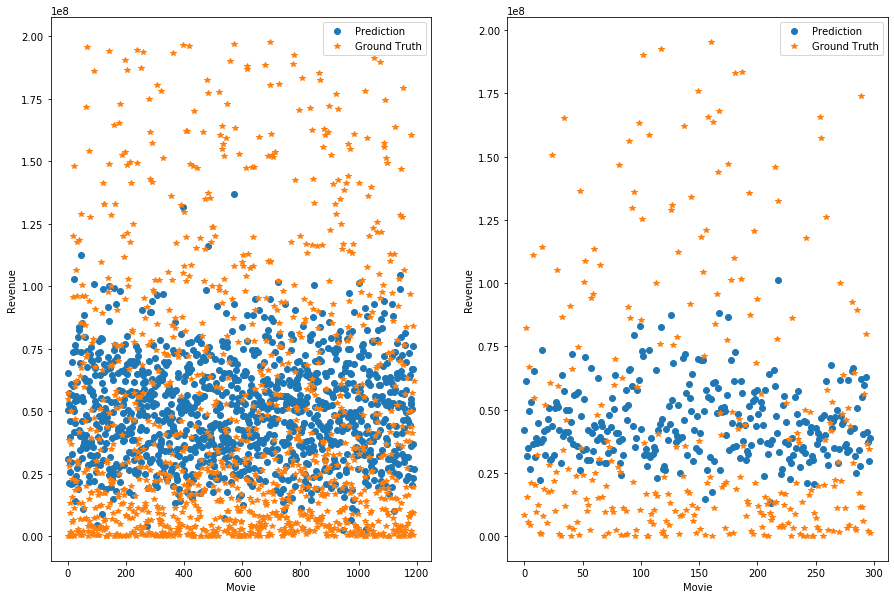

--- Epoch 1489 ---
[Epoch 1489/3000] [Batch 39/40] [Loss: 0.064786 (0.051975)]  [r2: (0.199673)] [rmse: (0.226178)], ETA: 0:34:22.168789
Testing -- [Batch 9/10] [Loss: 0.050577 (0.047387)] [r2: (0.227560)] [rmse: (0.214938)]
--- Epoch 1490 ---
[Epoch 1490/3000] [Batch 39/40] [Loss: 0.039816 (0.051098)]  [r2: (0.201647)] [rmse: (0.223532)], ETA: 0:34:14.413451
Testing -- [Batch 9/10] [Loss: 0.031221 (0.047258)] [r2: (0.190293)] [rmse: (0.216149)]
--- Epoch 1491 ---
[Epoch 1491/3000] [Batch 39/40] [Loss: 0.036417 (0.049786)]  [r2: (0.236053)] [rmse: (0.221594)], ETA: 0:34:41.225680
Testing -- [Batch 9/10] [Loss: 0.062345 (0.047463)] [r2: (0.236311)] [rmse: (0.215587)]
--- Epoch 1492 ---
[Epoch 1492/3000] [Batch 39/40] [Loss: 0.049296 (0.050667)]  [r2: (0.194317)] [rmse: (0.222595)], ETA: 0:34:33.119432
Testing -- [Batch 9/10] [Loss: 0.052035 (0.047373)] [r2: (0.236781)] [rmse: (0.214604)]
--- Epoch 1493 ---
[Epoch 1493/3000] [Batch 39/40] [Loss: 0.048344 (0.050873)]  [r2: (0.205152)] [rm

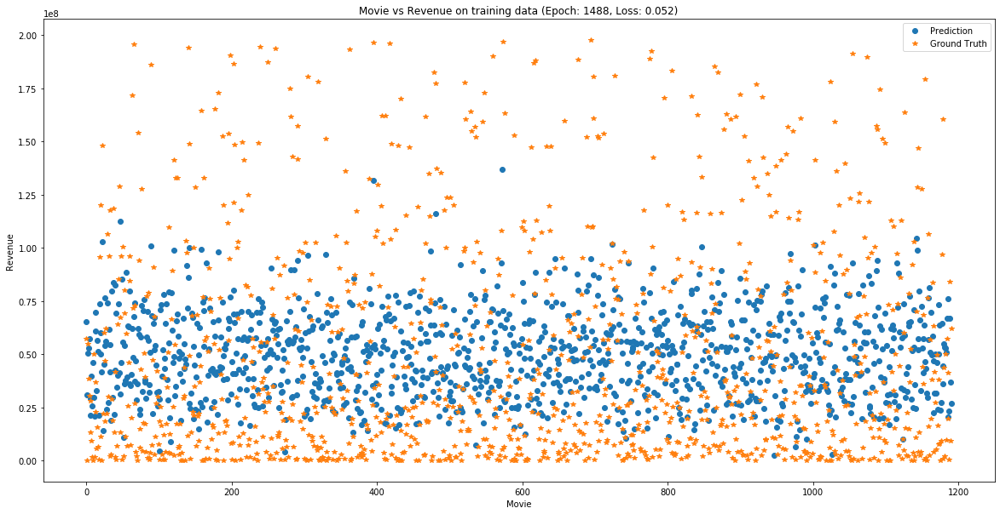

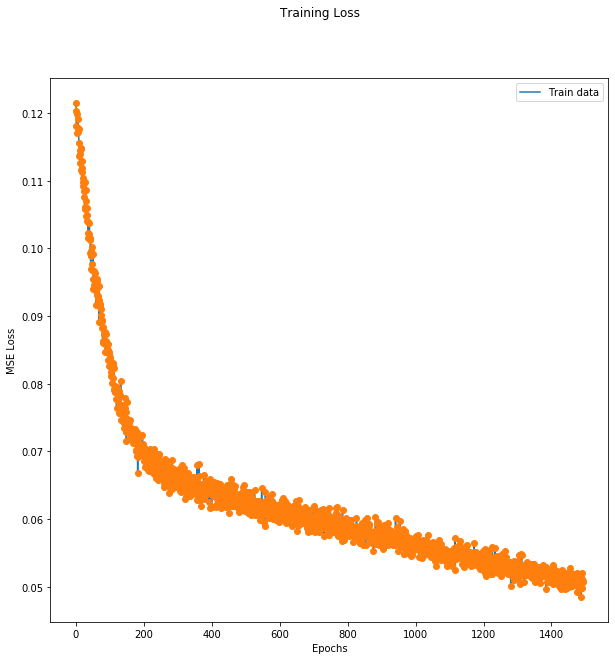

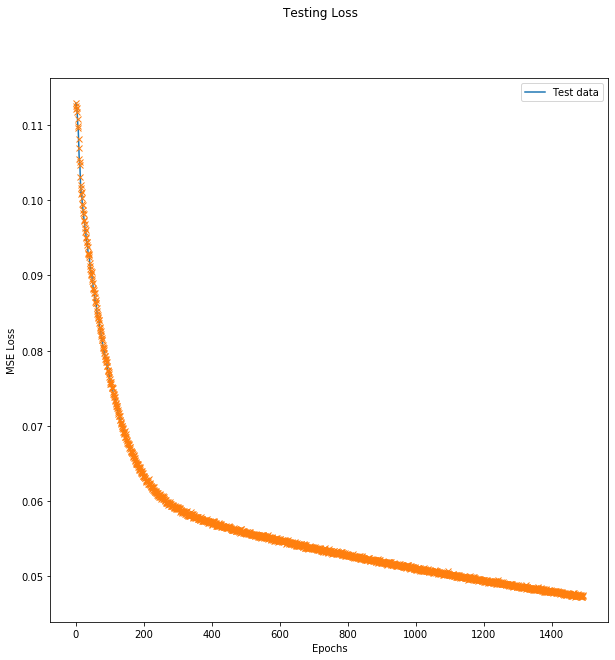

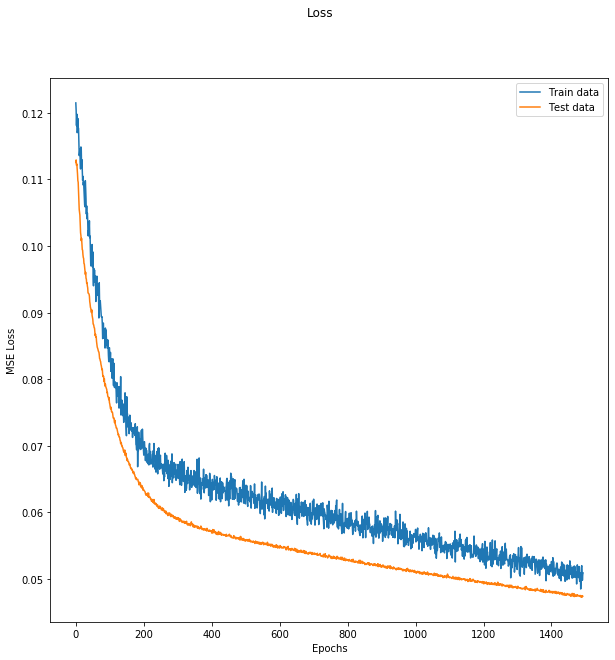

MAPE :  35.59211358958885


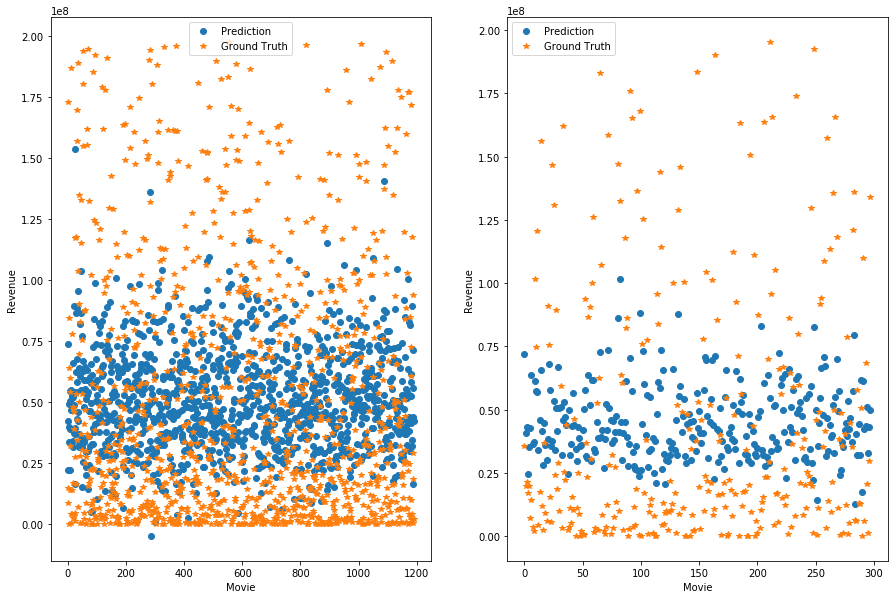

--- Epoch 1494 ---
[Epoch 1494/3000] [Batch 39/40] [Loss: 0.068137 (0.050745)]  [r2: (0.216272)] [rmse: (0.222532)], ETA: 0:35:54.577425
Testing -- [Batch 9/10] [Loss: 0.038765 (0.047260)] [r2: (0.249498)] [rmse: (0.214244)]
--- Epoch 1495 ---
[Epoch 1495/3000] [Batch 39/40] [Loss: 0.070022 (0.049236)]  [r2: (0.243263)] [rmse: (0.219149)], ETA: 0:36:43.018186
Testing -- [Batch 9/10] [Loss: 0.034979 (0.047224)] [r2: (0.209799)] [rmse: (0.215261)]
Train R2 =  0.27245219431799905
Test R2 =  0.2563563455552462


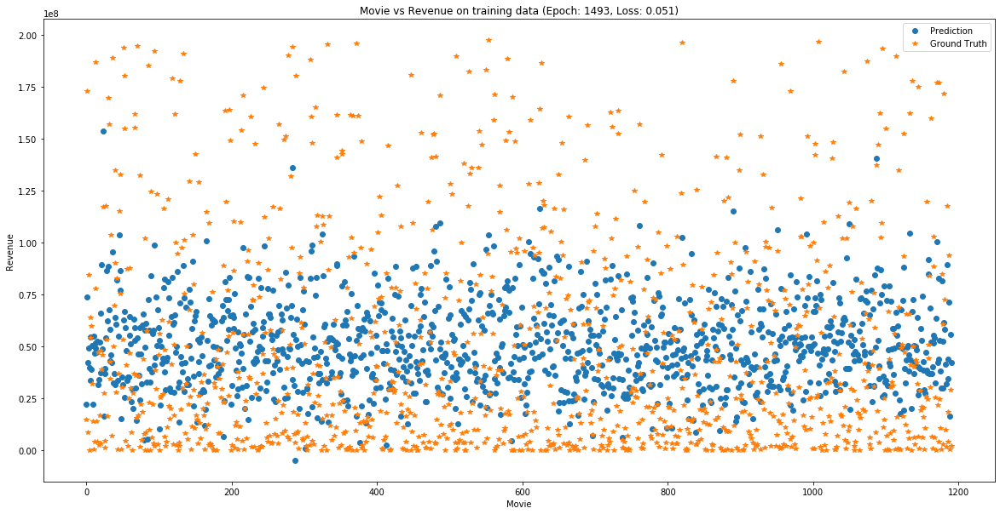

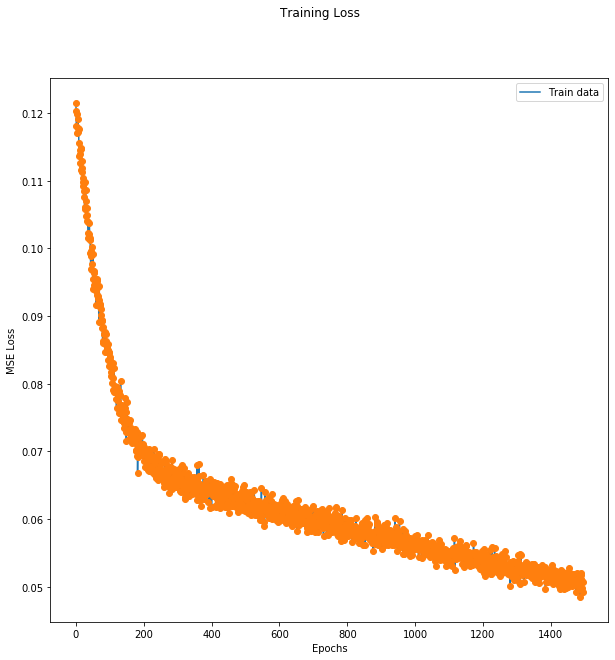

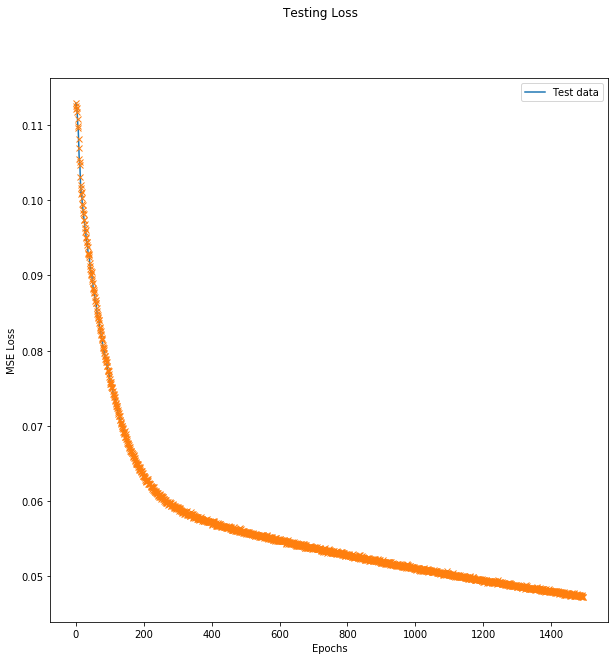

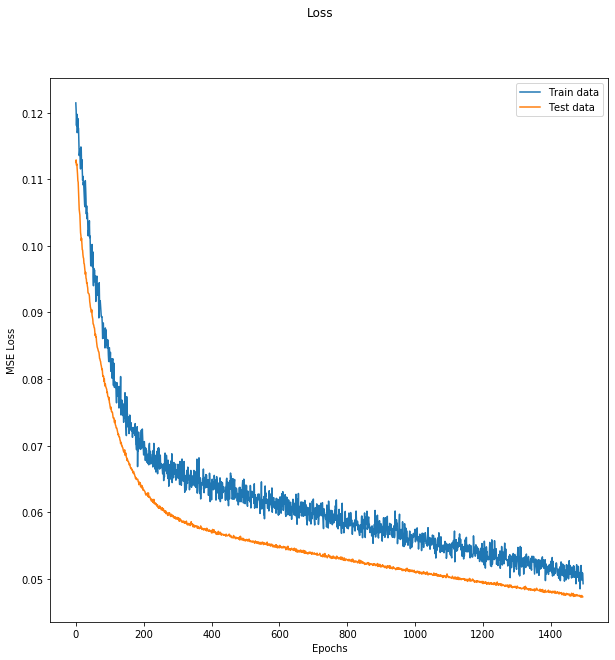

MAPE :  35.66413187362998


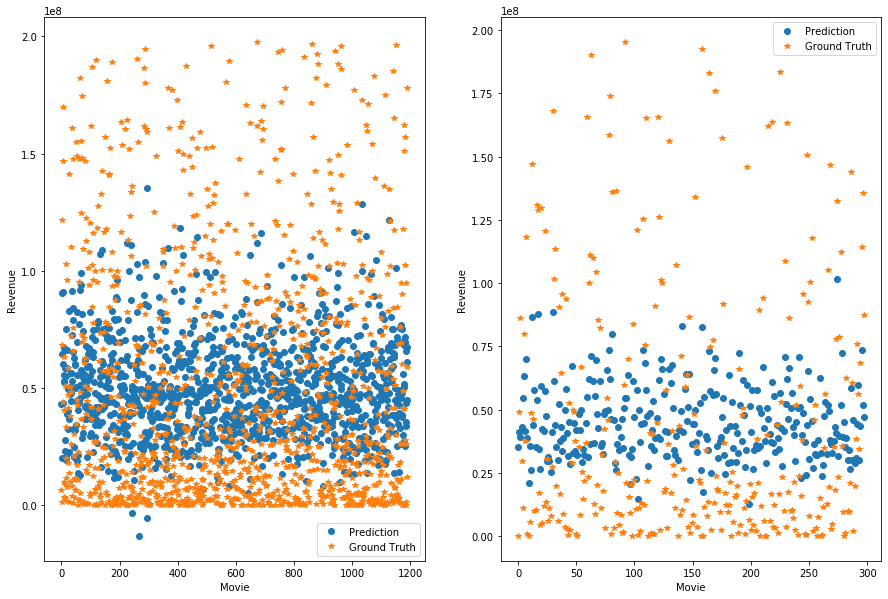

--- Epoch 1496 ---
[Epoch 1496/3000] [Batch 39/40] [Loss: 0.074107 (0.052557)]  [r2: (0.192397)] [rmse: (0.227666)], ETA: 0:35:00.226650
Testing -- [Batch 9/10] [Loss: 0.038484 (0.047270)] [r2: (0.207058)] [rmse: (0.215796)]
--- Epoch 1497 ---
[Epoch 1497/3000] [Batch 39/40] [Loss: 0.072578 (0.050814)]  [r2: (0.212827)] [rmse: (0.222914)], ETA: 0:34:23.376361
Testing -- [Batch 9/10] [Loss: 0.028206 (0.047177)] [r2: (0.237986)] [rmse: (0.213587)]
Train R2 =  0.2491628622080625
Test R2 =  0.256383823383435


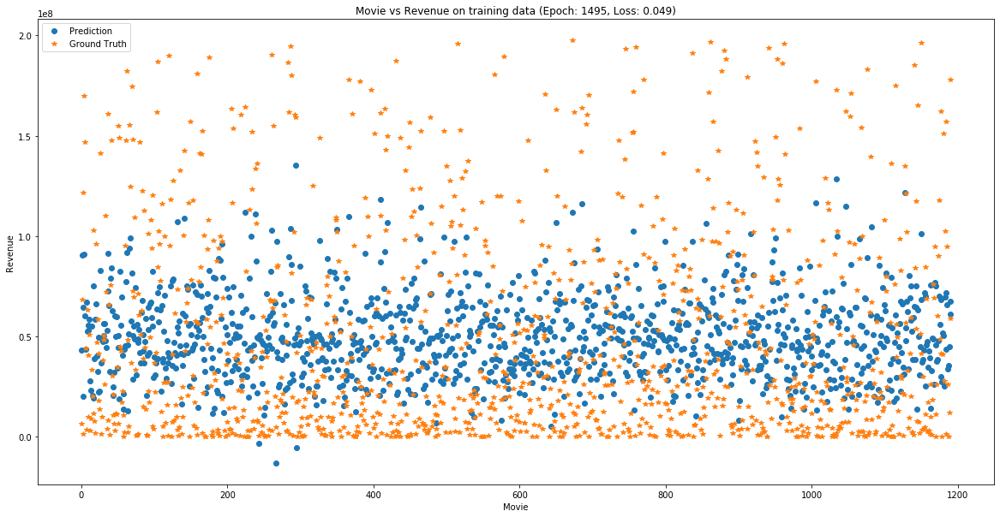

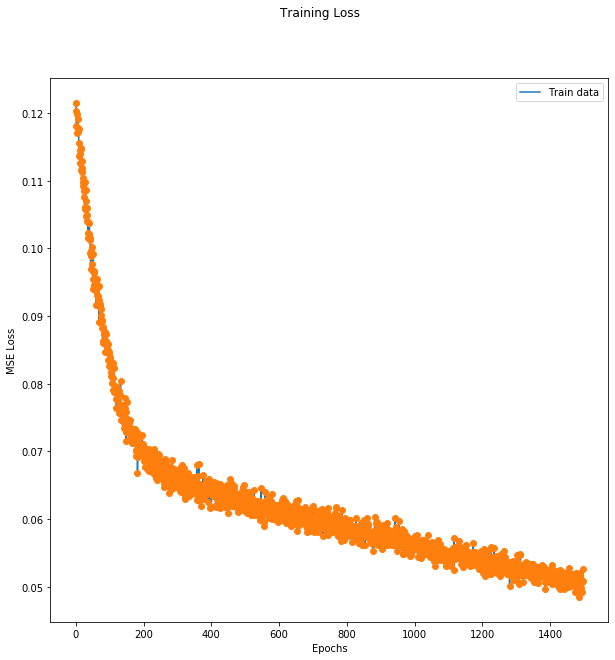

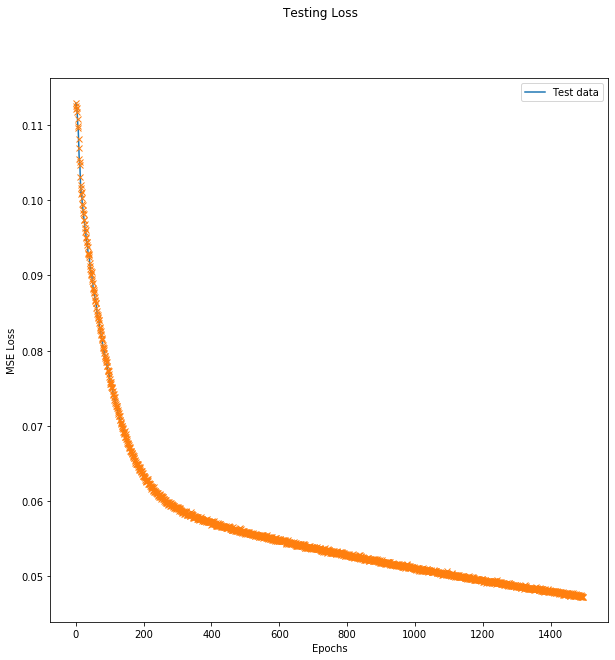

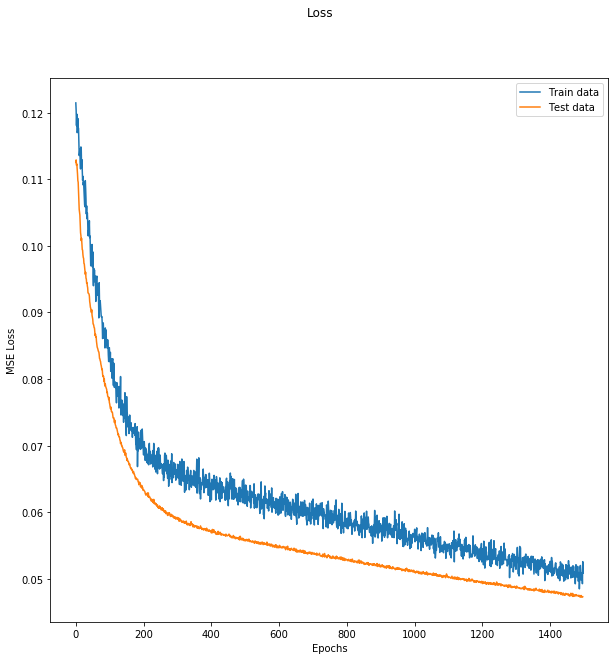

MAPE :  35.533856598779764


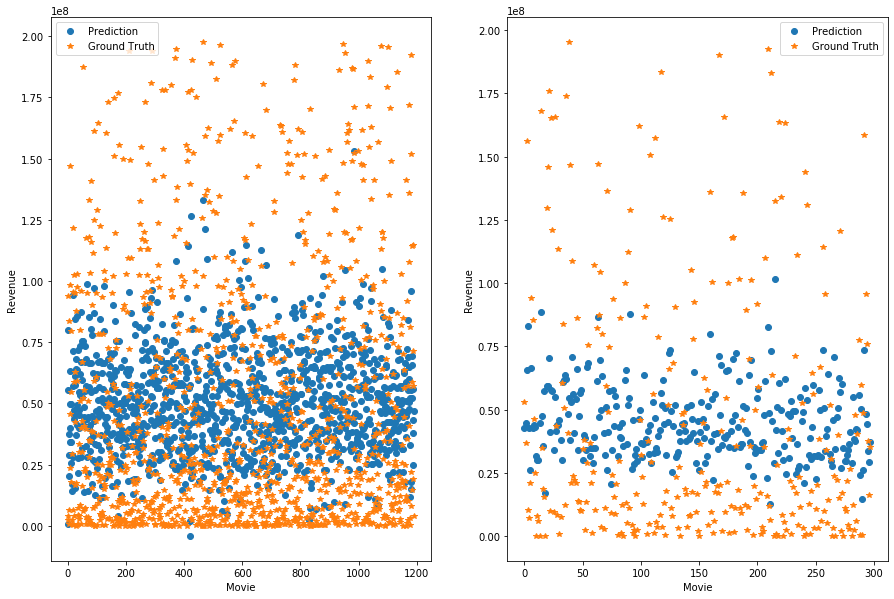

--- Epoch 1498 ---
[Epoch 1498/3000] [Batch 39/40] [Loss: 0.048009 (0.050416)]  [r2: (0.197836)] [rmse: (0.221805)], ETA: 0:34:20.070122
Testing -- [Batch 9/10] [Loss: 0.024971 (0.047164)] [r2: (0.157587)] [rmse: (0.212495)]
Train R2 =  0.2523521284610095
Test R2 =  0.25625360521299867


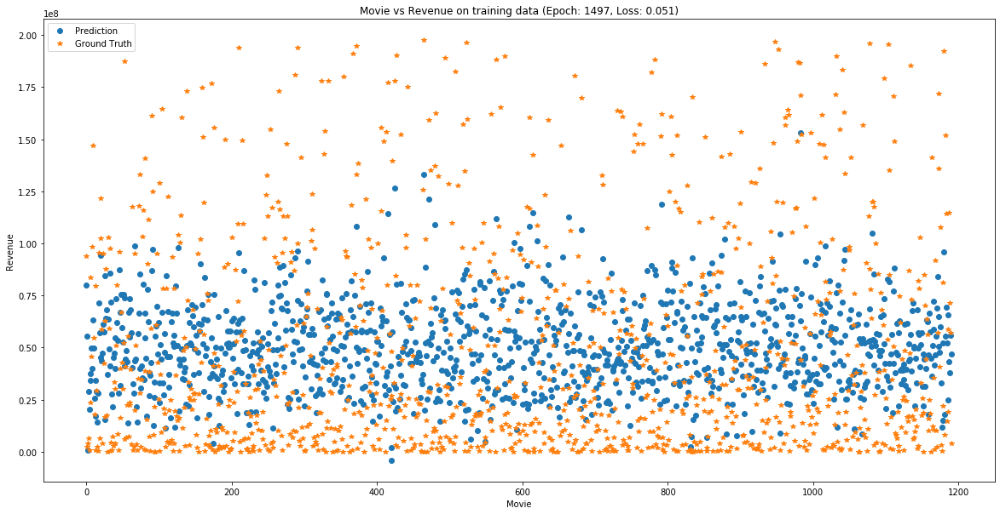

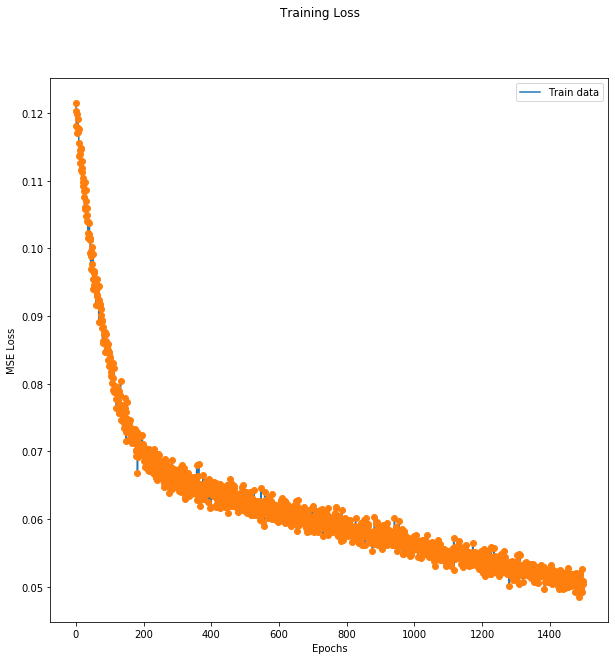

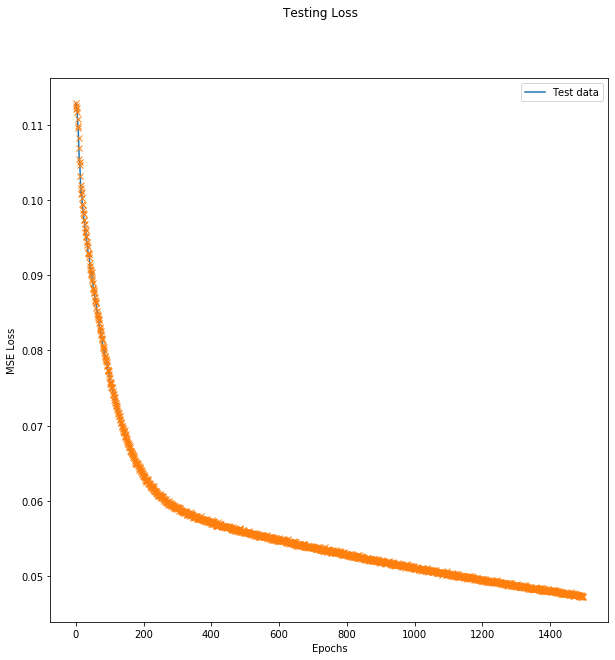

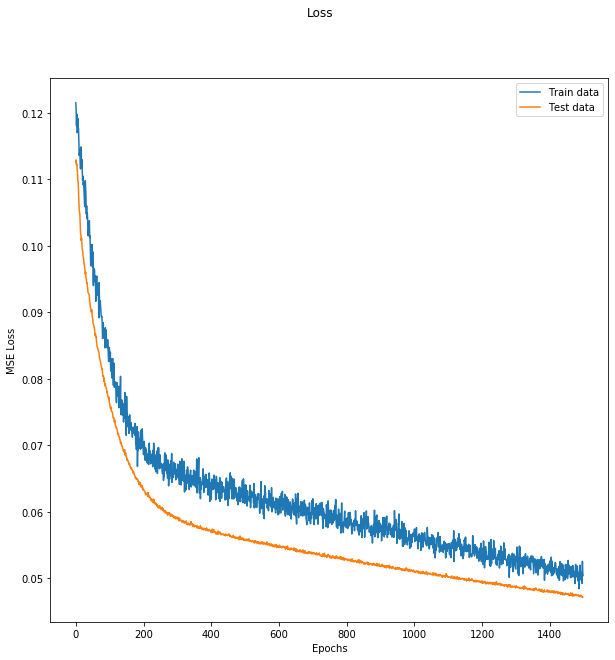

MAPE :  35.674791649777106


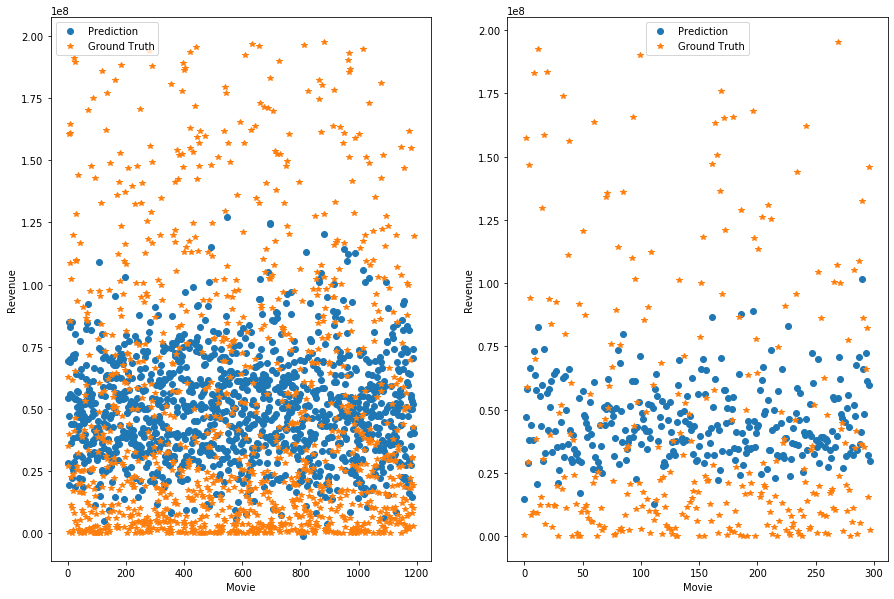

--- Epoch 1499 ---
[Epoch 1499/3000] [Batch 39/40] [Loss: 0.042364 (0.050281)]  [r2: (0.204008)] [rmse: (0.221885)], ETA: 0:34:02.189302
Testing -- [Batch 9/10] [Loss: 0.018508 (0.047097)] [r2: (0.238670)] [rmse: (0.213123)]
Train R2 =  0.25374783800841827
Test R2 =  0.2566333400671137


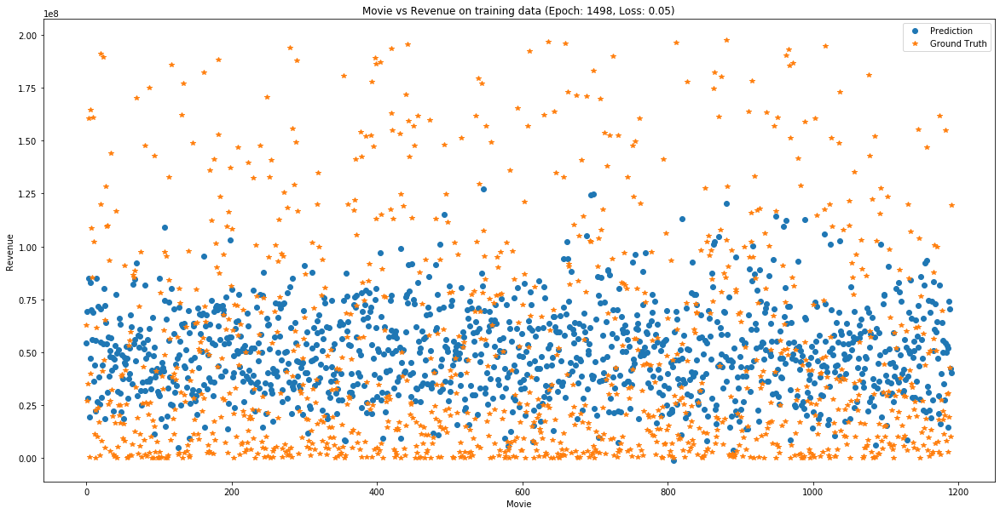

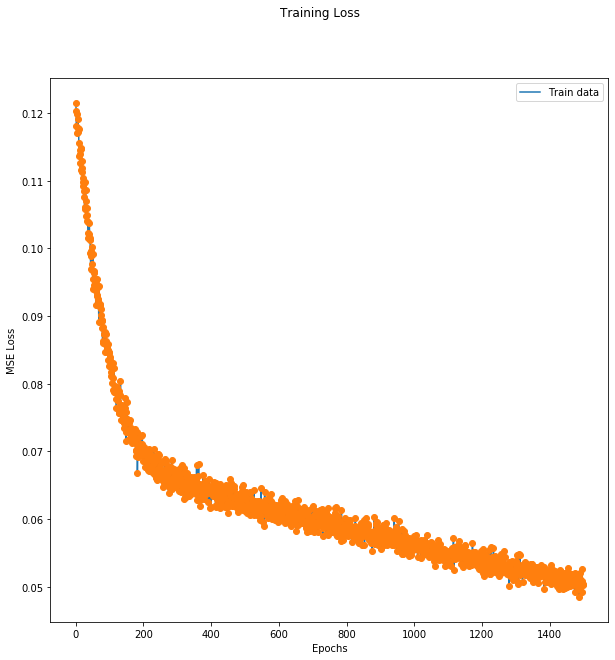

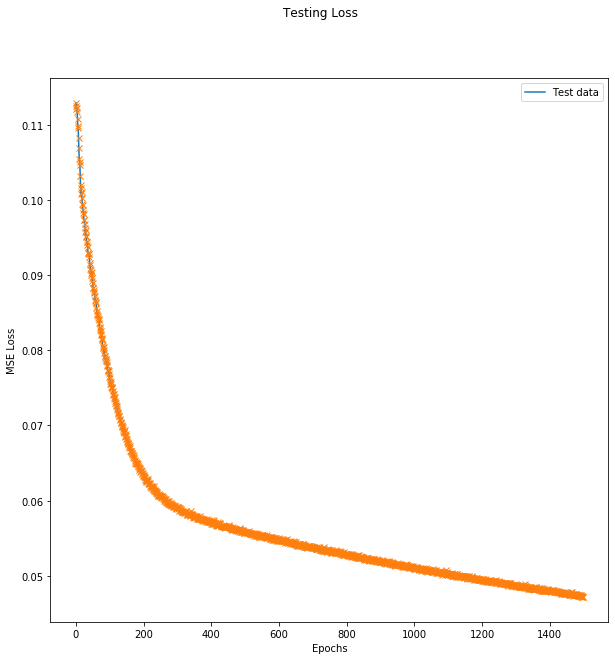

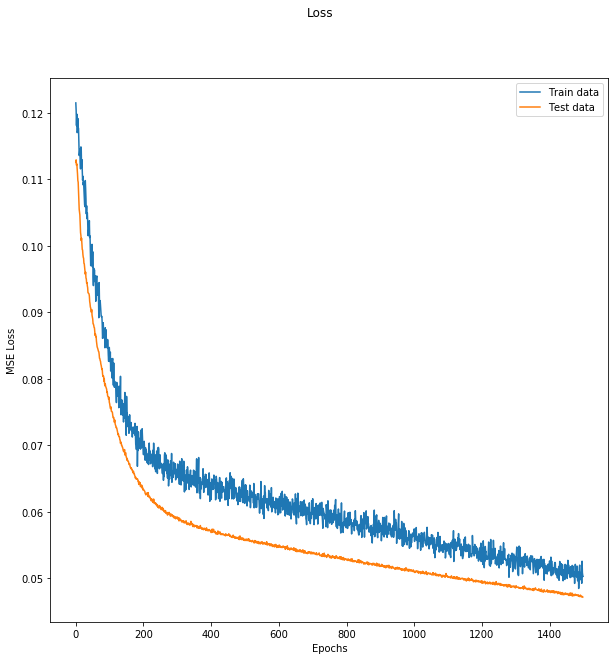

MAPE :  35.48100417637178


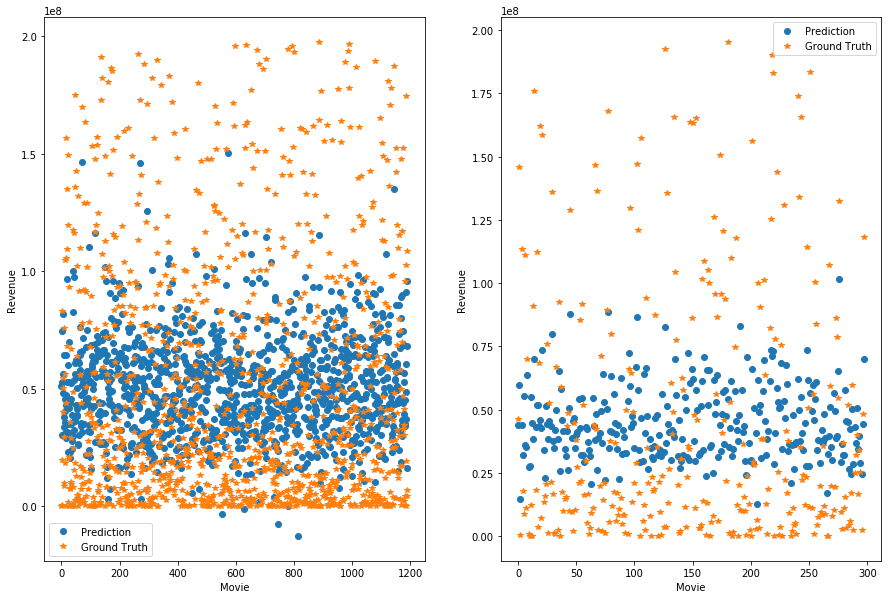

--- Epoch 1500 ---
[Epoch 1500/3000] [Batch 39/40] [Loss: 0.050144 (0.052240)]  [r2: (0.185851)] [rmse: (0.226286)], ETA: 0:34:16.367417
Testing -- [Batch 9/10] [Loss: 0.039839 (0.047234)] [r2: (0.242672)] [rmse: (0.214650)]
--- Epoch 1501 ---
[Epoch 1501/3000] [Batch 39/40] [Loss: 0.067712 (0.051308)]  [r2: (0.199884)] [rmse: (0.224059)], ETA: 0:35:52.428041
Testing -- [Batch 9/10] [Loss: 0.069683 (0.047440)] [r2: (0.204321)] [rmse: (0.214906)]
--- Epoch 1502 ---
[Epoch 1502/3000] [Batch 39/40] [Loss: 0.043694 (0.049878)]  [r2: (0.213480)] [rmse: (0.221496)], ETA: 0:36:34.892182
Testing -- [Batch 9/10] [Loss: 0.069725 (0.047414)] [r2: (0.235910)] [rmse: (0.211712)]
--- Epoch 1503 ---
[Epoch 1503/3000] [Batch 39/40] [Loss: 0.080697 (0.052311)]  [r2: (0.161436)] [rmse: (0.226488)], ETA: 0:34:10.639813
Testing -- [Batch 9/10] [Loss: 0.068340 (0.047408)] [r2: (0.226155)] [rmse: (0.215683)]
--- Epoch 1504 ---
[Epoch 1504/3000] [Batch 39/40] [Loss: 0.036432 (0.050737)]  [r2: (0.213731)] [rm

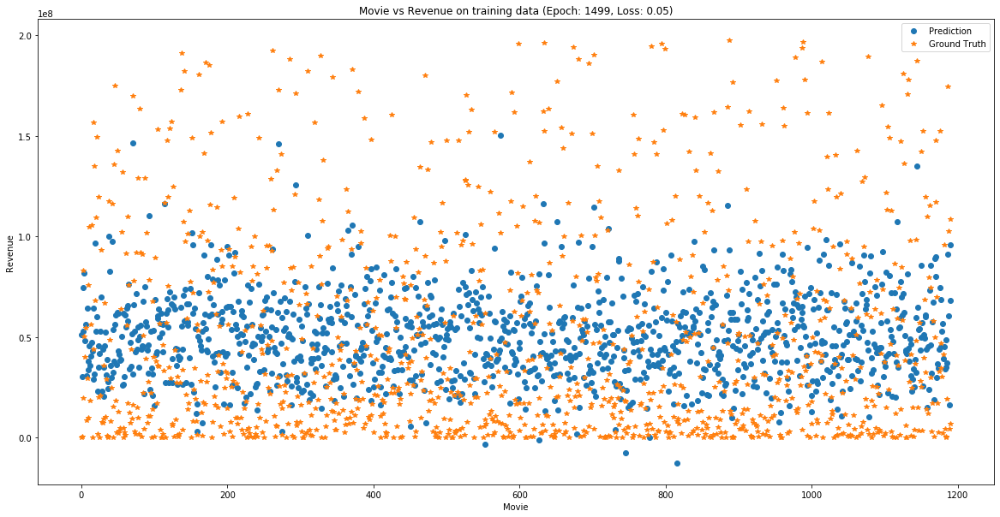

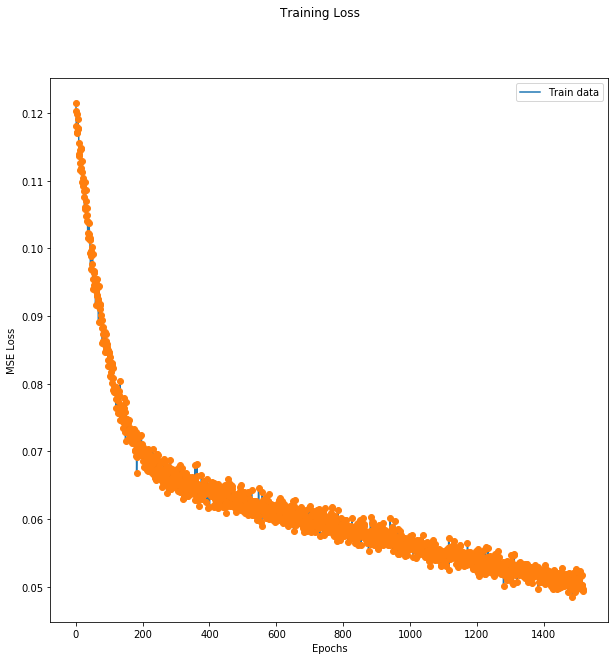

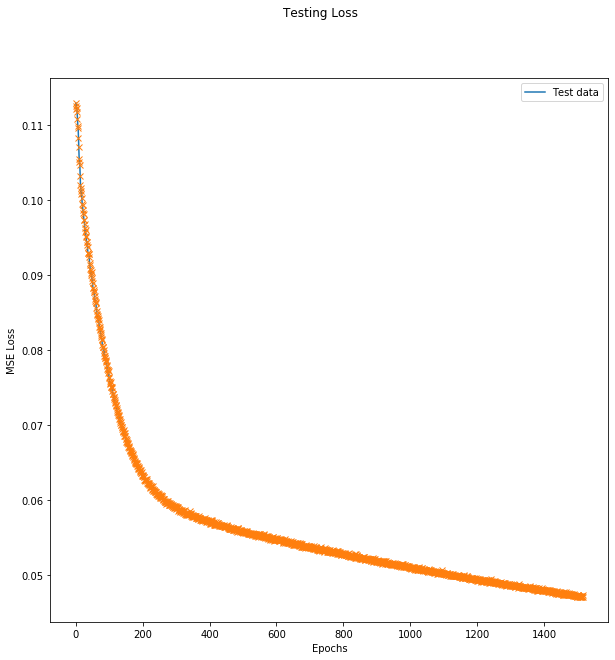

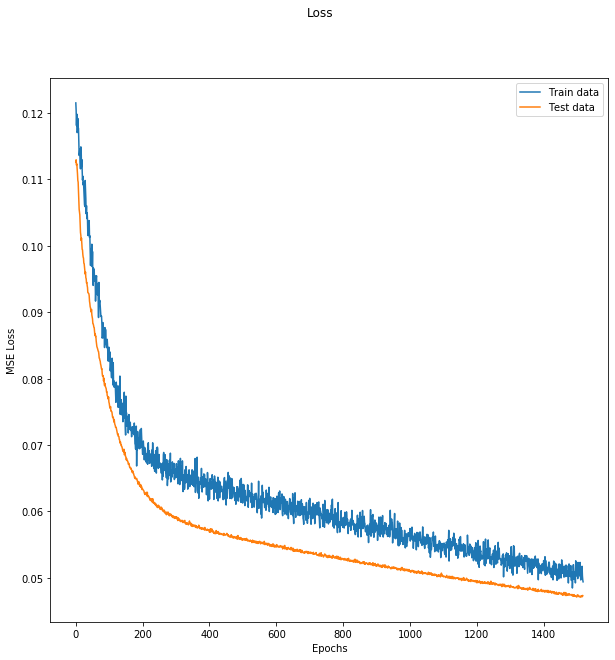

MAPE :  35.28671307454223


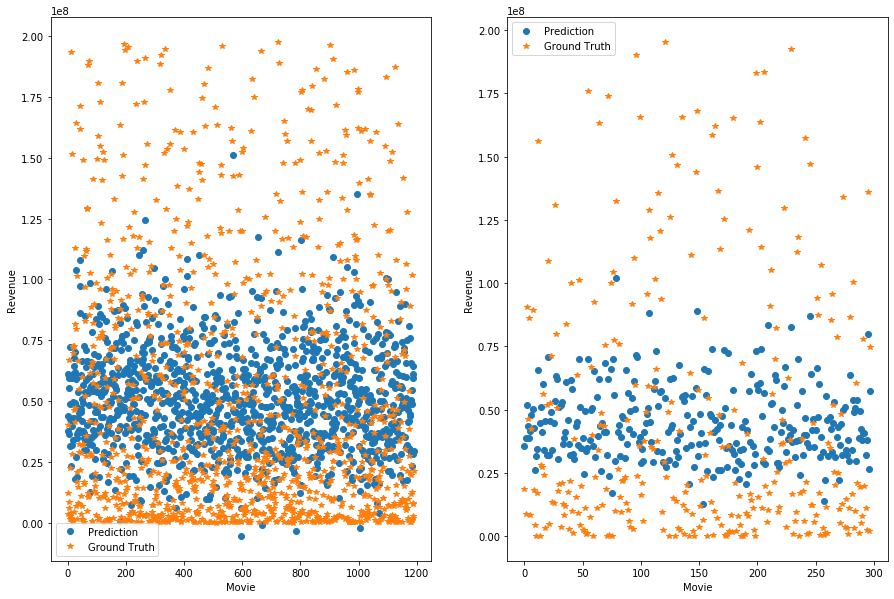

--- Epoch 1519 ---
[Epoch 1519/3000] [Batch 39/40] [Loss: 0.068068 (0.050163)]  [r2: (0.221126)] [rmse: (0.220799)], ETA: 0:33:59.590574
Testing -- [Batch 9/10] [Loss: 0.037096 (0.047115)] [r2: (0.215998)] [rmse: (0.214981)]
--- Epoch 1520 ---
[Epoch 1520/3000] [Batch 39/40] [Loss: 0.050838 (0.050692)]  [r2: (0.203059)] [rmse: (0.222901)], ETA: 0:38:14.558248
Testing -- [Batch 9/10] [Loss: 0.042462 (0.047154)] [r2: (0.241946)] [rmse: (0.215660)]
--- Epoch 1521 ---
[Epoch 1521/3000] [Batch 39/40] [Loss: 0.052638 (0.049768)]  [r2: (0.244443)] [rmse: (0.220619)], ETA: 0:36:15.252667
Testing -- [Batch 9/10] [Loss: 0.027435 (0.047053)] [r2: (0.226653)] [rmse: (0.215425)]
Train R2 =  0.26256004433710645
Test R2 =  0.25826670400465523


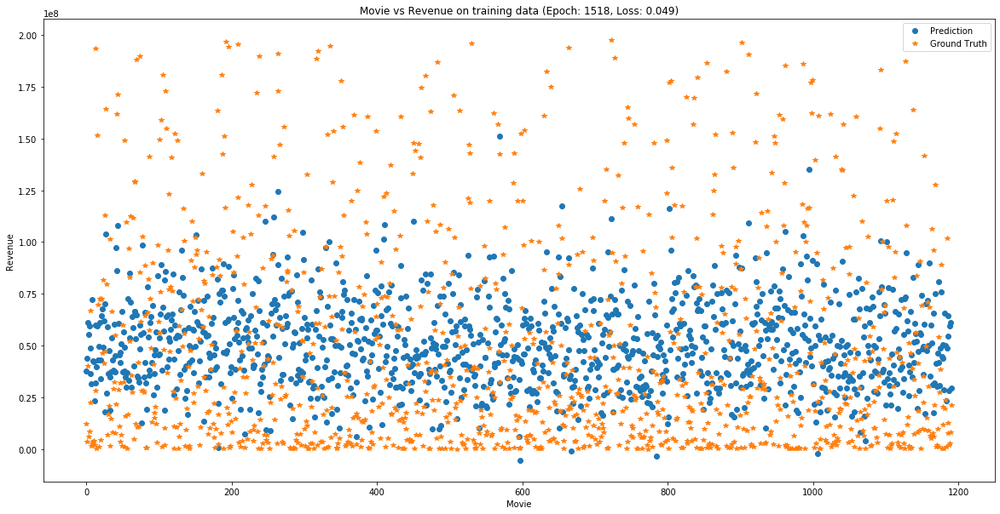

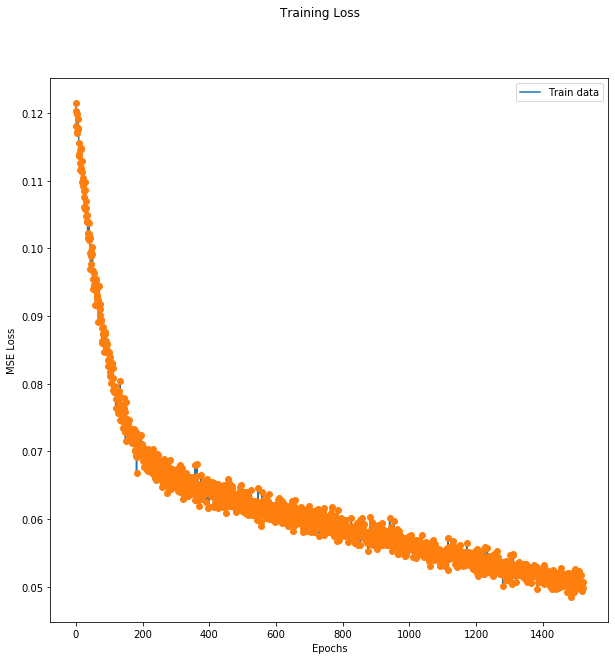

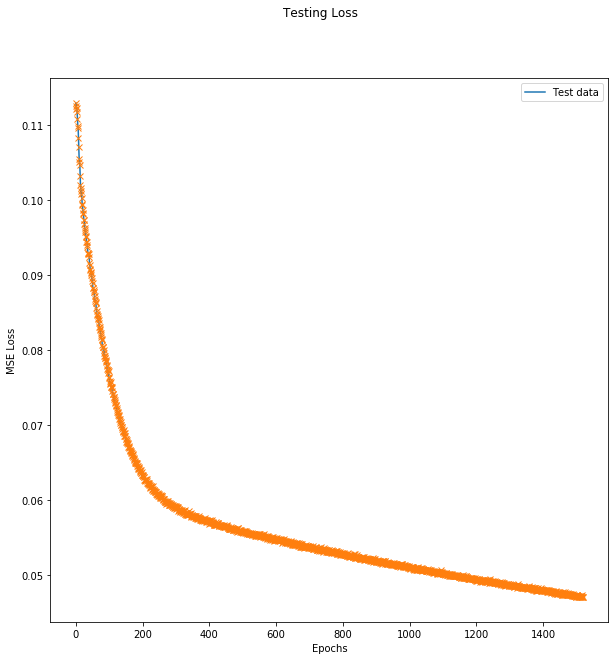

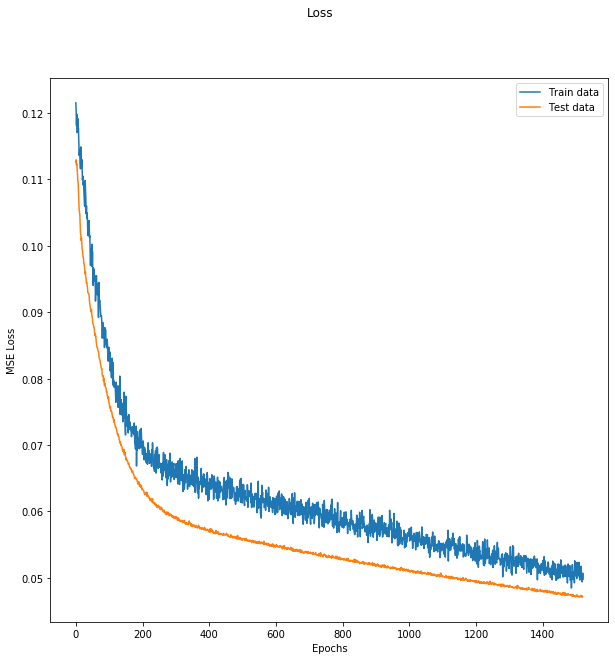

MAPE :  35.35545975584252


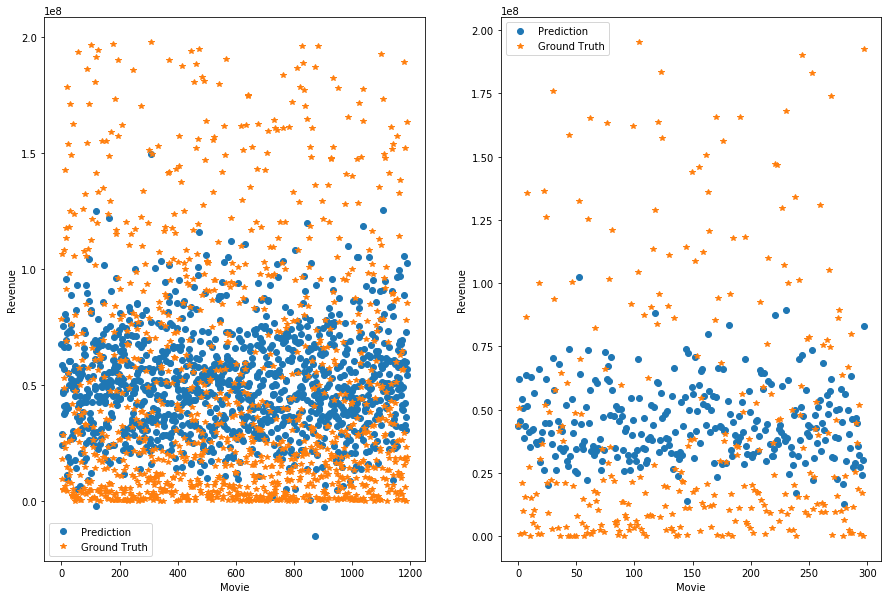

--- Epoch 1522 ---
[Epoch 1522/3000] [Batch 39/40] [Loss: 0.044890 (0.049279)]  [r2: (0.212554)] [rmse: (0.220079)], ETA: 0:37:26.126675
Testing -- [Batch 9/10] [Loss: 0.024328 (0.047036)] [r2: (0.219044)] [rmse: (0.215046)]
Train R2 =  0.26899061029418003
Test R2 =  0.25821406873405683


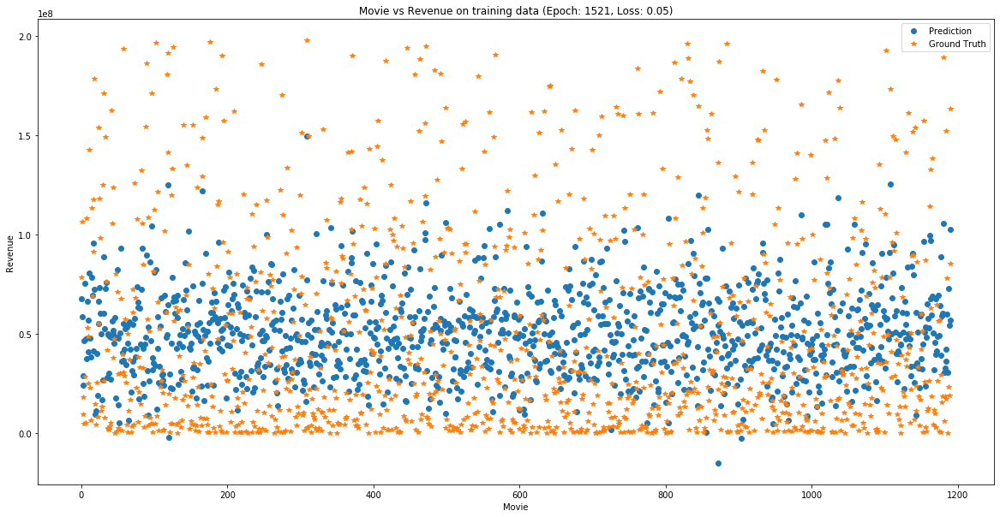

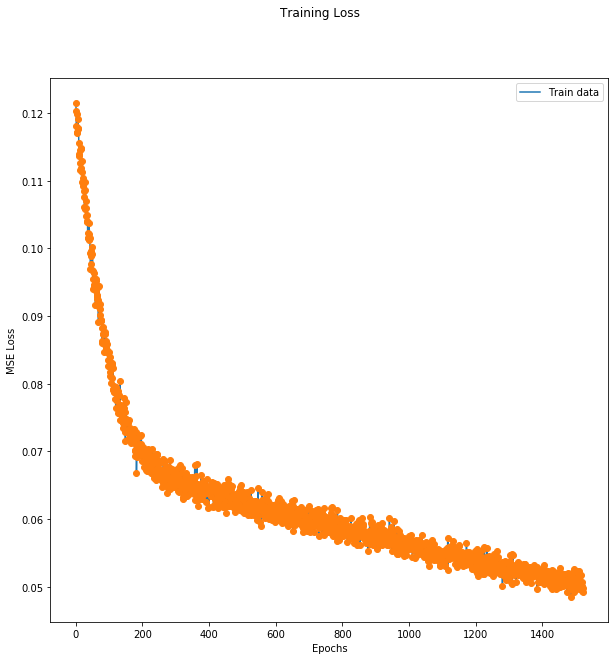

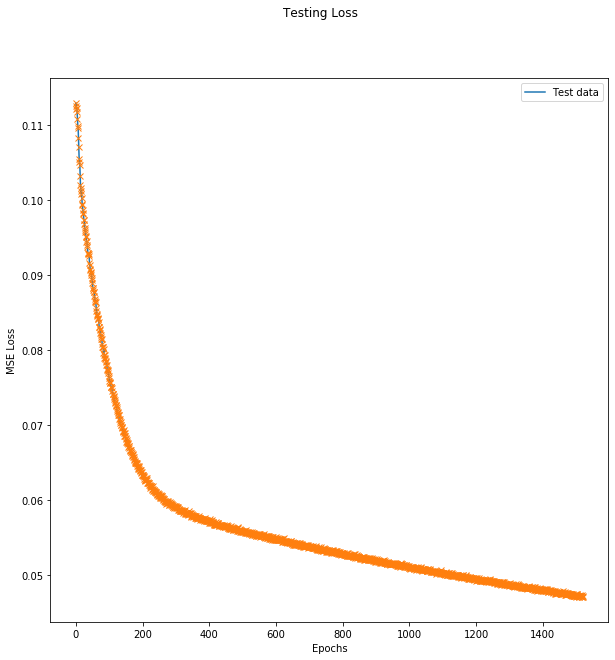

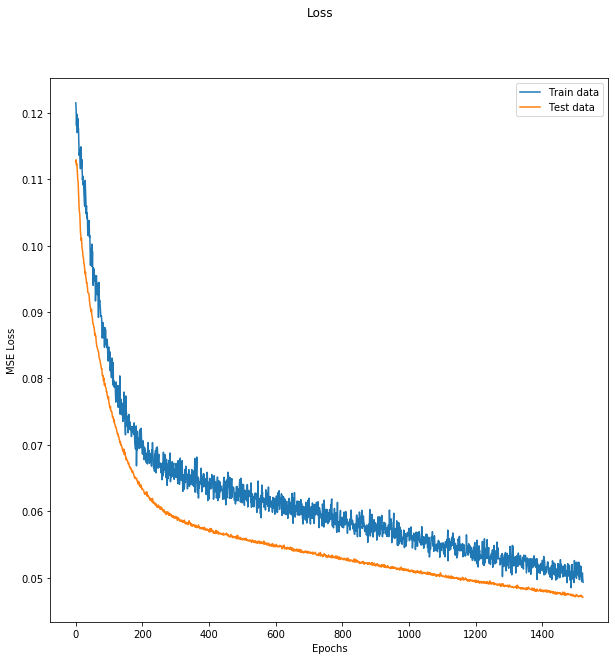

MAPE :  35.298212044104055


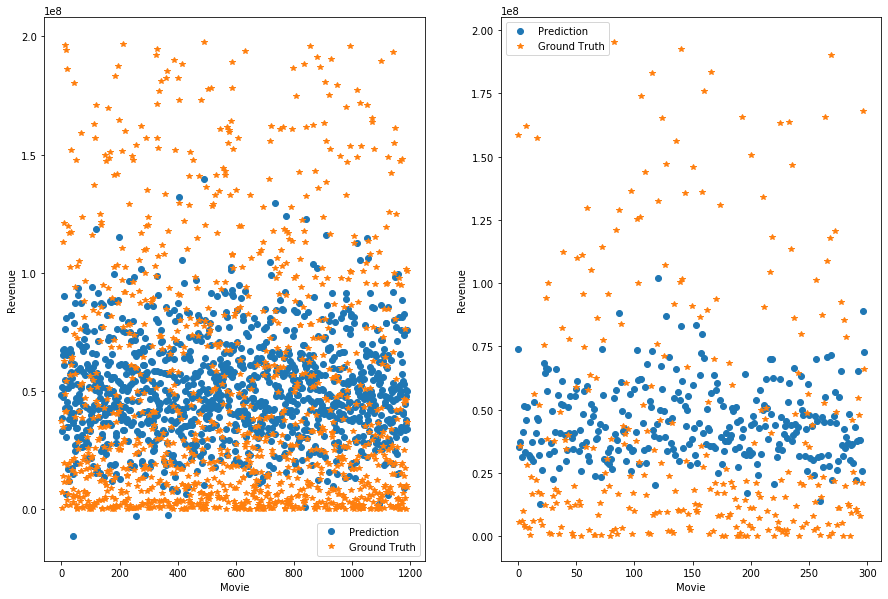

--- Epoch 1523 ---
[Epoch 1523/3000] [Batch 39/40] [Loss: 0.058612 (0.050085)]  [r2: (0.225727)] [rmse: (0.221150)], ETA: 0:35:15.440264
Testing -- [Batch 9/10] [Loss: 0.051458 (0.047203)] [r2: (0.213761)] [rmse: (0.213338)]
--- Epoch 1524 ---
[Epoch 1524/3000] [Batch 39/40] [Loss: 0.037461 (0.047655)]  [r2: (0.260299)] [rmse: (0.215893)], ETA: 0:35:02.598779
Testing -- [Batch 9/10] [Loss: 0.045369 (0.047139)] [r2: (0.226243)] [rmse: (0.216559)]
--- Epoch 1525 ---
[Epoch 1525/3000] [Batch 39/40] [Loss: 0.037255 (0.048584)]  [r2: (0.254382)] [rmse: (0.218055)], ETA: 0:33:32.991256
Testing -- [Batch 9/10] [Loss: 0.067917 (0.047286)] [r2: (0.178341)] [rmse: (0.214862)]
--- Epoch 1526 ---
[Epoch 1526/3000] [Batch 39/40] [Loss: 0.064461 (0.050677)]  [r2: (0.205100)] [rmse: (0.223098)], ETA: 0:34:31.609981
Testing -- [Batch 9/10] [Loss: 0.057014 (0.047187)] [r2: (0.236379)] [rmse: (0.214360)]
--- Epoch 1527 ---
[Epoch 1527/3000] [Batch 39/40] [Loss: 0.047261 (0.050754)]  [r2: (0.196750)] [rm

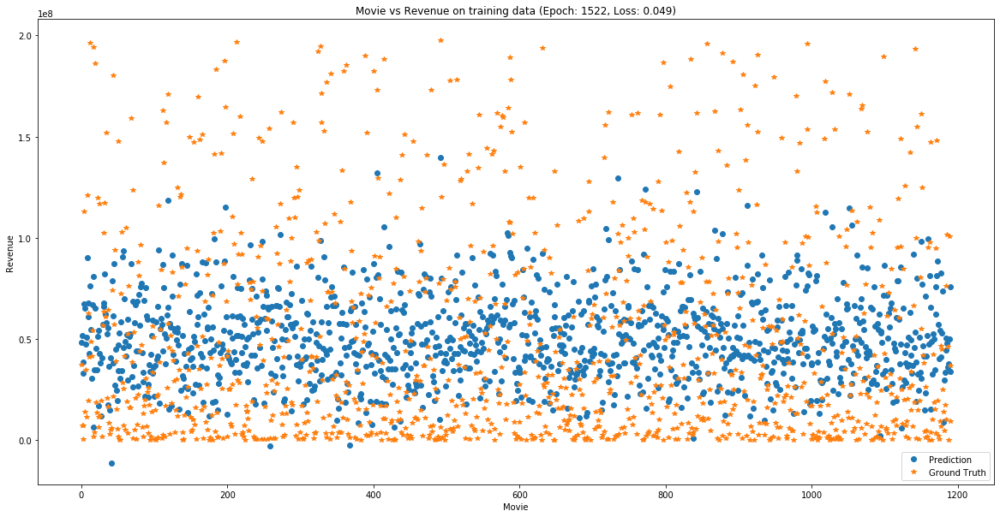

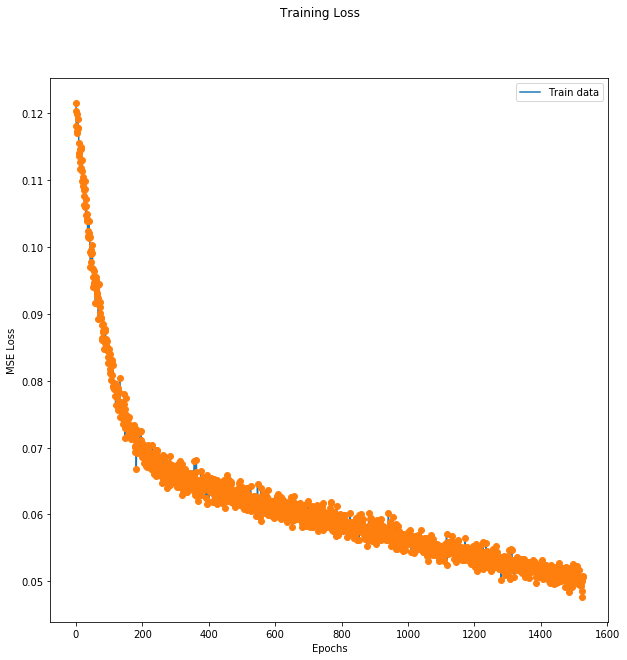

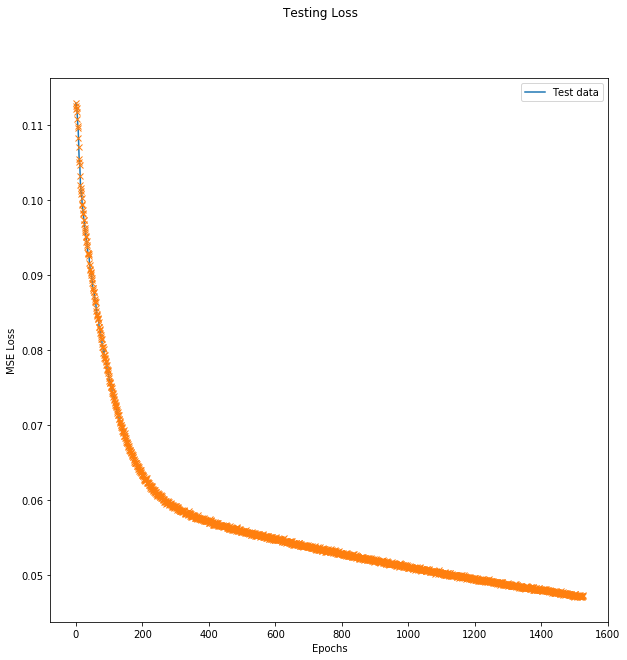

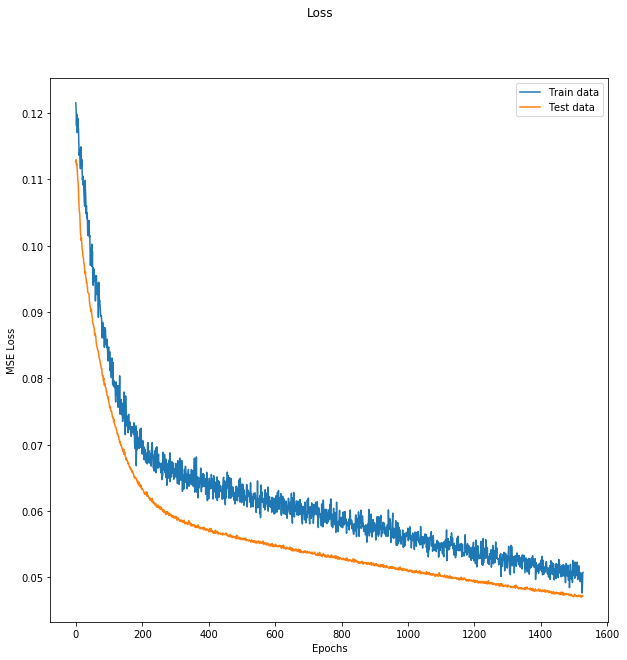

MAPE :  35.37773612282203


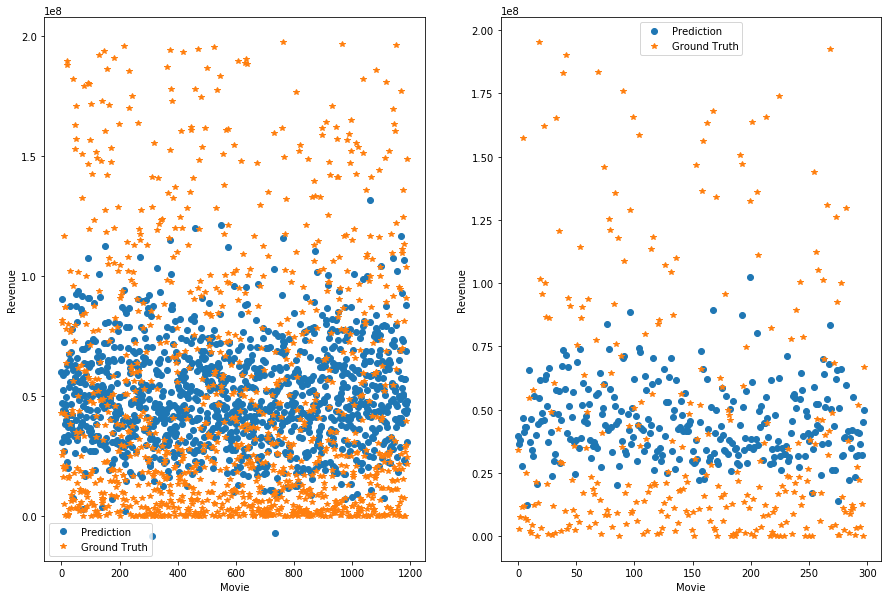

--- Epoch 1528 ---
[Epoch 1528/3000] [Batch 39/40] [Loss: 0.039939 (0.049836)]  [r2: (0.223721)] [rmse: (0.220997)], ETA: 0:33:34.463757
Testing -- [Batch 9/10] [Loss: 0.033859 (0.047041)] [r2: (0.215116)] [rmse: (0.214764)]
--- Epoch 1529 ---
[Epoch 1529/3000] [Batch 39/40] [Loss: 0.051123 (0.050096)]  [r2: (0.238152)] [rmse: (0.220973)], ETA: 0:35:16.836785
Testing -- [Batch 9/10] [Loss: 0.084334 (0.047372)] [r2: (0.205276)] [rmse: (0.215165)]
--- Epoch 1530 ---
[Epoch 1530/3000] [Batch 39/40] [Loss: 0.066909 (0.050212)]  [r2: (0.231567)] [rmse: (0.221466)], ETA: 0:33:35.969843
Testing -- [Batch 9/10] [Loss: 0.026786 (0.046985)] [r2: (0.220523)] [rmse: (0.213449)]
Train R2 =  0.25752192124444695
Test R2 =  0.25927687331638505


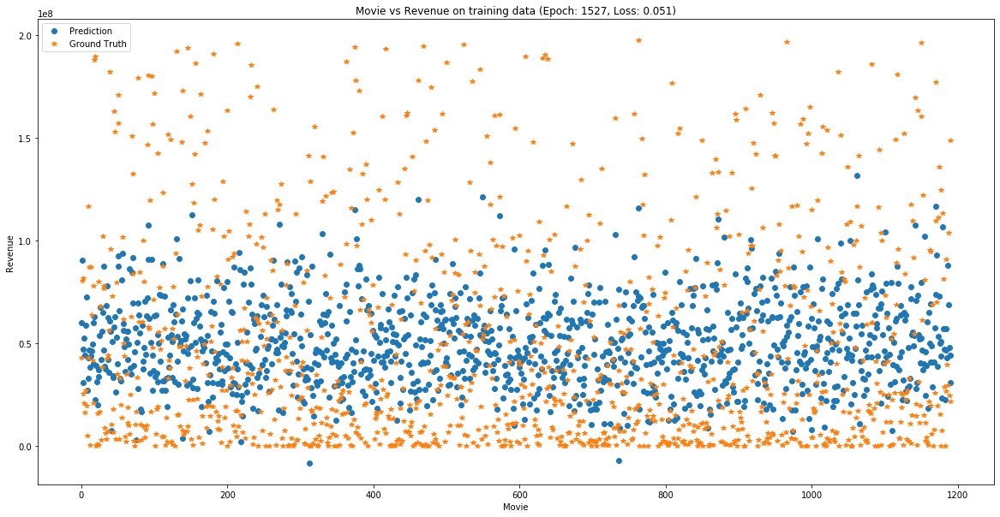

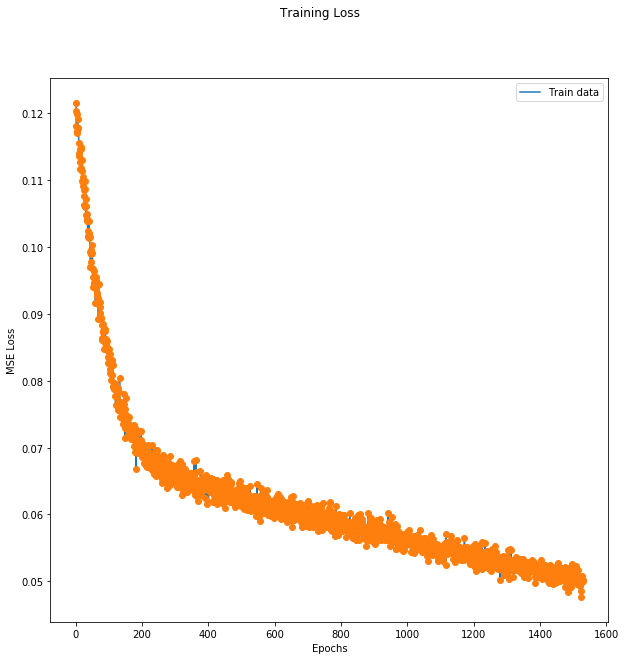

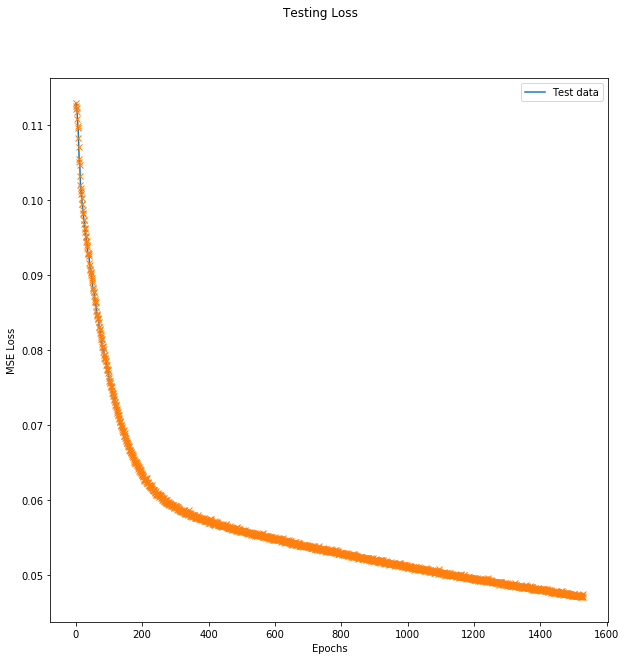

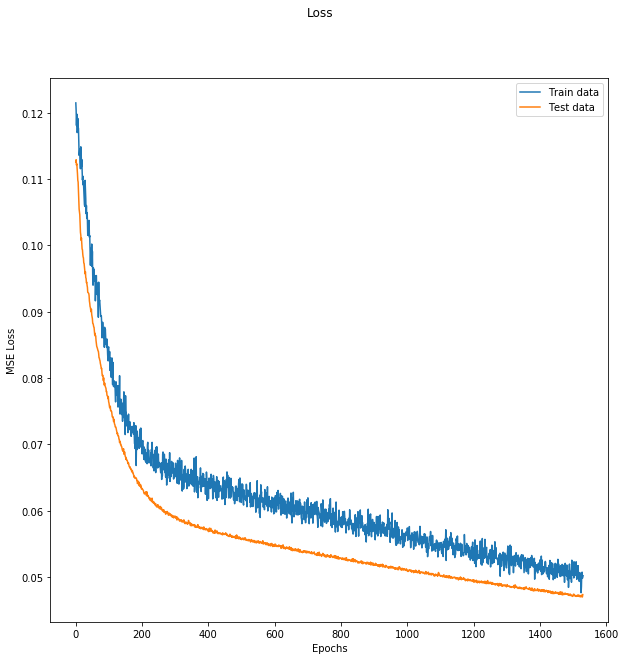

MAPE :  35.25241892893769


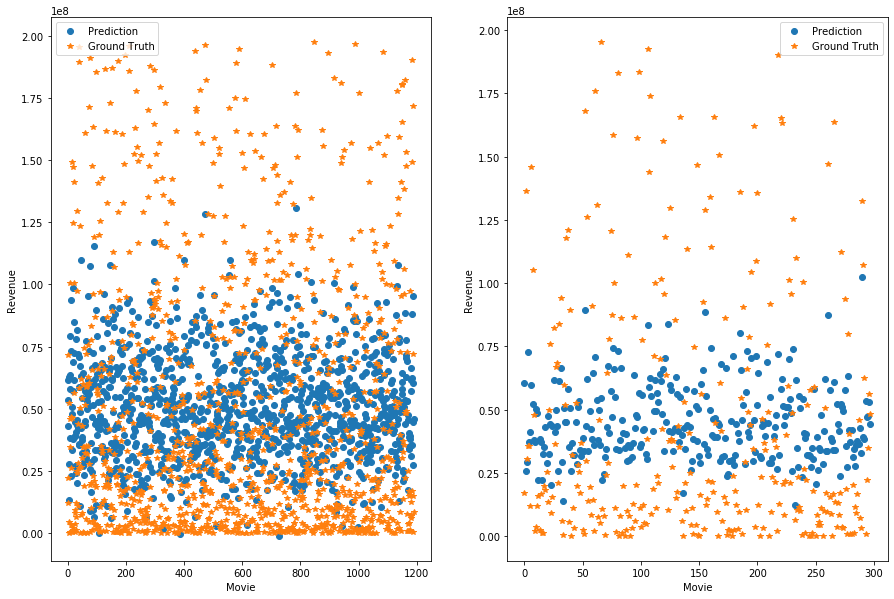

--- Epoch 1531 ---
[Epoch 1531/3000] [Batch 39/40] [Loss: 0.049778 (0.050045)]  [r2: (0.208504)] [rmse: (0.222154)], ETA: 0:34:17.004062
Testing -- [Batch 9/10] [Loss: 0.042952 (0.047111)] [r2: (0.241562)] [rmse: (0.215440)]
--- Epoch 1532 ---
[Epoch 1532/3000] [Batch 39/40] [Loss: 0.027506 (0.049272)]  [r2: (0.213037)] [rmse: (0.220182)], ETA: 0:33:48.139230
Testing -- [Batch 9/10] [Loss: 0.043740 (0.047127)] [r2: (0.223574)] [rmse: (0.214379)]
--- Epoch 1533 ---
[Epoch 1533/3000] [Batch 39/40] [Loss: 0.041086 (0.050425)]  [r2: (0.215727)] [rmse: (0.222421)], ETA: 0:33:26.595994
Testing -- [Batch 9/10] [Loss: 0.032394 (0.047017)] [r2: (0.254628)] [rmse: (0.215105)]
--- Epoch 1534 ---
[Epoch 1534/3000] [Batch 39/40] [Loss: 0.104704 (0.050440)]  [r2: (0.200149)] [rmse: (0.221636)], ETA: 0:36:05.718653
Testing -- [Batch 9/10] [Loss: 0.033269 (0.046997)] [r2: (0.242456)] [rmse: (0.215537)]
--- Epoch 1535 ---
[Epoch 1535/3000] [Batch 39/40] [Loss: 0.084884 (0.050259)]  [r2: (0.241621)] [rm

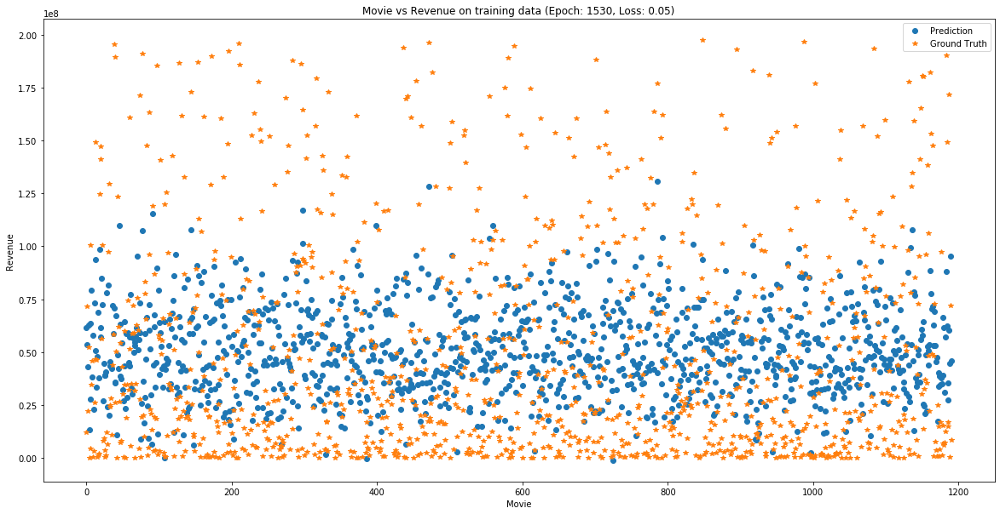

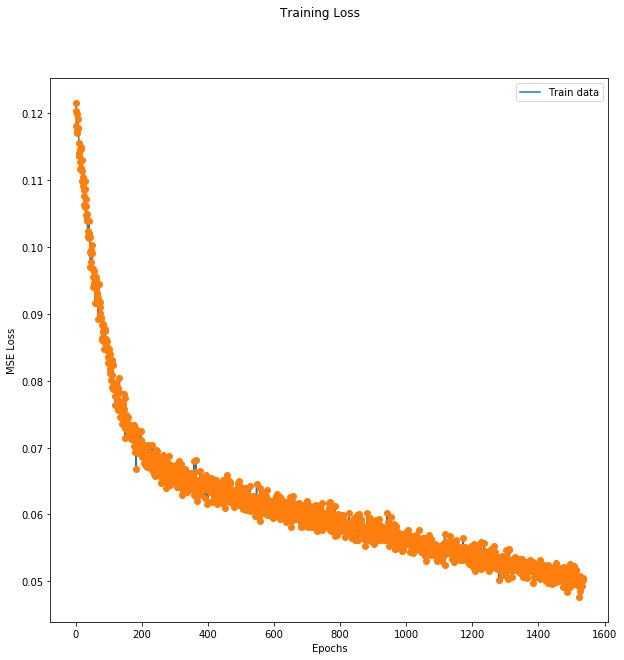

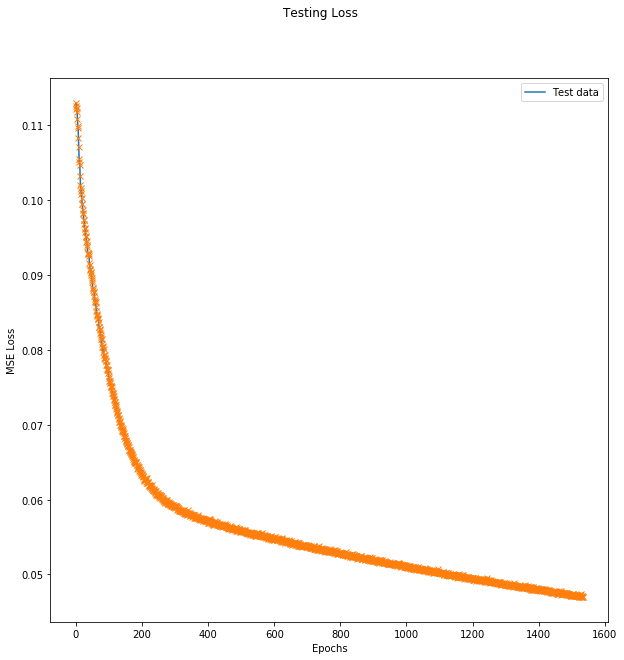

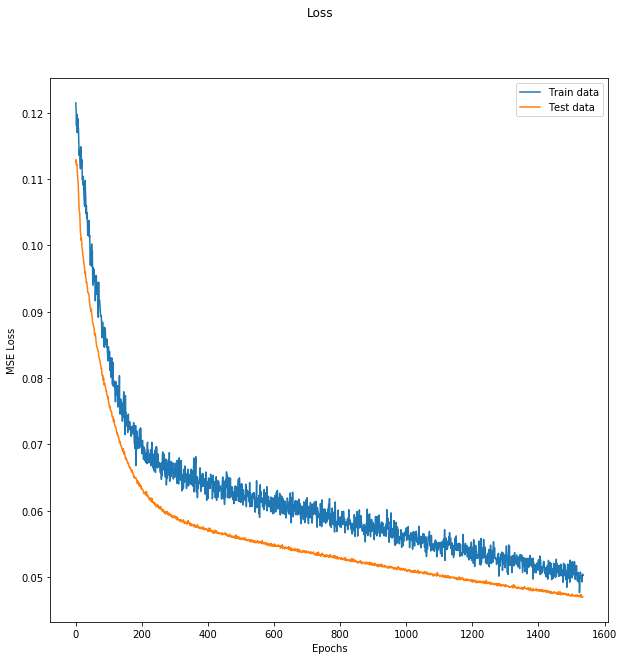

MAPE :  35.03766116438002


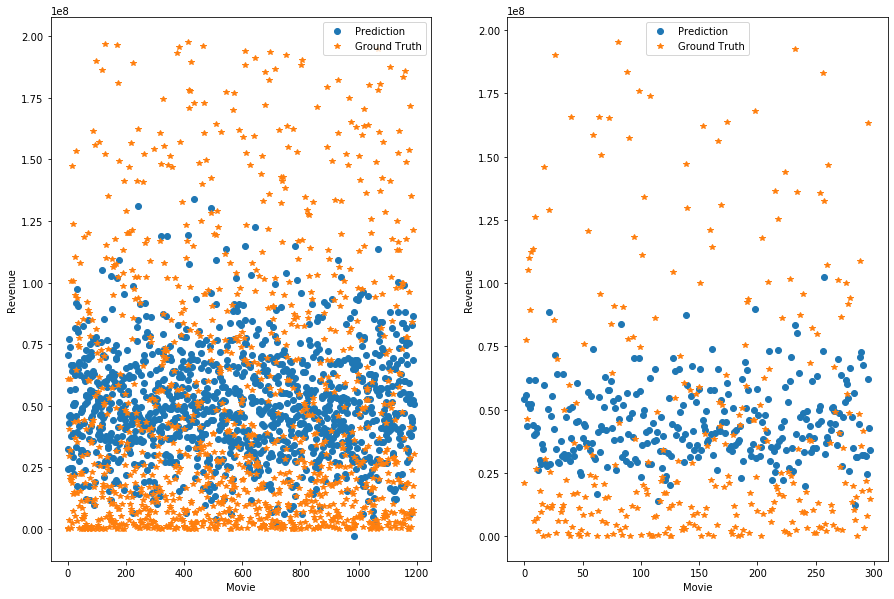

--- Epoch 1536 ---
[Epoch 1536/3000] [Batch 39/40] [Loss: 0.047486 (0.049220)]  [r2: (0.201350)] [rmse: (0.219243)], ETA: 0:33:58.696517
Testing -- [Batch 9/10] [Loss: 0.045433 (0.047065)] [r2: (0.232191)] [rmse: (0.214926)]
--- Epoch 1537 ---
[Epoch 1537/3000] [Batch 39/40] [Loss: 0.058156 (0.050065)]  [r2: (0.235797)] [rmse: (0.221121)], ETA: 0:34:09.363695
Testing -- [Batch 9/10] [Loss: 0.058075 (0.047153)] [r2: (0.224470)] [rmse: (0.214156)]
--- Epoch 1538 ---
[Epoch 1538/3000] [Batch 39/40] [Loss: 0.030085 (0.050700)]  [r2: (0.207571)] [rmse: (0.222766)], ETA: 0:33:11.991416
Testing -- [Batch 9/10] [Loss: 0.042078 (0.047026)] [r2: (0.250312)] [rmse: (0.214013)]
--- Epoch 1539 ---
[Epoch 1539/3000] [Batch 39/40] [Loss: 0.047078 (0.050795)]  [r2: (0.205427)] [rmse: (0.223164)], ETA: 0:33:27.253113
Testing -- [Batch 9/10] [Loss: 0.024960 (0.046903)] [r2: (0.194231)] [rmse: (0.213504)]
Train R2 =  0.24659725339867056
Test R2 =  0.26038058485939775


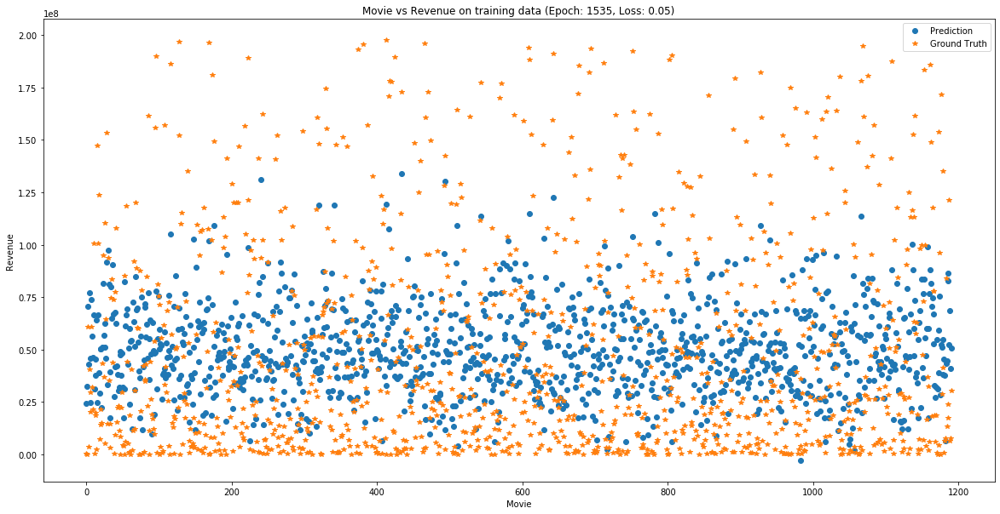

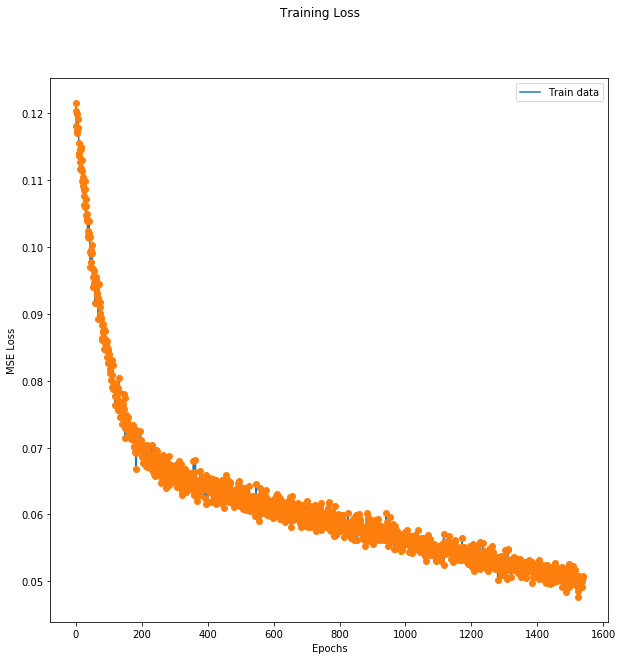

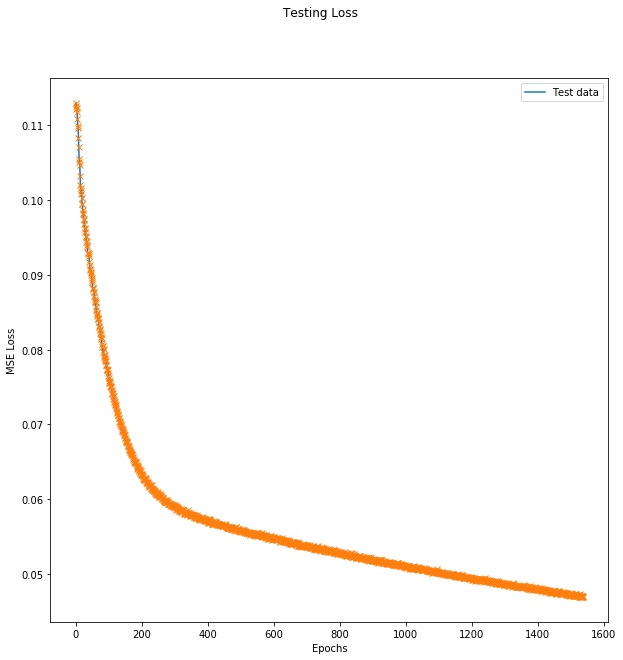

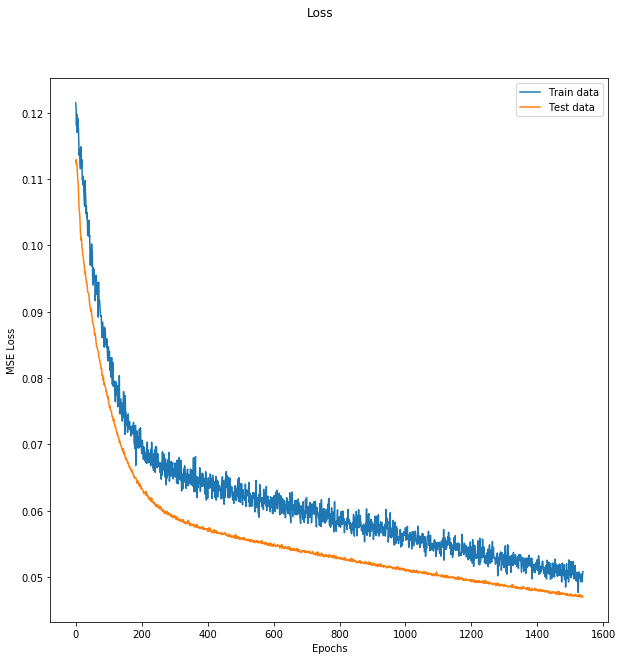

MAPE :  35.08972472465667


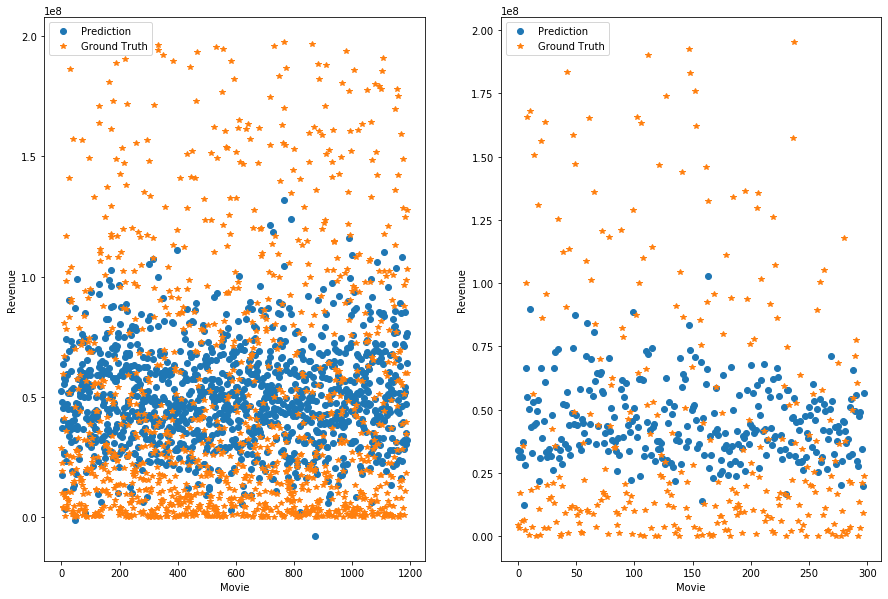

--- Epoch 1540 ---
[Epoch 1540/3000] [Batch 39/40] [Loss: 0.074015 (0.048979)]  [r2: (0.248688)] [rmse: (0.219541)], ETA: 0:35:51.269314
Testing -- [Batch 9/10] [Loss: 0.042890 (0.047022)] [r2: (0.216431)] [rmse: (0.213390)]
--- Epoch 1541 ---
[Epoch 1541/3000] [Batch 39/40] [Loss: 0.043842 (0.050313)]  [r2: (0.178467)] [rmse: (0.221552)], ETA: 0:33:21.374916
Testing -- [Batch 9/10] [Loss: 0.041180 (0.046988)] [r2: (0.248581)] [rmse: (0.215244)]
--- Epoch 1542 ---
[Epoch 1542/3000] [Batch 39/40] [Loss: 0.035070 (0.049307)]  [r2: (0.228731)] [rmse: (0.220073)], ETA: 0:33:34.105956
Testing -- [Batch 9/10] [Loss: 0.053344 (0.047068)] [r2: (0.238186)] [rmse: (0.214890)]
--- Epoch 1543 ---
[Epoch 1543/3000] [Batch 39/40] [Loss: 0.071281 (0.049773)]  [r2: (0.208679)] [rmse: (0.220826)], ETA: 0:34:24.947870
Testing -- [Batch 9/10] [Loss: 0.045487 (0.047024)] [r2: (0.224220)] [rmse: (0.214913)]
--- Epoch 1544 ---
[Epoch 1544/3000] [Batch 39/40] [Loss: 0.037477 (0.051540)]  [r2: (0.193107)] [rm

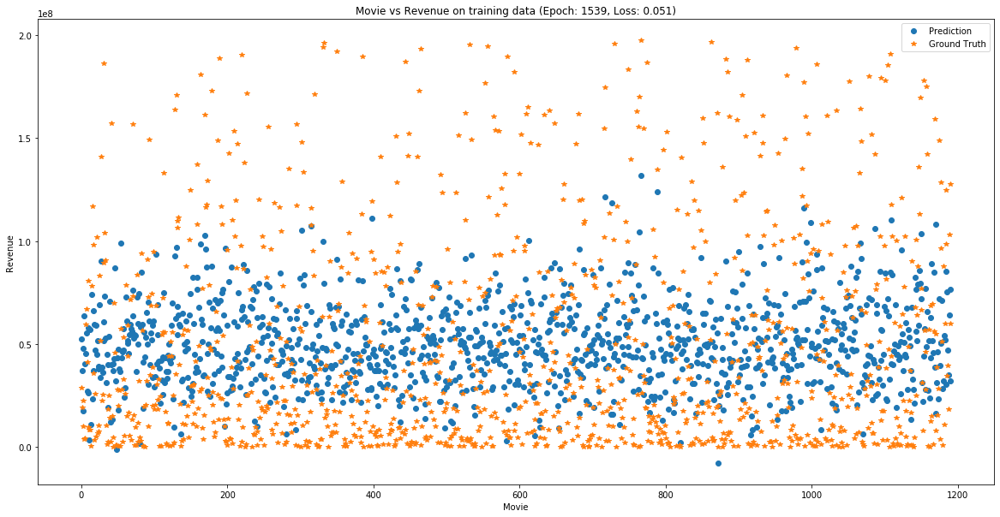

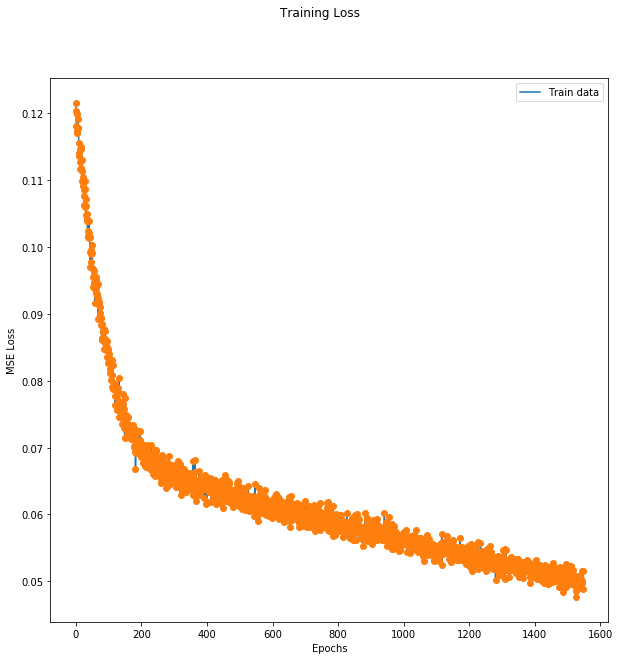

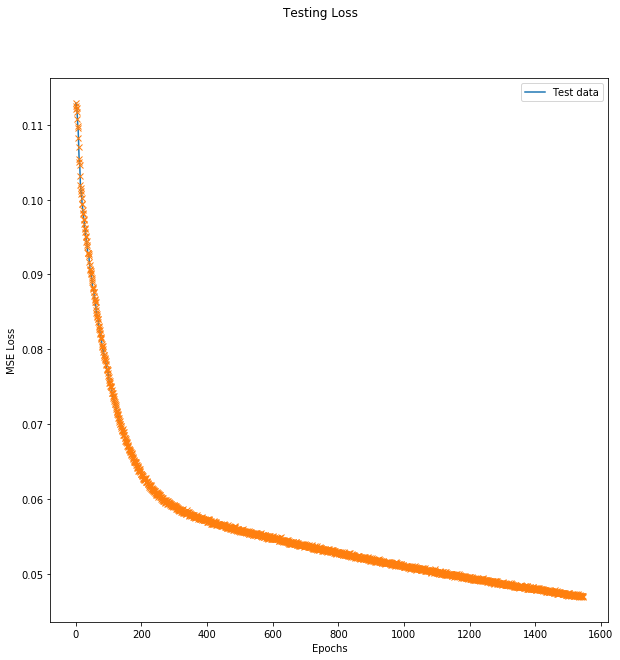

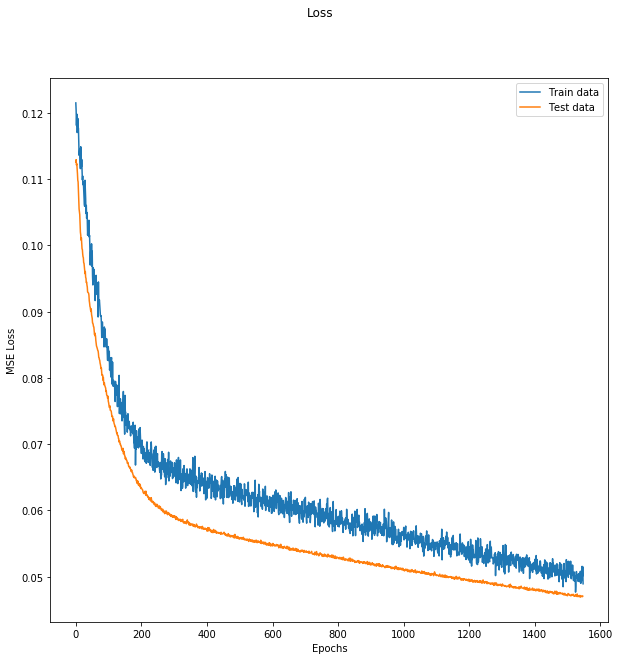

MAPE :  34.918110727654756


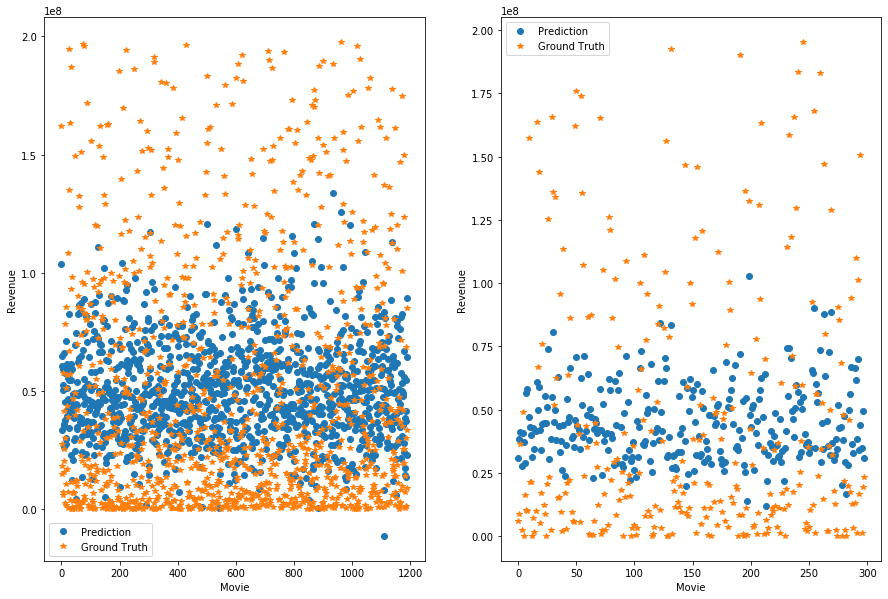

--- Epoch 1548 ---
[Epoch 1548/3000] [Batch 39/40] [Loss: 0.048108 (0.049715)]  [r2: (0.204093)] [rmse: (0.220084)], ETA: 0:36:22.219404
Testing -- [Batch 9/10] [Loss: 0.046496 (0.046973)] [r2: (0.247124)] [rmse: (0.215714)]
--- Epoch 1549 ---
[Epoch 1549/3000] [Batch 39/40] [Loss: 0.052240 (0.050097)]  [r2: (0.224944)] [rmse: (0.222142)], ETA: 0:33:02.898567
Testing -- [Batch 9/10] [Loss: 0.052341 (0.047014)] [r2: (0.222433)] [rmse: (0.213663)]
--- Epoch 1550 ---
[Epoch 1550/3000] [Batch 39/40] [Loss: 0.053236 (0.050241)]  [r2: (0.197662)] [rmse: (0.221703)], ETA: 0:33:19.081178
Testing -- [Batch 9/10] [Loss: 0.032322 (0.046870)] [r2: (0.238569)] [rmse: (0.214042)]
Train R2 =  0.25556418247512647
Test R2 =  0.2616766492020062


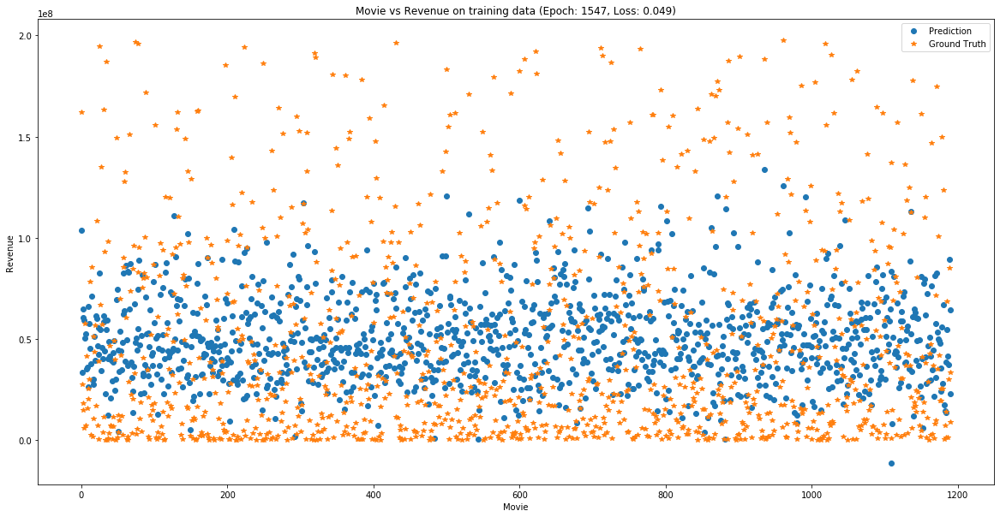

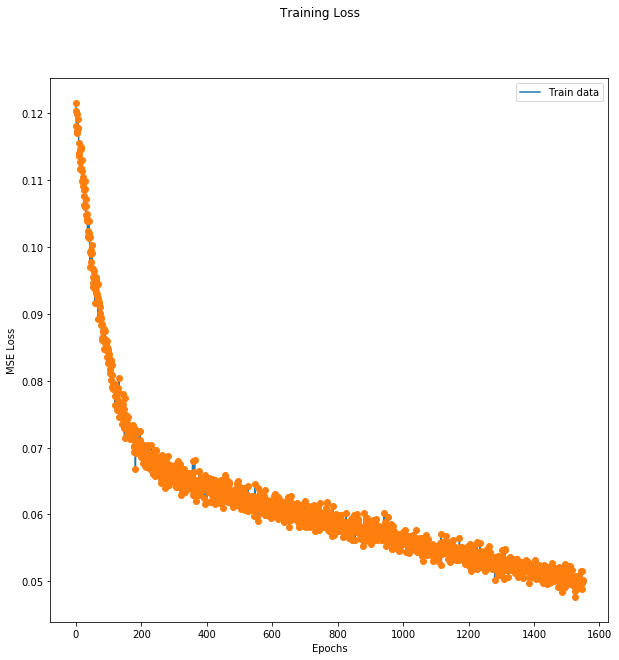

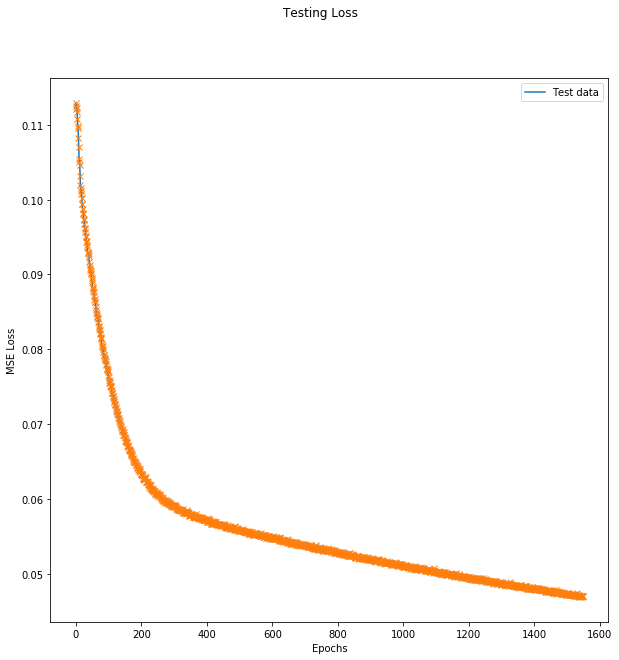

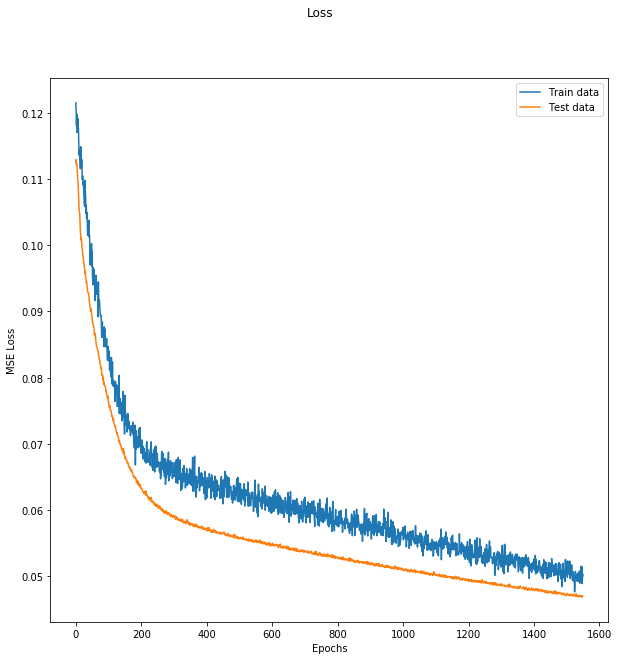

MAPE :  35.01237034282993


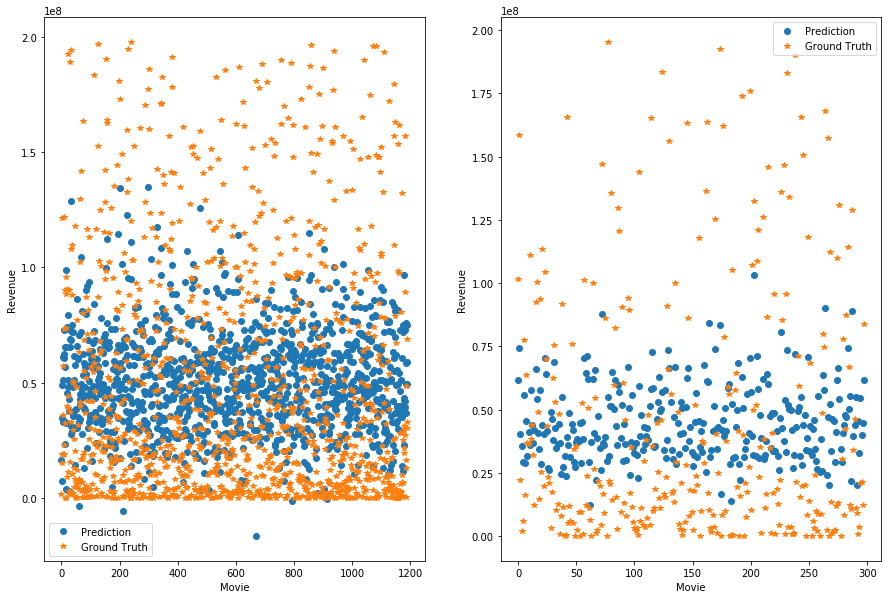

--- Epoch 1551 ---
[Epoch 1551/3000] [Batch 39/40] [Loss: 0.083073 (0.049215)]  [r2: (0.257354)] [rmse: (0.220110)], ETA: 0:33:04.665460
Testing -- [Batch 9/10] [Loss: 0.059950 (0.047050)] [r2: (0.261116)] [rmse: (0.213476)]
--- Epoch 1552 ---
[Epoch 1552/3000] [Batch 39/40] [Loss: 0.071858 (0.050627)]  [r2: (0.227204)] [rmse: (0.223288)], ETA: 0:34:08.761611
Testing -- [Batch 9/10] [Loss: 0.037177 (0.046883)] [r2: (0.228287)] [rmse: (0.213372)]
--- Epoch 1553 ---
[Epoch 1553/3000] [Batch 39/40] [Loss: 0.082539 (0.050637)]  [r2: (0.224765)] [rmse: (0.222938)], ETA: 0:34:42.152659
Testing -- [Batch 9/10] [Loss: 0.039598 (0.046921)] [r2: (0.240605)] [rmse: (0.213628)]
--- Epoch 1554 ---
[Epoch 1554/3000] [Batch 39/40] [Loss: 0.067036 (0.050649)]  [r2: (0.224687)] [rmse: (0.222004)], ETA: 0:34:02.498496
Testing -- [Batch 9/10] [Loss: 0.040193 (0.046908)] [r2: (0.190879)] [rmse: (0.214666)]
--- Epoch 1555 ---
[Epoch 1555/3000] [Batch 39/40] [Loss: 0.044865 (0.050693)]  [r2: (0.215069)] [rm

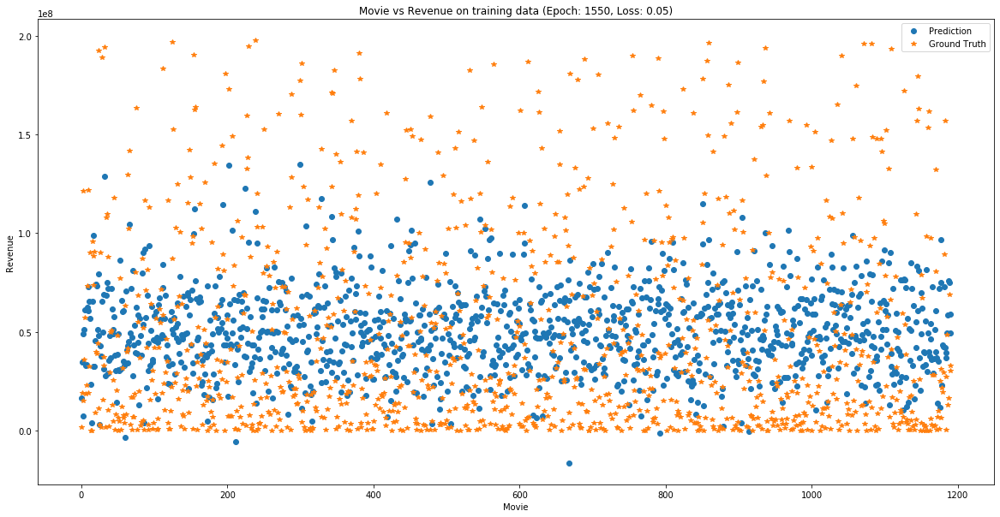

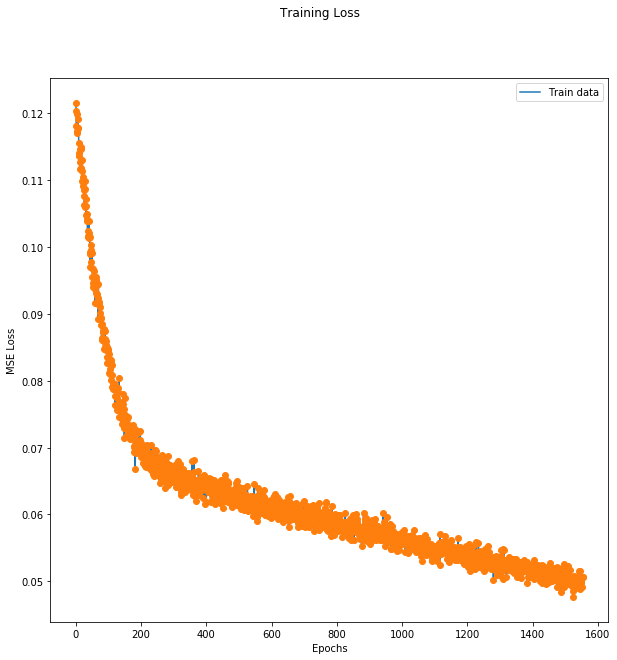

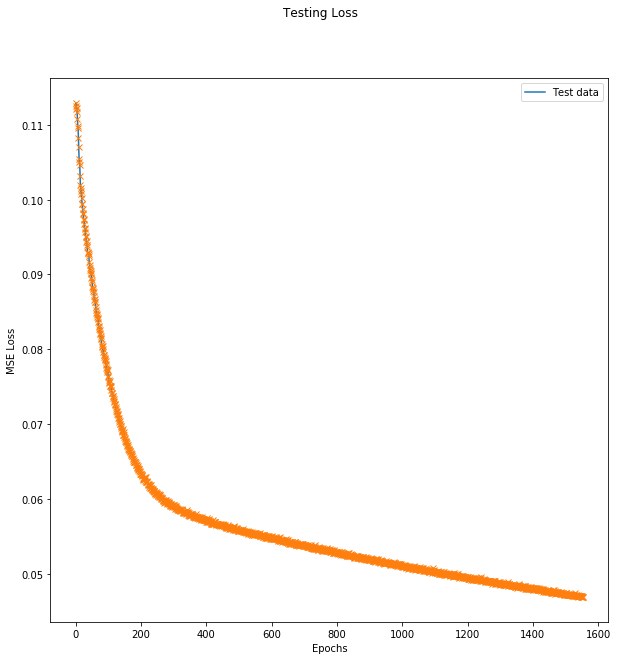

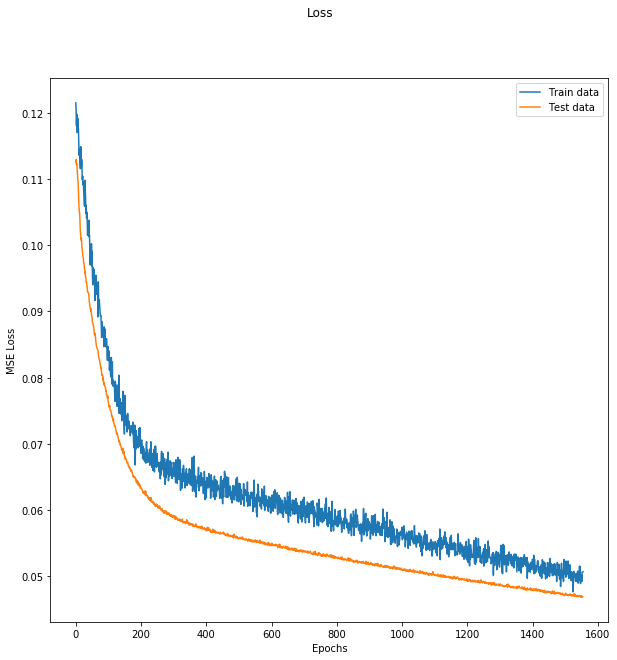

MAPE :  35.0388763082292


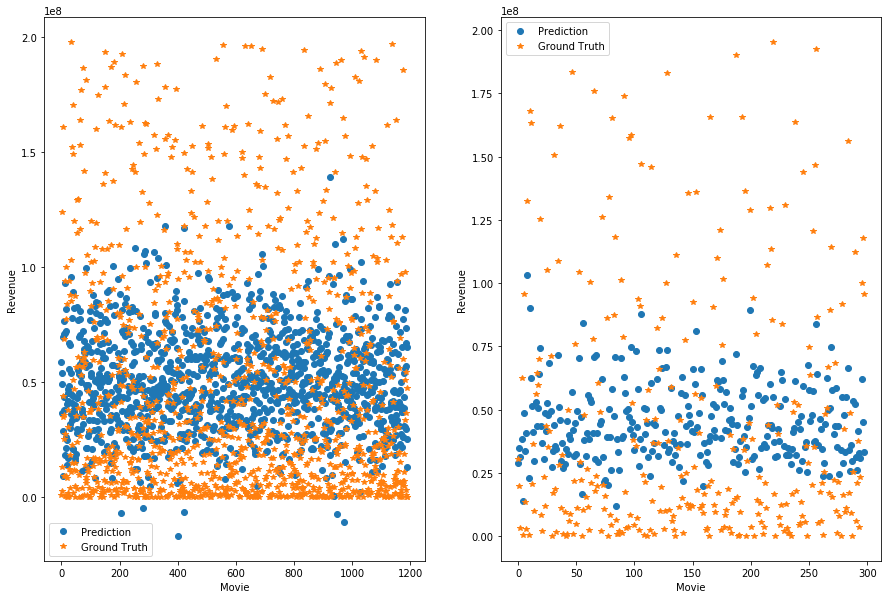

--- Epoch 1556 ---
[Epoch 1556/3000] [Batch 39/40] [Loss: 0.038292 (0.049240)]  [r2: (0.233280)] [rmse: (0.219464)], ETA: 0:33:00.262045
Testing -- [Batch 9/10] [Loss: 0.046471 (0.046922)] [r2: (0.241608)] [rmse: (0.215739)]
--- Epoch 1557 ---
[Epoch 1557/3000] [Batch 39/40] [Loss: 0.036313 (0.049968)]  [r2: (0.236042)] [rmse: (0.221785)], ETA: 0:33:47.063780
Testing -- [Batch 9/10] [Loss: 0.074298 (0.047099)] [r2: (0.257659)] [rmse: (0.214073)]
--- Epoch 1558 ---
[Epoch 1558/3000] [Batch 39/40] [Loss: 0.039080 (0.050080)]  [r2: (0.185279)] [rmse: (0.221421)], ETA: 0:32:43.733533
Testing -- [Batch 9/10] [Loss: 0.048435 (0.046930)] [r2: (0.243016)] [rmse: (0.214731)]
--- Epoch 1559 ---
[Epoch 1559/3000] [Batch 39/40] [Loss: 0.084378 (0.048767)]  [r2: (0.250997)] [rmse: (0.218991)], ETA: 0:32:52.711860
Testing -- [Batch 9/10] [Loss: 0.039160 (0.046874)] [r2: (0.215388)] [rmse: (0.215009)]
--- Epoch 1560 ---
[Epoch 1560/3000] [Batch 39/40] [Loss: 0.022828 (0.050589)]  [r2: (0.206359)] [rm

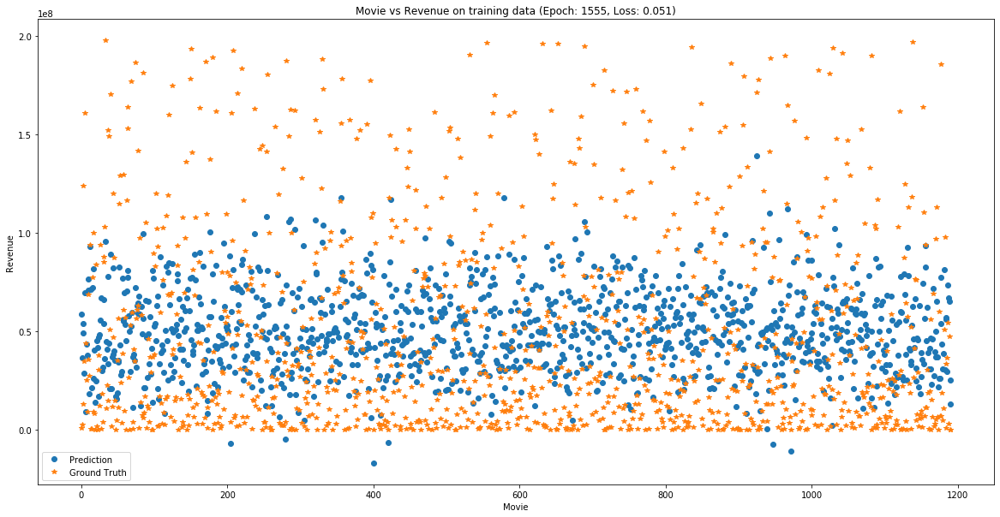

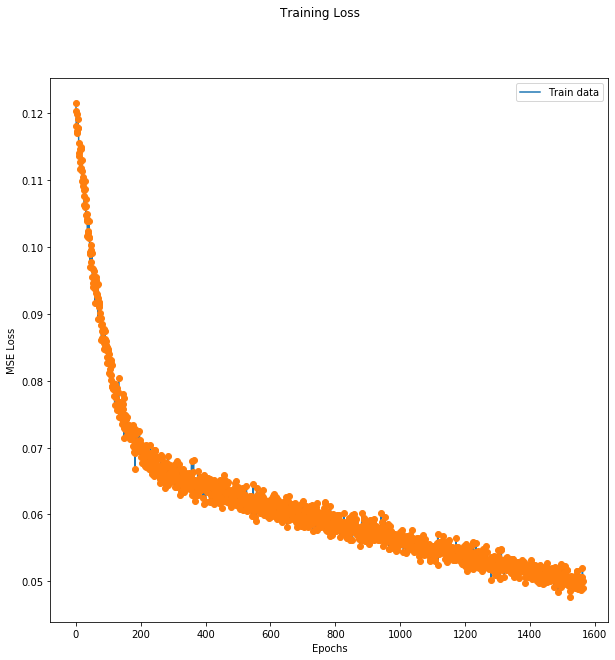

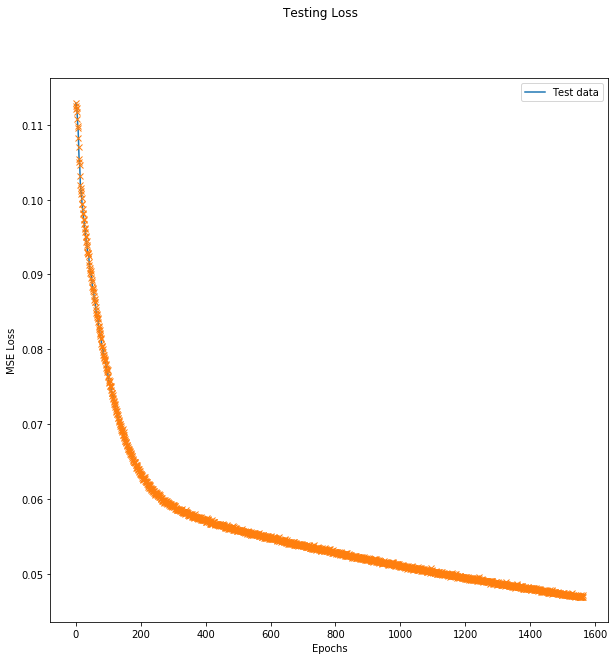

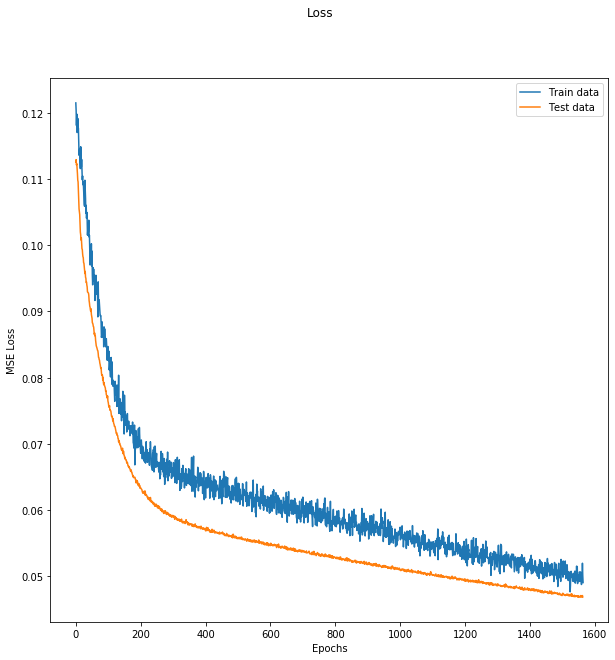

MAPE :  34.96818371229829


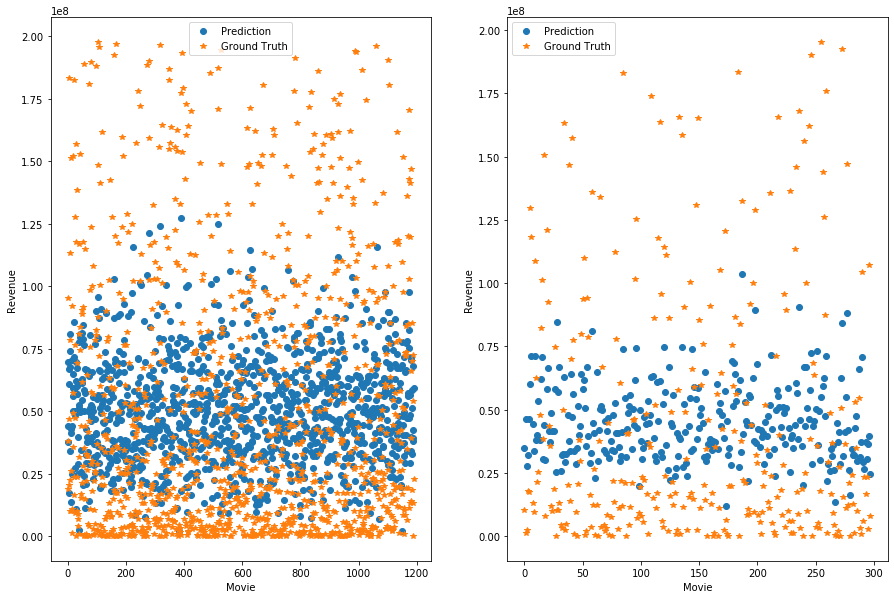

--- Epoch 1565 ---
[Epoch 1565/3000] [Batch 39/40] [Loss: 0.059284 (0.051692)]  [r2: (0.184900)] [rmse: (0.224430)], ETA: 0:33:24.822682
Testing -- [Batch 9/10] [Loss: 0.037515 (0.046815)] [r2: (0.218216)] [rmse: (0.214374)]
--- Epoch 1566 ---
[Epoch 1566/3000] [Batch 39/40] [Loss: 0.039409 (0.052152)]  [r2: (0.184545)] [rmse: (0.226196)], ETA: 0:33:51.686741
Testing -- [Batch 9/10] [Loss: 0.031925 (0.046777)] [r2: (0.231441)] [rmse: (0.214077)]
--- Epoch 1567 ---
[Epoch 1567/3000] [Batch 39/40] [Loss: 0.092172 (0.049562)]  [r2: (0.231588)] [rmse: (0.220476)], ETA: 0:33:27.762483
Testing -- [Batch 9/10] [Loss: 0.090761 (0.047154)] [r2: (0.251231)] [rmse: (0.212473)]
--- Epoch 1568 ---
[Epoch 1568/3000] [Batch 39/40] [Loss: 0.055764 (0.048473)]  [r2: (0.254514)] [rmse: (0.218100)], ETA: 0:33:27.506814
Testing -- [Batch 9/10] [Loss: 0.067775 (0.046999)] [r2: (0.256160)] [rmse: (0.214536)]
--- Epoch 1569 ---
[Epoch 1569/3000] [Batch 39/40] [Loss: 0.035288 (0.050122)]  [r2: (0.217636)] [rm

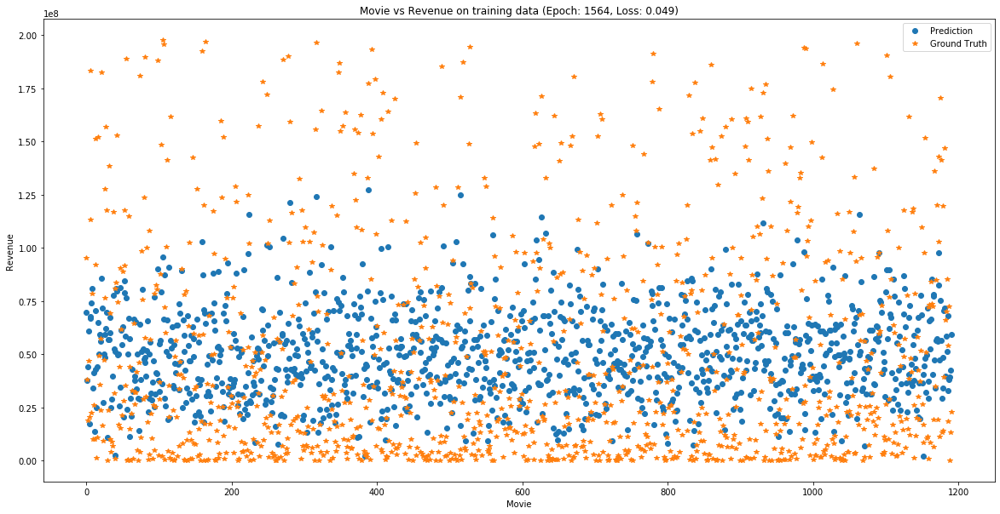

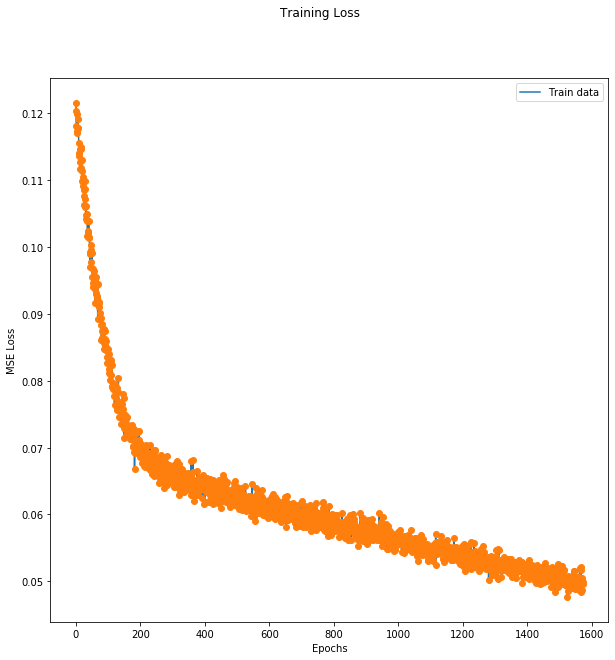

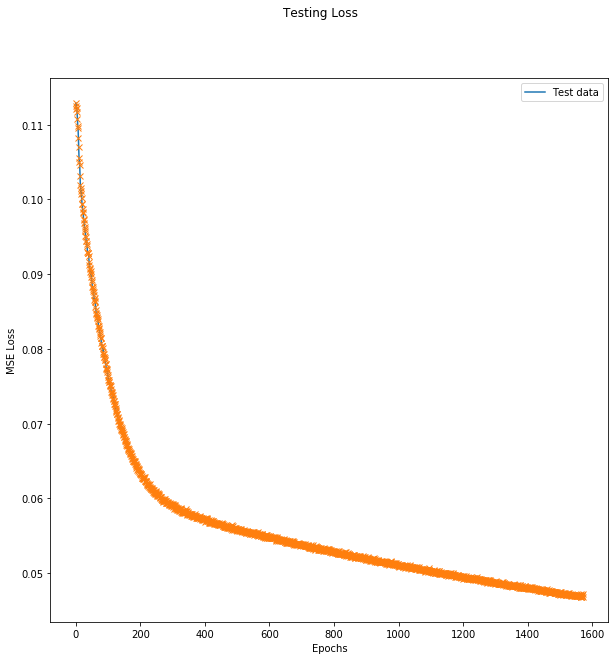

Buffered data was truncated after reaching the output size limit.

In [0]:
import pdb
latent_dim = 512
num_epochs = 3000
lowest = 10000
lowtestp = []
lowtestg = []
lowtrainp = []
lowtraing = []
lowtestindex = []
lowtrainindex = []
# Classification criterion
criterion = torch.nn.MSELoss().to(device)

# Define network
model = ConvLSTM(
    metasize = metadata.shape[1],
    num_classes=30,
    latent_dim=latent_dim,
    lstm_layers=1,
    hidden_dim=512,
    bidirectional=False,
    
)
model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-7)



def test_model(epoch):
    """ Evaluate the model on the test set """
    print("")
    model.eval()
    test_metrics = {"loss": [],"RMSE": [],"R2" : []}
     
    testp = []
    testg = []
    testi = []
    for batch_i, (X,MX, y,indexs) in enumerate(test_loader):

        MetaX = Variable(MX.to(device), requires_grad=False)
        image_sequences = Variable(X.to(device), requires_grad=False)
        labels = Variable(y, requires_grad=False).to(device)
        with torch.no_grad():
            # Reset LSTM hidden state
            model.lstm.reset_hidden_state()
            # Get sequence predictions
            predictions = model(image_sequences,MetaX)
        # Compute metrics
        testp.extend(predictions.tolist())
        testg.extend(labels.tolist())
        testi.extend(indexs)
        loss = criterion(predictions, labels).item()
        r2 = r2_score(labels.detach().cpu().numpy(), predictions.detach().cpu().numpy())  
        rmse = sqrt(loss)
        # Keep track of loss and accuracy
        test_metrics["loss"].append(loss)
        test_metrics["RMSE"].append(rmse)
        test_metrics["R2"].append(r2)
      
        # Log test performance
        sys.stdout.write(
            "\rTesting -- [Batch %d/%d] [Loss: %f (%f)] [r2: (%f)] [rmse: (%f)]"
            % (
                batch_i,
                len(test_loader),
                loss,
                np.mean(test_metrics["loss"]),
               np.mean(test_metrics["R2"]),
               np.mean(test_metrics["RMSE"])
                
               
            )
        )
    model.train()
    print("")
    return  np.mean(test_metrics["loss"]),testp,testg,testi
    
model.train()
trainLoss = []
testLoss = []
for epoch in range(num_epochs):
    epoch_metrics = {"loss": [],"RMSE": [],"R2" : []}
    prev_time = time.time()
    print(f"--- Epoch {epoch} ---")
    trainp = []
    traing = []
    testp = []
    testg = []
    testi = []
    traini = []
    for batch_i, (X,MX, y,index) in enumerate(train_loader):
        
        if X.size(0) == 1:
            continue

        
        # pdb.set_trace()
        
        MetaX = Variable(MX.to(device), requires_grad=True)
        image_sequences = Variable(X.to(device), requires_grad=True)
        labels = Variable(y.to(device), requires_grad=False)

        optimizer.zero_grad()

        # Reset LSTM hidden state
        model.lstm.reset_hidden_state()

        # Get sequence predictions
        predictions = model(image_sequences,MetaX)

        # Compute metrics
        trainp.extend(predictions.tolist())
        traing.extend(labels.tolist())
        traini.extend(index)
        loss = criterion(predictions, labels)

        
      
      

        loss.backward()
        optimizer.step()
        r2 = r2_score(labels.detach().cpu().numpy(), predictions.detach().cpu().numpy())
        rmse = sqrt(loss.item())
        # Keep track of epoch metrics
        epoch_metrics["loss"].append(loss.item())
        epoch_metrics["RMSE"].append(rmse)
        epoch_metrics["R2"].append(r2)
       
        # Determine approximate time left
        batches_done = epoch * len(train_loader) + batch_i
        batches_left = num_epochs * len(train_loader) - batches_done
        time_left = datetime.timedelta(seconds=batches_left * (time.time() - prev_time))
        prev_time = time.time()

        # Print log
        sys.stdout.write(
            "\r[Epoch %d/%d] [Batch %d/%d] [Loss: %f (%f)]  [r2: (%f)] [rmse: (%f)], ETA: %s"
            % (
                epoch,
                num_epochs,
                batch_i,
                len(train_loader),
                loss.item(),
                np.mean(epoch_metrics["loss"]),
                np.mean(epoch_metrics["R2"]),
                np.mean(epoch_metrics["RMSE"]),
                time_left,
            )
        )

        # Empty cache
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
    trainLoss.append(np.mean(epoch_metrics["loss"]))
    # Evaluate the model on the test set
    testL,testp,testg,testi = test_model(epoch)
    if(lowest > testL):
        lowest = testL
        if(epoch > 1000):

          print("Train R2 = ",r2_score(traing, trainp))
          print("Test R2 = ",r2_score(testg, testp))
          lowtestp = testp
          lowtestg = testg
          lowtrainp = trainp
          lowtraing = traing
          lowtestindex = testi
          lowtrainindex = traini
          fig, axs = plt.subplots(1, 1, figsize=(10, 10))
          fig.suptitle("Training Loss")
          axs.plot(trainLoss, label="Train data")
          axs.plot(trainLoss, "o")
          axs.set_ylabel('MSE Loss')
          axs.set_xlabel('Epochs')
          plt.legend()
          plt.show()

          fig, axs = plt.subplots(1, 1, figsize=(10, 10))
          fig.suptitle("Testing Loss")
          axs.plot(testLoss , label="Test data")
          axs.plot(testLoss, "x")
          axs.set_ylabel('MSE Loss')
          axs.set_xlabel('Epochs')
          plt.legend()
          plt.show()



          fig, axs = plt.subplots(1, 1, figsize=(10, 10))
          fig.suptitle("Loss")
          axs.plot(trainLoss,label="Train data")
          axs.plot(testLoss,label="Test data")
          axs.set_ylabel('MSE Loss')
          axs.set_xlabel('Epochs')
          plt.legend()
          plt.show()

          


          Y_t = scaler_Y.inverse_transform(testg)
          p_t = scaler_Y.inverse_transform(testp)
          Y_tr = scaler_Y.inverse_transform(traing)
          p_tr = scaler_Y.inverse_transform(trainp)

          print('MAPE : ',mean_absolute_percentage_error(Y_t,p_t))


          plt.figure(figsize=(15,10))
          plt.subplot(1, 2, 1)
          plt.xlabel("Movie")
          plt.ylabel("Revenue")
          # plt.title("Movie vs Revenue on training data (Epoch: "+str(i)+", Loss: "+str(round(testLoss, 3))+")")
          plt.plot(p_tr, "o", label="Prediction")
          plt.plot(Y_tr, "*", label="Ground Truth")
          plt.legend()

          plt.subplot(1, 2, 2)

          plt.xlabel("Movie")
          plt.ylabel("Revenue")
          # plt.title("Movie vs Revenue on training data (Epoch: "+str(i)+", Loss: "+str(round(testLoss, 3))+")")
          plt.plot(p_t, "o", label="Prediction")
          plt.plot(Y_t, "*", label="Ground Truth")
          plt.legend()
          plt.show()

          plt.figure(figsize=(20,10))

          plt.xlabel("Movie")
          plt.ylabel("Revenue")
          plt.title("Movie vs Revenue on training data (Epoch: "+str(epoch)+", Loss: "+str(round(np.mean(epoch_metrics["loss"]), 3))+")")
          plt.plot(p_tr, "o", label="Prediction")
          plt.plot(Y_tr, "*", label="Ground Truth")
          plt.legend()


    testLoss.append(testL)


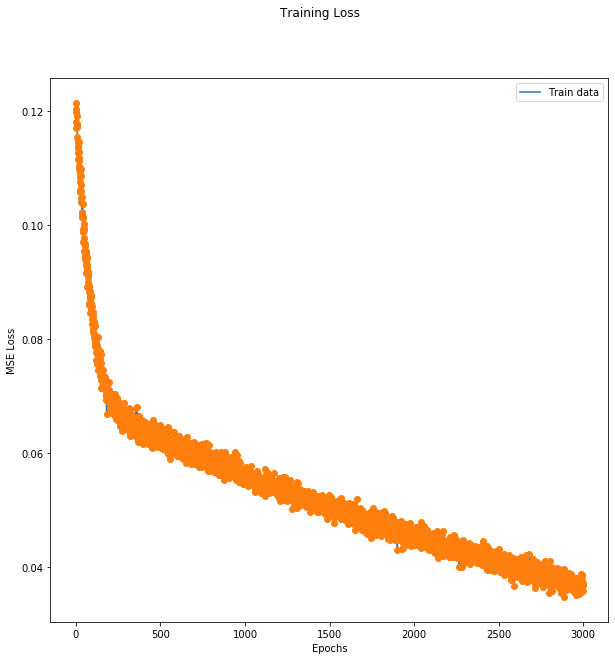

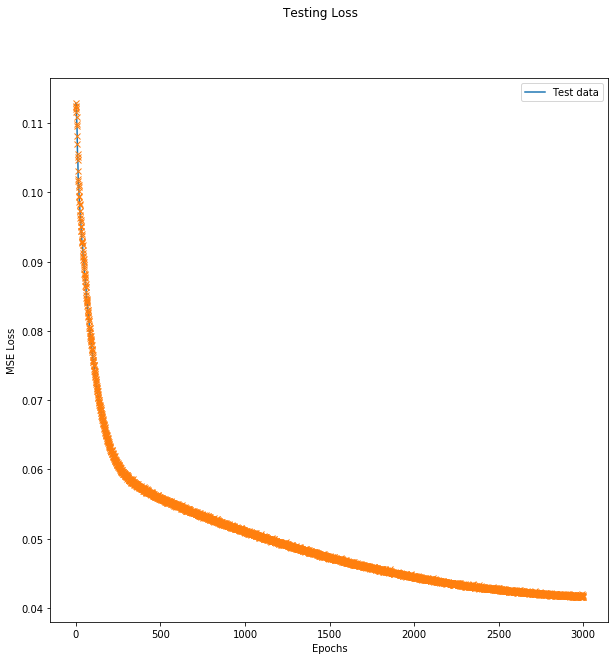

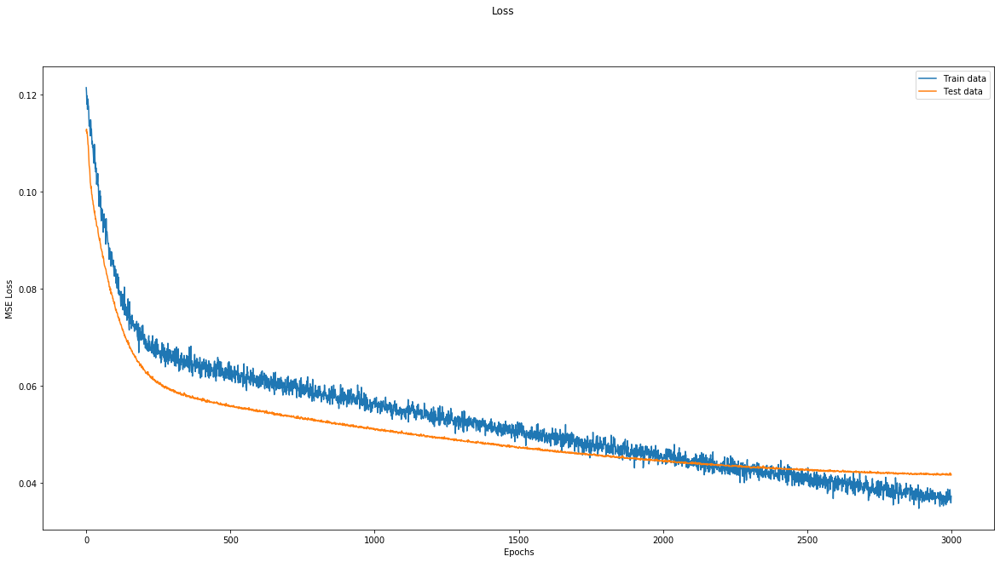

In [0]:

fig, axs = plt.subplots(1, 1, figsize=(10, 10))
fig.suptitle("Training Loss")
axs.plot(trainLoss, label="Train data")
axs.plot(trainLoss, "o")
axs.set_ylabel('MSE Loss')
axs.set_xlabel('Epochs')
plt.legend()
plt.show()

fig, axs = plt.subplots(1, 1, figsize=(10, 10))
fig.suptitle("Testing Loss")
axs.plot(testLoss , label="Test data")
axs.plot(testLoss, "x")
axs.set_ylabel('MSE Loss')
axs.set_xlabel('Epochs')
plt.legend()
plt.show()

fig, axs = plt.subplots(1, 1, figsize=(20, 10))
fig.suptitle("Loss")
axs.plot(trainLoss,label="Train data")
axs.plot(testLoss,label="Test data")
axs.set_ylabel('MSE Loss')
axs.set_xlabel('Epochs')
plt.legend()
plt.show()